In [1]:
import sys
print(sys.version)

3.6.5 |Anaconda custom (64-bit)| (default, Mar 29 2018, 13:14:23) 
[GCC 4.2.1 Compatible Clang 4.0.1 (tags/RELEASE_401/final)]


In [2]:
"""
Created on July 1 2019
@author: Neven Caplar
@contact: ncaplar@princeton.edu

These comments are theoretically the only ones you need to read to run the notebook

1. Specify the directory in which you want to run the analysis below (PSF_DIRECTORY)
2. Name and place the data in DATA_FOLDER. The data is avaliable at https://github.com/nevencaplar/PFS_Work_In_Progress/tree/master/CutsForTigerMay2
3. TESTING_FOLDER will be filled during the run with images from the analysis analysis

4. (OPTIONAL)Next cell contains some extensions that I use that make life much easier when using jupyter notebook 
    Without them this notebook becomes reallllly huge and hard to deal with
    These can be downloaded from https://github.com/ipython-contrib/jupyter_contrib_nbextensions

"""
############################################################
# name your directory where you want to have files!
PSF_DIRECTORY='/Users/nevencaplar/Documents/PFS/'
# place cutouts in this folder - name as you wish
DATA_FOLDER=PSF_DIRECTORY+'TigerAnalysis/CutsForTigerMay2/'
############################################################
    

TESTING_FOLDER=PSF_DIRECTORY+'Testing/'
TESTING_PUPIL_IMAGES_FOLDER=TESTING_FOLDER+'Pupil_Images/'
TESTING_WAVEFRONT_IMAGES_FOLDER=TESTING_FOLDER+'Wavefront_Images/'
TESTING_FINAL_IMAGES_FOLDER=TESTING_FOLDER+'Final_Images/'
import os

for i in [PSF_DIRECTORY,DATA_FOLDER,TESTING_PUPIL_IMAGES_FOLDER,TESTING_WAVEFRONT_IMAGES_FOLDER,TESTING_FINAL_IMAGES_FOLDER]:
    if not os.path.exists(i):
        os.makedirs(i)

In [3]:
%%javascript
try {
  require(['base/js/utils'], function (utils) {
    utils.load_extension('code_prettify/code_prettify');
    utils.load_extension('collapsible_headings/main'); 
    utils.load_extension('codefolding/edit'); 
    utils.load_extension('codefolding/main'); 
    utils.load_extension('execute_time/ExecuteTime');   
    utils.load_extension('toc2/main'); 
  });
}
catch (err) {
  console.log('toc2 load error:', err);
}

<IPython.core.display.Javascript object>

In [4]:
# make notebook nice and wide to fill the entire screen
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [5]:
%load_ext autoreload
%autoreload 2

#import Zernike_Module
#from Zernike_Module import LNP_PFS,LN_PFS_single,create_parInit,downsample_manual_function,Zernike_Analysis,PFSPupilFactory,custom_fftconvolve,stepK,maxK,sky_scale,sky_size,create_x,remove_pupil_parameters_from_all_parameters

#Zernike_Module_lastOct15_beforeScatterChange
import Zernike_Module
from Zernike_Module import *
from Residual_1D_module import * 


In [6]:
import galsim
import numpy as np
np.set_printoptions(suppress=True)
np.seterr(divide='ignore', invalid='ignore')
import pandas as pd
import io
import math
import pickle

#tqdm is not necesarry, it is the monitor evaluation of the 'for' loops
from tqdm import tqdm

# lsst stack
#import lsst.afw
#from lsst.afw.cameraGeom import PupilFactory
#from lsst.afw.geom import Angle, degrees
#from lsst.afw import geom
#from lsst.afw.geom import Point2D

# astropy
import astropy
import astropy.convolution
from astropy.convolution import Gaussian2DKernel

# scipy and skimage
#from scipy.ndimage import gaussian_filter
import scipy.misc
import skimage.transform

#lmfit
import lmfit

#matplotlib
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
matplotlib.rcParams.update({'font.size': 18})
%config InlineBackend.rc = {}
%matplotlib inline
%config IPython.matplotlib.backend = "retina"

from shutil import copy
from scipy.optimize import curve_fit

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

## unit test 

In [7]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

sci_image_unit=np.ones((50,50))
var_image_unit=np.ones((50,50))
#array([     0.85110826,      0.73047372,     -0.31672873,     -0.00539844, -0.32264156,     -0.04922217,     -0.49565709,      0.18057418,
#            0.79993531,      0.10032969,      0.08769052,      0.25372595,          0.06064503,      0.21049747,   
#           0.45840763,      2.05047984,  0.30893478,     -0.13166649, 
#           -0.06752367,     -0.13093007,            0.89197452, 
#           0.10757197,   0.60969064,      1.06409559,   0.14192374, 
#           109336.61223169,   2.41053199,      0.00379578,
#            0.4673993 ,      1.88555321,      0.99733826])
allparameters_proposal=np.array([24,0.09,0.02,-0.1,0.0,0.1,0.02,0.2,
                                 0.7,0.1,0.3,0.0,0.07,0.0,
                                 0.17,0.67,1,1,
                                 0.0,-0.0,0.80,
                                 0.01,0.51,1.06,0.28,
                                 50000,2.5,0.027,
                                 0.37,1.85,1.0])
print('version of the code is: '+str(Zernike_Module.__version__))
model = LN_PFS_single(sci_image_unit,var_image_unit,dithering=1,save=1)   

res=model(allparameters_proposal,return_Image=True)
print(res[0])

version of the code is: 0.21f
extraZernike: None
zmax: 11
31
None
-3291.8137877809145


In [8]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')

optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')



res_iapetus=res[1]

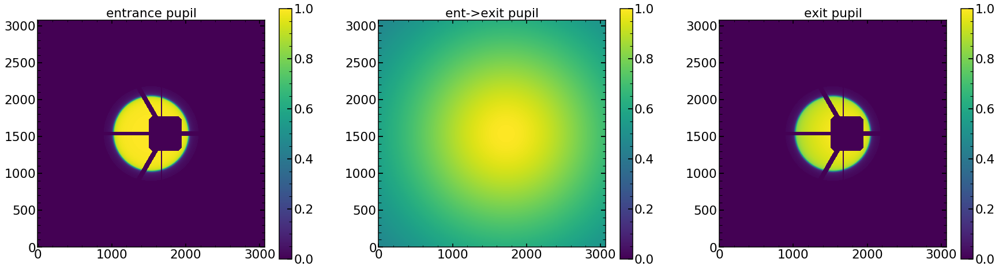

In [9]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

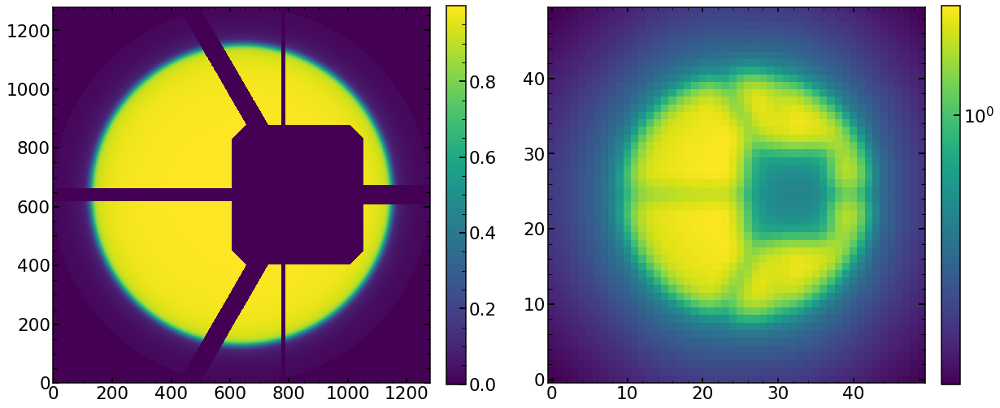

In [10]:
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(pupililluminated,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)
plt.imshow(res_iapetus,norm=LogNorm(),origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([1,10**-2,10**-3,10**-4,10**-5,10,10**2,10**3,10**4,10**5])

## Codes 

In [28]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns11_analysis=columns+['chi2','chi2max']

columns22=['z4','z5','z6','z7','z8','z9','z10','z11',
           'z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

columns22_analysis=columns22+['chi2','chi2max']

def lin_fit_1D(x, a, b):
    return a * x + b

def lin_fit_1DConstant(x, b):
    return  np.full(len(x),b)

def lin_fit_2D(x,y, a, b,c):
    return a * x + b*y+c

In [29]:
def create_minchain_err(chain0,likechain0,sci_image,var_image,old=0):
    minchain_err_test=[]
    if len(chain0[0][0])==42:
        columns=columns22
        
    else:
        columns=columns11
    
    
    
    for var_number in range(len(columns)):
        #ravel likelihood
        likechain0_Emcee3_ravel=np.ravel(likechain0)

        # connect chain and lnchain
        chain0_Emcee3_ravel=np.ravel(chain0[:,:,var_number])
        chain0_Emcee3_ravel_argsort=np.argsort(chain0_Emcee3_ravel)  
        chain0_Emcee3_ravel_sort=chain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]
        likechain0_Emcee3_ravel_sort=likechain0_Emcee3_ravel[chain0_Emcee3_ravel_argsort]

        # move to chi2 space
        chi2_Emcee3_ravel_sort=-(np.array(likechain0_Emcee3_ravel_sort)*(2)-np.log(2*np.pi*np.sum(var_image)))/(sci_image.shape[0])**2
        min_chi2_Emcee3_ravel_sort=np.min(chi2_Emcee3_ravel_sort)

        # simplest standard deviation
        std_chain=np.std(chain0_Emcee3_ravel_sort)

        #best solution
        mean_chain=chain0_Emcee3_ravel_sort[chi2_Emcee3_ravel_sort==np.min(chi2_Emcee3_ravel_sort)][0]

        # step size
        step=std_chain/10

        # create result 3*std in each direction
        try:
            res=[]
            if step==0:
                step=10e-17
            for i in np.arange(mean_chain-30*step,mean_chain+30*step,step):
                selected_chi2_Emcee3_ravel_sort=chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))]
                if len(selected_chi2_Emcee3_ravel_sort>10):   
                    res.append([i+step/2,np.min(chi2_Emcee3_ravel_sort[(np.array(chain0_Emcee3_ravel_sort<i+step)&np.array(chain0_Emcee3_ravel_sort>i))])])

            res=np.array(res)

            #print(columns[var_number]+' min : '+str(mean_chain))
            #print(columns[var_number]+' std : '+str(std_chain))

            # find low limit and high limit
            res_within2_chi=res[res[:,1]<min_chi2_Emcee3_ravel_sort*2]
            minchain_err_element=[-np.abs(mean_chain-res_within2_chi[0,0]),np.abs(res_within2_chi[-1,0]-mean_chain)]
        except IndexError:
            if var_number!=25:
                print(columns[var_number]+': failed!')
                minchain_err_element=[-mean_chain,mean_chain]

        minchain_err_test.append(minchain_err_element)
        #print(columns[var_number]+' min_err : '+str(minchain_err_element[0]))
        #print(columns[var_number]+' max_err : '+str(minchain_err_element[1]))
    if old==1:
        minchain_err_test=np.mean(np.abs(np.array(minchain_err_test)),axis=1)
        #print(minchain_err_test)
        return minchain_err_test
    else:       
        return np.array(minchain_err_test)
    
    
import scipy.optimize as optimize
def curve_fit_custom_lin(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a,b=V
    yfit=lin_fit_1D(index_arr,a,b)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2

def curve_fit_custom_con(V,index_arr,z4_arr,z4_arr_err_low,z4_arr_err_up):
    a=V
    yfit=lin_fit_1DConstant(index_arr,a)
    weight=np.ones_like(yfit)
    weight[yfit>z4_arr]=z4_arr_err_up[yfit>z4_arr] # if the fit point is above the measure, use upper weight
    weight[yfit<=z4_arr]=z4_arr_err_low[yfit<=z4_arr] # else use lower weight
    return (yfit-z4_arr)**2/weight**2 

In [30]:
def create_results_of_fit_single(date,single_number,arc=None,zMax=None,dataset=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
    if dataset is None:
        dataset=1  
        
    if dataset==0:
        if arc=='HgAr':
            obs_possibilites=np.array([8552,8555,8558,8561,8564,8567,8570,8573,8603,8600,8606,8609,8612,8615,8618,8621,8624,8627])
        elif arc=='Ne':
        #    print('Neon?????')
            obs_possibilites=np.array([8552,8555,8558,8561,8564,8567,8570,8573,8603,8600,8606,8609,8612,8615,8618,8621,8624,8627])+90

    # F/3.2 data
    if dataset==1:
        if arc=='HgAr':
            obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
        elif arc=='Ne':
            # different sequence than for HgAr
            obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])    

    # F/2.8 data
    if dataset==2:
        if arc=='HgAr':
            obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
        elif arc=='Ne':
            # different sequence than for HgAr
            obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])
        elif arc=='Kr':
             obs_possibilites=np.array([17310+6,17310+12,17310+18,17310+24,17310+30,17310+36,17310+42,17310+48,17310+54,17310+54,17310+60,17310+66,17310+72,17310+78,17310+84,17310+90,17310+96,17310+102,17310+54])
    # F/2.5 data  
    if dataset==3:
        if arc=='HgAr':
            obs_possibilites=np.array([19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+54,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+102,19238+54])
        elif arc=='Ne':
        # different sequence than for HgAr
            obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54])    

    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis
    
    results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((18,len(columns_analysis))).reshape(-1,len(columns_analysis)),index=['-4.0','-3.5','-3.0','-2.5','-2','-1.5','-1','-0.5','0','0','0.5','1','1.5','2','2.5','3.0','3.5','4'],columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper


def create_results_of_fit_single_focus(date,single_number,arc=None,zMax=None,dataset=None):
    """create solution from a single image, create error and lower and upper erros

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
    @param[in] zMax             biggest Zernike polynomial analysed
    @param[in] dataset          which dataset
    
    @returns       results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper to be fed to solution_at_0_and_plots
    """
    print(zMax)
    if arc is None:
        arc='HgAr'
        
    if arc=='HgAr':
        obs_possibilites=np.array([11748])
        labels=['11748']
    elif arc=='Ne':
        obs_possibilites=np.array([12355])
        labels=['12355']
        
    if dataset==2:
        if arc=='HgAr':
            obs_possibilites=np.array([17017+54])
            labels=['17071']
        elif arc=='Ne':
            obs_possibilites=np.array([16292])
            labels=['16292']
        elif arc=='Kr':
            obs_possibilites=np.array([17364])
            labels=['17364']
            
            
    if dataset==3:
        if arc=='HgAr':
            obs_possibilites=np.array([19238+54])
            labels=['19292']
        elif arc=='Ne':
            obs_possibilites=np.array([19472+54 ])
            labels=['19526']
            
            
            
    if zMax==22:
        columns_analysis=columns22_analysis
    else:
        columns_analysis=columns11_analysis        
        

    results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_lower=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)
    err_results_of_fit_single_upper=pd.DataFrame(np.zeros((len(labels),len(columns_analysis))).reshape(-1,len(columns_analysis)),index=labels,columns=columns_analysis)

    # arrange all results in one pandas 
    #date='Sep19'
    #date='Sep27'
    RESULT_FOLDER='/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+str(date)+'/'

    single_defocus_list=obs_possibilites

    #single_number=55
    image_index=single_number
    method='P'
    eps=5

    res_likelihood=[]

    for single_defocus in range(0,len(single_defocus_list)):
        try:
            obs=single_defocus_list[single_defocus]
            try:
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee3.npy')
                print(str(single_number)+' obs (Emcee3): '+str(obs)+' is found!')
            except:    
                chain=np.load(RESULT_FOLDER+'chain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                likechain=np.load(RESULT_FOLDER+'likechain'+str(date)+'_Single_'+str(method)+'_'+str(obs)+str(single_number)+str(eps)+str(arc)+'Emcee2.npy')
                print(str(single_number)+'obs (Emcee2): '+str(obs)+' is found!')

            if obs==8600:
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked_Dithered.npy')
            else:       
                sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
                #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
                #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

 
            likechain0=likechain

            chain0=chain
            minchain=chain0[np.abs(likechain0)==np.min(np.abs(likechain0))][0]
            chi2reduced=2*np.min(np.abs(likechain0))/(sci_image.shape[0])**2
            #print(" test0")

            """
            minchain_err=[]
            for i in range(len(columns)):
                #minchain_err=np.append(minchain_err,np.std(chain0[:,:,i].flatten()))
                minchain_err=np.append(minchain_err,np.sqrt(chi2reduced)*np.std(chain0[:,:,i].flatten()))

            minchain_err=np.array(minchain_err)
            """
            minchain_err_old=create_minchain_err(chain0,likechain0,sci_image,var_image,old=1)
            #print(minchain_err_old)
            #print(" test1")
            minchain_err=create_minchain_err(chain0,likechain0,sci_image,var_image)
            #print(" test2")
            results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain,np.array([chi2reduced,np.mean(sci_image**2/var_image)])),axis=0)
            #print(" test3")
            #print(results_of_fit_single.iloc[single_defocus])
            err_results_of_fit_single.iloc[single_defocus]=np.concatenate((minchain_err_old,np.array([1,1])),axis=0)
            #print(" test4")
            err_results_of_fit_single_lower.iloc[single_defocus]=np.concatenate((minchain_err[:,0],np.array([1,1])),axis=0)
            #print(" test5")
            err_results_of_fit_single_upper.iloc[single_defocus]=np.concatenate((minchain_err[:,1],np.array([1,1])),axis=0)
            #print(" test6")
        
        except:
            ValueError
            print(str(single_number)+' '+str(obs)+' '+str(arc)+' is NOT found or failed!')
    #results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    #err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    #err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    #err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]              
    
    return results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper

In [31]:
def solution_at_0_and_plots(date,single_number,arc,results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,\
                            plot=True,zMax=None,return_solution_at_05_0_05=None):
    """create solution at the focus and plot dependence with defocu

    @param[in] date             date when the analysis was conducted
    @param[in] single_number    number of the image
    @param[in] arc              which arc was analyzed
  
    """    
    
    if zMax==22:
        columns_analysis=columns22_analysis
        columns=columns22
        z_addition_factor=11
    else:
        columns_analysis=columns11_analysis
        columns=columns11
        z_addition_factor=0
    
    results_of_fit_single=results_of_fit_single[np.abs(results_of_fit_single['z4'])>0]
    err_results_of_fit_single=err_results_of_fit_single[np.abs(err_results_of_fit_single['z4'])>0]
    err_results_of_fit_single_lower=err_results_of_fit_single_lower[np.abs(err_results_of_fit_single_lower['z4'])>0]
    err_results_of_fit_single_upper=err_results_of_fit_single_upper[np.abs(err_results_of_fit_single_upper['z4'])>0]    
    
    if len(results_of_fit_single)<=7:
        if zMax==22:
            solution_at_0=np.full(31+11,0)

        else:
            solution_at_0=np.full(31,0)       

        return solution_at_0
    else:
        IMAGES_FOLDER='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/'

        solution_at_0=[]
        solution_at_05_0_05=[]


        for q in columns_analysis:

            z4_arr=np.array(results_of_fit_single[q])
            z4_arr_err=np.array(err_results_of_fit_single[q])
            z4_arr_err_up=np.array(err_results_of_fit_single_upper[q])
            z4_arr_err_low=np.array(err_results_of_fit_single_lower[q])
            index_arr=results_of_fit_single[q].index.values.astype(float)
            #print(q)
            #print(index_arr)
            #print(z4_arr)
            #print(z4_arr_err)
            #print(z4_arr_err_up)
            #print(z4_arr_err_low)
            
            z4_arr_no0=z4_arr[np.abs(index_arr)>0.5]
            z4_arr_no0_err=z4_arr_err[np.abs(index_arr)>0.5]
            z4_arr_no0_err_up=z4_arr_err_up[np.abs(index_arr)>0.5]
            z4_arr_no0_err_low=z4_arr_err_low[np.abs(index_arr)>0.5]
            index_arr_no0=index_arr[np.abs(index_arr)>0.5]
            #print(q)
            #print(index_arr_no0)
            #print(z4_arr_no0)
            #print(z4_arr_no0_err)
            #print(z4_arr_no0_err_up)
            #print(z4_arr_no0_err_low)
            
            
            z4_arr_only0=z4_arr[np.abs(index_arr)<=0.5]
            z4_arr_only0_err=z4_arr_err[np.abs(index_arr)<=0.5]
            z4_arr_only0_err_up=z4_arr_err_up[np.abs(index_arr)<=0.5] 
            z4_arr_only0_err_low=z4_arr_err_low[np.abs(index_arr)<=0.5]
            index_arr_only0=index_arr[np.abs(index_arr)<=0.5]

            fit_res=[]
            fit_res_focus=[]
            interim_zero_solutions=[]

            
            if q in columns[:8+z_addition_factor]:
                # these variables are fit via linear fit, without values at focus
                # it is z4-z11
                # for loop below removes 2 points from the fit that create largest deviations from median result in focus
                for l in range(len(index_arr_no0)):
                    #print('good_index'+str(np.delete(index_arr_no0,l)))
                    #print('index_arr_no0'+str(np.delete(z4_arr_no0,l)))
                    #print('z4_arr_no0_err_low'+str(np.delete(z4_arr_no0_err_low,l)))
                    #print('z4_arr_no0_err_up'+str(np.delete(z4_arr_no0_err_up,l)))
                    popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,lin_fit_1D(0,popt[0],popt[1])])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                second_max_dif=np.sort(interim_zero_solutions_arr_dif)[-2]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<second_max_dif]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                #print('good_index'+str(good_index))
                #print('index_arr_no0'+str(index_arr_no0))
                #print('z4_arr_no0_err_low'+str(z4_arr_no0_err_low))
                #print('z4_arr_no0_err_up'+str(z4_arr_no0_err_up))
                popt=optimize.leastsq(curve_fit_custom_lin,x0=[1,1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]

                for i in np.linspace(-4.5,4.5,19):
                    fit_res.append(lin_fit_1D(i,popt[0],popt[1]))
                for j in np.linspace(-0.5,0.5,11):
                    fit_res_focus.append(lin_fit_1D(j,popt[0],popt[1]))
                    
                solution_at_0.append(fit_res[9])
                solution_at_05_0_05.append(fit_res_focus)

            interim_zero_solutions=[]
            if q in columns[8+z_addition_factor:25+z_addition_factor]:
                # these variables are set at mean value (constant fit), without values at focus
                # these are variables that describe the pupil
                for l in range(len(index_arr_no0)):
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.delete(index_arr_no0,l),np.delete(z4_arr_no0,l), np.delete(z4_arr_no0_err_low,l),np.delete(z4_arr_no0_err_up,l)))[0]
                    interim_zero_solutions.append([l,popt[0]])
                interim_zero_solutions_arr=np.array(interim_zero_solutions)
                interim_zero_solutions_arr_dif=np.abs(interim_zero_solutions_arr[:,1]-np.median(interim_zero_solutions_arr[:,1]))
                third_max_dif=np.sort(interim_zero_solutions_arr_dif)[-3]
                interim_zero_solutions_arr=interim_zero_solutions_arr[interim_zero_solutions_arr_dif<=(third_max_dif*1.1)]
                #print(interim_zero_solutions_arr[:,0])
                good_index=interim_zero_solutions_arr[:,0].astype(int)
                popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(np.array(index_arr_no0)[good_index],np.array(z4_arr_no0)[good_index],np.array(z4_arr_no0_err_low)[good_index],np.array(z4_arr_no0_err_up)[good_index]))[0]
                
                fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                fit_res_focus=lin_fit_1DConstant(np.linspace(-0.5,0.5,11),popt[0])
                
                solution_at_0.append(fit_res[9])
                solution_at_05_0_05.append(fit_res_focus)

            if q in np.concatenate((np.array(columns[25+z_addition_factor:]),np.array(['chi2','chi2max'])),axis=0):
                # these variables are set at value as measured at 0 - (perhaps is should be close to 0)
                if z4_arr_only0.size==1:
                    for i in np.linspace(-4.5,4.5,19):
                        fit_res.append(z4_arr_only0) 
                    
                    for j in np.linspace(-0.5,0.5,11):
                        fit_res_focus.append(z4_arr_only0)
                    
                    solution_at_0.append(fit_res[9])
                    solution_at_05_0_05.append(fit_res_focus)
                else:
                    # these variables are set at mean value (constant fit), without values at focus
                    popt=optimize.leastsq(curve_fit_custom_con,x0=[1],args=(index_arr_only0, z4_arr_only0, z4_arr_only0_err_low,z4_arr_only0_err_up))[0]
                    fit_res=lin_fit_1DConstant(np.linspace(-4.5,4.5,19),popt[0])
                    fit_res_focus=lin_fit_1DConstant(np.linspace(-0.5,0.5,11),popt[0]) 
                    
                    solution_at_0.append(fit_res[9])
                    solution_at_05_0_05.append(fit_res_focus)

            #making plots here
            ######
            #print(q)
            #print(fit_res)
            plt.figure(figsize=(20,10))
            plt.errorbar(index_arr,z4_arr,yerr=[np.abs(z4_arr_err_low),z4_arr_err_up],color='blue',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='single fit results')
            plt.plot(np.linspace(-4.5,4.5,19),fit_res,color='orange',label='fit')
            if q in columns[:8]:
                plt.plot(np.linspace(-4.5,4.5,19),np.zeros((19,1)),':',color='black')
            plt.plot([0], [fit_res[9]], marker='o', markersize=10, color="red",label='prediction for focus')
            #print('prediction for focus: '+str(q)+' '+str(fit_res[9]))
            plt.title(q,size=40)
            plt.legend(fontsize=25)
            plt.xlabel('defocus lab [mm]',size=30)
            plt.ylabel('defocus model',size=30)
            #print(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(single_number)+'/'+str(arc)+str(q))

            if not os.path.exists(IMAGES_FOLDER+'Defocus/'+str(q)+'/'):
                os.makedirs(IMAGES_FOLDER+'Defocus/'+str(q)+'/')
            plt.savefig(IMAGES_FOLDER+'Defocus/'+str(q)+'/'+str(arc)+str(single_number))

            plt.close()   
            ######

        solution_at_0=np.array(solution_at_0)[:len(solution_at_0)-2]
        
        solution_at_05_0_05=np.transpose(np.array(solution_at_05_0_05[0:42]))
        
        if return_solution_at_05_0_05 is None:
            return solution_at_0
        else:
            return solution_at_0,solution_at_05_0_05

In [32]:
def residual_1D(sci_image,var_image,res_iapetus):
    
    """

    @param[in] sci_image        data (20x20 cutout)
    @param[in] var_image        Variance data (20x20 cutout)
    @param[in] res_iapetus      model (20x20 cutout)
    """

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_smaller=sci_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    var_image_smaller=var_image[:,8:14]/multiplicative_factor_to_renormalize_to_50000

    residual_initial_smaller=sci_image_smaller-res_iapetus[:,8:14]/multiplicative_factor_to_renormalize_to_50000
    #residual_RF_smaller=chi_RF_corrected_image[:,8:14]*np.sqrt(var_image_smaller)

    #################################
    # step 5 from Horne, very simplified
    inputimage_smaller=sci_image_smaller
    Px=np.sum(inputimage_smaller,axis=0)/np.sum(inputimage_smaller)
    var_inputimage_smaller=var_image_smaller
    #################################
    # Equation 8 from Horne with modification from Robert abut variance for extraction of signal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=inputimage_smaller*Px/(1)
    # denominator
    weights_array=np.ones((inputimage_smaller.shape[0],inputimage_smaller.shape[1]))*Px**2

    init_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_lamda_boxcar=np.array(list(map(np.sum, inputimage_smaller)))
    # Equation 8.5 from Horne
    var_f_std_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_lamda=np.sqrt(var_f_std_lamda)
    std_init_lamda_boxcar=np.sqrt(np.array(list(map(np.sum, var_inputimage_smaller))))


    #################################
    # Equation 8 from Horne with modification from Robert abut variance for initial removal
    # note that this uses profile from full thing, and not "residual profile"

    # nominator
    weighted_inputimage_smaller=residual_initial_smaller*Px/(1)
    # denominator
    weights_array=np.ones((residual_initial_smaller.shape[0],residual_initial_smaller.shape[1]))*Px**2

    init_removal_lamda=np.array(list(map(np.sum, weighted_inputimage_smaller)))/(np.array(list(map(np.sum,weights_array))))
    init_removal_lamda_boxcar=np.array(list(map(np.sum, residual_initial_smaller)))
    # Equation 8.5 from Horne
    var_init_removal_lamda=1/np.sum(np.array(Px**2/(var_inputimage_smaller)),axis=1)
    std_init_removal_lamda=np.sqrt(var_init_removal_lamda)
    return init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda

def chi_50000(sci_image,var_image,res_iapetus):

    #sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')    
    multiplicative_factor_to_renormalize_to_50000=np.max(sci_image)/50000
    sci_image_renormalized=sci_image/multiplicative_factor_to_renormalize_to_50000
    var_image_renormalized=var_image/multiplicative_factor_to_renormalize_to_50000
    res_iapetus_renormalized=res_iapetus/multiplicative_factor_to_renormalize_to_50000
    

    return np.mean((sci_image_renormalized-res_iapetus_renormalized)**2/var_image_renormalized)

In [33]:
def add_artificial_noise(sci_image,var_image,res_iapetus):
    
    """
    add extra noise so that it has comparable noise as if the max flux in the image (in the single pixel) is 40000
    
    
    """

    
    multi_factor=np.max(sci_image)/40000
    Max_SN_now=np.max(sci_image)/np.max(np.sqrt(var_image))
    dif_in_SN=Max_SN_now/200
    artifical_noise=np.zeros_like(res_iapetus)
    artifical_noise=np.array(artifical_noise)
    for i in range(len(artifical_noise)):
        for j in range(len(artifical_noise)):
            artifical_noise[i,j]=np.random.randn()*np.sqrt((dif_in_SN**2-1)*var_image[i,j])   
            
    if dif_in_SN>1:        
        return (sci_image+artifical_noise),((dif_in_SN**2)*var_image),res_iapetus
    else:
        return (sci_image),((dif_in_SN**2)*var_image),res_iapetus 

# Compare result of the fits to the real data with the outputs from Zemax (PIPE2D-421)

## prepare positions

In [75]:
from astropy.io import fits
detectorMapOriginal=fits.open('/Users/nevencaplar/Documents/PFS/DetectorMap/detectorMap-sim-1-r.fits')

hdu = detectorMapOriginal["FIBERID"]
fiberIds = hdu.data
fiberIds = fiberIds.astype(np.int32) 
fiberIds.shape

list_of_illuminated_slit_fibers_in_January_24_data=[32,63,111,192,223,255,289,308,342,401,418,464,518,525,587,620]

list_of_illuminated_science_fibers_in_January_24_data=[]
for i in list_of_illuminated_slit_fibers_in_January_24_data:
    list_of_illuminated_science_fibers_in_January_24_data.append(np.where(fiberIds==i)[0][0])
    
list_of_illuminated_science_fibers_in_January_24_data


detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_x=[]
detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_y=[]
for j in list_of_illuminated_science_fibers_in_January_24_data:
    print(j)
    detectorMapOriginal_single_fiber_x=detectorMapOriginal[3].data[detectorMapOriginal[3].data['index']==j]    
    detectorMapOriginal_single_fiber_y=detectorMapOriginal[4].data[detectorMapOriginal[4].data['index']==j]
    
    detectorMapOriginal_single_fiber_as_list_x=[]
    detectorMapOriginal_single_fiber_as_list_y=[]
    # because I do not know how to work with numpy.record
    for i in range(len(detectorMapOriginal_single_fiber_y)):
        detectorMapOriginal_single_fiber_as_list_x.append(list(detectorMapOriginal_single_fiber_x[i]))
        detectorMapOriginal_single_fiber_as_list_y.append(list(detectorMapOriginal_single_fiber_y[i]))
        
    detectorMapOriginal_single_fiber_as_array_x=np.array(detectorMapOriginal_single_fiber_as_list_x)
    detectorMapOriginal_single_fiber_as_array_y=np.array(detectorMapOriginal_single_fiber_as_list_y)
    detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_x.append(detectorMapOriginal_single_fiber_as_array_x)
    detectorMapOriginal_for_illuminated_fiber_Jan_24_2019_as_list_y.append(detectorMapOriginal_single_fiber_as_array_y)

30
59
104
180
211
241
273
292
305
362
379
423
472
479
538
569


In [76]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]


list_of_dy_values_in_fibers=[]
for fibers in [303,271,239,209,176,146,116,84,52,22,5,595,328,359,390,423,453,484,514,547,578]:
    list_of_values=[]
    for wavelengths in [630,664,698,732,766,800,834,868,902,936,970]:
        nearest_value=find_nearest(np.array(detectorMapOriginal[4].data[detectorMapOriginal[3].data['index']==fibers])['value'],wavelengths)
        index_of_value=list(np.array(detectorMapOriginal[4].data[detectorMapOriginal[3].data['index']==fibers])['value']).index(nearest_value)
        list_of_values.append(index_of_value)
    list_of_dy_values_in_fibers.append(list_of_values)

In [77]:
list_of_dy_values_in_fibers=np.transpose(np.array(list_of_dy_values_in_fibers)).ravel()
list_of_dy_values_in_fibers

array([  82,   83,   84,   86,   88,   91,   95,  100,  105,  110,  113,
        113,   83,   84,   86,   88,   91,   95,  100,  105,  110,  478,
        478,  480,  482,  484,  488,  492,  497,  502,  508,  511,  512,
        478,  480,  482,  484,  488,  492,  497,  502,  508,  873,  874,
        875,  877,  880,  884,  888,  894,  900,  906,  910,  910,  874,
        875,  877,  880,  884,  889,  894,  900,  907, 1269, 1269, 1271,
       1273, 1276, 1280, 1285, 1291, 1298, 1305, 1309, 1309, 1269, 1271,
       1273, 1276, 1280, 1285, 1291, 1298, 1305, 1664, 1665, 1667, 1669,
       1672, 1677, 1682, 1688, 1695, 1703, 1707, 1708, 1665, 1666, 1669,
       1672, 1677, 1682, 1688, 1695, 1703, 2060, 2060, 2062, 2065, 2068,
       2073, 2078, 2085, 2093, 2101, 2106, 2106, 2060, 2062, 2065, 2068,
       2073, 2079, 2085, 2093, 2101, 2455, 2456, 2458, 2460, 2464, 2469,
       2475, 2483, 2490, 2499, 2505, 2505, 2456, 2458, 2460, 2464, 2469,
       2475, 2482, 2490, 2500, 2851, 2851, 2853, 28

## import focus

In [831]:
def rotate_WaveField(minchain_wave_11_field_11):
    WaveField_upper_left_only_z4_to_z22=np.copy(minchain_wave_11_field_11[3:22])
    WaveField_upper_left_only_z4_to_z22_modified=np.zeros((19))

    # z4_new = z4_old
    WaveField_upper_left_only_z4_to_z22_modified[0]=WaveField_upper_left_only_z4_to_z22[0]

    # z5_new = -z5_old
    WaveField_upper_left_only_z4_to_z22_modified[0+1]=-WaveField_upper_left_only_z4_to_z22[0+1]
    # z6_new = -z6_old
    WaveField_upper_left_only_z4_to_z22_modified[1+1]=-WaveField_upper_left_only_z4_to_z22[1+1]
    
    # z7_new = z8_old
    WaveField_upper_left_only_z4_to_z22_modified[2+1]=WaveField_upper_left_only_z4_to_z22[3+1]
    # z8_new = -z7_old
    WaveField_upper_left_only_z4_to_z22_modified[3+1]=-WaveField_upper_left_only_z4_to_z22[2+1]
    
    # z9_new = -z10_old
    WaveField_upper_left_only_z4_to_z22_modified[4+1]=-WaveField_upper_left_only_z4_to_z22[5+1]
    # z10_new = z9_old
    WaveField_upper_left_only_z4_to_z22_modified[5+1]=WaveField_upper_left_only_z4_to_z22[4+1]
    
    # z11_new = z11_old
    WaveField_upper_left_only_z4_to_z22_modified[6+1]=WaveField_upper_left_only_z4_to_z22[6+1]
    
    # z12_new = -z12_old
    WaveField_upper_left_only_z4_to_z22_modified[7+1]=-WaveField_upper_left_only_z4_to_z22[7+1]
    # z13_new = -z13_old
    WaveField_upper_left_only_z4_to_z22_modified[8+1]=-WaveField_upper_left_only_z4_to_z22[8+1]
    
    # z14_new = z14_old
    WaveField_upper_left_only_z4_to_z22_modified[9+1]=WaveField_upper_left_only_z4_to_z22[9+1]
    # z15_new = z15_old
    WaveField_upper_left_only_z4_to_z22_modified[10+1]=WaveField_upper_left_only_z4_to_z22[10+1]
    
    # z16_new = -z17_old
    WaveField_upper_left_only_z4_to_z22_modified[11+1]=-WaveField_upper_left_only_z4_to_z22[12+1]
    # z17_new = z16_old
    WaveField_upper_left_only_z4_to_z22_modified[12+1]=-WaveField_upper_left_only_z4_to_z22[11+1]
    
    # z18_new = z19_old
    WaveField_upper_left_only_z4_to_z22_modified[13+1]=WaveField_upper_left_only_z4_to_z22[14+1]
    # z19_new = -z18_old
    WaveField_upper_left_only_z4_to_z22_modified[14+1]=-WaveField_upper_left_only_z4_to_z22[13+1]
    
    # z20_new = -z21_old
    WaveField_upper_left_only_z4_to_z22_modified[15+1]=-WaveField_upper_left_only_z4_to_z22[16+1]
    # z21_new = z20_old
    WaveField_upper_left_only_z4_to_z22_modified[16+1]=WaveField_upper_left_only_z4_to_z22[15+1]

    minchain_wave_11_field_11_rotated=np.copy(minchain_wave_11_field_11)
    minchain_wave_11_field_11_rotated[3:22]=WaveField_upper_left_only_z4_to_z22_modified
    return minchain_wave_11_field_11_rotated

In [78]:
wave_position=[]
for i in range(11):
    wave_position.append(int(i*4096/10))
    
wave_position

[0, 409, 819, 1228, 1638, 2048, 2457, 2867, 3276, 3686, 4096]

In [832]:
#wave_position=[100,425,840,1230,1650,2020,2400,2740,3200,3600,4000]
field_position=[2048,2252,2457,2662,2867,3072,3276,3481,3686,3891,4096,0,1843,1638,1433,1228,1024,819,614,409,204]

postion_res=[]
WaveField_res=[]
WaveField_res_0=[]
for wave in [1,2,3,4,5,6,7,8,9,10,11]:
    for field in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]:
        f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July8_focus/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
        lines=f.read()
        # Reading of file
        #WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter=b'\t')
        WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
        WaveField_res.append(rotate_WaveField(WaveField))
        WaveField_res_0.append(rotate_WaveField(WaveField))
        postion_res.append([wave_position[wave-1],field_position[field-1]])

In [833]:
def wavelength_correction(single_Zernike_res_z5):

    res=[]
    wavelengths=[630,664,698,732,766,800,834,868,902,936,970]
    for i in range(11):
        wavelength=wavelengths[i]
        res.append((np.split(np.array(single_Zernike_res_z5),11)[i])*(wavelength/800))
    res=np.array(res)
    return res.ravel()

In [834]:
Zemax_number=4
single_Zernike_res_z2=[]
single_Zernike_res_z3=[]
single_Zernike_res_z4=[]
single_Zernike_res_z5=[]
single_Zernike_res_z6=[]
single_Zernike_res_z7=[]
single_Zernike_res_z8=[]
single_Zernike_res_z9=[]
single_Zernike_res_z10=[]
single_Zernike_res_z11=[]
single_Zernike_res_z12=[]
single_Zernike_res_z13=[]
single_Zernike_res_z14=[]
single_Zernike_res_z15=[]
single_Zernike_res_z16=[]
single_Zernike_res_z17=[]
single_Zernike_res_z18=[]
single_Zernike_res_z19=[]
single_Zernike_res_z20=[]
single_Zernike_res_z21=[]
single_Zernike_res_z22=[]
single_Zernike_res_z74=[]
single_Zernike_res_z159=[]





position_Zernike_res=[]

for i in range(len(WaveField_res)):
    single_Zernike_res_z2.append(WaveField_res[i][2-1])   
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z2_wavelength_corrected=wavelength_correction(single_Zernike_res_z2)

for i in range(len(WaveField_res)):
    single_Zernike_res_z3.append(WaveField_res[i][3-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z3_wavelength_corrected=wavelength_correction(single_Zernike_res_z3)


for i in range(len(WaveField_res)):
    single_Zernike_res_z4.append(WaveField_res[i][4-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z4_wavelength_corrected=wavelength_correction(single_Zernike_res_z4)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z5.append(WaveField_res[i][5-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected=wavelength_correction(single_Zernike_res_z5)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z6.append(WaveField_res[i][6-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z6_wavelength_corrected=wavelength_correction(single_Zernike_res_z6)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z7.append(WaveField_res[i][7-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z7_wavelength_corrected=wavelength_correction(single_Zernike_res_z7)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z8.append(WaveField_res[i][8-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z8_wavelength_corrected=wavelength_correction(single_Zernike_res_z8)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z9.append(WaveField_res[i][9-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z9_wavelength_corrected=wavelength_correction(single_Zernike_res_z9)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z10.append(WaveField_res[i][10-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z10_wavelength_corrected=wavelength_correction(single_Zernike_res_z10)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z11.append(WaveField_res[i][11-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z11_wavelength_corrected=wavelength_correction(single_Zernike_res_z11)

for i in range(len(WaveField_res)):
    single_Zernike_res_z12.append(WaveField_res[i][12-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z12_wavelength_corrected=wavelength_correction(single_Zernike_res_z12)

for i in range(len(WaveField_res)):
    single_Zernike_res_z13.append(WaveField_res[i][13-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z13_wavelength_corrected=wavelength_correction(single_Zernike_res_z13)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z14.append(WaveField_res[i][14-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z14_wavelength_corrected=wavelength_correction(single_Zernike_res_z14)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z15.append(WaveField_res[i][15-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z15_wavelength_corrected=wavelength_correction(single_Zernike_res_z15)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z16.append(WaveField_res[i][16-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z16_wavelength_corrected=wavelength_correction(single_Zernike_res_z16)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z17.append(WaveField_res[i][17-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z17_wavelength_corrected=wavelength_correction(single_Zernike_res_z17)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z18.append(WaveField_res[i][18-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z18_wavelength_corrected=wavelength_correction(single_Zernike_res_z18)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z19.append(WaveField_res[i][19-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z19_wavelength_corrected=wavelength_correction(single_Zernike_res_z19)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z20.append(WaveField_res[i][20-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z20_wavelength_corrected=wavelength_correction(single_Zernike_res_z20)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z21.append(WaveField_res[i][21-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z21_wavelength_corrected=wavelength_correction(single_Zernike_res_z21)

for i in range(len(WaveField_res)):
    single_Zernike_res_z159.append(WaveField_res[i][159-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z159_wavelength_corrected=wavelength_correction(single_Zernike_res_z159)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z74.append(WaveField_res[i][74-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z74_wavelength_corrected=wavelength_correction(single_Zernike_res_z74)    
    
position_Zernike_res=[]   
for i in range(len(WaveField_res)):
    single_Zernike_res_z22.append(WaveField_res[i][22-1])
    position_Zernike_res.append(postion_res[i])   

single_Zernike_res_z22_wavelength_corrected=wavelength_correction(single_Zernike_res_z22)
    
    
position_Zernike_res=np.array(position_Zernike_res)

In [835]:
x=np.array(position_Zernike_res[:,1])
#y=np.array(position_Zernike_res[:,0])
y=list_of_dy_values_in_fibers
colors=np.array(single_Zernike_res_z4)

median_color=np.median(colors)
up_limit=np.abs(max(colors)-median_color)
low_limit=np.abs(min(colors)-median_color)
max_dif=np.max([low_limit,up_limit])
min_dif=np.min([low_limit,up_limit])
max_colors=median_color+(min_dif+max_dif)/2
min_colors=median_color-(min_dif+max_dif)/2

area=250

In [836]:
y=np.concatenate((np.full(21,np.median(list_of_dy_values_in_fibers[:21])),np.full(21,np.median(list_of_dy_values_in_fibers[22:22+21])),np.full(21,np.median(list_of_dy_values_in_fibers[43:43+21]))
               ,np.full(21,np.median(list_of_dy_values_in_fibers[64:64+21])),np.full(21,np.median(list_of_dy_values_in_fibers[85:85+21])),np.full(21,np.median(list_of_dy_values_in_fibers[106:106+21]))
               ,np.full(21,np.median(list_of_dy_values_in_fibers[127:127+21])),np.full(21,np.median(list_of_dy_values_in_fibers[148:148+21])),np.full(21,np.median(list_of_dy_values_in_fibers[169:169+21]))
               ,np.full(21,np.median(list_of_dy_values_in_fibers[190:190+21])),np.full(21,np.median(list_of_dy_values_in_fibers[211:211+21]))),axis=0)

In [837]:
def rotate_around_point_lowperf(point, radians, origin=(0, 0)):
    """Rotate a point around a given point.
    
    I call this the "low performance" version since it's recalculating
    the same values more than once [cos(radians), sin(radians), x-ox, y-oy).
    It's more readable than the next function, though.
    """
    x, y = point
    ox, oy = origin

    qx = ox + math.cos(radians) * (x - ox) + math.sin(radians) * (y - oy)
    qy = oy + -math.sin(radians) * (x - ox) + math.cos(radians) * (y - oy)

    return qx, qy

In [838]:
x_rotated=[]
y_rotated=[]
for i in range(len(x)):
    x_rotated.append(rotate_around_point_lowperf((x[i],y[i]),np.pi/2,origin=(2048,2048))[0])
    y_rotated.append(rotate_around_point_lowperf((x[i],y[i]),np.pi/2,origin=(2048,2048))[1])
    
x_rotated=np.array(x_rotated)
y_rotated=np.array(y_rotated)

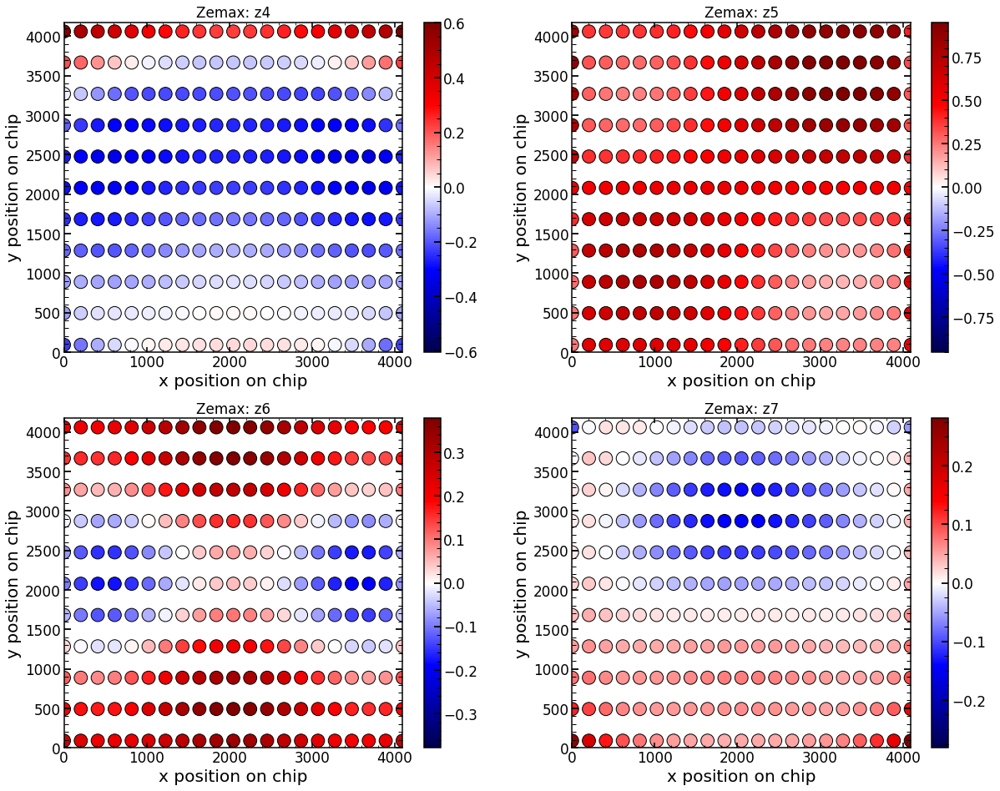

In [839]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z4))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
#plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(4))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z5))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(5))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z6))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(6))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z7))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(7))
plt.colorbar()

## import defocus

In [91]:
wave_position=[]
for i in range(11):
    wave_position.append(int(i*4096/10))
    
wave_position

[0, 409, 819, 1228, 1638, 2048, 2457, 2867, 3276, 3686, 4096]

In [840]:
#wave_position=[0,425,840,1230,1650,2020,2400,2740,3200,3600,4000]
field_position=[2048,2252,2457,2662,2867,3072,3276,3481,3686,3891,4096,0,1843,1638,1433,1228,1024,819,614,409,204]

postion_res=[]
WaveField_res=[]
WaveField_res_m4=[]
for wave in [1,2,3,4,5,6,7,8,9,10,11]:
    for field in [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]:
        f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July8/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
        lines=f.read()
        # Reading of file
        #WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter=b'\t')
        WaveField = np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
        WaveField_res.append(rotate_WaveField(WaveField))
        WaveField_res_m4.append(rotate_WaveField(WaveField))
        postion_res.append([wave_position[wave-1],field_position[field-1]])

In [841]:
def wavelength_correction(single_Zernike_res_z5):

    res=[]
    wavelengths=[630,664,698,732,766,800,834,868,902,936,970]
    for i in range(11):
        wavelength=wavelengths[i]
        res.append((np.split(np.array(single_Zernike_res_z5),11)[i])*(wavelength/800))
    res=np.array(res)
    return res.ravel()

In [842]:
def wavelength_correction_single(WaveField,wv):

    res=[]
    for i in range(len(WaveField)):
        res.append(WaveField[i]*(wv/800))
    res=np.array(res)
    return res.ravel()

In [843]:
Zemax_number=4
single_Zernike_res_z2=[]
single_Zernike_res_z3=[]
single_Zernike_res_z4=[]
single_Zernike_res_z5=[]
single_Zernike_res_z6=[]
single_Zernike_res_z7=[]
single_Zernike_res_z8=[]
single_Zernike_res_z9=[]
single_Zernike_res_z10=[]
single_Zernike_res_z11=[]
single_Zernike_res_z12=[]
single_Zernike_res_z13=[]
single_Zernike_res_z14=[]
single_Zernike_res_z15=[]
single_Zernike_res_z16=[]
single_Zernike_res_z17=[]
single_Zernike_res_z18=[]
single_Zernike_res_z19=[]
single_Zernike_res_z20=[]
single_Zernike_res_z21=[]
single_Zernike_res_z22=[]
single_Zernike_res_z74=[]
single_Zernike_res_z159=[]





position_Zernike_res=[]

for i in range(len(WaveField_res)):
    single_Zernike_res_z2.append(WaveField_res[i][2-1])   
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z2_wavelength_corrected=wavelength_correction(single_Zernike_res_z2)

for i in range(len(WaveField_res)):
    single_Zernike_res_z3.append(WaveField_res[i][3-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z3_wavelength_corrected=wavelength_correction(single_Zernike_res_z3)


for i in range(len(WaveField_res)):
    single_Zernike_res_z4.append(WaveField_res[i][4-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z4_wavelength_corrected=wavelength_correction(single_Zernike_res_z4)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z5.append(WaveField_res[i][5-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected=wavelength_correction(single_Zernike_res_z5)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z6.append(WaveField_res[i][6-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z6_wavelength_corrected=wavelength_correction(single_Zernike_res_z6)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z7.append(WaveField_res[i][7-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z7_wavelength_corrected=wavelength_correction(single_Zernike_res_z7)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z8.append(WaveField_res[i][8-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z8_wavelength_corrected=wavelength_correction(single_Zernike_res_z8)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z9.append(WaveField_res[i][9-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z9_wavelength_corrected=wavelength_correction(single_Zernike_res_z9)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z10.append(WaveField_res[i][10-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z10_wavelength_corrected=wavelength_correction(single_Zernike_res_z10)

    
for i in range(len(WaveField_res)):
    single_Zernike_res_z11.append(WaveField_res[i][11-1])
    position_Zernike_res.append(postion_res[i])
single_Zernike_res_z11_wavelength_corrected=wavelength_correction(single_Zernike_res_z11)

for i in range(len(WaveField_res)):
    single_Zernike_res_z12.append(WaveField_res[i][12-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z12_wavelength_corrected=wavelength_correction(single_Zernike_res_z12)

for i in range(len(WaveField_res)):
    single_Zernike_res_z13.append(WaveField_res[i][13-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z13_wavelength_corrected=wavelength_correction(single_Zernike_res_z13)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z14.append(WaveField_res[i][14-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z14_wavelength_corrected=wavelength_correction(single_Zernike_res_z14)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z15.append(WaveField_res[i][15-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z15_wavelength_corrected=wavelength_correction(single_Zernike_res_z15)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z16.append(WaveField_res[i][16-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z16_wavelength_corrected=wavelength_correction(single_Zernike_res_z16)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z17.append(WaveField_res[i][17-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z17_wavelength_corrected=wavelength_correction(single_Zernike_res_z17)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z18.append(WaveField_res[i][18-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z18_wavelength_corrected=wavelength_correction(single_Zernike_res_z18)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z19.append(WaveField_res[i][19-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z19_wavelength_corrected=wavelength_correction(single_Zernike_res_z19)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z20.append(WaveField_res[i][20-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z20_wavelength_corrected=wavelength_correction(single_Zernike_res_z20)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z21.append(WaveField_res[i][21-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z21_wavelength_corrected=wavelength_correction(single_Zernike_res_z21)

for i in range(len(WaveField_res)):
    single_Zernike_res_z159.append(WaveField_res[i][159-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z159_wavelength_corrected=wavelength_correction(single_Zernike_res_z159)
    
for i in range(len(WaveField_res)):
    single_Zernike_res_z74.append(WaveField_res[i][74-1])
    position_Zernike_res.append(postion_res[i])   
single_Zernike_res_z74_wavelength_corrected=wavelength_correction(single_Zernike_res_z74)    
    
position_Zernike_res=[]   
for i in range(len(WaveField_res)):
    single_Zernike_res_z22.append(WaveField_res[i][22-1])
    position_Zernike_res.append(postion_res[i])   

single_Zernike_res_z22_wavelength_corrected=wavelength_correction(single_Zernike_res_z22)
    
    
position_Zernike_res=np.array(position_Zernike_res)

In [844]:
x=np.array(position_Zernike_res[:,1])
#y=np.array(position_Zernike_res[:,0])
y=list_of_dy_values_in_fibers
colors=np.array(single_Zernike_res_z4)

median_color=np.median(colors)
up_limit=np.abs(max(colors)-median_color)
low_limit=np.abs(min(colors)-median_color)
max_dif=np.max([low_limit,up_limit])
min_dif=np.min([low_limit,up_limit])
max_colors=median_color+(min_dif+max_dif)/2
min_colors=median_color-(min_dif+max_dif)/2

area=250

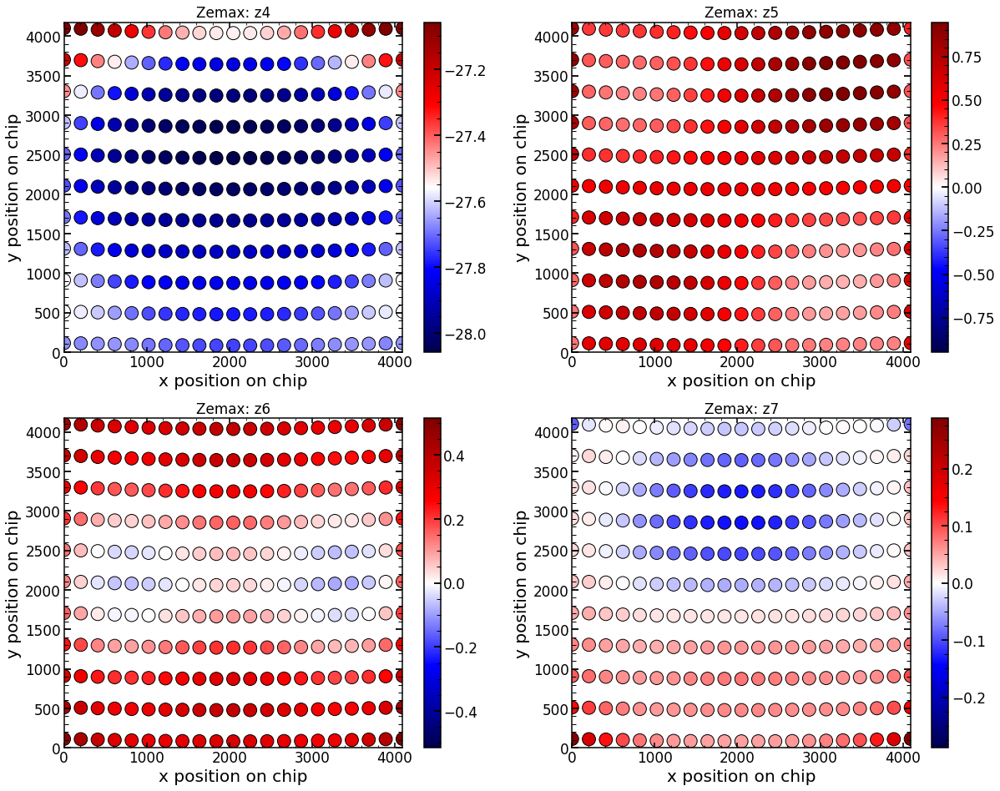

In [846]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
values=np.array(wavelength_correction(single_Zernike_res_z4))
#print(values)
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=-np.max(np.abs(values))+1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(4))
plt.colorbar()

plt.subplot(2,2,2)
values=np.array(wavelength_correction(single_Zernike_res_z5))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(5))
plt.colorbar()

plt.subplot(2,2,3)
values=np.array(wavelength_correction(single_Zernike_res_z6))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(6))
plt.colorbar()

plt.subplot(2,2,4)
values=np.array(wavelength_correction(single_Zernike_res_z7))
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-np.max(np.abs(values)), vmax=np.max(np.abs(values)),edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax: z'+str(7))
plt.colorbar()

## create results

In [849]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  

In [850]:
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019
date='Jun13'

In [290]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

#with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'wb') as f:
#    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
#with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'wb') as f:
#    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [851]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'
results_of_fit_many_HgAr=np.load(DATAFRAMES_FOLDER+'results_of_fit_many_direct_HgAr_from_Jun13.pkl')
results_of_fit_many_Ne=np.load(DATAFRAMES_FOLDER+'results_of_fit_many_direct_Ne_from_Jun13.pkl')

In [852]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  

finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019
j=0
i=0
zMax=22
date='Jun13'

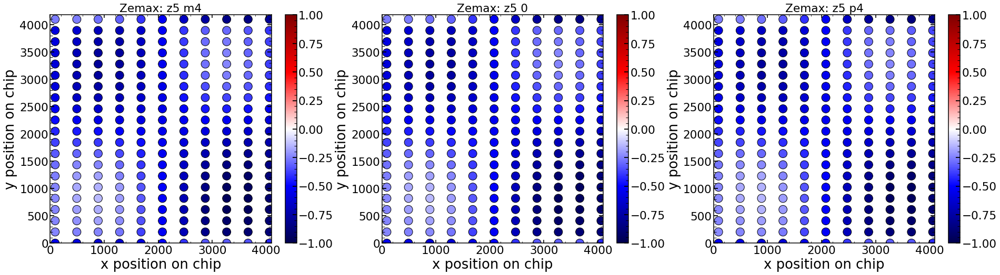

In [293]:
zernike_order=5

defocus_values=[0,4]
position_Zernike_res_0=[]
single_Zernike_res_z5_0=[]
for i in range(len(WaveField_res_0)):
    single_Zernike_res_z5_0.append(WaveField_res_0[i][zernike_order-1])
    position_Zernike_res_0.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected_0=wavelength_correction(single_Zernike_res_z5_0)

# it is actually p4!!!
position_Zernike_res_m4=[]
single_Zernike_res_z5_m4=[]
for i in range(len(WaveField_res_m4)):
    single_Zernike_res_z5_m4.append(WaveField_res_m4[i][zernike_order-1])
    position_Zernike_res_m4.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected_m4=wavelength_correction(single_Zernike_res_z5_m4)

single_Zernike_res_z5_wavelength_corrected_p4=np.zeros_like(single_Zernike_res_z5_wavelength_corrected_0)
for i in range(len(single_Zernike_res_z5_wavelength_corrected_p4)):
    zernike_values=[single_Zernike_res_z5_wavelength_corrected_0[i],single_Zernike_res_z5_wavelength_corrected_m4[i]]
    z = np.polyfit(defocus_values, zernike_values, 1)
    p = np.poly1d(z)
    single_Zernike_res_z5_wavelength_corrected_p4[i]=p(-4)
    
if zernike_order==4:
    
    plt.figure(figsize=(32,8))

    values=single_Zernike_res_z5_wavelength_corrected_p4
    plt.subplot(1,3,1)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=26, vmax=28,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' m4')
    plt.colorbar()


    values=single_Zernike_res_z5_wavelength_corrected_0
    plt.subplot(1,3,2)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' 0')
    plt.colorbar()

    values=single_Zernike_res_z5_wavelength_corrected_m4
    plt.subplot(1,3,3)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-26, vmax=-28,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' p4')
    plt.colorbar()
    
else:
    plt.figure(figsize=(32,8))

    values=single_Zernike_res_z5_wavelength_corrected_p4
    plt.subplot(1,3,1)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' m4')
    plt.colorbar()


    values=single_Zernike_res_z5_wavelength_corrected_0
    plt.subplot(1,3,2)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' 0')
    plt.colorbar()

    values=single_Zernike_res_z5_wavelength_corrected_m4
    plt.subplot(1,3,3)
    plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: z'+str(zernike_order)+' p4')
    plt.colorbar()


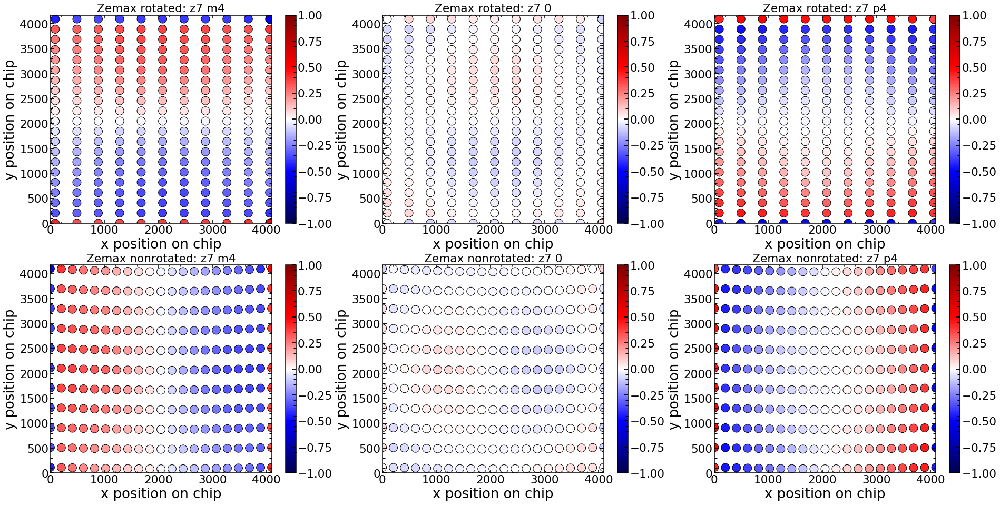

In [355]:
# compare rotated and non-rotated - seem fine


zernike_order=7

defocus_values=[0,4]
position_Zernike_res_0=[]
single_Zernike_res_z5_0=[]
for i in range(len(WaveField_res_0)):
    single_Zernike_res_z5_0.append(WaveField_res_0[i][zernike_order-1])
    position_Zernike_res_0.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected_0=wavelength_correction(single_Zernike_res_z5_0)

# it is actually p4!!!
position_Zernike_res_m4=[]
single_Zernike_res_z5_m4=[]
for i in range(len(WaveField_res_m4)):
    single_Zernike_res_z5_m4.append(WaveField_res_m4[i][zernike_order-1])
    position_Zernike_res_m4.append(postion_res[i])
single_Zernike_res_z5_wavelength_corrected_m4=wavelength_correction(single_Zernike_res_z5_m4)

single_Zernike_res_z5_wavelength_corrected_p4=np.zeros_like(single_Zernike_res_z5_wavelength_corrected_0)
for i in range(len(single_Zernike_res_z5_wavelength_corrected_p4)):
    zernike_values=[single_Zernike_res_z5_wavelength_corrected_0[i],single_Zernike_res_z5_wavelength_corrected_m4[i]]
    z = np.polyfit(defocus_values, zernike_values, 1)
    p = np.poly1d(z)
    single_Zernike_res_z5_wavelength_corrected_p4[i]=p(-4)
    
plt.figure(figsize=(32,16))

values=single_Zernike_res_z5_wavelength_corrected_p4
plt.subplot(2,3,1)
plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax rotated: z'+str(zernike_order)+' m4')
plt.colorbar()


values=single_Zernike_res_z5_wavelength_corrected_0
plt.subplot(2,3,2)
plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax rotated: z'+str(zernike_order)+' 0')
plt.colorbar()

values=single_Zernike_res_z5_wavelength_corrected_m4
plt.subplot(2,3,3)
plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax rotated: z'+str(zernike_order)+' p4')
plt.colorbar()

values=single_Zernike_res_z5_wavelength_corrected_p4
plt.subplot(2,3,4)
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax nonrotated: z'+str(zernike_order)+' m4')
plt.colorbar()


values=single_Zernike_res_z5_wavelength_corrected_0
plt.subplot(2,3,5)
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax nonrotated: z'+str(zernike_order)+' 0')
plt.colorbar()

values=single_Zernike_res_z5_wavelength_corrected_m4
plt.subplot(2,3,6)
plt.scatter(x, y, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title('Zemax nonrotated: z'+str(zernike_order)+' p4')
plt.colorbar()


In [294]:
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
descriptions=results_of_fit_many_HgAr[label[0]].columns

i=zernike_order-4

j_1=0
j=j_1
x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
x_real_1=np.concatenate((x_HgAr,x_Ne))
y_real_1=np.concatenate((y_HgAr,y_Ne))    
colors_1= np.concatenate((values_HgAr,values_Ne))
area_1=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
# limits for all other parameters    
if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:  
        median_color_1=np.median(colors_1)
        up_limit=np.abs(max(colors_1)-median_color_1)
        low_limit=np.abs(min(colors_1)-median_color_1)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_1=median_color_1+(min_dif+max_dif)/2
        min_colors_1=median_color_1-(min_dif+max_dif)/2


j_2=8
j=j_2
x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
x_real_2=np.concatenate((x_HgAr,x_Ne))
y_real_2=np.concatenate((y_HgAr,y_Ne))    
colors_2= np.concatenate((values_HgAr,values_Ne))
area_2=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
# limits for all other parameters    
if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
        median_color_2=np.median(colors_2)
        up_limit=np.abs(max(colors_2)-median_color)
        low_limit=np.abs(min(colors_2)-median_color)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_2=median_color_2+(min_dif+max_dif)/2
        min_colors_2=median_color_2-(min_dif+max_dif)/2

j_3=17
j=j_3
x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
x_real_3=np.concatenate((x_HgAr,x_Ne))
y_real_3=np.concatenate((y_HgAr,y_Ne))    
colors_3= np.concatenate((values_HgAr,values_Ne))
area_3=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
# limits for all other parameters    
if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
        median_color_3=np.median(colors_3)
        up_limit=np.abs(max(colors_3)-median_color)
        low_limit=np.abs(min(colors_3)-median_color)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_3=median_color_3+(min_dif+max_dif)/2
        min_colors_3=median_color_3-(min_dif+max_dif)/2

# limits of color for z5-z22
if np.in1d([i],[1,2,3,4,5,6,7  ,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
        abs_max_colors=max(np.abs(colors))
        max_colors_1=1
        min_colors_1=-1 
        max_colors_2=1
        min_colors_2=-1 
        max_colors_3=1
        min_colors_3=-1 
        
# limits of color for z5-z22
if np.in1d([i],[8,9,10,11,12,13,14,15,16,17,18])[0] == True:
        abs_max_colors=max(np.abs(colors))
        max_colors_1=0.25
        min_colors_1=-0.25
        max_colors_2=0.25
        min_colors_2=-0.25
        max_colors_3=0.25
        min_colors_3=-0.25       
        

"""

plt.figure(figsize=(32,8))
plt.subplot(1,3,1)
plt.scatter(x_real_1, y_real_1, s=area_1, c=colors_1, cmap='seismic', alpha=1,vmin=min_colors_1, vmax=max_colors_1,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str(date)+' / '+str(label[j_1])+" "+str(descriptions[i]))
plt.colorbar()

plt.subplot(1,3,2)
plt.scatter(x_real_2, y_real_2, s=area_2, c=colors_2, cmap='seismic', alpha=1,vmin=min_colors_2, vmax=max_colors_2,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str(date)+' / '+str(label[j_2])+" "+str(descriptions[i]))
plt.colorbar()

plt.subplot(1,3,3)
plt.scatter(x_real_3, y_real_3, s=area_3, c=colors_3, cmap='seismic', alpha=1,vmin=min_colors_3, vmax=max_colors_3,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str(date)+' / '+str(label[j_3])+" "+str(descriptions[i]))
plt.colorbar()
"""

'\n\nplt.figure(figsize=(32,8))\nplt.subplot(1,3,1)\nplt.scatter(x_real_1, y_real_1, s=area_1, c=colors_1, cmap=\'seismic\', alpha=1,vmin=min_colors_1, vmax=max_colors_1,edgecolor=\'black\')\nplt.ylim(0,4176)\nplt.xlim(0,4096)\nplt.xlabel(\'x position on chip\')\nplt.ylabel(\'y position on chip\')\nplt.title(str(date)+\' / \'+str(label[j_1])+" "+str(descriptions[i]))\nplt.colorbar()\n\nplt.subplot(1,3,2)\nplt.scatter(x_real_2, y_real_2, s=area_2, c=colors_2, cmap=\'seismic\', alpha=1,vmin=min_colors_2, vmax=max_colors_2,edgecolor=\'black\')\nplt.ylim(0,4176)\nplt.xlim(0,4096)\nplt.xlabel(\'x position on chip\')\nplt.ylabel(\'y position on chip\')\nplt.title(str(date)+\' / \'+str(label[j_2])+" "+str(descriptions[i]))\nplt.colorbar()\n\nplt.subplot(1,3,3)\nplt.scatter(x_real_3, y_real_3, s=area_3, c=colors_3, cmap=\'seismic\', alpha=1,vmin=min_colors_3, vmax=max_colors_3,edgecolor=\'black\')\nplt.ylim(0,4176)\nplt.xlim(0,4096)\nplt.xlabel(\'x position on chip\')\nplt.ylabel(\'y position 

## together 

In [847]:
x_rotated=x
y_rotated=y

/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


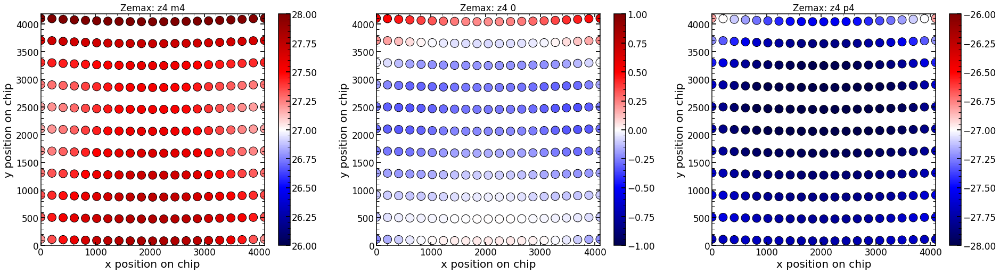

<Figure size 2304x1152 with 0 Axes>

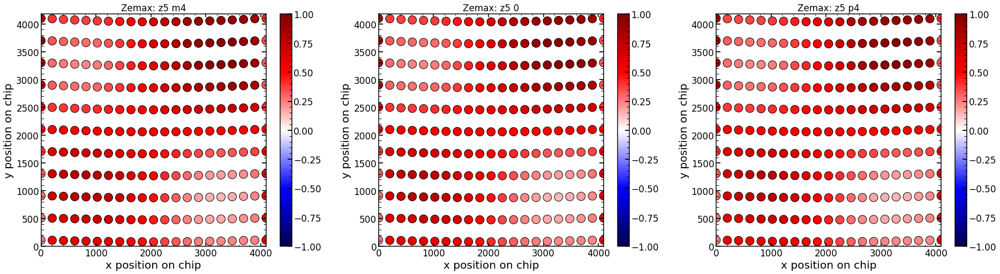

<Figure size 2304x1152 with 0 Axes>

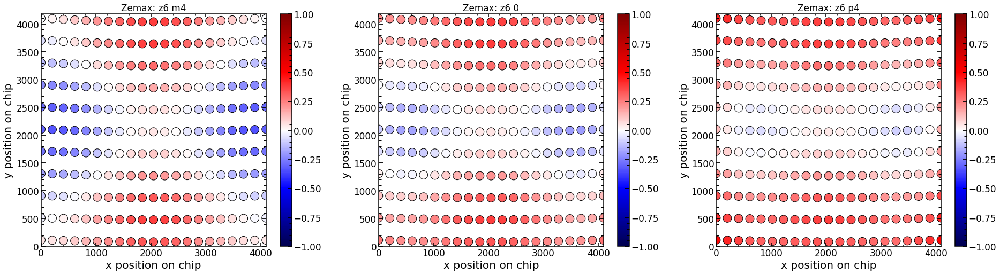

<Figure size 2304x1152 with 0 Axes>

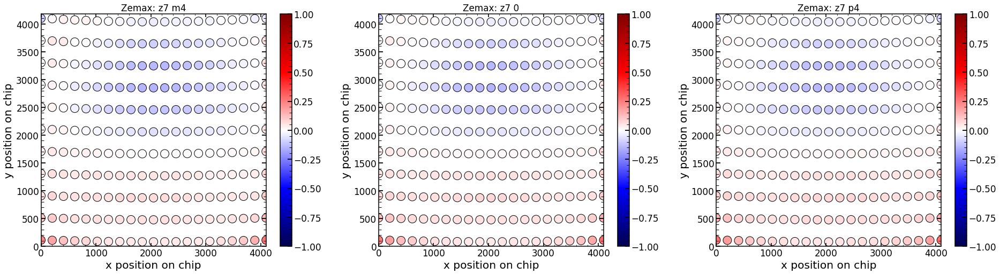

<Figure size 2304x1152 with 0 Axes>

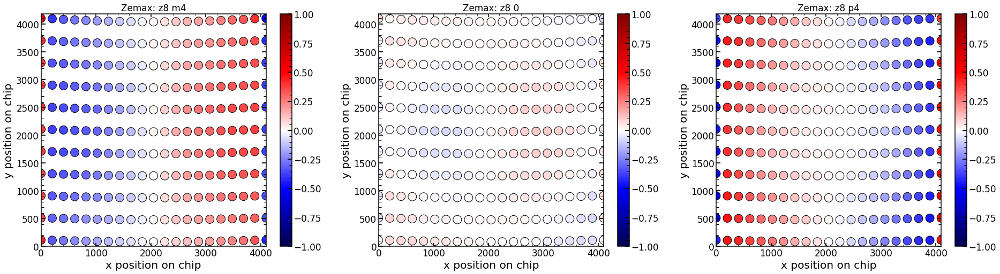

<Figure size 2304x1152 with 0 Axes>

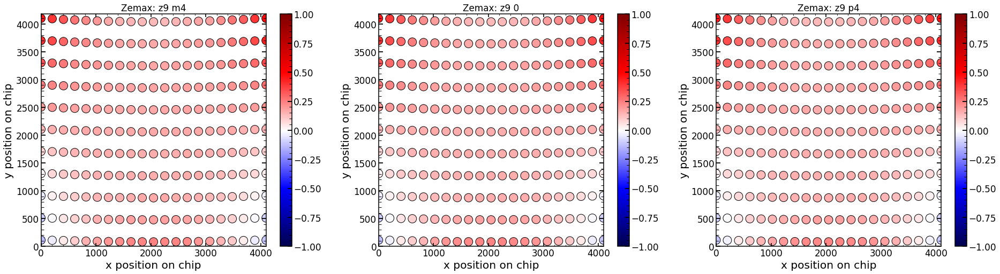

<Figure size 2304x1152 with 0 Axes>

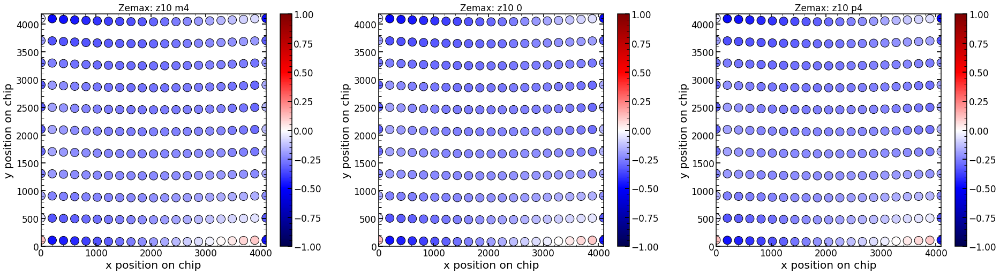

<Figure size 2304x1152 with 0 Axes>

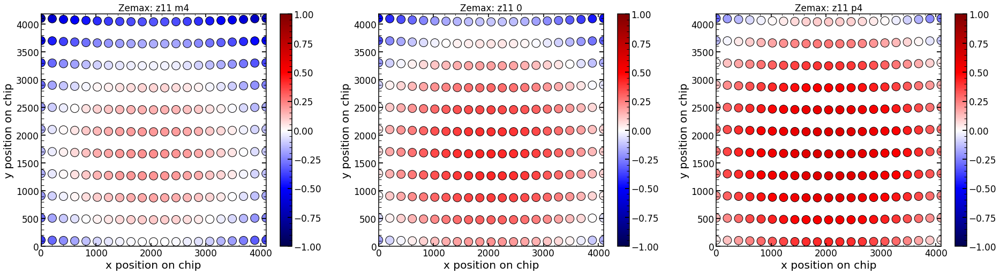

<Figure size 2304x1152 with 0 Axes>

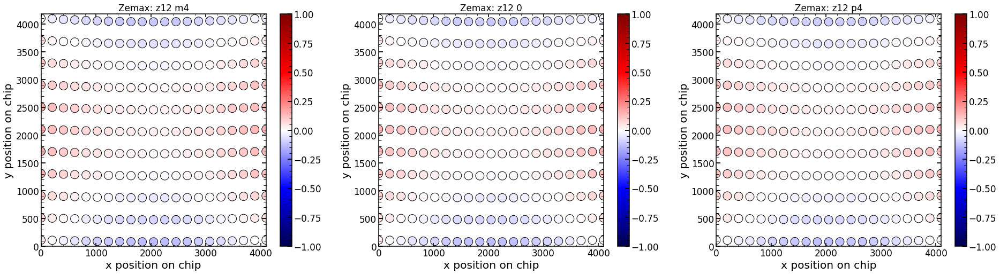

<Figure size 2304x1152 with 0 Axes>

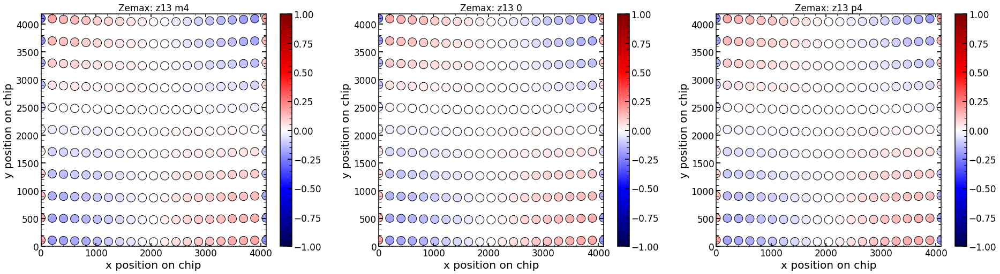

<Figure size 2304x1152 with 0 Axes>

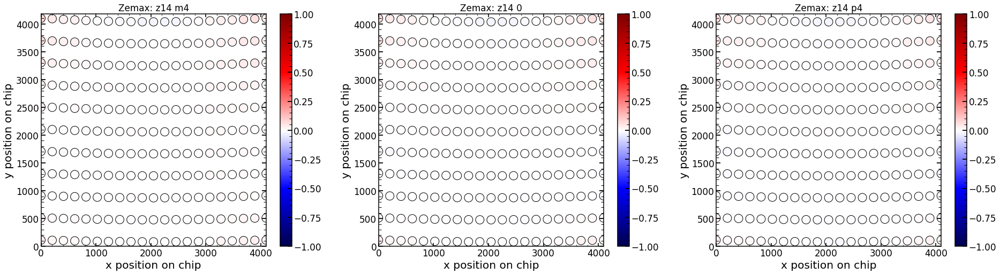

<Figure size 2304x1152 with 0 Axes>

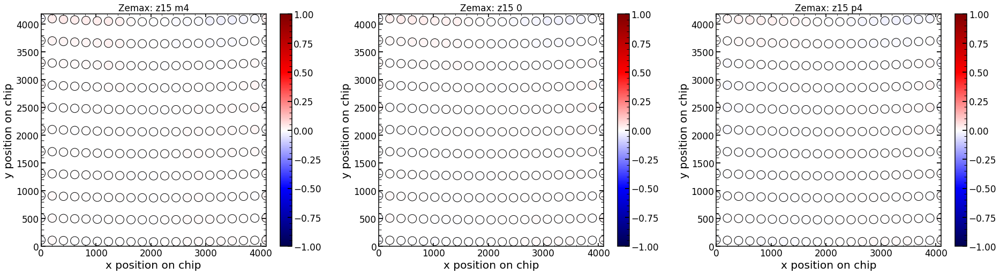

<Figure size 2304x1152 with 0 Axes>

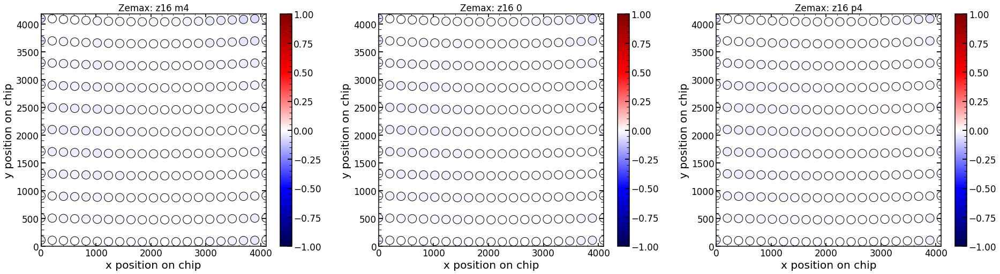

<Figure size 2304x1152 with 0 Axes>

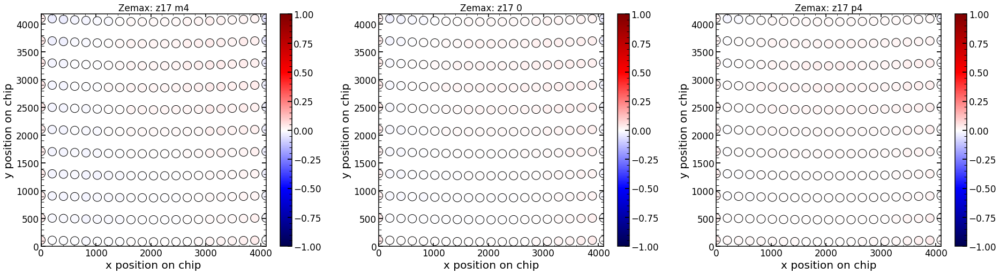

<Figure size 2304x1152 with 0 Axes>

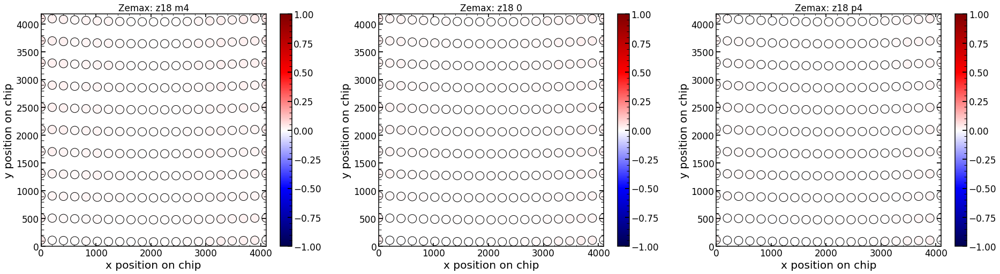

<Figure size 2304x1152 with 0 Axes>

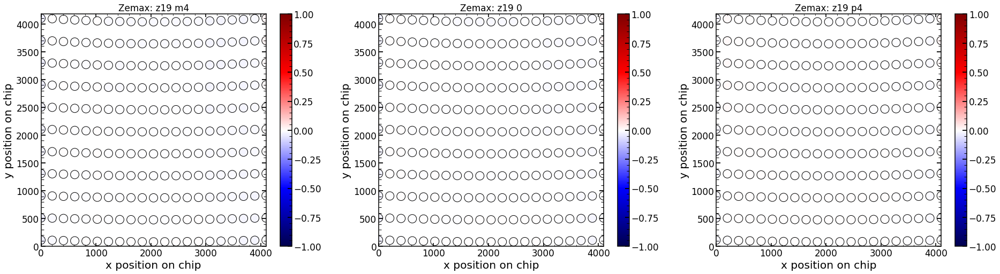

<Figure size 2304x1152 with 0 Axes>

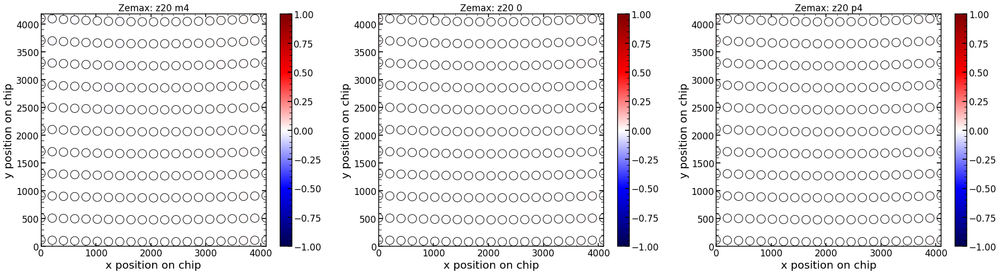

<Figure size 2304x1152 with 0 Axes>

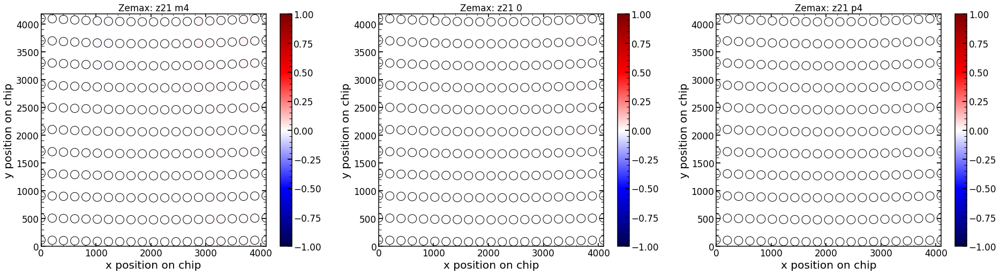

<Figure size 2304x1152 with 0 Axes>

In [848]:
zernike_order=5
for zernike_order in range(4,22):


    defocus_values=[0,4]
    position_Zernike_res_0=[]
    single_Zernike_res_z5_0=[]
    for i in range(len(WaveField_res_0)):
        single_Zernike_res_z5_0.append(WaveField_res_0[i][zernike_order-1])
        position_Zernike_res_0.append(postion_res[i])
    single_Zernike_res_z5_wavelength_corrected_0=wavelength_correction(single_Zernike_res_z5_0)

    position_Zernike_res_m4=[]
    single_Zernike_res_z5_m4=[]
    for i in range(len(WaveField_res_m4)):
        single_Zernike_res_z5_m4.append(WaveField_res_m4[i][zernike_order-1])
        position_Zernike_res_m4.append(postion_res[i])
    single_Zernike_res_z5_wavelength_corrected_m4=wavelength_correction(single_Zernike_res_z5_m4)



    single_Zernike_res_z5_wavelength_corrected_p4=np.zeros_like(single_Zernike_res_z5_wavelength_corrected_0)
    for i in range(len(single_Zernike_res_z5_wavelength_corrected_p4)):
        zernike_values=[single_Zernike_res_z5_wavelength_corrected_0[i],single_Zernike_res_z5_wavelength_corrected_m4[i]]
        z = np.polyfit(defocus_values, zernike_values, 1)
        p = np.poly1d(z)
        single_Zernike_res_z5_wavelength_corrected_p4[i]=p(-4)

    if zernike_order==4:

        plt.figure(figsize=(32,8))

        values=single_Zernike_res_z5_wavelength_corrected_p4
        plt.subplot(1,3,1)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=26, vmax=28,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' m4')
        plt.colorbar()


        values=single_Zernike_res_z5_wavelength_corrected_0
        plt.subplot(1,3,2)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' 0')
        plt.colorbar()

        values=single_Zernike_res_z5_wavelength_corrected_m4
        plt.subplot(1,3,3)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-26, vmax=-28,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' p4')
        plt.colorbar()

    else:
        plt.figure(figsize=(32,8))

        values=single_Zernike_res_z5_wavelength_corrected_p4
        plt.subplot(1,3,1)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' m4')
        plt.colorbar()


        values=single_Zernike_res_z5_wavelength_corrected_0
        plt.subplot(1,3,2)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' 0')
        plt.colorbar()

        values=single_Zernike_res_z5_wavelength_corrected_m4
        plt.subplot(1,3,3)
        plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=-1, vmax=1,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title('Zemax: z'+str(zernike_order)+' p4')
        plt.colorbar()


    i=zernike_order-4

    j_1=0
    j=j_1
    x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
    x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
    x_real_1=np.concatenate((x_HgAr,x_Ne))
    y_real_1=np.concatenate((y_HgAr,y_Ne))    
    colors_1= np.concatenate((values_HgAr,values_Ne))
    area_1=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
    # limits for all other parameters    
    if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
        median_color_1=np.median(colors_1)
        up_limit=np.abs(max(colors_1)-median_color_1)
        low_limit=np.abs(min(colors_1)-median_color_1)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_1=median_color_1+(min_dif+max_dif)/2
        min_colors_1=median_color_1-(min_dif+max_dif)/2


    j_2=8
    j=j_2
    x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
    x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
    x_real_2=np.concatenate((x_HgAr,x_Ne))
    y_real_2=np.concatenate((y_HgAr,y_Ne))    
    colors_2= np.concatenate((values_HgAr,values_Ne))
    area_2=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
    # limits for all other parameters    
    if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
        median_color_2=np.median(colors_2)
        up_limit=np.abs(max(colors_2)-median_color)
        low_limit=np.abs(min(colors_2)-median_color)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_2=median_color_2+(min_dif+max_dif)/2
        min_colors_2=median_color_2-(min_dif+max_dif)/2

    j_3=17
    j=j_3
    x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
    x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
    x_real_3=np.concatenate((x_HgAr,x_Ne))
    y_real_3=np.concatenate((y_HgAr,y_Ne))    
    colors_3= np.concatenate((values_HgAr,values_Ne))
    area_3=np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
    # limits for all other parameters    
    if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
        median_color_3=np.median(colors_3)
        up_limit=np.abs(max(colors_3)-median_color)
        low_limit=np.abs(min(colors_3)-median_color)
        max_dif=np.max([low_limit,up_limit])
        min_dif=np.min([low_limit,up_limit])
        max_colors_3=median_color_3+(min_dif+max_dif)/2
        min_colors_3=median_color_3-(min_dif+max_dif)/2

    # limits of color for z5-z22
    if np.in1d([i],[1,2,3,4,5,6,7  ,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
            abs_max_colors=max(np.abs(colors))
            max_colors_1=1
            min_colors_1=-1 
            max_colors_2=1
            min_colors_2=-1 
            max_colors_3=1
            min_colors_3=-1 

    # limits of color for z5-z22
    if np.in1d([i],[8,9,10,11,12,13,14,15,16,17,18])[0] == True:
            abs_max_colors=max(np.abs(colors))
            max_colors_1=0.25
            min_colors_1=-0.25
            max_colors_2=0.25
            min_colors_2=-0.25
            max_colors_3=0.25
            min_colors_3=-0.25       

    plt.figure(figsize=(32,16))

    plt.subplot(2,3,3)
    values=single_Zernike_res_z5_wavelength_corrected_p4
    plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=min_colors_1, vmax=max_colors_1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: m4 z'+str(zernike_order))
    plt.colorbar()


    values=single_Zernike_res_z5_wavelength_corrected_0
    plt.subplot(2,3,2)
    plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=min_colors_2, vmax=max_colors_2,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: 0 z'+str(zernike_order))
    plt.colorbar()

    values=single_Zernike_res_z5_wavelength_corrected_m4
    plt.subplot(2,3,1)
    plt.scatter(x_rotated, y_rotated, s=area, c=values, cmap='seismic', alpha=1,vmin=min_colors_3, vmax=max_colors_3,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('Zemax: p4 z'+str(zernike_order))
    plt.colorbar()


    plt.subplot(2,3,4)
    plt.scatter(x_real_1, y_real_1, s=area_1, c=colors_1, cmap='seismic', alpha=1,vmin=min_colors_1, vmax=max_colors_1,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('data '+str(date)+': '+str(label[j_1])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.subplot(2,3,5)
    plt.scatter(x_real_2, y_real_2, s=area_2, c=colors_2, cmap='seismic', alpha=1,vmin=min_colors_2, vmax=max_colors_2,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('data '+str(date)+': '+str(label[j_2])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.subplot(2,3,6)
    plt.scatter(x_real_3, y_real_3, s=area_3, c=colors_3, cmap='seismic', alpha=1,vmin=min_colors_3, vmax=max_colors_3,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title('data '+str(date)+': '+str(label[j_3])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/ComparisonZemaxReal/'+str(descriptions[i]))
    plt.clf()        

## Comparison of the zemax prediction and reality in images - first Zemax 

### reality 

In [623]:
columns22=['z4','z5','z6','z7','z8','z9','z10','z11',
           'z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

In [624]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


dataset=2
date='Jun13'
obs=17023
single_number='11'
image_index=int(single_number)
eps=5
arc='HgAr'

STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
"""

if arc=="HgAr":
    single_number_focus=11748
elif arc=="Ne":
    single_number_focus=11748+607    
else:
    print("Not recognized arc-line")
"""
if arc=="HgAr":
    single_number_focus=17017+54
elif arc=="Ne":
    single_number_focus=16292  
else:
    print("Not recognized arc-line")

"""
if arc=='HgAr':
    obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
elif arc=='Ne':
    obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
"""

if arc=='HgAr':
    obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
elif arc=='Ne':
    # different sequence than for HgAr
    obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
    
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

"""
if arc=="HgAr":
    finalArc=finalHgAr_Feb2019
elif arc=="Ne":
    finalArc=finalNe_Feb2019    
else:
    print("Not recognized arc-line")    
"""    

if arc=="HgAr":
    finalArc=finalHgAr_May2019
elif arc=="Ne":
    finalArc=finalNe_May2019    
else:
    print("Not recognized arc-line")   

finalArc.loc[int(single_number)]

m4


fiber                           2
xc                             59
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                   59
old_index_approx               11
superold_index_approx         0.0
Name: 11, dtype: object

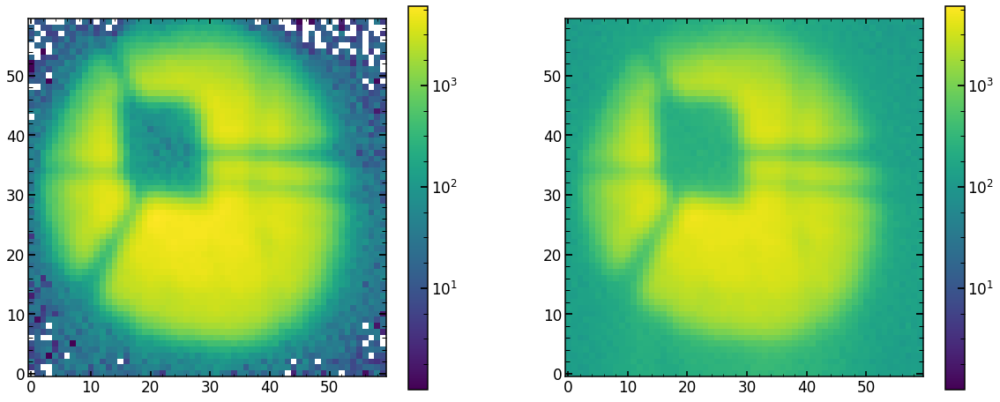

In [625]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [626]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 18761.07550738068
minimal chi2 reduced is: 10.418079863666476


In [337]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0  30.095792 -2.831702 -1.708584 -0.086788  0.594866 -0.329325 -0.373054   

        z11  
0  0.667773  
        z12       z13       z14       z15       z16      z17       z18  \
0 -0.015169  0.223203 -0.105519  0.021559 -0.122182  0.06038 -0.027538   

        z19       z20       z21  
0 -0.040115 -0.058305 -0.033732  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.096731  0.755461   0.119274 -0.216779  0.237626  0.065095     0.046124   

   radiometricEffect  radiometricExponent    x_ilum   ...     frd_sigma  \
0           0.000025             0.000025  0.974746   ...      0.067573   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0             0.64367  1.044287             0.62127    17074.93067   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r     flux  
0          2.257482              0.004783      0.538134  1.802792  0

In [338]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-18767.891879321473

In [339]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

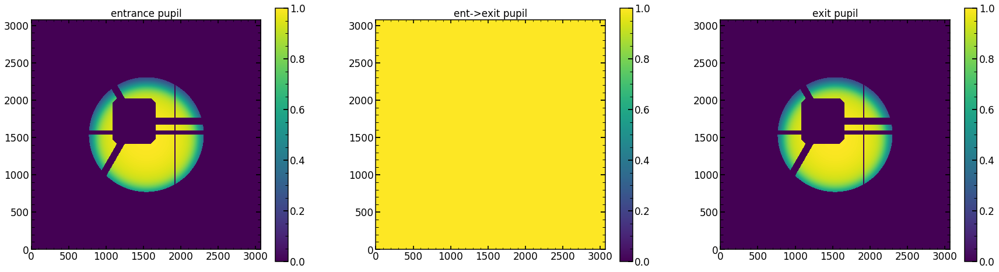

In [340]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

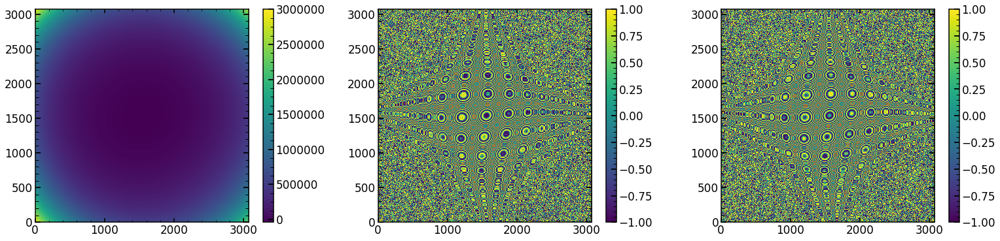

In [341]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

Text(0.5,1,'Residual')

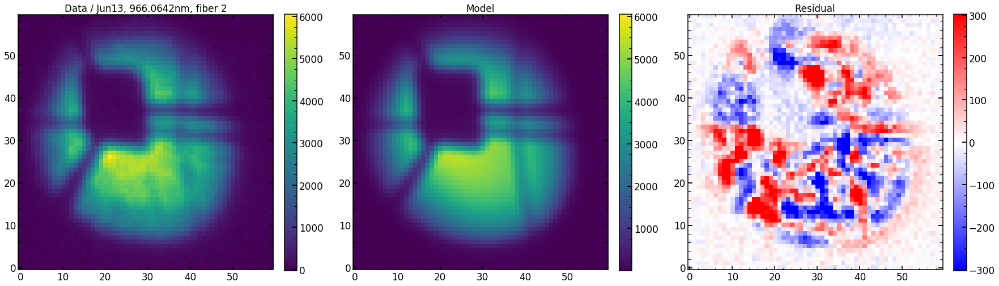

In [342]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

### Zemax 

In [457]:
finalHgAr.loc[11]

fiber                           2
xc                             59
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                   59
old_index_approx               11
superold_index_approx         0.0
Name: 11, dtype: object

In [305]:
minchain_Zemax

array([   30.80758328,    -0.84658441,    -1.83066409,     0.07494276,
          -0.11264433,    -0.17243779,    -0.37006708,    -0.18490739,
           0.04233369,     0.07304326,     0.05661223,     0.0472357 ,
           0.01150385,     0.03272001,     0.01028288,     0.0009835 ,
          -0.05103439,     0.03100259,     0.05651346,     0.        ,
           0.        ,    -0.03801883,     0.14508796,     0.        ,
           0.02487318,     0.00000824,     0.00000824,     0.97340565,
           0.9483454 ,     0.0218733 ,    -0.04176206,     0.92498302,
           0.04200734,     0.92298687,     1.06702564,     0.16140041,
       39056.5042996 ,     2.56746955,     0.00413376,     0.37854602,
           1.87090559,     0.99313136])

In [318]:
columns22[28]

'y_ilum'

In [319]:

minchain_Zemax=np.copy(minchain)
minchain_Zemax[19]=0
minchain_Zemax[20]=0
minchain_Zemax[21]=0
minchain_Zemax[22]=0
minchain_Zemax[23]=0
minchain_Zemax[27]=0
minchain_Zemax[28]=0

In [348]:
#Zemax_to_real_conversion=[-1,1,-1,1,-1,1,1,1,-1,1,-1,1,-1,1,-1,1,-1,1]

In [349]:
wave=1
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_lower_right=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_lower_right_only_z5_to_z22=wavelength_correction_single(WaveField_lower_right,630)[4:22]
minchain_lower_right=np.copy(minchain_Zemax)
minchain_lower_right[1:19]=WaveField_lower_right_only_z5_to_z22

wave=1
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_lower_left=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_lower_left_only_z5_to_z22=wavelength_correction_single(WaveField_lower_left,630)[4:22]
minchain_lower_left=np.copy(minchain_Zemax)
minchain_lower_left[1:19]=WaveField_lower_left_only_z5_to_z22

wave=1
field=1
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_lower_center=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_lower_center_only_z5_to_z22=wavelength_correction_single(WaveField_lower_center,630)[4:22]
minchain_lower_center=np.copy(minchain_Zemax)
minchain_lower_center[1:19]=WaveField_lower_center_only_z5_to_z22
#############
wave=6
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_center_right=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_center_right_only_z5_to_z22=wavelength_correction_single(WaveField_center_right,800)[4:22]
minchain_center_right=np.copy(minchain_Zemax)
minchain_center_right[1:19]=WaveField_center_right_only_z5_to_z22

wave=6
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_center_left=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_center_left_only_z5_to_z22=wavelength_correction_single(WaveField_center_left,800)[4:22]
minchain_center_left=np.copy(minchain_Zemax)
minchain_center_left[1:19]=WaveField_center_left_only_z5_to_z22

wave=6
field=1
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_center_center=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_center_center_only_z5_to_z22=wavelength_correction_single(WaveField_center_center,800)[4:22]
minchain_center_center=np.copy(minchain_Zemax)
minchain_center_center[1:19]=WaveField_center_center_only_z5_to_z22

#############
wave=11
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_upper_right=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_upper_right_only_z5_to_z22=wavelength_correction_single(WaveField_upper_right,970)[4:22]
minchain_upper_right=np.copy(minchain_Zemax)
minchain_upper_right[1:19]=WaveField_upper_right_only_z5_to_z22*Zemax_to_real_conversion

wave=11
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_upper_left=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_upper_left_only_z5_to_z22=wavelength_correction_single(WaveField_upper_left,970)[4:22]
minchain_upper_left=np.copy(minchain_Zemax)
minchain_upper_left[1:19]=WaveField_upper_left_only_z5_to_z22

wave=11
field=1
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_upper_center=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_upper_center_only_z5_to_z22=wavelength_correction_single(WaveField_upper_center,970)[4:22]
minchain_upper_center=np.copy(minchain_Zemax)
minchain_upper_center[1:19]=WaveField_upper_center_only_z5_to_z22

In [350]:
model(minchain_lower_right)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_right=optPsf_cut_fiber_convolved_downsampled

model(minchain_lower_left)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_left=optPsf_cut_fiber_convolved_downsampled

model(minchain_lower_center)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_center=optPsf_cut_fiber_convolved_downsampled

model(minchain_center_right)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_right=optPsf_cut_fiber_convolved_downsampled

model(minchain_center_left)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_left=optPsf_cut_fiber_convolved_downsampled

model(minchain_center_center)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_center=optPsf_cut_fiber_convolved_downsampled

model(minchain_upper_right)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_right=optPsf_cut_fiber_convolved_downsampled

model(minchain_upper_left)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_left=optPsf_cut_fiber_convolved_downsampled

model(minchain_upper_center)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_center=optPsf_cut_fiber_convolved_downsampled

42
42
42
42
42
42
42
42
42


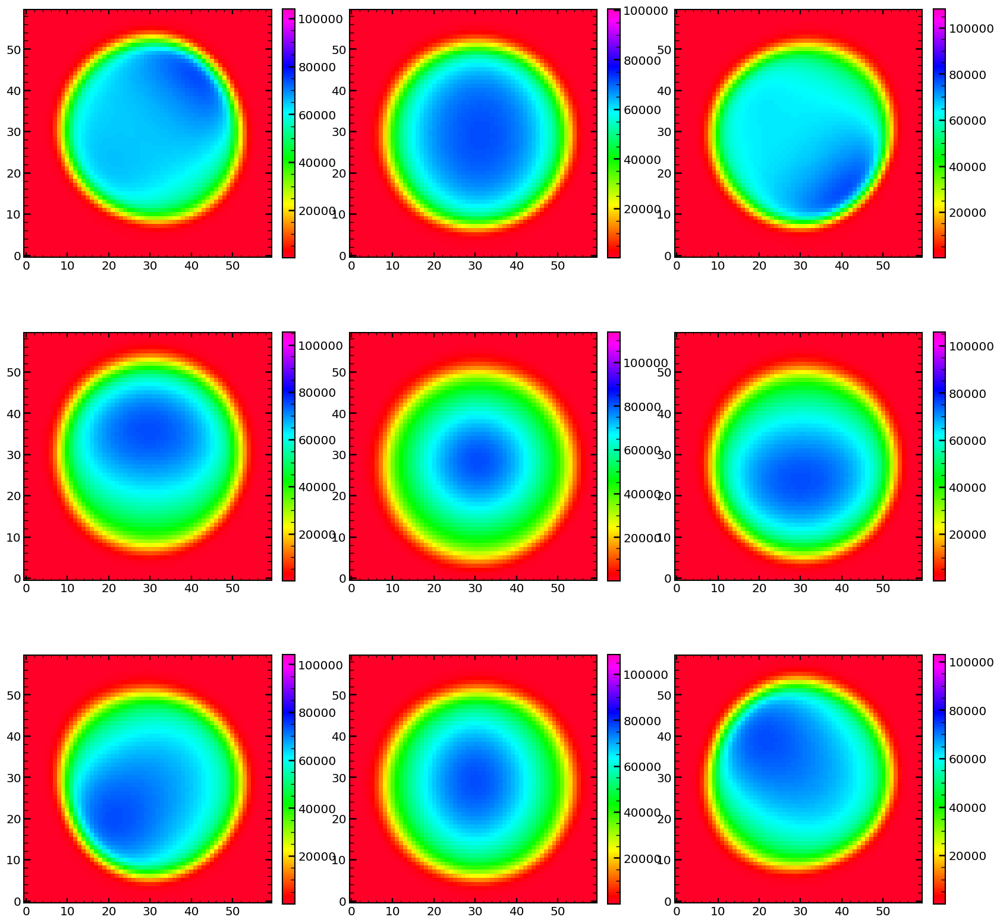

In [352]:
matplotlib.rcParams.update({'font.size': 12})

plt.figure(figsize=(20,20))



plt.subplot(3,3,3)
plt.imshow(res_iapetus_upper_right,vmax=np.max(res_iapetus_upper_right)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,2)
plt.imshow(res_iapetus_upper_center,vmax=np.max(res_iapetus_upper_center)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,1)
plt.imshow(res_iapetus_upper_left,vmax=np.max(res_iapetus_upper_left)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,6)
plt.imshow(res_iapetus_center_right,vmax=np.max(res_iapetus_center_right)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,5)
plt.imshow(res_iapetus_center_center,vmax=np.max(res_iapetus_center_center)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,4)
plt.imshow(res_iapetus_center_left,vmax=np.max(res_iapetus_center_left)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(3,3,7)
plt.imshow(res_iapetus_lower_right,vmax=np.max(res_iapetus_lower_right)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,8)
plt.imshow(res_iapetus_lower_center,vmax=np.max(res_iapetus_lower_center)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,9)
plt.imshow(res_iapetus_lower_left,vmax=np.max(res_iapetus_lower_left)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)




In [628]:
single_analysis=Zernike_Analysis(date,obs,3,eps,arc,dataset)
minchain_lower_left_data,like_min=single_analysis.create_likelihood()
minchain_lower_left_data_modified=np.copy(minchain_lower_left_data)
minchain_lower_left_data_modified[19]=0
minchain_lower_left_data_modified[20]=0
minchain_lower_left_data_modified[21]=0
minchain_lower_left_data_modified[22]=0
minchain_lower_left_data_modified[23]=0
minchain_lower_left_data_modified[27]=0
minchain_lower_left_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,39,eps,arc,dataset)
minchain_lower_center_data,like_min=single_analysis.create_likelihood()
minchain_lower_center_data_modified=np.copy(minchain_lower_center_data)
minchain_lower_center_data_modified[19]=0
minchain_lower_center_data_modified[20]=0
minchain_lower_center_data_modified[21]=0
minchain_lower_center_data_modified[22]=0
minchain_lower_center_data_modified[23]=0
minchain_lower_center_data_modified[27]=0
minchain_lower_center_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,111,eps,arc,dataset)
minchain_lower_right_data,like_min=single_analysis.create_likelihood()
minchain_lower_right_data_modified=np.copy(minchain_lower_right_data)
minchain_lower_right_data_modified[19]=0
minchain_lower_right_data_modified[20]=0
minchain_lower_right_data_modified[21]=0
minchain_lower_right_data_modified[22]=0
minchain_lower_right_data_modified[23]=0
minchain_lower_right_data_modified[27]=0
minchain_lower_right_data_modified[28]=0
############################################################
single_analysis=Zernike_Analysis(date,obs,6,eps,arc,dataset)
minchain_center_left_data,like_min=single_analysis.create_likelihood()
minchain_center_left_data_modified=np.copy(minchain_center_left_data)
minchain_center_left_data_modified[19]=0
minchain_center_left_data_modified[20]=0
minchain_center_left_data_modified[21]=0
minchain_center_left_data_modified[22]=0
minchain_center_left_data_modified[23]=0
minchain_center_left_data_modified[27]=0
minchain_center_left_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,54,eps,arc,dataset)
minchain_center_center_data,like_min=single_analysis.create_likelihood()
minchain_center_center_data_modified=np.copy(minchain_center_center_data)
minchain_center_center_data_modified[19]=0
minchain_center_center_data_modified[20]=0
minchain_center_center_data_modified[21]=0
minchain_center_center_data_modified[22]=0
minchain_center_center_data_modified[23]=0
minchain_center_center_data_modified[27]=0
minchain_center_center_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,78,eps,arc,dataset)
minchain_center_right_data,like_min=single_analysis.create_likelihood()
minchain_center_right_data_modified=np.copy(minchain_center_right_data)
minchain_center_right_data_modified[19]=0
minchain_center_right_data_modified[20]=0
minchain_center_right_data_modified[21]=0
minchain_center_right_data_modified[22]=0
minchain_center_right_data_modified[23]=0
minchain_center_right_data_modified[27]=0
minchain_center_right_data_modified[28]=0
############################################################
single_analysis=Zernike_Analysis(date,obs,11,eps,arc,dataset)
minchain_upper_left_data,like_min=single_analysis.create_likelihood()
minchain_upper_left_data_modified=np.copy(minchain_upper_left_data)
minchain_upper_left_data_modified[19]=0
minchain_upper_left_data_modified[20]=0
minchain_upper_left_data_modified[21]=0
minchain_upper_left_data_modified[22]=0
minchain_upper_left_data_modified[23]=0
minchain_upper_left_data_modified[27]=0
minchain_upper_left_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,57,eps,arc,dataset)
minchain_upper_center_data,like_min=single_analysis.create_likelihood()
minchain_upper_center_data_modified=np.copy(minchain_upper_center_data)
minchain_upper_center_data_modified[19]=0
minchain_upper_center_data_modified[20]=0
minchain_upper_center_data_modified[21]=0
minchain_upper_center_data_modified[22]=0
minchain_upper_center_data_modified[23]=0
minchain_upper_center_data_modified[27]=0
minchain_upper_center_data_modified[28]=0

single_analysis=Zernike_Analysis(date,obs,119,eps,arc,dataset)
minchain_upper_right_data,like_min=single_analysis.create_likelihood()
minchain_upper_right_data_modified=np.copy(minchain_upper_right_data)
minchain_upper_right_data_modified[19]=0
minchain_upper_right_data_modified[20]=0
minchain_upper_right_data_modified[21]=0
minchain_upper_right_data_modified[22]=0
minchain_upper_right_data_modified[23]=0
minchain_upper_right_data_modified[27]=0
minchain_upper_right_data_modified[28]=0

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 12457.766607860027
minimal chi2 reduced is: 6.916103182772633
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 15673.243106312773
minimal chi2 reduced is: 8.70242080775437
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 15484.97146384087
minimal chi2 reduced is: 8.598010344035426
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 106237.21300405572
minimal chi2 reduced is: 59.01557659819978
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 31283.79846454349
minimal chi2 reduced is: 17.374728464194227
(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 29098.71278626005
minimal chi2 reduced is: 16.160877575580376
(number of walkers, number of steps, number of p

In [629]:
model(minchain_lower_right_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_right_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_lower_center_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_center_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_lower_left_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_left_data=optPsf_cut_fiber_convolved_downsampled
##################################################################
model(minchain_center_right_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_right_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_center_center_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_center_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_center_left_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_center_left_data=optPsf_cut_fiber_convolved_downsampled
##################################################################
model(minchain_upper_right_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_right_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_upper_center_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_center_data=optPsf_cut_fiber_convolved_downsampled

model(minchain_upper_left_data_modified)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_left_data=optPsf_cut_fiber_convolved_downsampled

42
42
42
42
42
42
42
42
42


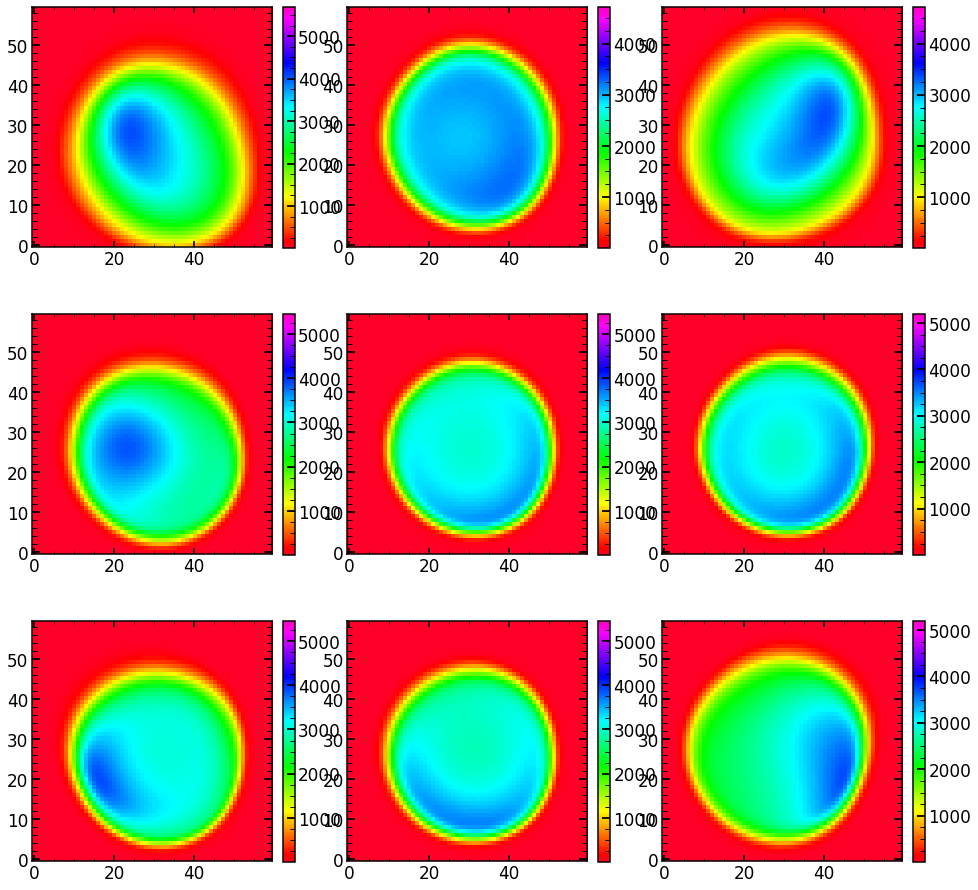

In [631]:
plt.figure(figsize=(16,16))

plt.subplot(3,3,1)
plt.imshow(res_iapetus_upper_left_data,vmax=np.max(res_iapetus_upper_left_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,2)
plt.imshow(res_iapetus_upper_center_data,vmax=np.max(res_iapetus_upper_right_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,3)
plt.imshow(res_iapetus_upper_right_data,vmax=np.max(res_iapetus_upper_right_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,6)
plt.imshow(res_iapetus_center_right_data,vmax=np.max(res_iapetus_lower_right_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,5)
plt.imshow(res_iapetus_center_center_data,vmax=np.max(res_iapetus_lower_left_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,4)
plt.imshow(res_iapetus_center_left_data,vmax=np.max(res_iapetus_lower_left_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(3,3,9)
plt.imshow(res_iapetus_lower_right_data,vmax=np.max(res_iapetus_lower_right_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,8)
plt.imshow(res_iapetus_lower_center_data,vmax=np.max(res_iapetus_lower_left_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(3,3,7)
plt.imshow(res_iapetus_lower_left_data,vmax=np.max(res_iapetus_lower_left_data)*1.4,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)



In [367]:
wave=1
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_lower_right=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_lower_right_only_z5_to_z22=wavelength_correction_single(WaveField_lower_right,630)[4:22]
minchain_lower_right=np.copy(minchain_Zemax)
minchain_lower_right[1:19]=WaveField_lower_right_only_z5_to_z22*Zemax_to_real_conversion

In [368]:
minchain_lower_right_data[1:19]=WaveField_lower_right_only_z5_to_z22
model(minchain_lower_right_data)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_lower_right_data=optPsf_cut_fiber_convolved_downsampled

42


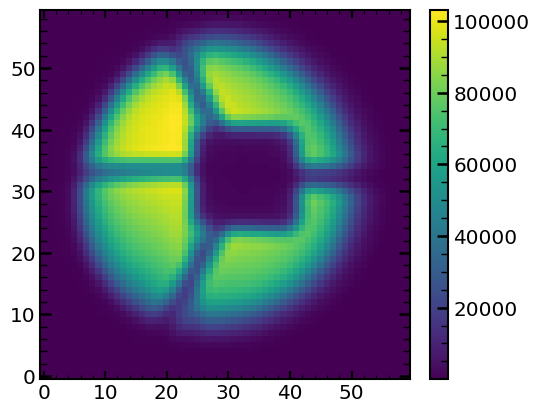

In [369]:
plt.imshow(res_iapetus_lower_right_data,vmax=np.max(res_iapetus_lower_right_data)*1.0)
plt.colorbar(fraction=0.046, pad=0.04)

### checking that wavefront definitions are the same - they are 

In [385]:
minchain_lower_right_data

array([    0.        ,     1.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.65500426,
           0.0781788 ,     0.13070932,    -0.00889722,     0.05819276,
           0.04642041,     0.00001744,     0.00001744,     0.97105881,
           0.94838663,    -0.10069828,    -0.01092987,     0.90074253,
           0.05643831,     0.77406471,     1.00203847,    -0.26317538,
       91888.90583808,     2.73462935,     0.00829058,     0.48142313,
           1.78082703,     0.98835955])

In [446]:
minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[0]=1
model(minchain_lower_right_data)
wf_full_z5=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[1]=1
model(minchain_lower_right_data)
wf_full_z6=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[2]=1
model(minchain_lower_right_data)
wf_full_z7=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[3]=1
model(minchain_lower_right_data)
wf_full_z8=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[4]=1
model(minchain_lower_right_data)
wf_full_z9=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

minchain_lower_right_data[0:19]=np.zeros((19,))
minchain_lower_right_data[5]=1
model(minchain_lower_right_data)
wf_full_z10=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 

42
42
42
42
42
42


Text(0.5,1,'z10')

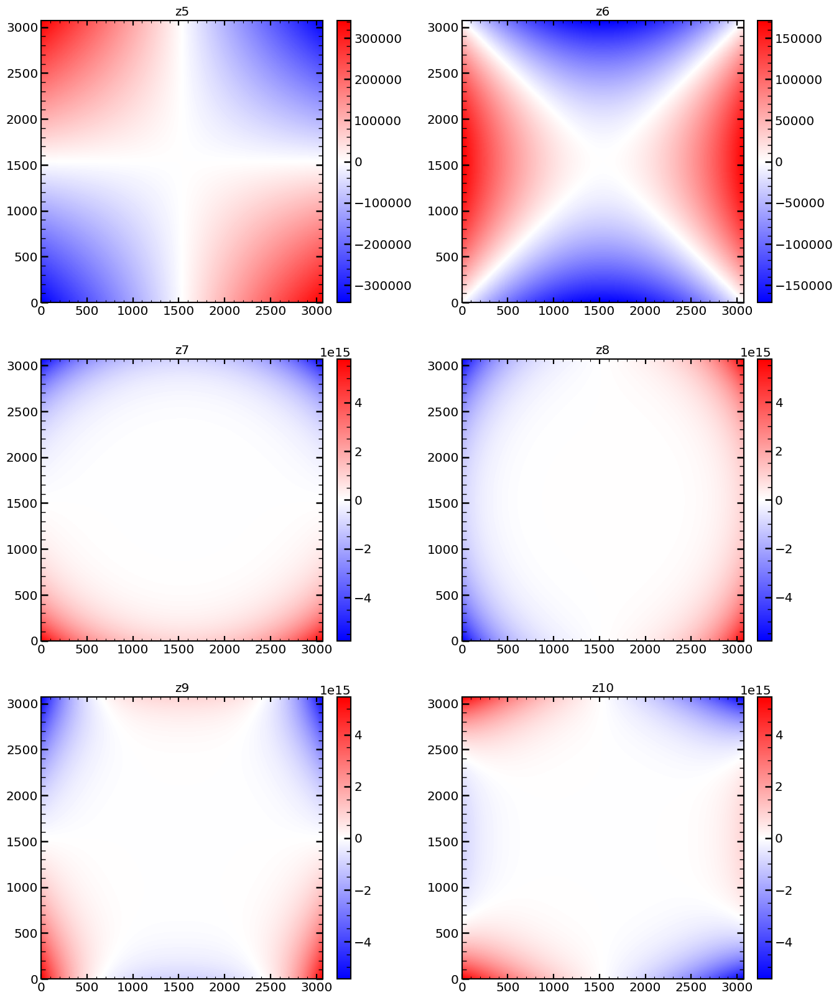

In [447]:
plt.figure(figsize=(16,20))

plt.subplot(3,2,1)
plt.imshow(np.sqrt(6)*rho_array*np.sin(2*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z5')

plt.subplot(3,2,2)
plt.imshow(np.sqrt(6)*rho_array*np.cos(2*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z6')

plt.subplot(3,2,3)
plt.imshow((3*rho_array**3-2*rho_array)*np.sin(theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z7')

plt.subplot(3,2,4)
plt.imshow((3*rho_array**3-2*rho_array)*np.cos(theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z8')

plt.subplot(3,2,5)
plt.imshow((np.sqrt(8)*rho_array**3)*np.sin(3*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9')

plt.subplot(3,2,6)
plt.imshow((np.sqrt(8)*rho_array**3)*np.cos(3*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z10')

In [414]:
wf_full_test=np.zeros_like(wf_full)
y_array=np.zeros_like(wf_full)
x_array=np.zeros_like(wf_full)

for i in range(3072):
    x_array[:,i]=np.ones((3072,))*i-3072/2
    
for i in reversed(range(3072)):
    y_array[i]=-1*(np.ones((3072,))*i-3072/2)

In [433]:
rho_array=(y_array**2+x_array**2)/33.7659
theta_array=np.arctan2(y_array,x_array)

theta_array

array([[ 2.35619449,  2.35586886,  2.35554302, ...,  0.78637568,
         0.78604963,  0.78572379],
       [ 2.35652012,  2.35619449,  2.35586865, ...,  0.78605005,
         0.785724  ,  0.78539816],
       [ 2.35684596,  2.35652033,  2.35619449, ...,  0.78572421,
         0.78539816,  0.78507232],
       ...,
       [-2.35717201, -2.35684638, -2.35652054, ..., -0.78539816,
        -0.78507211, -0.78474627],
       [-2.35684596, -2.35652033, -2.35619449, ..., -0.78572421,
        -0.78539816, -0.78507232],
       [-2.35652012, -2.35619449, -2.35586865, ..., -0.78605005,
        -0.785724  , -0.78539816]])

Text(0.5,1,'z10')

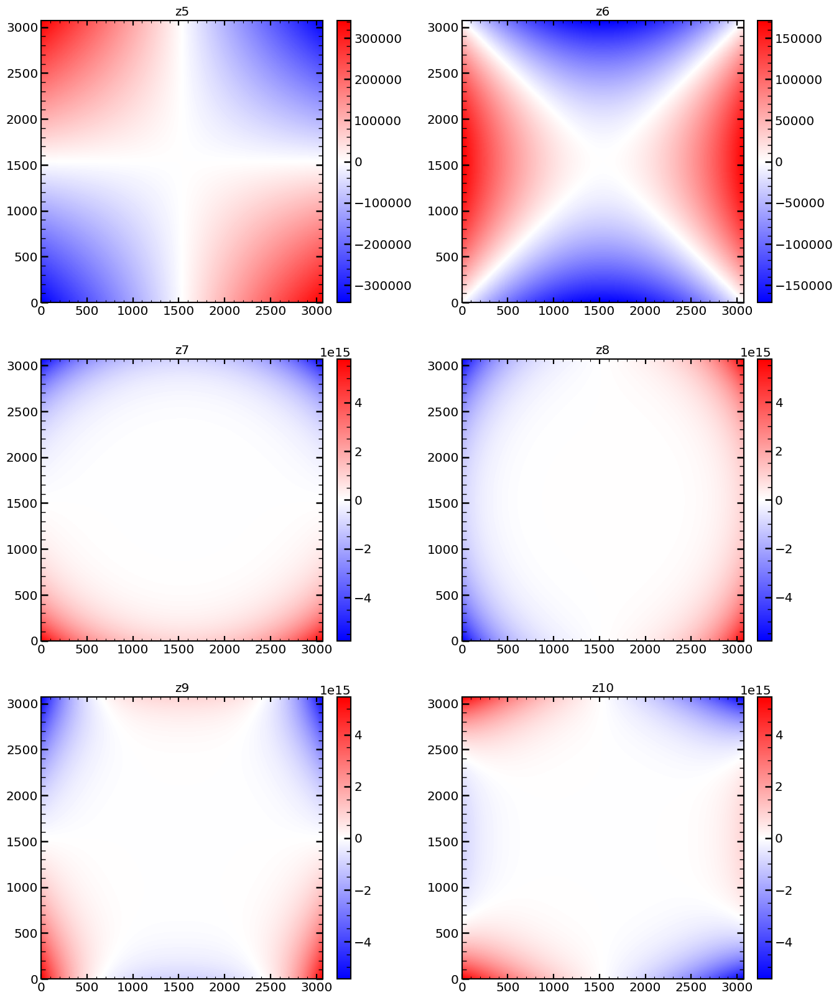

In [444]:
plt.figure(figsize=(16,20))

plt.subplot(3,2,1)
plt.imshow(np.sqrt(6)*rho_array*np.sin(2*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z5')

plt.subplot(3,2,2)
plt.imshow(np.sqrt(6)*rho_array*np.cos(2*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z6')

plt.subplot(3,2,3)
plt.imshow((3*rho_array**3-2*rho_array)*np.sin(theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z7')

plt.subplot(3,2,4)
plt.imshow((3*rho_array**3-2*rho_array)*np.cos(theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z8')

plt.subplot(3,2,5)
plt.imshow((np.sqrt(8)*rho_array**3)*np.sin(3*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9')

plt.subplot(3,2,6)
plt.imshow((np.sqrt(8)*rho_array**3)*np.cos(3*theta_array),cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z10')

### Zemax, model and data side by side 

In [ ]:
#data - run from above

In [462]:
wave=11
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/June272019/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_upper_left=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_upper_left_only_z5_to_z22=wavelength_correction_single(WaveField_upper_left,970)[4:22]
minchain_upper_left=np.copy(minchain)
minchain_upper_left[1:19]=WaveField_upper_left_only_z5_to_z22

model(minchain_upper_left)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus_upper_left=optPsf_cut_fiber_convolved_downsampled

42


Text(0.5,1,'Zemax')

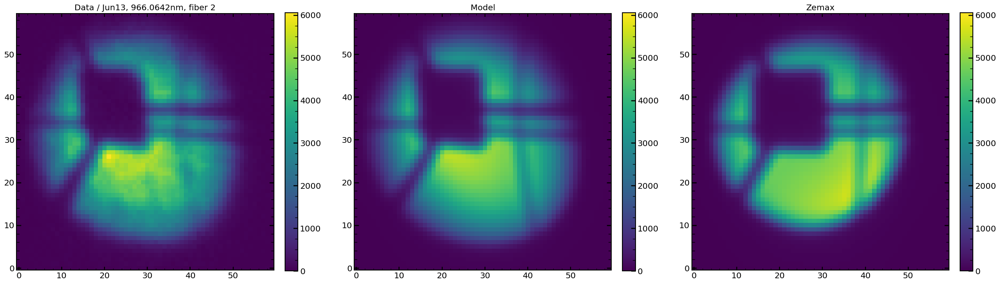

In [465]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmin=0,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmin=0,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(res_iapetus_upper_left,vmin=0,vmax=np.max(sci_image)/1)
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Zemax')

## create zemax initial run

In [853]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_Ne=pickle.load(f)
    
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_HgAr_from_Jun13=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_Ne_from_Jun13=pickle.load(f)

In [854]:
results_of_fit_many_direct_preDecemberrun_HgAr['m4']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,29.865298,-0.772905,-0.222493,0.429315,0.541280,0.146221,-0.391266,0.044460,-0.117134,-0.098604,...,0.997980,0.641535,32750.292514,2.996683,0.010884,0.395920,1.816165,0.995114,46.511662,5644.993164
3,29.917607,-1.246649,-0.419128,0.459558,0.452861,0.096105,-0.276117,0.031043,-0.186902,-0.217280,...,0.985449,0.699826,104616.028103,2.001057,0.000446,0.534382,1.835205,0.999601,6.928164,1395.221802
6,32.017125,-1.592188,-0.539086,0.284573,0.668385,-0.045558,0.039413,0.043946,-0.159634,0.010809,...,0.950153,-0.179762,106218.654022,2.938575,0.013374,0.492184,1.786471,0.990230,59.259655,5013.637695
9,31.165682,-2.632864,-1.291749,-0.086110,0.201413,-0.188231,-0.276316,0.387870,-0.084420,0.157599,...,1.043646,0.603641,69128.124621,2.450786,0.003238,0.397167,1.825585,0.992537,186.530435,25099.285156
11,30.095792,-2.831702,-1.708584,-0.086788,0.594866,-0.329325,-0.373054,0.667773,-0.015169,0.223203,...,1.044287,0.621270,17074.930670,2.257482,0.004783,0.538134,1.802792,0.991370,10.426607,1311.632080
13,31.249038,-0.699654,-0.587510,0.612535,0.707459,-0.019150,-0.227426,-0.269676,-0.135937,-0.145048,...,0.983697,-0.412158,113398.944825,2.986256,0.009742,0.405084,1.816531,0.991967,58.473321,6156.093750
15,30.570246,-0.750937,-0.392273,0.573565,0.403958,-0.025109,-0.291576,-0.157997,-0.167992,-0.078147,...,0.992637,0.529754,101906.813889,2.689021,0.006797,0.379159,1.805973,0.995839,7.843805,1516.774536
18,31.971641,-1.302159,0.094035,0.101443,0.364841,0.132085,-0.388828,0.301431,-0.137598,0.155238,...,1.032207,0.387794,31877.214020,2.915810,0.004650,0.514275,1.963245,0.992746,44.138228,5416.829590
21,31.376016,-2.337696,-1.518564,-0.060819,0.338223,-0.119001,-0.411887,0.286640,-0.111754,0.223513,...,1.033584,0.467595,65938.515265,2.138954,0.001143,0.352617,1.883168,0.992188,170.964771,28905.025391
23,31.720762,-2.556847,-1.584452,-0.088720,0.577846,-0.397320,-0.313468,0.433682,0.043577,0.196719,...,1.060129,-0.480091,42420.378628,2.358754,0.007417,0.362695,1.870246,0.990677,17.914326,1651.911255


In [855]:
matching_betweenHgAr_and_Zemax=[]
for i in range(len(finalHgAr)):
    distances=np.sqrt((finalHgAr.iloc[i][['xc']].values[0]-x)**2+(finalHgAr.iloc[i][['yc']].values[0]-y)**2)
    matching_betweenHgAr_and_Zemax.append(np.where(distances==np.min(distances))[0][0])
    
matching_betweenHgAr_and_Zemax=np.array(matching_betweenHgAr_and_Zemax)

In [857]:
defocus_values=[0,4]

defocus_value_all=(1)*np.array([-4,-3.5,-3,-2.5,-2,-1.5,-1,-0.5,0,0,0.5,1,1.5,2,2.5,3,3.5,4,0])
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
   

for j in tqdm(range(len(label))):
    

    for zernike_order in range(4,22):

        position_Zernike_res_0=[]
        single_Zernike_res_z5_0=[]
        for i in range(len(WaveField_res_0)):
            single_Zernike_res_z5_0.append(WaveField_res_0[i][zernike_order-1])
            position_Zernike_res_0.append(postion_res[i])
        single_Zernike_res_z5_wavelength_corrected_0=wavelength_correction(single_Zernike_res_z5_0)

        position_Zernike_res_m4=[]
        single_Zernike_res_z5_m4=[]
        for i in range(len(WaveField_res_m4)):
            single_Zernike_res_z5_m4.append(WaveField_res_m4[i][zernike_order-1])
            position_Zernike_res_m4.append(postion_res[i])
        single_Zernike_res_z5_wavelength_corrected_m4=wavelength_correction(single_Zernike_res_z5_m4)

        single_Zernike_res_z5_wavelength_corrected_p4=np.zeros_like(single_Zernike_res_z5_wavelength_corrected_0)
        for i in range(len(single_Zernike_res_z5_wavelength_corrected_p4)):
            zernike_values=[single_Zernike_res_z5_wavelength_corrected_0[i],single_Zernike_res_z5_wavelength_corrected_m4[i]]
            z = np.polyfit(defocus_values, zernike_values, 1)
            p = np.poly1d(z)
            single_Zernike_res_z5_wavelength_corrected_p4[i]=p(defocus_value_all[j])

        index_p4=results_of_fit_many_direct_preDecemberrun_HgAr[label[j]].index.values
        results_of_fit_many_direct_preDecemberrun_HgAr[label[j]]['z'+str(zernike_order)]=single_Zernike_res_z5_wavelength_corrected_p4[index_p4]

100%|██████████| 19/19 [00:09<00:00,  2.02it/s]


In [858]:
results_of_fit_many_direct_preDecemberrun_HgAr['m4']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,27.824592,0.373652,0.326866,0.040879,0.050692,0.242077,-0.166069,-0.002158,-0.128709,0.033661,...,0.997980,0.641535,32750.292514,2.996683,0.010884,0.395920,1.816165,0.995114,46.511662,5644.993164
3,27.786326,0.281380,0.269060,0.040334,0.121726,0.227185,-0.101093,-0.033704,-0.111691,0.083722,...,0.985449,0.699826,104616.028103,2.001057,0.000446,0.534382,1.835205,0.999601,6.928164,1395.221802
6,27.645865,0.229949,0.134524,0.055016,0.212719,0.145549,0.009264,-0.140991,-0.063467,0.137669,...,0.950153,-0.179762,106218.654022,2.938575,0.013374,0.492184,1.786471,0.990230,59.259655,5013.637695
9,27.332899,0.240961,0.045836,0.153512,0.331822,-0.032806,0.101877,-0.317885,0.004605,0.174867,...,1.043646,0.603641,69128.124621,2.450786,0.003238,0.397167,1.825585,0.992537,186.530435,25099.285156
11,27.202191,0.254932,0.043220,0.241906,0.431996,-0.125820,0.121241,-0.389411,0.041738,0.176438,...,1.044287,0.621270,17074.930670,2.257482,0.004783,0.538134,1.802792,0.991370,10.426607,1311.632080
13,27.809065,0.533741,0.306259,0.039975,-0.062394,0.234862,-0.254484,-0.012735,-0.122682,-0.049027,...,0.983697,-0.412158,113398.944825,2.986256,0.009742,0.405084,1.816531,0.991967,58.473321,6156.093750
15,27.755380,0.596313,0.225888,0.048965,-0.133951,0.204970,-0.312502,-0.051619,-0.104801,-0.104331,...,0.992637,0.529754,101906.813889,2.689021,0.006797,0.379159,1.805973,0.995839,7.843805,1516.774536
18,27.574330,0.602644,0.098826,0.087569,-0.231008,0.099919,-0.414303,-0.171956,-0.051085,-0.166142,...,1.032207,0.387794,31877.214020,2.915810,0.004650,0.514275,1.963245,0.992746,44.138228,5416.829590
21,27.800791,0.451954,0.380473,0.056911,0.013377,0.186839,-0.205845,0.102932,-0.085220,0.006231,...,1.033584,0.467595,65938.515265,2.138954,0.001143,0.352617,1.883168,0.992188,170.964771,28905.025391
23,27.780742,0.302068,0.339840,0.055111,0.102977,0.183016,-0.176453,0.089396,-0.078438,0.055974,...,1.060129,-0.480091,42420.378628,2.358754,0.007417,0.362695,1.870246,0.990677,17.914326,1651.911255


In [859]:
results_of_fit_many_direct_HgAr_from_Jun13['m4']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,29.865298,-0.772905,-0.222493,0.429315,0.541280,0.146221,-0.391266,0.044460,-0.117134,-0.098604,...,0.997980,0.641535,32750.292514,2.996683,0.010884,0.395920,1.816165,0.995114,46.511662,5644.993164
3,29.917607,-1.246649,-0.419128,0.459558,0.452861,0.096105,-0.276117,0.031043,-0.186902,-0.217280,...,0.985449,0.699826,104616.028103,2.001057,0.000446,0.534382,1.835205,0.999601,6.928164,1395.221802
6,32.017125,-1.592188,-0.539086,0.284573,0.668385,-0.045558,0.039413,0.043946,-0.159634,0.010809,...,0.950153,-0.179762,106218.654022,2.938575,0.013374,0.492184,1.786471,0.990230,59.259655,5013.637695
9,31.165682,-2.632864,-1.291749,-0.086110,0.201413,-0.188231,-0.276316,0.387870,-0.084420,0.157599,...,1.043646,0.603641,69128.124621,2.450786,0.003238,0.397167,1.825585,0.992537,186.530435,25099.285156
11,30.095792,-2.831702,-1.708584,-0.086788,0.594866,-0.329325,-0.373054,0.667773,-0.015169,0.223203,...,1.044287,0.621270,17074.930670,2.257482,0.004783,0.538134,1.802792,0.991370,10.426607,1311.632080
13,31.249038,-0.699654,-0.587510,0.612535,0.707459,-0.019150,-0.227426,-0.269676,-0.135937,-0.145048,...,0.983697,-0.412158,113398.944825,2.986256,0.009742,0.405084,1.816531,0.991967,58.473321,6156.093750
15,30.570246,-0.750937,-0.392273,0.573565,0.403958,-0.025109,-0.291576,-0.157997,-0.167992,-0.078147,...,0.992637,0.529754,101906.813889,2.689021,0.006797,0.379159,1.805973,0.995839,7.843805,1516.774536
18,31.971641,-1.302159,0.094035,0.101443,0.364841,0.132085,-0.388828,0.301431,-0.137598,0.155238,...,1.032207,0.387794,31877.214020,2.915810,0.004650,0.514275,1.963245,0.992746,44.138228,5416.829590
21,31.376016,-2.337696,-1.518564,-0.060819,0.338223,-0.119001,-0.411887,0.286640,-0.111754,0.223513,...,1.033584,0.467595,65938.515265,2.138954,0.001143,0.352617,1.883168,0.992188,170.964771,28905.025391
23,31.720762,-2.556847,-1.584452,-0.088720,0.577846,-0.397320,-0.313468,0.433682,0.043577,0.196719,...,1.060129,-0.480091,42420.378628,2.358754,0.007417,0.362695,1.870246,0.990677,17.914326,1651.911255


In [869]:


pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jul09_Zemax.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_direct_preDecemberrun_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)


## Checking again (July 18)

In [389]:
# running 1.1

In [390]:
minchain_Zemax=np.copy(minchain)

In [462]:
columns22[32]

'frd_sigma'

In [463]:
minchain_Zemax[19]=0
minchain_Zemax[20]=0
minchain_Zemax[21]=0
minchain_Zemax[22]=0
minchain_Zemax[23]=0
minchain_Zemax[27]=0
minchain_Zemax[28]=0
minchain_Zemax[29]=0
minchain_Zemax[30]=0
minchain_Zemax[31]=0.99
minchain_Zemax[32]=0.001
minchain_Zemax[38]=0.001

In [560]:
wave=11
field=10
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July8/Wave_'+str(wave)+'_Field_'+str(field)+'.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_upper_left=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_upper_left_only_z4_to_z22=wavelength_correction_single(WaveField_upper_left,970)[3:22]
minchain_upper_left=np.copy(minchain_Zemax)
minchain_upper_left[0:19]=WaveField_upper_left_only_z4_to_z22

In [561]:
WaveField_upper_left_only_z4_to_z22_modified=np.copy(WaveField_upper_left_only_z4_to_z22)

# z5_new = -z5_old
WaveField_upper_left_only_z4_to_z22_modified[0+1]=-WaveField_upper_left_only_z4_to_z22[0+1]
# z6_new = -z6_old
WaveField_upper_left_only_z4_to_z22_modified[1+1]=-WaveField_upper_left_only_z4_to_z22[1+1]
# z7_new = -z8_old
WaveField_upper_left_only_z4_to_z22_modified[2+1]=-WaveField_upper_left_only_z4_to_z22[3+1]
# z8_new = z7_old
WaveField_upper_left_only_z4_to_z22_modified[3+1]=WaveField_upper_left_only_z4_to_z22[2+1]
# z9_new = -z10_old
WaveField_upper_left_only_z4_to_z22_modified[4+1]=-WaveField_upper_left_only_z4_to_z22[5+1]
# z10_new = z9_old
WaveField_upper_left_only_z4_to_z22_modified[5+1]=WaveField_upper_left_only_z4_to_z22[4+1]

# z12_new = -z12_old
WaveField_upper_left_only_z4_to_z22_modified[7+1]=WaveField_upper_left_only_z4_to_z22[7+1]
# z13_new = -z13_old
WaveField_upper_left_only_z4_to_z22_modified[8+1]=WaveField_upper_left_only_z4_to_z22[8+1]
# z14_new = z14_old
# z15_new = z15_old
# z16_new = -z17_old
WaveField_upper_left_only_z4_to_z22_modified[11+1]=-WaveField_upper_left_only_z4_to_z22[12+1]
# z17_new = z16_old
WaveField_upper_left_only_z4_to_z22_modified[12+1]=WaveField_upper_left_only_z4_to_z22[11+1]
# z18_new = z19_old
WaveField_upper_left_only_z4_to_z22_modified[13+1]=WaveField_upper_left_only_z4_to_z22[14+1]
# z19_new = -z18_old
WaveField_upper_left_only_z4_to_z22_modified[14+1]=-WaveField_upper_left_only_z4_to_z22[13+1]
# z20_new = -z21_old
WaveField_upper_left_only_z4_to_z22_modified[15+1]=-WaveField_upper_left_only_z4_to_z22[16+1]
# z21_new = z20_old
WaveField_upper_left_only_z4_to_z22_modified[16+1]=WaveField_upper_left_only_z4_to_z22[15+1]

minchain_upper_left_modified=np.copy(minchain_upper_left)
minchain_upper_left_modified[0:19]=WaveField_upper_left_only_z4_to_z22_modified

In [562]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain_upper_left)

extraZernike: None
zmax: 22
42


-2467093.0831431122

In [563]:
minchain_upper_left

array([  -27.00255667,    -0.87756927,    -0.36675295,     0.39639124,
          -0.02744477,    -0.06305601,    -0.3772511 ,    -0.22391914,
           0.03030442,     0.19351325,     0.05396199,    -0.01589059,
          -0.01495639,     0.05070795,     0.01012303,     0.02453229,
           0.0096007 ,    -0.01331269,    -0.00709025,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.04612443,     0.00002458,     0.00002459,     0.        ,
           0.        ,     0.        ,     0.        ,     0.99      ,
           0.001     ,     0.64367019,     1.04428742,     0.62127015,
       17074.93067039,     2.25748184,     0.001     ,     0.53813405,
           1.80279228,     0.9913704 ])

In [564]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

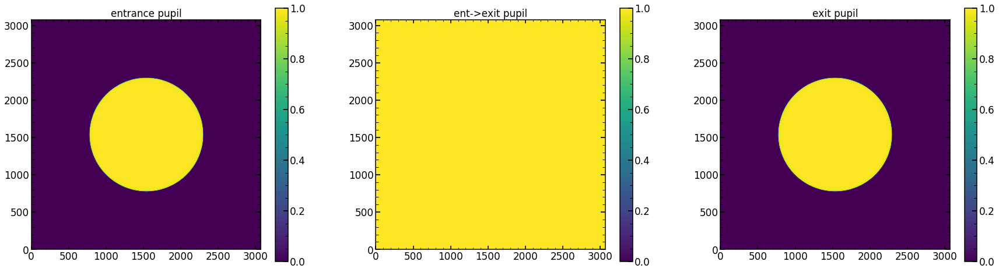

In [565]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

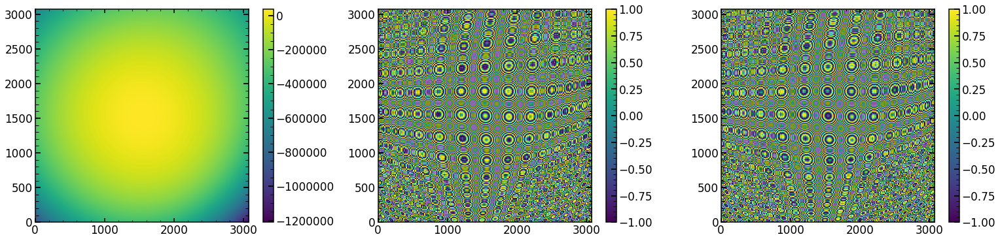

In [566]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

Text(0.5,1,'Residual')

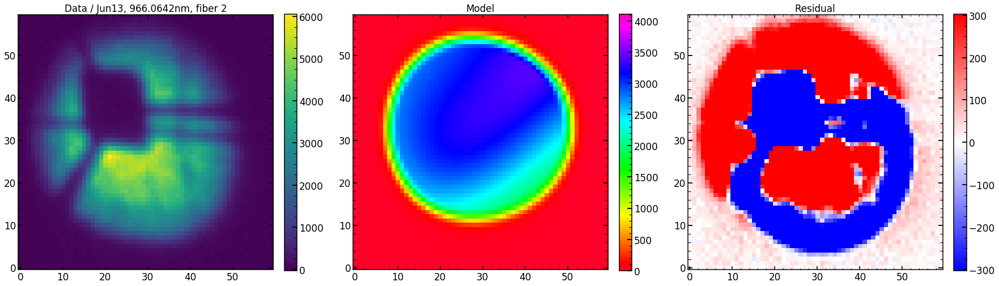

In [569]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(ndimage.rotate(res_iapetus, 180),vmax=np.max(res_iapetus)*1.2,cmap='gist_rainbow')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

## checking again (July 22) - found correct way to rotate and fixed it above

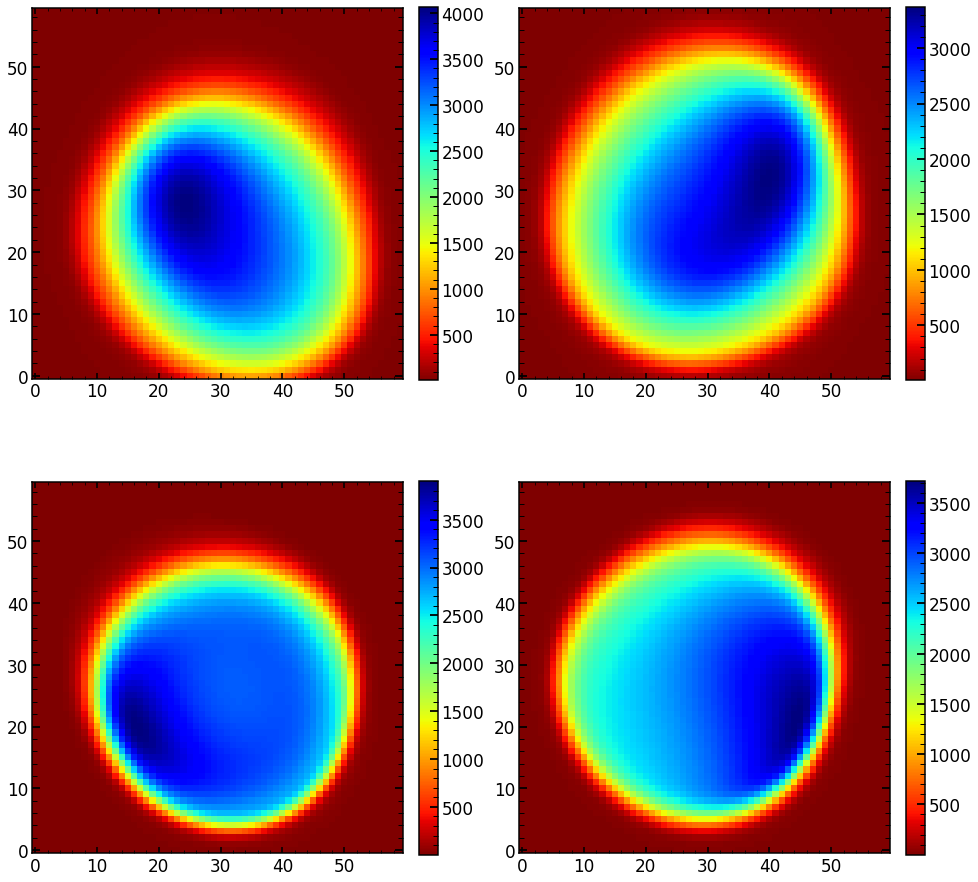

In [640]:
plt.figure(figsize=(16,16))

plt.subplot(2,2,1)
plt.imshow(res_iapetus_upper_left_data,vmax=np.max(res_iapetus_upper_left_data)*1.0,cmap='jet_r')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(2,2,2)
plt.imshow(res_iapetus_upper_right_data,vmax=np.max(res_iapetus_upper_right_data)*1.0,cmap='jet_r')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(2,2,3)
plt.imshow(res_iapetus_lower_left_data,vmax=np.max(res_iapetus_lower_left_data)*1.0,cmap='jet_r')
plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(2,2,4)
plt.imshow(res_iapetus_lower_right_data,vmax=np.max(res_iapetus_lower_right_data)*1.0,cmap='jet_r')
plt.colorbar(fraction=0.046, pad=0.04)


In [581]:
wave=1
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July18/Wave_'+str(wave)+'_Field_'+str(field)+'_Z4_positive_wavefront.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_11=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_wave_1_field_11_only_z4_to_z22=wavelength_correction_single(WaveField_wave_1_field_11,630)[3:22]
minchain_wave_1_field_11=np.copy(minchain_Zemax)
minchain_wave_1_field_11[0:19]=WaveField_wave_1_field_11_only_z4_to_z22

wave=1
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July18/Wave_'+str(wave)+'_Field_'+str(field)+'_Z4_positive_wavefront.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_12=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_wave_1_field_12_only_z4_to_z22=wavelength_correction_single(WaveField_wave_1_field_12,630)[3:22]
minchain_wave_1_field_12=np.copy(minchain_Zemax)
minchain_wave_1_field_12[0:19]=WaveField_wave_1_field_12_only_z4_to_z22

wave=11
field=11
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July18/Wave_'+str(wave)+'_Field_'+str(field)+'_Z4_positive_wavefront.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_11=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_wave_11_field_11_only_z4_to_z22=wavelength_correction_single(WaveField_wave_11_field_11,970)[3:22]
minchain_wave_11_field_11=np.copy(minchain_Zemax)
minchain_wave_11_field_11[0:19]=WaveField_wave_11_field_11_only_z4_to_z22

wave=11
field=12
f = io.open('/Users/nevencaplar/Documents/PFS/FromZemax/July18/Wave_'+str(wave)+'_Field_'+str(field)+'_Z4_positive_wavefront.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_12=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=38, delimiter='\t')[:,1]
WaveField_wave_11_field_12_only_z4_to_z22=wavelength_correction_single(WaveField_wave_11_field_12,970)[3:22]
minchain_wave_11_field_12=np.copy(minchain_Zemax)
minchain_wave_11_field_12[0:19]=WaveField_wave_11_field_12_only_z4_to_z22

In [681]:
minchain_wave_11_field_11

array([   28.45978843,    -0.45354437,     0.00182885,     0.53089346,
          -0.0414396 ,    -0.50216539,    -0.48767687,    -0.68379884,
           0.01382628,    -0.20159927,     0.04992623,     0.02440966,
           0.03359317,    -0.01687309,    -0.01115471,     0.02323721,
          -0.00896371,     0.00437029,     0.03341606,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.04612443,     0.00002458,     0.00002459,     0.        ,
           0.        ,     0.        ,     0.        ,     0.99      ,
           0.001     ,     0.64367019,     1.04428742,     0.62127015,
       17074.93067039,     2.25748184,     0.001     ,     0.53813405,
           1.80279228,     0.9913704 ])

In [801]:
f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_11_Z4_positive.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_11_image=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_12_Z4_positive.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_12_image=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_11_Z4_positive.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_11_image=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_12_Z4_positive.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_12_image=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_11_Z4_positive_with_detector.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_11_image_with_detector=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_12_Z4_positive_with_detector.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_12_image_with_detector=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_11_Z4_positive_with_detector.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_11_image_with_detector=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_12_Z4_positive_with_detector.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_12_image_with_detector=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')


Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

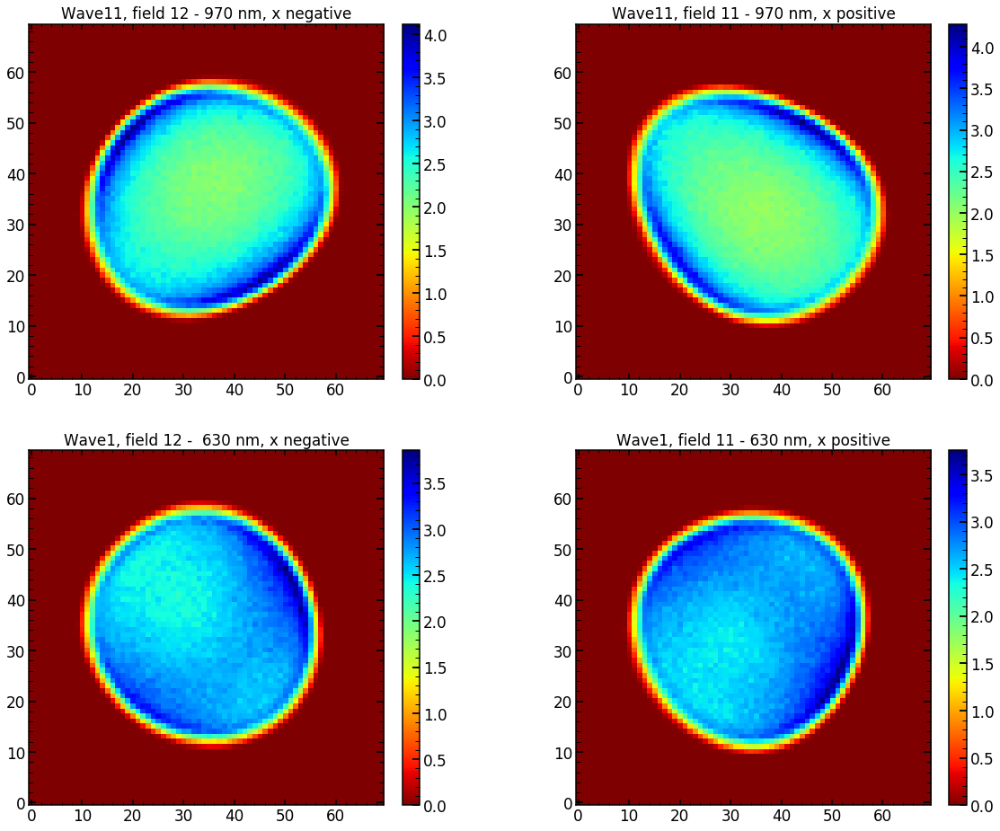

In [616]:
plt.figure(figsize=(20,16))
plt.subplot(2,2,1)
plt.imshow(WaveField_wave_11_field_12_image,vmax=np.max(WaveField_wave_11_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')


plt.subplot(2,2,2)
plt.imshow(WaveField_wave_11_field_11_image,vmax=np.max(WaveField_wave_11_field_11_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')

plt.subplot(2,2,3)
plt.imshow(WaveField_wave_1_field_12_image,vmax=np.max(WaveField_wave_1_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')

plt.subplot(2,2,4)
plt.imshow(WaveField_wave_1_field_11_image,vmax=np.max(WaveField_wave_1_field_11_image)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')


Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

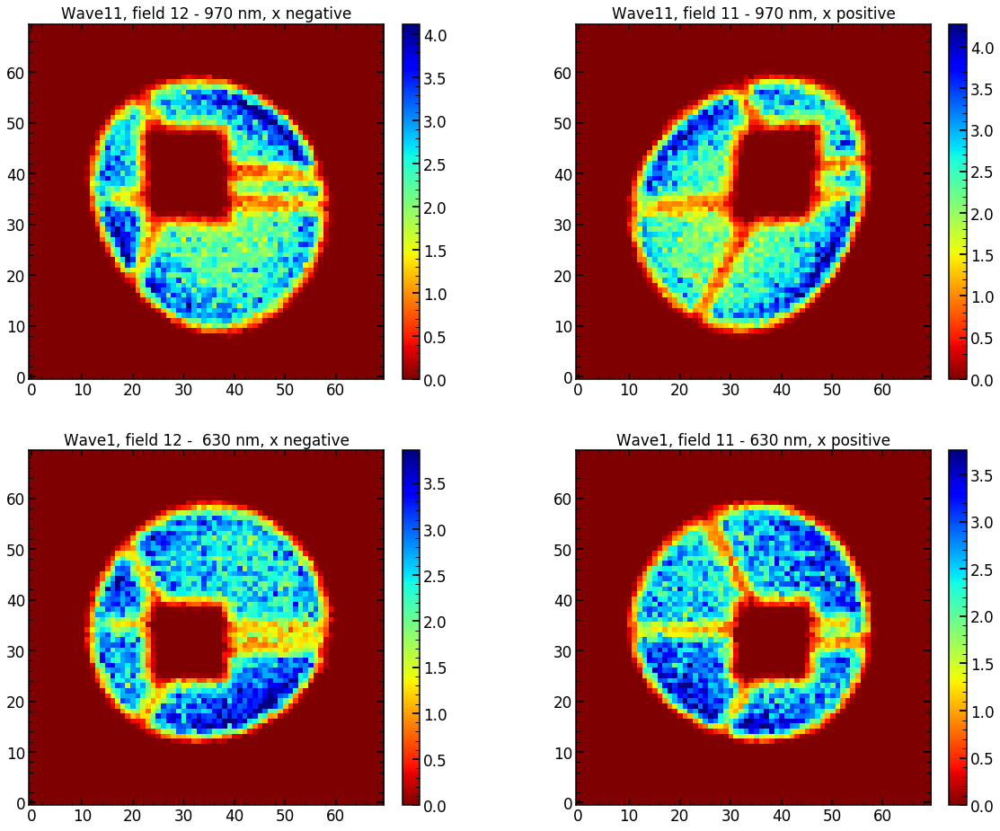

In [805]:
plt.figure(figsize=(20,16))
plt.subplot(2,2,1)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_12_image_with_detector, 90),vmax=np.max(WaveField_wave_11_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')


plt.subplot(2,2,2)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_11_image_with_detector, 90),vmax=np.max(WaveField_wave_11_field_11_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')

plt.subplot(2,2,3)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_12_image_with_detector, 90),vmax=np.max(WaveField_wave_1_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')
ndimage.rotate(res_wave_11_field_12, -90)
plt.subplot(2,2,4)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_11_image_with_detector, 90),vmax=np.max(WaveField_wave_1_field_11_image)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')

In [806]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain_wave_1_field_11)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_11=optPsf_cut_fiber_convolved_downsampled
res_wave_1_field_11=res_wave_1_field_11*np.max(WaveField_wave_1_field_11_image)/np.max(res_wave_1_field_11)


model(minchain_wave_1_field_12)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12=optPsf_cut_fiber_convolved_downsampled
res_wave_1_field_12=res_wave_1_field_12*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12)


model(minchain_wave_11_field_11)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_11_field_11=optPsf_cut_fiber_convolved_downsampled
res_wave_11_field_11=res_wave_11_field_11*np.max(WaveField_wave_11_field_11_image)/np.max(res_wave_11_field_11)

model(minchain_wave_11_field_12)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_11_field_12=optPsf_cut_fiber_convolved_downsampled
res_wave_11_field_12=res_wave_11_field_12*np.max(WaveField_wave_11_field_12_image)/np.max(res_wave_11_field_12)

extraZernike: None
zmax: 22
42
42
42
42


In [1251]:
np.save('optPsf_cut_fiber_convolved_downsampled',optPsf_cut_fiber_convolved_downsampled)

SyntaxError: invalid syntax (<ipython-input-1252-54e1a015b0b6>, line 1)

Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

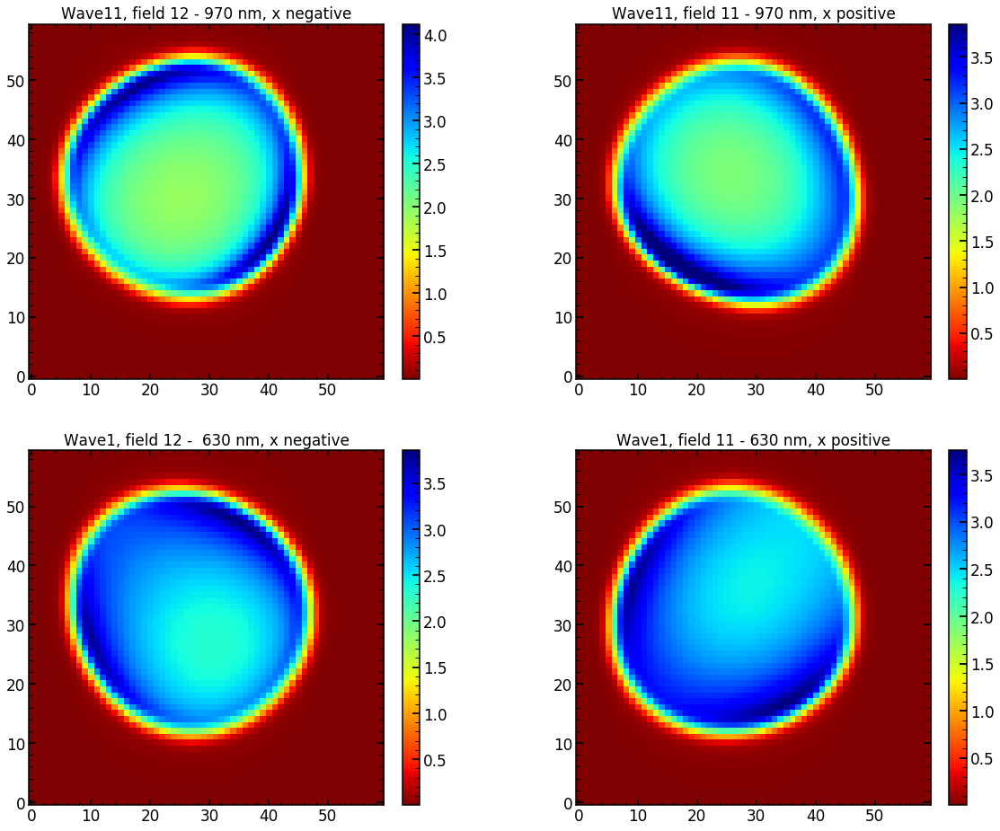

In [807]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.imshow(res_wave_11_field_12,vmax=np.max(res_wave_11_field_12)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')


plt.subplot(2,2,2)
plt.imshow(res_wave_11_field_11,vmax=np.max(res_wave_1_field_12),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')


plt.subplot(2,2,3)
plt.imshow(res_wave_1_field_12,vmax=np.max(res_wave_1_field_12),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')


plt.subplot(2,2,4)
plt.imshow(res_wave_1_field_11,vmax=np.max(res_wave_1_field_11),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')






Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

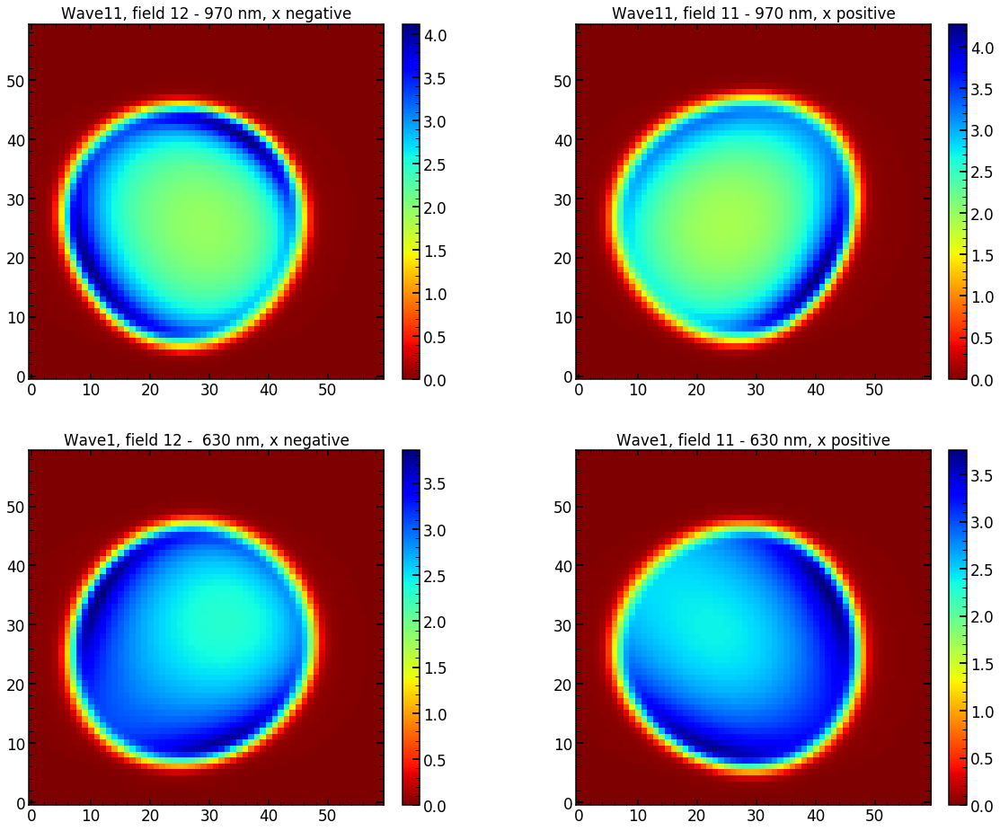

In [809]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.imshow(ndimage.rotate(res_wave_11_field_12,-90),vmax=np.max(res_wave_11_field_12)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')


plt.subplot(2,2,2)
plt.imshow(ndimage.rotate(res_wave_11_field_11, -90),vmax=np.max(res_wave_11_field_11),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')


plt.subplot(2,2,3)
plt.imshow(ndimage.rotate(res_wave_1_field_12, -90),vmax=np.max(res_wave_1_field_12),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')


plt.subplot(2,2,4)
plt.imshow(ndimage.rotate(res_wave_1_field_11, -90),vmax=np.max(res_wave_1_field_11),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')

In [699]:
np.zeros((18))

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0.])

In [783]:
def rotate_wavefront(minchain_wave_11_field_11):
    WaveField_upper_left_only_z4_to_z22=np.copy(minchain_wave_11_field_11[0:19])
    WaveField_upper_left_only_z4_to_z22_modified=np.zeros((19))

    # z4_new = z4_old
    WaveField_upper_left_only_z4_to_z22_modified[0]=WaveField_upper_left_only_z4_to_z22[0]

    # z5_new = -z5_old
    WaveField_upper_left_only_z4_to_z22_modified[0+1]=-WaveField_upper_left_only_z4_to_z22[0+1]
    # z6_new = -z6_old
    WaveField_upper_left_only_z4_to_z22_modified[1+1]=-WaveField_upper_left_only_z4_to_z22[1+1]
    
    # z7_new = z8_old
    WaveField_upper_left_only_z4_to_z22_modified[2+1]=WaveField_upper_left_only_z4_to_z22[3+1]
    # z8_new = -z7_old
    WaveField_upper_left_only_z4_to_z22_modified[3+1]=-WaveField_upper_left_only_z4_to_z22[2+1]
    
    # z9_new = -z10_old
    WaveField_upper_left_only_z4_to_z22_modified[4+1]=-WaveField_upper_left_only_z4_to_z22[5+1]
    # z10_new = z9_old
    WaveField_upper_left_only_z4_to_z22_modified[5+1]=WaveField_upper_left_only_z4_to_z22[4+1]
    
    # z11_new = z11_old
    WaveField_upper_left_only_z4_to_z22_modified[6+1]=WaveField_upper_left_only_z4_to_z22[6+1]
    
    # z12_new = -z12_old
    WaveField_upper_left_only_z4_to_z22_modified[7+1]=-WaveField_upper_left_only_z4_to_z22[7+1]
    # z13_new = -z13_old
    WaveField_upper_left_only_z4_to_z22_modified[8+1]=-WaveField_upper_left_only_z4_to_z22[8+1]
    
    # z14_new = z14_old
    WaveField_upper_left_only_z4_to_z22_modified[9+1]=WaveField_upper_left_only_z4_to_z22[9+1]
    # z15_new = z15_old
    WaveField_upper_left_only_z4_to_z22_modified[10+1]=WaveField_upper_left_only_z4_to_z22[10+1]
    
    # z16_new = -z17_old
    WaveField_upper_left_only_z4_to_z22_modified[11+1]=-WaveField_upper_left_only_z4_to_z22[12+1]
    # z17_new = z16_old
    WaveField_upper_left_only_z4_to_z22_modified[12+1]=-WaveField_upper_left_only_z4_to_z22[11+1]
    
    # z18_new = z19_old
    WaveField_upper_left_only_z4_to_z22_modified[13+1]=WaveField_upper_left_only_z4_to_z22[14+1]
    # z19_new = -z18_old
    WaveField_upper_left_only_z4_to_z22_modified[14+1]=-WaveField_upper_left_only_z4_to_z22[13+1]
    
    # z20_new = -z21_old
    WaveField_upper_left_only_z4_to_z22_modified[15+1]=-WaveField_upper_left_only_z4_to_z22[16+1]
    # z21_new = z20_old
    WaveField_upper_left_only_z4_to_z22_modified[16+1]=WaveField_upper_left_only_z4_to_z22[15+1]

    minchain_wave_11_field_11_rotated=np.copy(minchain_wave_11_field_11)
    minchain_wave_11_field_11_rotated[0:19]=WaveField_upper_left_only_z4_to_z22_modified
    return minchain_wave_11_field_11_rotated

In [784]:
minchain_wave_11_field_11_rotated=rotate_wavefront(minchain_wave_11_field_11)
minchain_wave_11_field_12_rotated=rotate_wavefront(minchain_wave_11_field_12)
minchain_wave_1_field_11_rotated=rotate_wavefront(minchain_wave_1_field_11)
minchain_wave_1_field_12_rotated=rotate_wavefront(minchain_wave_1_field_12)

In [785]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain_wave_1_field_11_rotated)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_11=optPsf_cut_fiber_convolved_downsampled
res_wave_1_field_11_rotated=res_wave_1_field_11*np.max(WaveField_wave_1_field_11_image)/np.max(res_wave_1_field_11)


model(minchain_wave_1_field_12_rotated)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12=optPsf_cut_fiber_convolved_downsampled
res_wave_1_field_12_rotated=res_wave_1_field_12*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12)


model(minchain_wave_11_field_11_rotated)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_11_field_11=optPsf_cut_fiber_convolved_downsampled
res_wave_11_field_11_rotated=res_wave_11_field_11*np.max(WaveField_wave_11_field_11_image)/np.max(res_wave_11_field_11)

model(minchain_wave_11_field_12_rotated)
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_11_field_12=optPsf_cut_fiber_convolved_downsampled
res_wave_11_field_12_rotated=res_wave_11_field_12*np.max(WaveField_wave_11_field_12_image)/np.max(res_wave_11_field_12)

extraZernike: None
zmax: 22
42
42
42
42


Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

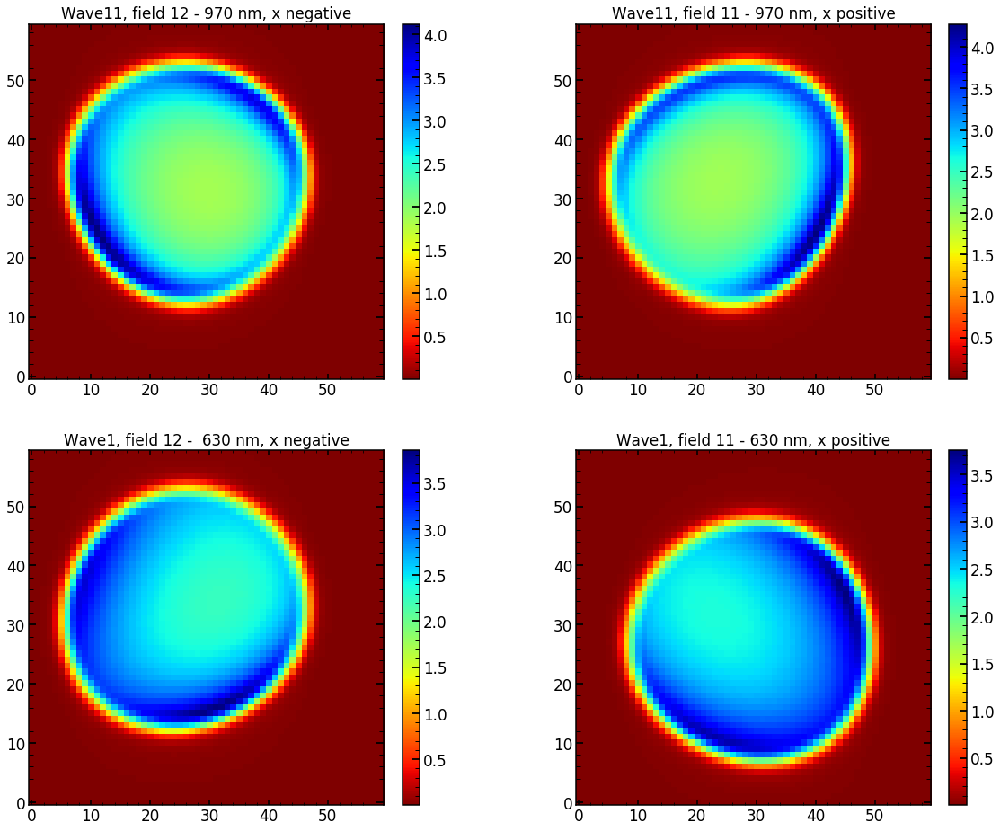

In [786]:
plt.figure(figsize=(20,16))

plt.subplot(2,2,1)
plt.imshow(res_wave_11_field_12_rotated,vmax=np.max(res_wave_11_field_12_rotated)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')


plt.subplot(2,2,2)
plt.imshow(res_wave_11_field_11_rotated,vmax=np.max(res_wave_11_field_11_rotated),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')


plt.subplot(2,2,3)
plt.imshow(res_wave_1_field_12_rotated,vmax=np.max(res_wave_1_field_12_rotated),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')


plt.subplot(2,2,4)
plt.imshow(res_wave_1_field_11_rotated,vmax=np.max(res_wave_1_field_11_rotated),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')

In [641]:
### testing (again) orientations of each

In [726]:
minchain_wave_1_field_12_test_single=np.copy(minchain_wave_1_field_12)

In [727]:
minchain_wave_1_field_12_test_single[1:19]=np.zeros((1,18))

In [742]:
minchain_wave_1_field_12_test_single_z5p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z5p[1]=1
minchain_wave_1_field_12_test_single_z5p

minchain_wave_1_field_12_test_single_z5m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z5m[1]=-1
minchain_wave_1_field_12_test_single_z5m

minchain_wave_1_field_12_test_single_z6p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z6p[2]=1
minchain_wave_1_field_12_test_single_z6p

minchain_wave_1_field_12_test_single_z6m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z6m[2]=-1
minchain_wave_1_field_12_test_single_z6m

minchain_wave_1_field_12_test_single_z7p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z7p[3]=1
minchain_wave_1_field_12_test_single_z7p

minchain_wave_1_field_12_test_single_z7m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z7m[3]=-1
minchain_wave_1_field_12_test_single_z7m

minchain_wave_1_field_12_test_single_z8p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z8p[4]=1
minchain_wave_1_field_12_test_single_z8p

minchain_wave_1_field_12_test_single_z8m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z8m[4]=-1
minchain_wave_1_field_12_test_single_z8m

minchain_wave_1_field_12_test_single_z9p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z9p[5]=1
minchain_wave_1_field_12_test_single_z9p

minchain_wave_1_field_12_test_single_z9m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z9m[5]=-1
minchain_wave_1_field_12_test_single_z9m

minchain_wave_1_field_12_test_single_z10p=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z10p[6]=1
minchain_wave_1_field_12_test_single_z10p

minchain_wave_1_field_12_test_single_z10m=np.copy(minchain_wave_1_field_12_test_single)
minchain_wave_1_field_12_test_single_z10m[6]=-1
minchain_wave_1_field_12_test_single_z10m

array([   27.65109748,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,    -1.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.        ,     0.        ,     0.        ,     0.        ,
           0.04612443,     0.00002458,     0.00002459,     0.        ,
           0.        ,     0.        ,     0.        ,     0.99      ,
           0.001     ,     0.64367019,     1.04428742,     0.62127015,
       17074.93067039,     2.25748184,     0.001     ,     0.53813405,
           1.80279228,     0.9913704 ])

In [657]:
model(minchain_wave_1_field_12_test_single)
optPsf_cut_fiber_convolved_downsampled_test00=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_test00=optPsf_cut_fiber_convolved_downsampled_test00
res_wave_1_field_12_test00=res_wave_1_field_12_test00*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_test00)

42


In [669]:
model(minchain_wave_1_field_12_test_single_z5p)
optPsf_cut_fiber_convolved_downsampled_z5p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z5p=optPsf_cut_fiber_convolved_downsampled_z5p
res_wave_1_field_12_z5p=res_wave_1_field_12_z5p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z5p)

42


In [670]:
model(minchain_wave_1_field_12_test_single_z5m)
optPsf_cut_fiber_convolved_downsampled_z5m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z5m=optPsf_cut_fiber_convolved_downsampled_z5m
res_wave_1_field_12_z5m=res_wave_1_field_12_z5m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z5m)

42


In [673]:
model(minchain_wave_1_field_12_test_single_z6p)
optPsf_cut_fiber_convolved_downsampled_z6p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z6p=optPsf_cut_fiber_convolved_downsampled_z6p
res_wave_1_field_12_z6p=res_wave_1_field_12_z6p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z6p)

42


In [729]:
model(minchain_wave_1_field_12_test_single_z6m)
optPsf_cut_fiber_convolved_downsampled_z6m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z6m=optPsf_cut_fiber_convolved_downsampled_z6m
res_wave_1_field_12_z6m=res_wave_1_field_12_z6m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z6m)

42


In [734]:
model(minchain_wave_1_field_12_test_single_z7m)
optPsf_cut_fiber_convolved_downsampled_z7m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z7m=optPsf_cut_fiber_convolved_downsampled_z7m
res_wave_1_field_12_z7m=res_wave_1_field_12_z7m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z7m)

model(minchain_wave_1_field_12_test_single_z7p)
optPsf_cut_fiber_convolved_downsampled_z7p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z7p=optPsf_cut_fiber_convolved_downsampled_z7p
res_wave_1_field_12_z7p=res_wave_1_field_12_z7p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z7p)

model(minchain_wave_1_field_12_test_single_z8m)
optPsf_cut_fiber_convolved_downsampled_z8m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z8m=optPsf_cut_fiber_convolved_downsampled_z8m
res_wave_1_field_12_z8m=res_wave_1_field_12_z8m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z8m)

model(minchain_wave_1_field_12_test_single_z8p)
optPsf_cut_fiber_convolved_downsampled_z8p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z8p=optPsf_cut_fiber_convolved_downsampled_z8p
res_wave_1_field_12_z8p=res_wave_1_field_12_z8p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z8p)


42
42
42
42


In [746]:
model(minchain_wave_1_field_12_test_single_z9m)
optPsf_cut_fiber_convolved_downsampled_z9m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z9m=optPsf_cut_fiber_convolved_downsampled_z9m
res_wave_1_field_12_z9m=res_wave_1_field_12_z9m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z9m)

model(minchain_wave_1_field_12_test_single_z9p)
optPsf_cut_fiber_convolved_downsampled_z9p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z9p=optPsf_cut_fiber_convolved_downsampled_z9p
res_wave_1_field_12_z9p=res_wave_1_field_12_z9p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z9p)

model(minchain_wave_1_field_12_test_single_z10m)
optPsf_cut_fiber_convolved_downsampled_z10m=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z10m=optPsf_cut_fiber_convolved_downsampled_z10m
res_wave_1_field_12_z10m=res_wave_1_field_12_z10m*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z10m)

model(minchain_wave_1_field_12_test_single_z10p)
optPsf_cut_fiber_convolved_downsampled_z10p=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_wave_1_field_12_z10p=optPsf_cut_fiber_convolved_downsampled_z10p
res_wave_1_field_12_z10p=res_wave_1_field_12_z10p*np.max(WaveField_wave_1_field_12_image)/np.max(res_wave_1_field_12_z10p)


42
42
42
42


Text(0.5,1,'Wave11, field 11 - 970 nm, x positive')

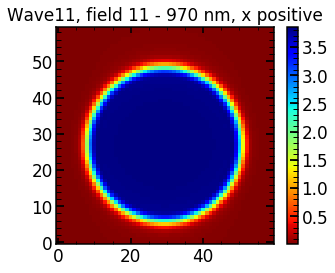

In [658]:
plt.imshow(res_wave_1_field_12_test00,vmax=np.max(res_wave_1_field_12_test00),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')

Text(0.5,1,'z5 positive, rotated')

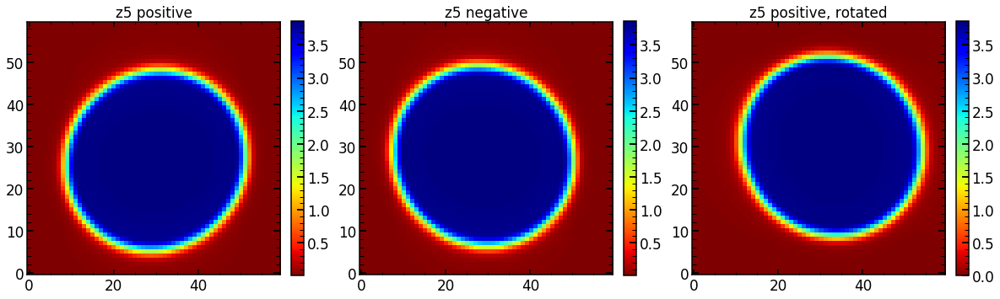

In [780]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z5p,vmax=np.max(res_wave_1_field_12_z5p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z5 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z5m,vmax=np.max(res_wave_1_field_12_z5m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z5 negative')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z5p, -90),vmax=np.max(res_wave_1_field_12_z5m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z5 positive, rotated')

Text(0.5,1,'z6 positive, rotated')

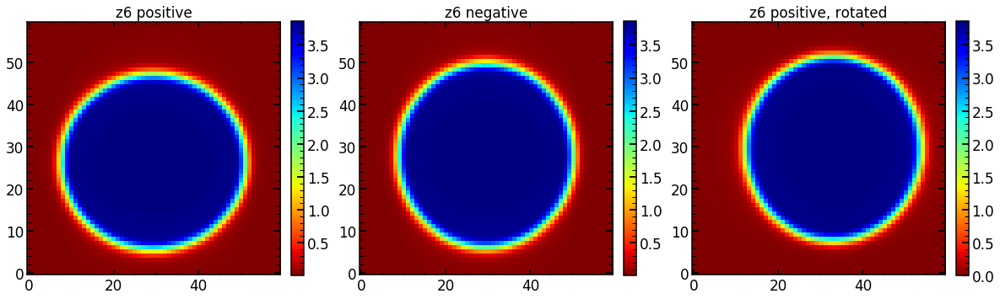

In [781]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z6p,vmax=np.max(res_wave_1_field_12_z6p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z6 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z6m,vmax=np.max(res_wave_1_field_12_z6m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z6 negative')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z6p, -90),vmax=np.max(res_wave_1_field_12_z6p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z6 positive, rotated')

Text(0.5,1,'z7 positive')

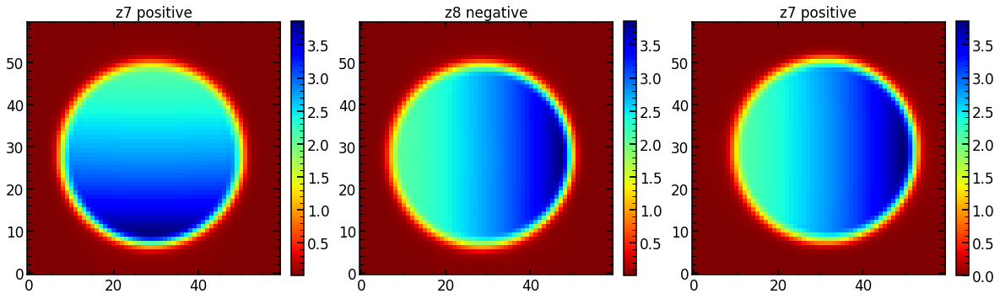

In [738]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z7p,vmax=np.max(res_wave_1_field_12_z7p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z7 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z8m,vmax=np.max(res_wave_1_field_12_z8m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z8 negative')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z7p, -90),vmax=np.max(res_wave_1_field_12_z7p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z7 positive')

Text(0.5,1,'z8 positive')

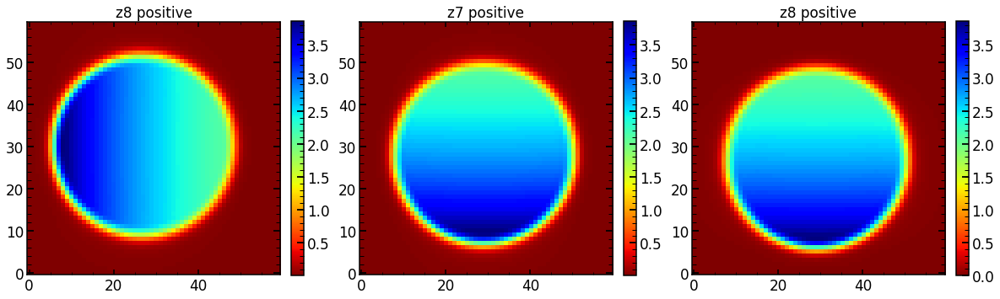

In [740]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z8p,vmax=np.max(res_wave_1_field_12_z8p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z8 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z7p,vmax=np.max(res_wave_1_field_12_z7p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z7 positive')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z8p, -90),vmax=np.max(res_wave_1_field_12_z8p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z8 positive')

Text(0.5,1,'z9 positive rotated')

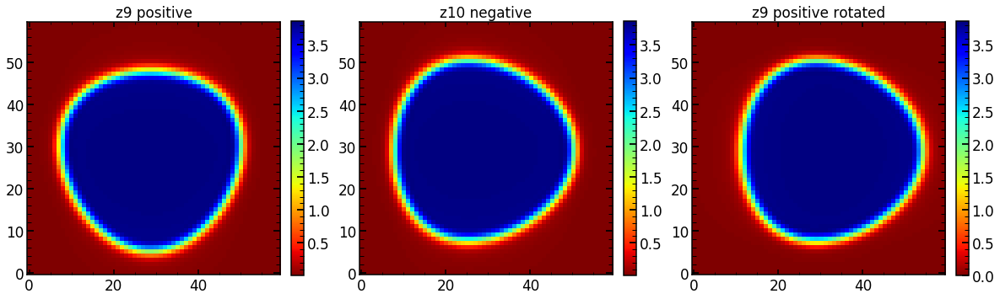

In [760]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z9p,vmax=np.max(res_wave_1_field_12_z9p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z10p,vmax=np.max(res_wave_1_field_12_z10m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z10 positive')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z9p, -90),vmax=np.max(res_wave_1_field_12_z10p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9 positive rotated')

Text(0.5,1,'z10 positive rotated')

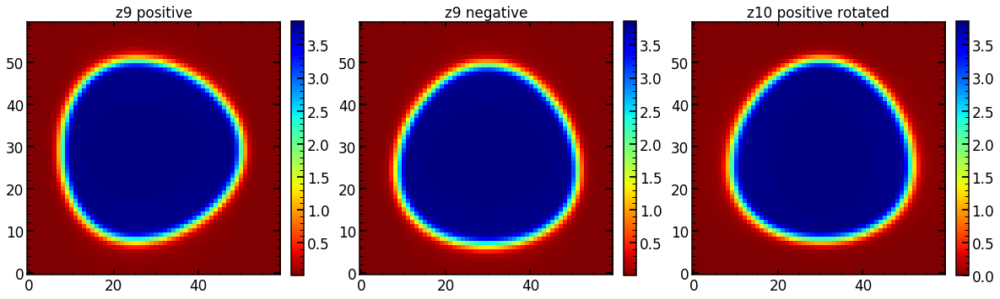

In [782]:
plt.figure(figsize=(20,8))

plt.subplot(131)
plt.imshow(res_wave_1_field_12_z10p,vmax=np.max(res_wave_1_field_12_z9p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9 positive')

plt.subplot(132)
plt.imshow(res_wave_1_field_12_z9m,vmax=np.max(res_wave_1_field_12_z10p),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z9 negative')

plt.subplot(133)
plt.imshow(ndimage.rotate(res_wave_1_field_12_z10p, -90),vmax=np.max(res_wave_1_field_12_z9m),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('z10 positive rotated')

# Jul 04

## create scripts

In [601]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  

In [602]:
list_of_HgAr_to_analyze=finalHgAr_May2019.index[(finalHgAr_May2019['fiber'].values.astype(int)<=650)&(finalHgAr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_May2019['close'].values.astype(int)==1)]
print(len(list_of_HgAr_to_analyze))


50


In [604]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T09S'+str(single_spot)+'Jun.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, p35, m05, p05,m3,p3,m15,p15
    for obs in [17023,17023+108,17023+48,17023+12,17023+102,17023+42,17023+54,17023+12,17023+96,17023+30,17023+66]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Jun_MPI02_Zemax.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr 3\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/JunScriptToSubmitScriptsTiger09'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T09S'+str(single_spot)+'Jun.sh \n')

file.close()

## which images are avaliable 

In [1386]:
import glob
date='Jul04'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)

In [1387]:
#analyzed_Neon_images=[]
#for i in range(len(Emcee3_Ne)):
#    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
#    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
#    
#analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [1388]:
#arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
#arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [1389]:
arranged_by_spot_number_HgAr

array([[17089,     1],
       [17071,     1],
       [17065,     1],
       [17035,     1],
       [17023,     1],
       [17119,     1],
       [17053,     1],
       [17077,     1],
       [17089,     3],
       [17119,     3],
       [17023,     3],
       [17071,     3],
       [17053,     3],
       [17065,     3],
       [17077,     3],
       [17035,     6],
       [17023,     6],
       [17065,     6],
       [17089,     6],
       [17053,     6],
       [17077,     6],
       [17071,     6],
       [17071,     9],
       [17077,     9],
       [17089,     9],
       [17065,     9],
       [17053,     9],
       [17035,     9],
       [17023,     9],
       [17119,     9],
       [17023,    11],
       [17089,    11],
       [17035,    11],
       [17119,    11],
       [17071,    11],
       [17065,    11],
       [17077,    11],
       [17071,    13],
       [17089,    13],
       [17119,    13],
       [17065,    13],
       [17035,    13],
       [17023,    13],
       [170

## Analysis of a single

In [14]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


    
date='Jul04'
obs=17017+54
single_number='51'
image_index=int(single_number)
eps=5
arc='HgAr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    else:
        print("Not recognized arc-line")
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber                          339
xc                            1610
yc                            1190
wavelength               727.47876
close                            1
lamp                          HgAr
xc_effective                  1610
old_index_approx                75
superold_index_approx          nan
Name: 51, dtype: object

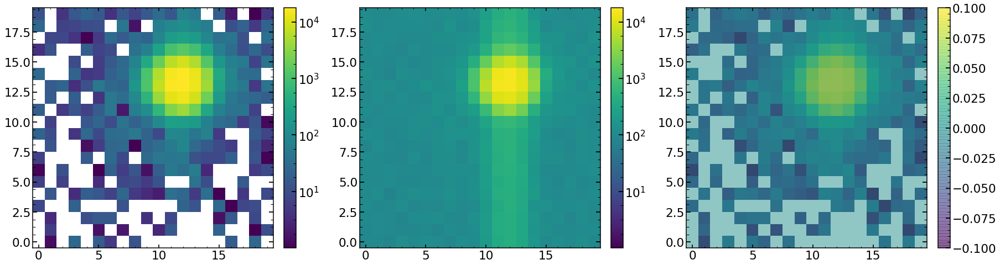

In [15]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(132)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(133)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
plt.imshow(mask_image,origin='lower',vmin=0,vmax=np.max(mask_image),alpha=0.5)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [16]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 460.88110969134414
minimal chi2 reduced is: 2.2688573933042


In [17]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)


NameError: name 'columns22' is not defined

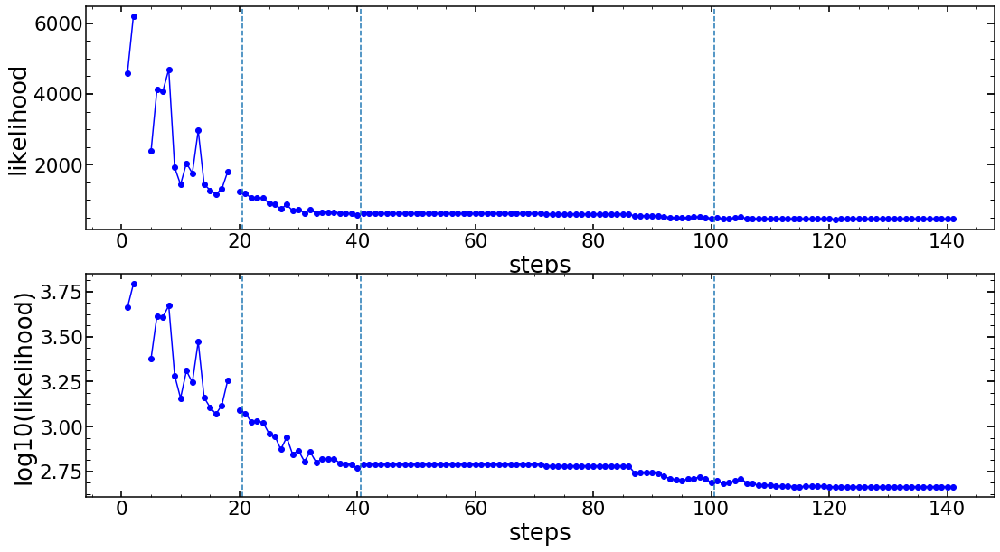

In [18]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [19]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-463.2783479895715

In [20]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

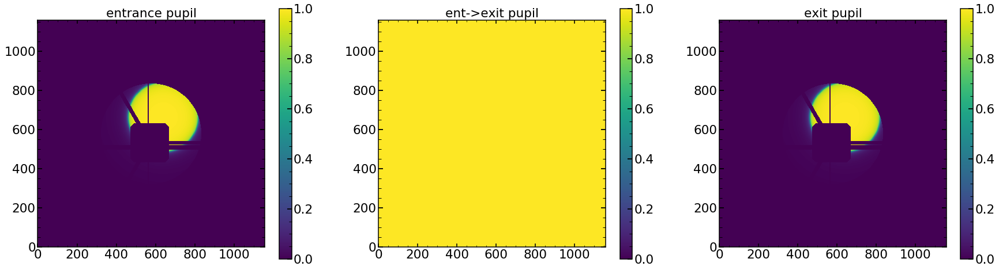

In [21]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

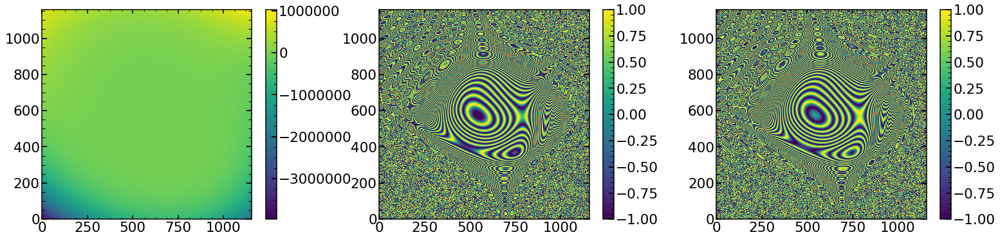

In [22]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

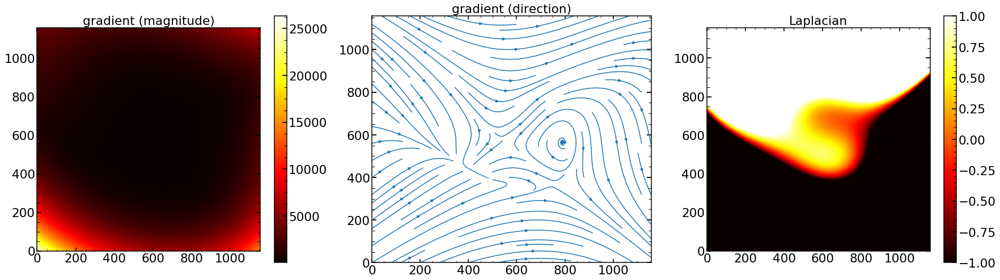

In [23]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

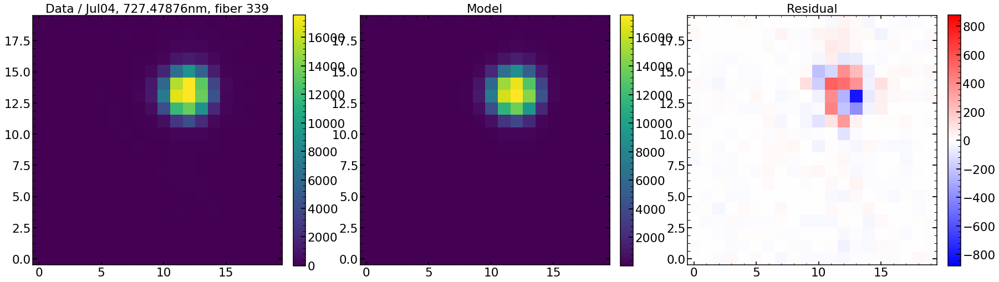

In [24]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 2.280843595291791
Abs of residual divided by total flux is: 0.05469974729781386
Abs of residual divided by largest value of a flux in the image is: 0.045309437640049105


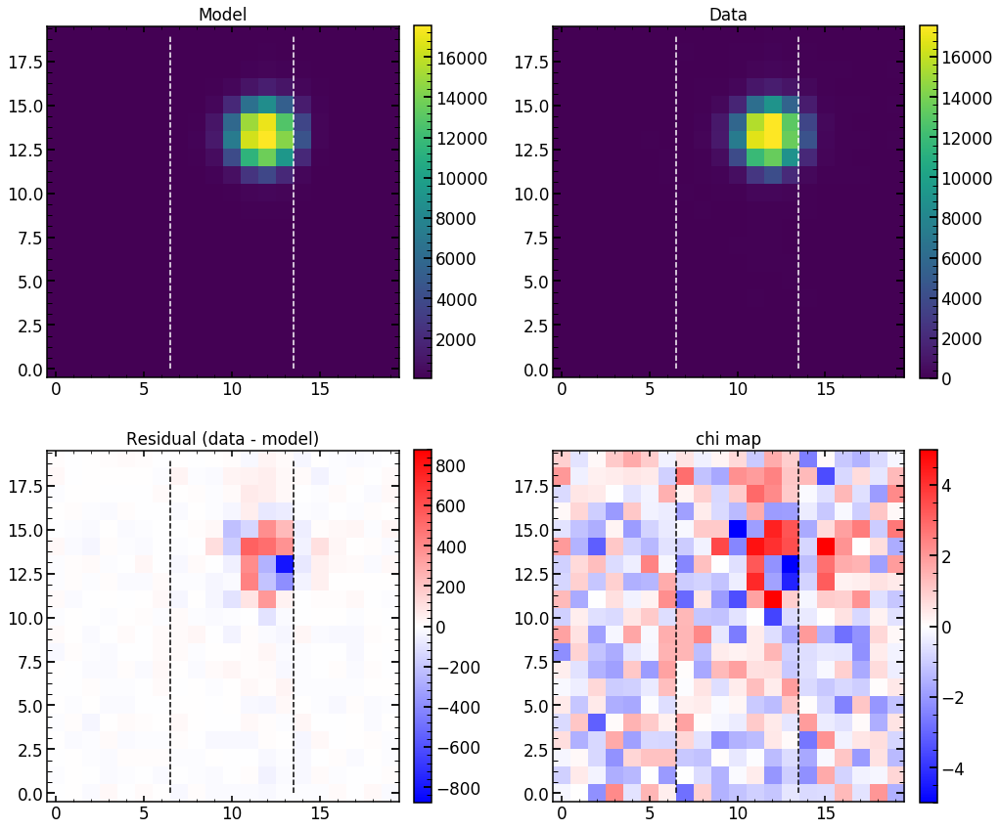

In [25]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

2.280843595291791
chi**2 reduced is: 2.280843595291791
Abs of residual divided by total flux is: 0.05469974729781386
Abs of residual divided by largest value of a flux in the image is: 0.045309437640049105


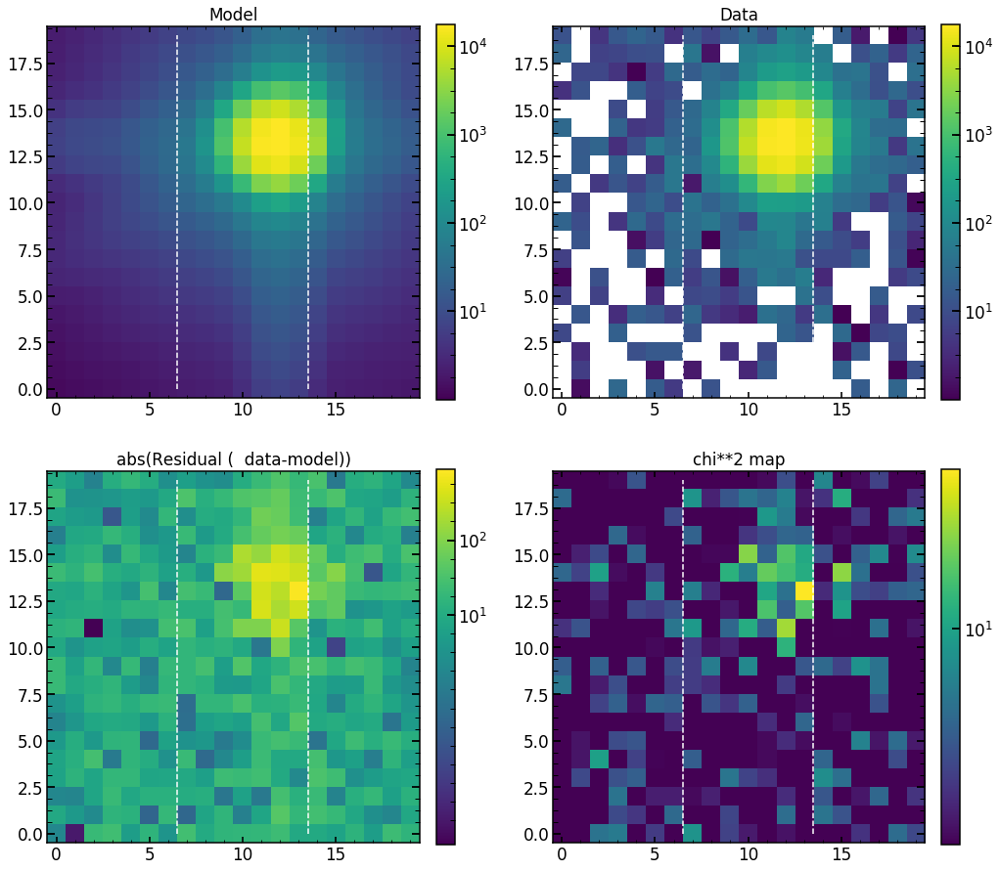

In [26]:
single_analysis.create_basic_comparison_plot_log()

2.280843595291791
chi**2 reduced is: 2.280843595291791
Abs of residual divided by total flux is: 0.05469974729781386
Abs of residual divided by largest value of a flux in the image is: 0.045309437640049105


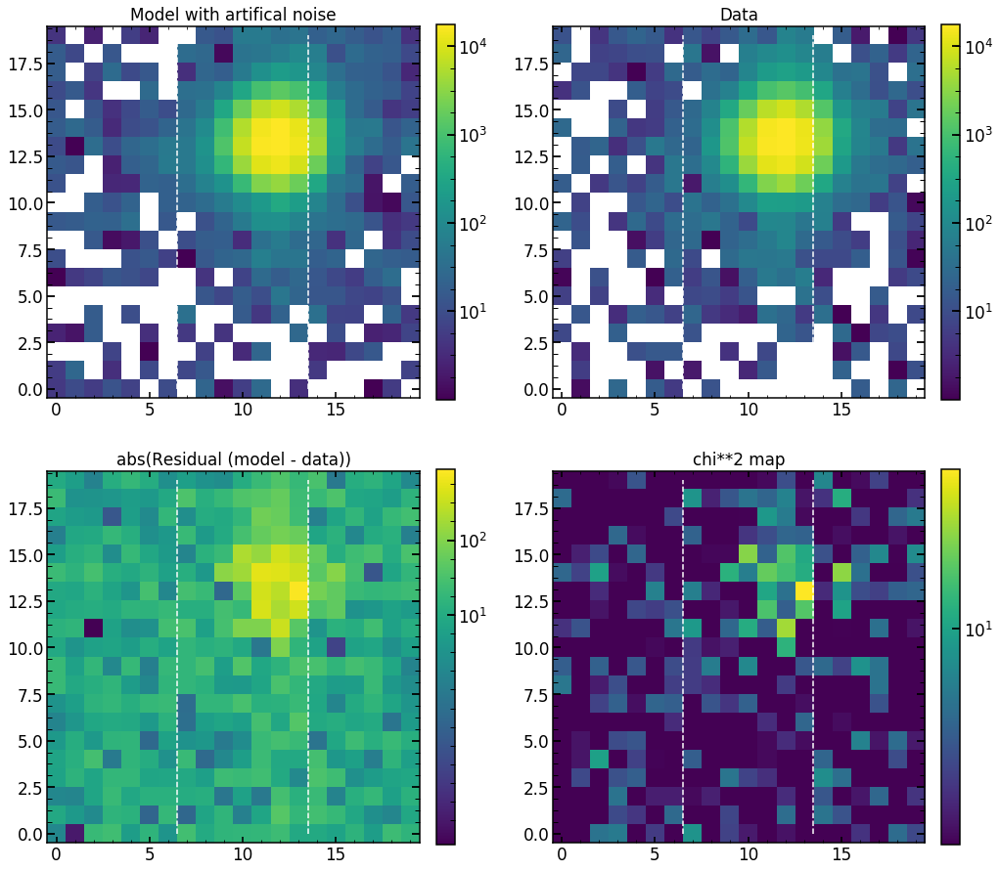

In [27]:
single_analysis.create_basic_comparison_plot_log_artifical()

## Creating  results everywhere

In [58]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019
date='Jul04'


results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(1,len(finalHgAr)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'HgAr',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]


22
1 obs (Emcee3): 17023 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
1 17029 HgAr is NOT found or failed!
1 obs (Emcee3): 17035 is found!
z7: failed!
z9: failed!
x_ilum: failed!
det_vert: failed!
grating_lines: failed!
z7: failed!
z9: failed!
x_ilum: failed!
det_vert: failed!
grating_lines: failed!
1 17041 HgAr is NOT found or failed!
1 17047 HgAr is NOT found or failed!
1 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 17059 HgAr is NOT found or failed!
1 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
1 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_il

radiometricExponent: failed!
x_ilum: failed!
slitHolder_frac_dx: failed!
9 17029 HgAr is NOT found or failed!
9 obs (Emcee3): 17035 is found!
z18: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
z18: failed!
frd_sigma: failed!
slitHolder_frac_dx: failed!
grating_lines: failed!
9 17041 HgAr is NOT found or failed!
9 17047 HgAr is NOT found or failed!
9 obs (Emcee3): 17053 is found!
hscFrac: failed!
x_ilum: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
hscFrac: failed!
x_ilum: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
9 17059 HgAr is NOT found or failed!
9 obs (Emcee3): 17065 is found!
hscFrac: failed!
scattering_amplitude: failed!
hscFrac: failed!
scattering_amplitude: failed!
9 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: f

15 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17083 HgAr is NOT found or failed!
15 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17095 HgAr is NOT found or failed!
15 17101 HgAr is NOT found or failed!
15 17107 HgAr is NOT found or failed!
15 17113 HgAr is NOT found or failed!
15 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17071 HgAr is NOT found or failed!
22
16 17023 HgAr is NOT found or failed!
16 17029 HgAr is NOT found or failed!
16 17035 HgAr is NOT found or failed!
16 17041 HgAr is NOT found or faile

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17083 HgAr is NOT found or failed!
23 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17095 HgAr is NOT found or failed!
23 17101 HgAr is NOT found or failed!
23 17107 HgAr is NOT found or failed!
23 17113 HgAr is NOT found or failed!
23 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum

30 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
30 17083 HgAr is NOT found or failed!
30 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 17095 HgAr is NOT found or failed!
30 17101 HgAr is NOT found or failed!
30 17107 HgAr is NOT found or failed!
30 17113 HgAr is NOT found or failed!
30 obs (Emcee3): 17119 is found!
30 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 17071 HgAr is NOT found or failed!
22
31 17023 HgAr is NOT found or failed!
31 17029 HgAr is NOT found or failed!
31 17035 HgAr is NOT found or failed!
31 17041 HgAr is NOT found or failed!
31 17047 HgAr is NOT found or failed!
31 

22
38 17023 HgAr is NOT found or failed!
38 17029 HgAr is NOT found or failed!
38 17035 HgAr is NOT found or failed!
38 17041 HgAr is NOT found or failed!
38 17047 HgAr is NOT found or failed!
38 17053 HgAr is NOT found or failed!
38 17059 HgAr is NOT found or failed!
38 17065 HgAr is NOT found or failed!
38 17071 HgAr is NOT found or failed!
38 17071 HgAr is NOT found or failed!
38 17077 HgAr is NOT found or failed!
38 17083 HgAr is NOT found or failed!
38 17089 HgAr is NOT found or failed!
38 17095 HgAr is NOT found or failed!
38 17101 HgAr is NOT found or failed!
38 17107 HgAr is NOT found or failed!
38 17113 HgAr is NOT found or failed!
38 17119 HgAr is NOT found or failed!
38 17071 HgAr is NOT found or failed!
22
39 obs (Emcee3): 17023 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
39 17029 HgAr is NOT found or failed!
39 obs (Emcee3): 17035 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed

y_ilum: failed!
45 17095 HgAr is NOT found or failed!
45 17101 HgAr is NOT found or failed!
45 17107 HgAr is NOT found or failed!
45 17113 HgAr is NOT found or failed!
45 obs (Emcee3): 17119 is found!
strutFrac: failed!
radiometricExponent: failed!
grating_lines: failed!
strutFrac: failed!
radiometricExponent: failed!
grating_lines: failed!
45 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
45 17071 HgAr is NOT found or failed!
22
46 17023 HgAr is NOT found or failed!
46 17029 HgAr is NOT found or failed!
46 17035 HgAr is NOT found or failed!
46 17041 HgAr is NOT found or failed!
46 17047 HgAr is NOT found or failed!
46 17053 HgAr is NOT found or failed!
46 17059 HgAr is NOT found or failed!
46 17065 HgAr is NOT found or failed!
46 17071 HgAr is NOT found or failed!
46 17071 HgAr is NOT found or failed!
46 17077 HgAr is NOT found or failed!
46 17083 HgAr is NOT found or failed!
46 17089 HgAr is NOT found or failed!

54 17029 HgAr is NOT found or failed!
54 obs (Emcee3): 17035 is found!
54 17041 HgAr is NOT found or failed!
54 17047 HgAr is NOT found or failed!
54 obs (Emcee3): 17053 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
54 17059 HgAr is NOT found or failed!
54 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
54 17083 HgAr is NOT found or failed!
54 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: fai

61 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
61 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
61 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
61 17083 HgAr is NOT found or failed!
61 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
scattering_amplitude: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
frd_lorentz_factor: failed!
scattering_amplitude: failed!
61 17095 HgAr is NOT found or failed!
61 17101 HgAr is NOT found or failed!
61 17107 HgAr is NOT found or failed!
61 17113 HgAr is NOT found or failed!
61 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: fail

scattering_slope: failed!
69 17029 HgAr is NOT found or failed!
69 obs (Emcee3): 17035 is found!
dxFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
grating_lines: failed!
dxFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
grating_lines: failed!
69 17041 HgAr is NOT found or failed!
69 17047 HgAr is NOT found or failed!
69 obs (Emcee3): 17053 is found!
69 17059 HgAr is NOT found or failed!
69 obs (Emcee3): 17065 is found!
69 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
69 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
69 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
69 17083 HgAr is NOT found or failed!
69 17089 HgAr is NOT found or failed!
69 17095 HgAr is NOT found or failed!
69 17101 HgAr is NOT found or failed!


75 17071 HgAr is NOT found or failed!
22
76 17023 HgAr is NOT found or failed!
76 17029 HgAr is NOT found or failed!
76 17035 HgAr is NOT found or failed!
76 17041 HgAr is NOT found or failed!
76 17047 HgAr is NOT found or failed!
76 17053 HgAr is NOT found or failed!
76 17059 HgAr is NOT found or failed!
76 17065 HgAr is NOT found or failed!
76 17071 HgAr is NOT found or failed!
76 17071 HgAr is NOT found or failed!
76 17077 HgAr is NOT found or failed!
76 17083 HgAr is NOT found or failed!
76 17089 HgAr is NOT found or failed!
76 17095 HgAr is NOT found or failed!
76 17101 HgAr is NOT found or failed!
76 17107 HgAr is NOT found or failed!
76 17113 HgAr is NOT found or failed!
76 17119 HgAr is NOT found or failed!
76 17071 HgAr is NOT found or failed!
22
77 17023 HgAr is NOT found or failed!
77 17029 HgAr is NOT found or failed!
77 17035 HgAr is NOT found or failed!
77 17041 HgAr is NOT found or failed!
77 17047 HgAr is NOT found or failed!
77 17053 HgAr is NOT found or failed!
77 170

scattering_amplitude: failed!
z6: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
scattering_amplitude: failed!
83 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
83 17071 HgAr is NOT found or failed!
22
84 17023 HgAr is NOT found or failed!
84 17029 HgAr is NOT found or failed!
84 17035 HgAr is NOT found or failed!
84 17041 HgAr is NOT found or failed!
84 17047 HgAr is NOT found or failed!
84 17053 HgAr is NOT found or failed!
84 17059 HgAr is NOT found or failed!
84 17065 HgAr is NOT found or failed!
84 17071 HgAr is NOT found or failed!
84 17071 HgAr is NOT found or failed!
84 17077 HgAr is NOT found or failed!
84 17083 HgAr is NOT found or failed!
84 17089 HgAr is NOT found or failed!
84 17095 HgAr is NOT found or failed!
84 17101 HgAr is NOT found or failed!
84 17107 HgAr is NOT found or failed!
84 17113 HgAr is NOT found or failed!
84 17119 HgAr is NOT f

93 17029 HgAr is NOT found or failed!
93 obs (Emcee3): 17035 is found!
dyFocal: failed!
x_ilum: failed!
frd_sigma: failed!
pixel_effect: failed!
dyFocal: failed!
x_ilum: failed!
frd_sigma: failed!
pixel_effect: failed!
93 17041 HgAr is NOT found or failed!
93 17047 HgAr is NOT found or failed!
93 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
radiometricExponent: failed!
y_ilum: failed!
frd_sigma: failed!
93 17059 HgAr is NOT found or failed!
93 obs (Emcee3): 17065 is found!
z4: failed!
x_ilum: failed!
y_ilum: failed!
z4: failed!
x_ilum: failed!
y_ilum: failed!
93 obs (Emcee3): 17071 is found!
y_ilum: failed!
y_ilum: failed!
93 obs (Emcee3): 17071 is found!
y_ilum: failed!
y_ilum: failed!
93 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
93 17083 HgAr is NOT found or failed!
93 obs (Emcee3): 17089 is found!
x_ilum: failed!
x_ilum: faile

102 17041 HgAr is NOT found or failed!
102 17047 HgAr is NOT found or failed!
102 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 17059 HgAr is NOT found or failed!
102 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
102 17083 HgAr is NOT found or failed!
102 obs (Emcee3): 17089 is found!
y_ilum: failed!
y_ilum: failed!
102 17095 HgAr is NOT found or failed!
102 17101 HgAr is

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 17083 HgAr is NOT found or failed!
111 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 17095 HgAr is NOT found or failed!
111 17101 HgAr is NOT found or failed!
111 17107 HgAr is NOT found or failed!
111 17113 HgAr is NOT found or failed!
111 obs (Emcee3): 17119 is found!
z9: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
z9: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 17071 HgAr is NOT found or failed!
22
112 17023 HgAr is NOT found or failed!
112 17029 HgAr 

In [60]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'Ne',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]

22
0 16244 Ne is NOT found or failed!
0 16250 Ne is NOT found or failed!
0 16256 Ne is NOT found or failed!
0 16262 Ne is NOT found or failed!
0 16268 Ne is NOT found or failed!
0 16274 Ne is NOT found or failed!
0 16280 Ne is NOT found or failed!
0 16286 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16298 Ne is NOT found or failed!
0 16304 Ne is NOT found or failed!
0 16310 Ne is NOT found or failed!
0 16316 Ne is NOT found or failed!
0 16322 Ne is NOT found or failed!
0 16328 Ne is NOT found or failed!
0 16334 Ne is NOT found or failed!
0 16340 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
22
1 16244 Ne is NOT found or failed!
1 16250 Ne is NOT found or failed!
1 16256 Ne is NOT found or failed!
1 16262 Ne is NOT found or failed!
1 16268 Ne is NOT found or failed!
1 16274 Ne is NOT found or failed!
1 16280 Ne is NOT found or failed!
1 16286 Ne is NOT found or failed!
1 16292 Ne is NOT found or failed!
1 16292 Ne is 

22 16262 Ne is NOT found or failed!
22 16268 Ne is NOT found or failed!
22 16274 Ne is NOT found or failed!
22 16280 Ne is NOT found or failed!
22 16286 Ne is NOT found or failed!
22 16292 Ne is NOT found or failed!
22 16292 Ne is NOT found or failed!
22 16298 Ne is NOT found or failed!
22 16304 Ne is NOT found or failed!
22 16310 Ne is NOT found or failed!
22 16316 Ne is NOT found or failed!
22 16322 Ne is NOT found or failed!
22 16328 Ne is NOT found or failed!
22 16334 Ne is NOT found or failed!
22 16340 Ne is NOT found or failed!
22 16292 Ne is NOT found or failed!
22
23 16244 Ne is NOT found or failed!
23 16250 Ne is NOT found or failed!
23 16256 Ne is NOT found or failed!
23 16262 Ne is NOT found or failed!
23 16268 Ne is NOT found or failed!
23 16274 Ne is NOT found or failed!
23 16280 Ne is NOT found or failed!
23 16286 Ne is NOT found or failed!
23 16292 Ne is NOT found or failed!
23 16292 Ne is NOT found or failed!
23 16298 Ne is NOT found or failed!
23 16304 Ne is NOT found 

34 16322 Ne is NOT found or failed!
34 16328 Ne is NOT found or failed!
34 16334 Ne is NOT found or failed!
34 16340 Ne is NOT found or failed!
34 16292 Ne is NOT found or failed!
22
35 16244 Ne is NOT found or failed!
35 16250 Ne is NOT found or failed!
35 16256 Ne is NOT found or failed!
35 16262 Ne is NOT found or failed!
35 16268 Ne is NOT found or failed!
35 16274 Ne is NOT found or failed!
35 16280 Ne is NOT found or failed!
35 16286 Ne is NOT found or failed!
35 16292 Ne is NOT found or failed!
35 16292 Ne is NOT found or failed!
35 16298 Ne is NOT found or failed!
35 16304 Ne is NOT found or failed!
35 16310 Ne is NOT found or failed!
35 16316 Ne is NOT found or failed!
35 16322 Ne is NOT found or failed!
35 16328 Ne is NOT found or failed!
35 16334 Ne is NOT found or failed!
35 16340 Ne is NOT found or failed!
35 16292 Ne is NOT found or failed!
22
36 16244 Ne is NOT found or failed!
36 16250 Ne is NOT found or failed!
36 16256 Ne is NOT found or failed!
36 16262 Ne is NOT fou

22
59 16244 Ne is NOT found or failed!
59 16250 Ne is NOT found or failed!
59 16256 Ne is NOT found or failed!
59 16262 Ne is NOT found or failed!
59 16268 Ne is NOT found or failed!
59 16274 Ne is NOT found or failed!
59 16280 Ne is NOT found or failed!
59 16286 Ne is NOT found or failed!
59 16292 Ne is NOT found or failed!
59 16292 Ne is NOT found or failed!
59 16298 Ne is NOT found or failed!
59 16304 Ne is NOT found or failed!
59 16310 Ne is NOT found or failed!
59 16316 Ne is NOT found or failed!
59 16322 Ne is NOT found or failed!
59 16328 Ne is NOT found or failed!
59 16334 Ne is NOT found or failed!
59 16340 Ne is NOT found or failed!
59 16292 Ne is NOT found or failed!
22
60 16244 Ne is NOT found or failed!
60 16250 Ne is NOT found or failed!
60 16256 Ne is NOT found or failed!
60 16262 Ne is NOT found or failed!
60 16268 Ne is NOT found or failed!
60 16274 Ne is NOT found or failed!
60 16280 Ne is NOT found or failed!
60 16286 Ne is NOT found or failed!
60 16292 Ne is NOT fou

71 16256 Ne is NOT found or failed!
71 16262 Ne is NOT found or failed!
71 16268 Ne is NOT found or failed!
71 16274 Ne is NOT found or failed!
71 16280 Ne is NOT found or failed!
71 16286 Ne is NOT found or failed!
71 16292 Ne is NOT found or failed!
71 16292 Ne is NOT found or failed!
71 16298 Ne is NOT found or failed!
71 16304 Ne is NOT found or failed!
71 16310 Ne is NOT found or failed!
71 16316 Ne is NOT found or failed!
71 16322 Ne is NOT found or failed!
71 16328 Ne is NOT found or failed!
71 16334 Ne is NOT found or failed!
71 16340 Ne is NOT found or failed!
71 16292 Ne is NOT found or failed!
22
72 16244 Ne is NOT found or failed!
72 16250 Ne is NOT found or failed!
72 16256 Ne is NOT found or failed!
72 16262 Ne is NOT found or failed!
72 16268 Ne is NOT found or failed!
72 16274 Ne is NOT found or failed!
72 16280 Ne is NOT found or failed!
72 16286 Ne is NOT found or failed!
72 16292 Ne is NOT found or failed!
72 16292 Ne is NOT found or failed!
72 16298 Ne is NOT found 

22
85 16244 Ne is NOT found or failed!
85 16250 Ne is NOT found or failed!
85 16256 Ne is NOT found or failed!
85 16262 Ne is NOT found or failed!
85 16268 Ne is NOT found or failed!
85 16274 Ne is NOT found or failed!
85 16280 Ne is NOT found or failed!
85 16286 Ne is NOT found or failed!
85 16292 Ne is NOT found or failed!
85 16292 Ne is NOT found or failed!
85 16298 Ne is NOT found or failed!
85 16304 Ne is NOT found or failed!
85 16310 Ne is NOT found or failed!
85 16316 Ne is NOT found or failed!
85 16322 Ne is NOT found or failed!
85 16328 Ne is NOT found or failed!
85 16334 Ne is NOT found or failed!
85 16340 Ne is NOT found or failed!
85 16292 Ne is NOT found or failed!
22
86 16244 Ne is NOT found or failed!
86 16250 Ne is NOT found or failed!
86 16256 Ne is NOT found or failed!
86 16262 Ne is NOT found or failed!
86 16268 Ne is NOT found or failed!
86 16274 Ne is NOT found or failed!
86 16280 Ne is NOT found or failed!
86 16286 Ne is NOT found or failed!
86 16292 Ne is NOT fou

In [61]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [62]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul040119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jul04.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jul04.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [63]:
results_of_fit_many_HgAr

{'0':            z4        z5        z6        z7        z8        z9       z10  \
 1    0.414576  0.336468 -0.669241  0.215138  0.258725  0.279698 -0.190438   
 3    0.527174  1.072623 -0.743464  0.167502  0.380548 -0.212689 -0.435934   
 6    0.703378 -0.108461 -0.885688 -0.300550  0.274444 -0.324330 -0.203809   
 9    0.100499  0.121783  0.356736 -0.183553  0.197423  0.379363 -0.032755   
 11   0.211722  1.217363  0.273195 -0.555290 -0.146422  0.451490 -0.279499   
 13  -0.182905 -0.197964 -0.304806 -0.251998 -0.064525  0.273988  0.453842   
 15   0.310589  0.643460 -0.316336  0.263593  0.153642 -0.335017 -0.236991   
 18   0.211526 -0.095096 -0.695453  0.262587 -0.153201  0.225836  0.029035   
 21   1.285232 -0.015874 -0.799143 -0.128947  0.194796 -0.582204 -0.960506   
 23   0.800543  0.032916 -0.234263 -0.626485  0.857128 -0.737987 -0.850946   
 25  -1.035173 -0.557480  0.386911  0.294518 -0.111719 -0.200604 -0.450801   
 27   0.903888  0.260261 -0.475767  0.330157 -0.276193 -0.0

In [64]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Jul04'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(np.concatenate((np.array(labels_with_data),np.array([18])))):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z22
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()


  0%|          | 0/10 [00:00<?, ?it/s]

Plotting m4 now



Exception in thread Thread-5:
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/threading.py", line 916, in _bootstrap_inner
    self.run()
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/tqdm/_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration

 10%|█         | 1/10 [00:29<04:27, 29.71s/it]

Plotting m3 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/m3/


 20%|██        | 2/10 [01:25<05:41, 42.75s/it]

Plotting m15 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/m15/


 30%|███       | 3/10 [01:54<04:27, 38.24s/it]

Plotting m05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/m05/


 40%|████      | 4/10 [02:20<03:31, 35.17s/it]

Plotting 0 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/0/


 50%|█████     | 5/10 [02:47<02:47, 33.47s/it]

Plotting 0d now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/0d/


 60%|██████    | 6/10 [03:14<02:09, 32.44s/it]

Plotting p05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/p05/


 70%|███████   | 7/10 [03:39<01:34, 31.43s/it]

Plotting p15 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/p15/


 80%|████████  | 8/10 [04:04<01:01, 30.62s/it]

Plotting p4 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/p4/


 90%|█████████ | 9/10 [04:30<00:30, 30.03s/it]

Plotting 0p now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul04/Plane/0p/


100%|██████████| 10/10 [04:55<00:00, 29.54s/it]


<Figure size 864x720 with 0 Axes>

# Jul 09

## create zemax initial run - initial dataframe

In [324]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_Ne=pickle.load(f)
    
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_HgAr_from_Jun13=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_direct_Ne_from_Jun13=pickle.load(f)

In [339]:
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
for j in range(len(label)):
    print([label[j],len(results_of_fit_many_direct_preDecemberrun_HgAr[label[j]].index.values)])

['m4', 39]
['m35', 0]
['m3', 37]
['m25', 0]
['m2', 0]
['m15', 41]
['m1', 0]
['m05', 42]
['0d', 43]
['0', 43]
['p05', 42]
['p1', 0]
['p15', 41]
['p2', 0]
['p25', 0]
['p3', 0]
['p35', 0]
['p4', 39]
['0p', 41]


In [340]:
matching_betweenHgAr_and_Zemax=[]
for i in range(len(finalHgAr)):
    distances=np.sqrt((finalHgAr.iloc[i][['xc']].values[0]-x_rotated)**2+(finalHgAr.iloc[i][['yc']].values[0]-y_rotated)**2)
    matching_betweenHgAr_and_Zemax.append(np.where(distances==np.min(distances))[0][0])
    
matching_betweenHgAr_and_Zemax=np.array(matching_betweenHgAr_and_Zemax)

In [341]:
#gives which number in the Zemax counting correspond to which number in finalHgAr counting 
matching_betweenHgAr_and_Zemax

array([  6,   6,   5,   4,   3,   2,   0,  13,  14,  18,  18,  11,  27,
        27,  26,  25,  24,  23,  21,  34,  35,  38,  39,  32,  48,  48,
        47,  46,  46,  44,  42,  54,  56,  59,  60,  53,  69,  69,  68,
        67,  67,  65,  63,  75,  77,  80,  81,  83,  90,  90,  89,  88,
        88,  86,  84,  96,  98, 101, 102, 104, 111, 111, 110, 109, 109,
       107, 105, 117, 119, 122, 123, 125, 132, 132, 131, 130, 130, 128,
       126, 138, 140, 143, 144, 146, 153, 153, 152, 151, 151, 149, 147,
       159, 161, 164, 165, 167, 195, 195, 194, 193, 192, 191, 189, 202,
       203, 206, 207, 200, 216, 216, 215, 214, 213, 212, 210, 223, 224,
       228, 228, 221])

In [342]:
i=0
postion_res_rotated=[]
for i in range(120):
    postion_res_rotated.append(np.array(rotate_around_point_lowperf((postion_res[i][0],postion_res[i][1]),np.pi/2,origin=(2048,2048))).astype(int))
    
postion_res_rotated=np.array(postion_res_rotated)
postion_res_rotated

array([[2047, 4096],
       [2252, 4096],
       [2457, 4096],
       [2662, 4096],
       [2867, 4096],
       [3072, 4096],
       [3276, 4096],
       [3481, 4096],
       [3686, 4096],
       [3891, 4096],
       [4096, 4096],
       [   0, 4096],
       [1842, 4096],
       [1637, 4096],
       [1432, 4096],
       [1227, 4096],
       [1023, 4096],
       [ 818, 4096],
       [ 613, 4096],
       [ 408, 4096],
       [ 203, 4096],
       [2048, 3687],
       [2252, 3687],
       [2457, 3687],
       [2662, 3687],
       [2867, 3687],
       [3072, 3687],
       [3276, 3687],
       [3481, 3687],
       [3686, 3687],
       [3891, 3687],
       [4096, 3687],
       [   0, 3687],
       [1843, 3687],
       [1638, 3687],
       [1433, 3687],
       [1228, 3687],
       [1024, 3687],
       [ 819, 3687],
       [ 614, 3687],
       [ 409, 3687],
       [ 204, 3687],
       [2048, 3277],
       [2252, 3277],
       [2457, 3277],
       [2662, 3277],
       [2867, 3277],
       [3072,

In [343]:
defocus_values=[0,4]

defocus_value_all=(1)*np.array([-4,-3.5,-3,-2.5,-2,-1.5,-1,-0.5,0,0,0.5,1,1.5,2,2.5,3,3.5,4,0])

   

for j in tqdm(range(len(label))):
    

    for zernike_order in range(4,22):

        position_Zernike_res_0=[]
        single_Zernike_res_z5_0=[]
        for i in range(len(WaveField_res_0)):
            single_Zernike_res_z5_0.append(WaveField_res_0[i][zernike_order-1])
            position_Zernike_res_0.append(position_res_rotated[i])
        single_Zernike_res_z5_wavelength_corrected_0=wavelength_correction(single_Zernike_res_z5_0)

        position_Zernike_res_m4=[]
        single_Zernike_res_z5_m4=[]
        for i in range(len(WaveField_res_m4)):
            single_Zernike_res_z5_m4.append(WaveField_res_m4[i][zernike_order-1])
            position_Zernike_res_m4.append(position_res_rotated[i])
        single_Zernike_res_z5_wavelength_corrected_m4=wavelength_correction(single_Zernike_res_z5_m4)

        single_Zernike_res_z5_wavelength_corrected_p4=np.zeros_like(single_Zernike_res_z5_wavelength_corrected_0)
        for i in range(len(single_Zernike_res_z5_wavelength_corrected_p4)):
            zernike_values=[single_Zernike_res_z5_wavelength_corrected_0[i],single_Zernike_res_z5_wavelength_corrected_m4[i]]
            z = np.polyfit(defocus_values, zernike_values, 1)
            p = np.poly1d(z)
            single_Zernike_res_z5_wavelength_corrected_p4[i]=p(defocus_value_all[j])

        index_p4=results_of_fit_many_direct_preDecemberrun_HgAr[label[j]].index.values
        results_of_fit_many_direct_preDecemberrun_HgAr[label[j]]['z'+str(zernike_order)]=single_Zernike_res_z5_wavelength_corrected_p4[matching_betweenHgAr_and_Zemax[index_p4]]

100%|██████████| 19/19 [00:15<00:00,  1.22it/s]


In [344]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jul09_Zemax.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_direct_preDecemberrun_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)

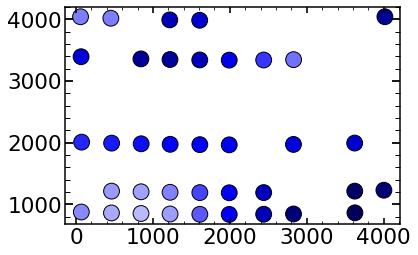

In [347]:
values=results_of_fit_many_direct_preDecemberrun_HgAr['m3']['z5']
plt.scatter(finalHgAr['xc'][results_of_fit_many_direct_preDecemberrun_HgAr['m3']['z5'].index].values, finalHgAr['yc'][results_of_fit_many_direct_preDecemberrun_HgAr['m3']['z5'].index].values,
            s=area, c=values, cmap='seismic', alpha=1,vmin=-1.0, vmax=1,edgecolor='black')

## create scripts

In [356]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  

In [357]:
list_of_HgAr_to_analyze=finalHgAr_May2019.index[(finalHgAr_May2019['fiber'].values.astype(int)<=650)&(finalHgAr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_May2019['close'].values.astype(int)==1)]
print(len(list_of_HgAr_to_analyze))


50


In [358]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T10S'+str(single_spot)+'Jun.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, p35, m05, p05,m3,p3,m15,p15
    for obs in [17023,17023+108,17023+48,17023+12,17023+102,17023+42,17023+54,17023+12,17023+96,17023+30,17023+66]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Jun_MPI03_Zemax.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr 3\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/JunScriptToSubmitScriptsTiger10'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T10S'+str(single_spot)+'Jun.sh \n')

file.close()

## which images are avaliable 

In [313]:
import glob
date='Jul09'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)

In [314]:
#analyzed_Neon_images=[]
#for i in range(len(Emcee3_Ne)):
#    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
#    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
#    
#analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [315]:
#arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
#arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [318]:
arranged_by_spot_number_HgAr

array([[17023,     1],
       [17065,     1],
       [17035,     1],
       [17077,     1],
       [17071,     1],
       [17053,     1],
       [17119,     1],
       [17089,     1],
       [17071,     3],
       [17089,     3],
       [17065,     3],
       [17023,     3],
       [17053,     3],
       [17119,     3],
       [17077,     3],
       [17065,     6],
       [17089,     6],
       [17053,     6],
       [17071,     6],
       [17077,     6],
       [17035,     6],
       [17023,     6],
       [17023,     9],
       [17053,     9],
       [17119,     9],
       [17035,     9],
       [17077,     9],
       [17065,     9],
       [17071,     9],
       [17089,     9],
       [17023,    11],
       [17071,    11],
       [17035,    11],
       [17065,    11],
       [17089,    13],
       [17065,    13],
       [17053,    13],
       [17035,    13],
       [17071,    13],
       [17023,    13],
       [17119,    13],
       [17077,    13],
       [17053,    15],
       [170

## Analysis of a single

In [1231]:
17023+48

17071

In [319]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


    
date='Jul09'
obs=17119
single_number='119'
image_index=int(single_number)
eps=5
arc='HgAr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    else:
        print("Not recognized arc-line")
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+54,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+102,19238+54])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

p4


fiber                         650
xc                           4016
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                 4085
old_index_approx              191
superold_index_approx         5.0
Name: 119, dtype: object

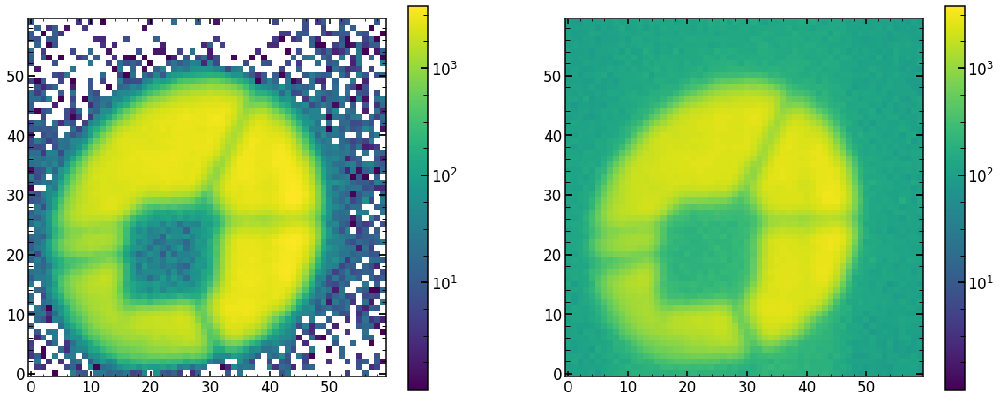

In [320]:
plt.figure(figsize=(20,8))
plt.subplot(121)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(122)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar()
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [321]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 18730.55356646931
minimal chi2 reduced is: 10.401239182972475


In [322]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6        z7        z8        z9       z10  \
0 -31.422971 -1.955532  1.002057 -0.480974 -0.720295 -0.576338  0.018366   

        z11  
0 -0.150383  
        z12       z13       z14       z15       z16       z17       z18  \
0 -0.057643 -0.186719  0.096683  0.081644 -0.392608 -0.055606 -0.059744   

        z19       z20       z21  
0 -0.021137 -0.032637  0.130972  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0 -0.174892  0.717623   0.089024  0.173939  0.231247  0.061945     0.050501   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000074             0.000074  0.971139    ...      0.019634   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.160902  1.018751            0.329553   63546.896721   

   scattering_slope  scattering_amplitude  pixel_effect  fiber_r      flux  
0          2.632511              0.007847      0.671692  1.97894

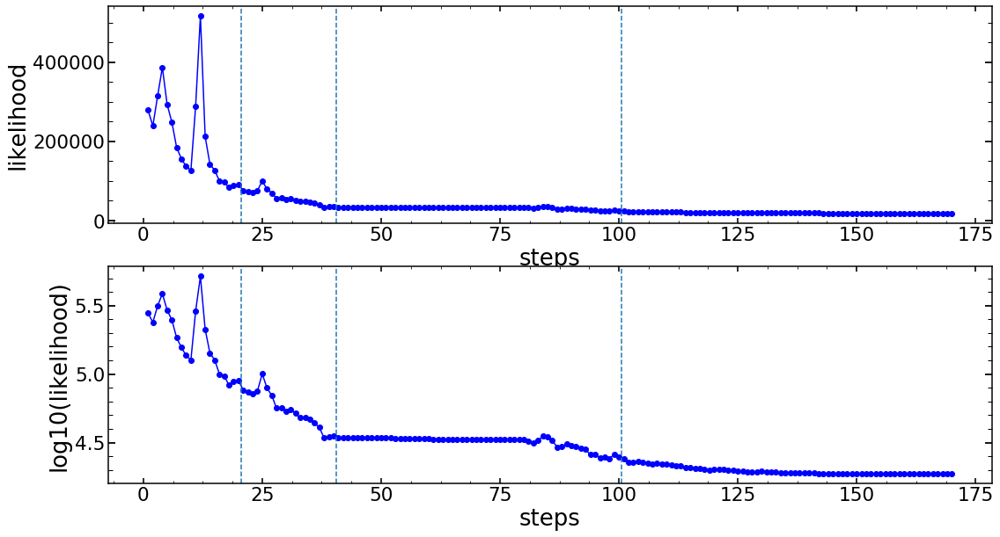

In [323]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [324]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-18741.988759031286

In [325]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

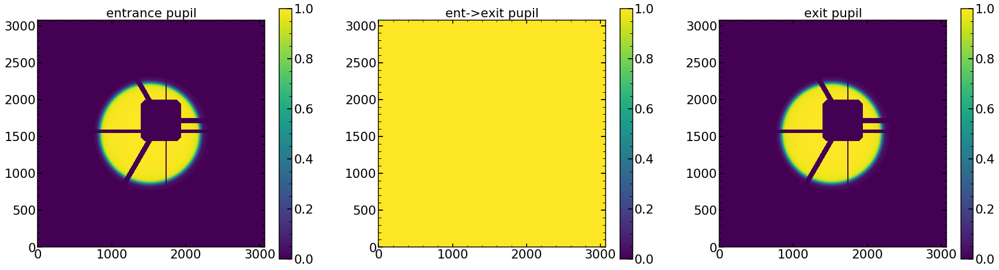

In [326]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

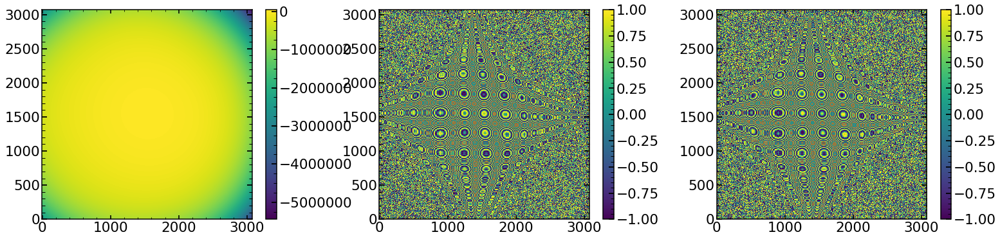

In [327]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

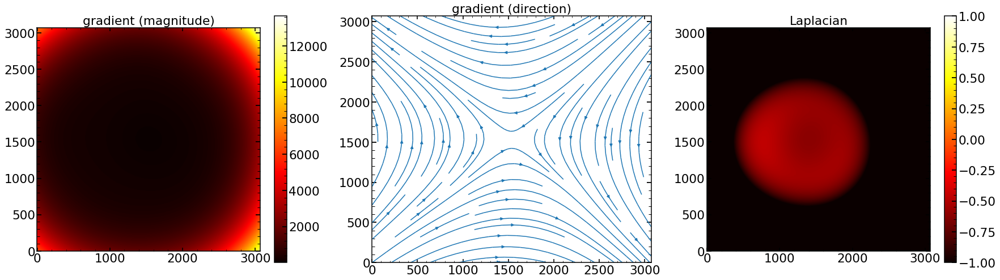

In [328]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

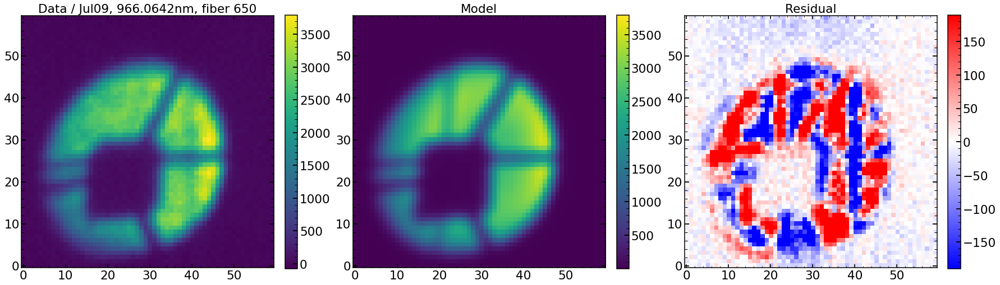

In [329]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 10.407592073685969
Abs of residual divided by total flux is: 0.09476478214149865
Abs of residual divided by largest value of a flux in the image is: 0.1689500157906392


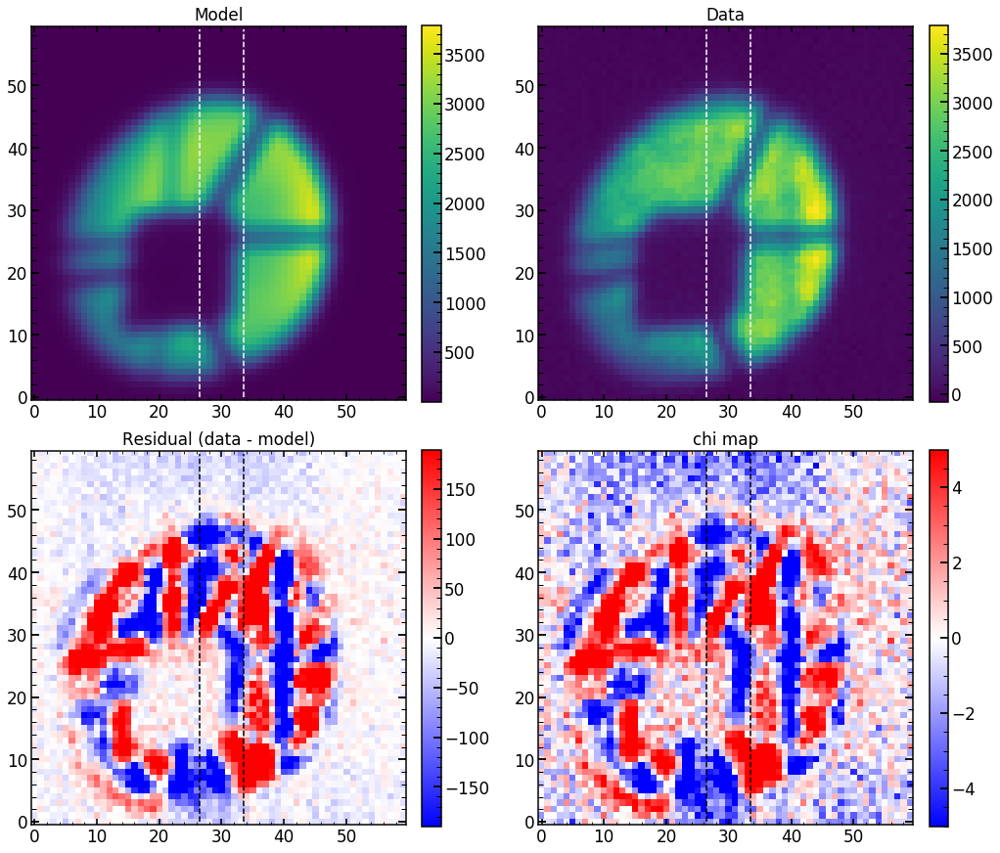

In [330]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

10.407592073685969
chi**2 reduced is: 10.407592073685969
Abs of residual divided by total flux is: 0.09476478214149865
Abs of residual divided by largest value of a flux in the image is: 0.1689500157906392


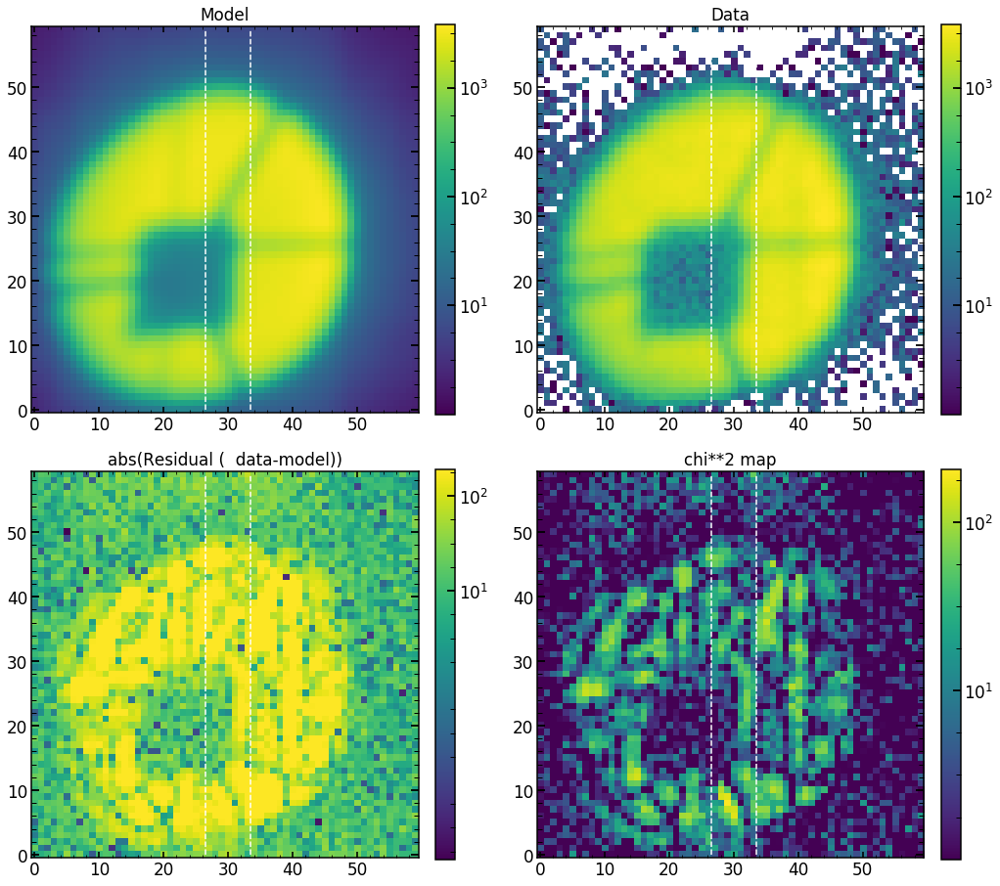

In [331]:
single_analysis.create_basic_comparison_plot_log()

10.407592073685969
chi**2 reduced is: 10.407592073685969
Abs of residual divided by total flux is: 0.09476478214149865
Abs of residual divided by largest value of a flux in the image is: 0.1689500157906392


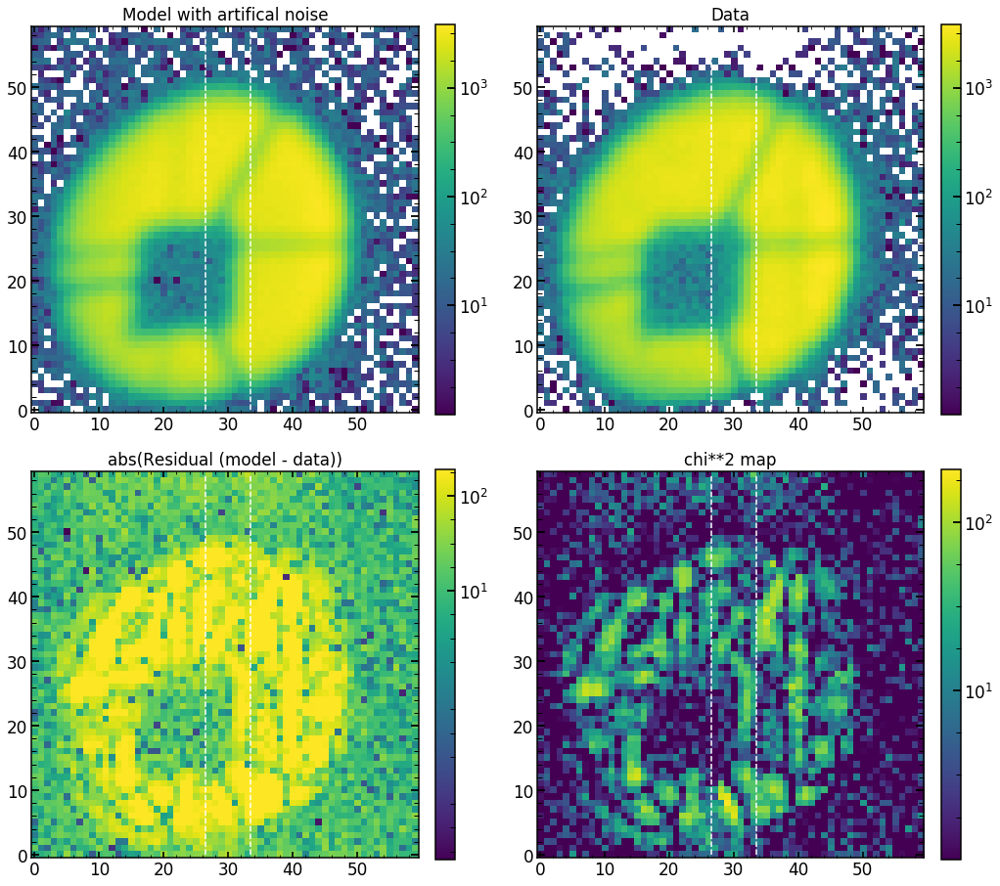

In [332]:
single_analysis.create_basic_comparison_plot_log_artifical()

## Creating  results everywhere

In [69]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019
date='Jul09'


results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(1,len(finalHgAr)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'HgAr',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]


22
1 obs (Emcee3): 17023 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
1 17029 HgAr is NOT found or failed!
1 obs (Emcee3): 17035 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
1 17041 HgAr is NOT found or failed!
1 17047 HgAr is NOT found or failed!
1 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 17059 HgAr is NOT found or failed!
1 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
1 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17077 is found!
radiometricExpo

radiometricExponent: failed!
y_ilum: failed!
grating_lines: failed!
9 17029 HgAr is NOT found or failed!
9 obs (Emcee3): 17035 is found!
slitFrac_dy: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitFrac_dy: failed!
frd_lorentz_factor: failed!
det_vert: failed!
9 17041 HgAr is NOT found or failed!
9 17047 HgAr is NOT found or failed!
9 obs (Emcee3): 17053 is found!
z8: failed!
dyFocal: failed!
y_ilum: failed!
z8: failed!
dyFocal: failed!
y_ilum: failed!
9 17059 HgAr is NOT found or failed!
9 obs (Emcee3): 17065 is found!
x_ilum: failed!
x_ilum: failed!
9 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17077 is found!
y_ilum: failed!
y_ilum: failed!
9 17083 HgAr is NOT found or failed!
9 obs (Emcee3): 17089 i

15 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17095 HgAr is NOT found or failed!
15 17101 HgAr is NOT found or failed!
15 17107 HgAr is NOT found or failed!
15 17113 HgAr is NOT found or failed!
15 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
15 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17071 HgAr is NOT found or failed!
22
16 17023 HgAr is NOT found or failed!
16 17029 HgAr is NOT found or failed!
16 17035 HgAr is NOT found or failed!
16 17041 HgAr is NOT found or failed!
16 17047 HgAr is NOT found or failed!
16 17053 HgAr is NOT found or failed!
16 17059 HgAr is NOT found or failed!
16 17065 HgAr is NOT found or failed!
16 17071 HgAr is NOT found or failed!
16 17071 HgAr is NOT found or fa

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17083 HgAr is NOT found or failed!
23 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
23 17095 HgAr is NOT found or failed!
23 17101 HgAr is NOT found or failed!
23 17107 HgAr is NOT found or failed!
23 17113 HgAr is NOT found or failed!
23 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 170

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
30 17083 HgAr is NOT found or failed!
30 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 17095 HgAr is NOT found or failed!
30 17101 HgAr is NOT found or failed!
30 17107 HgAr is NOT found or failed!
30 17113 HgAr is NOT found or failed!
30 obs (Emcee3): 17119 is found!
x_ilum: failed!
x_ilum: failed!
30 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 17071 HgAr is NOT found or failed!
22
31 17023 HgAr is NOT found or failed!
31 17029 HgAr is NOT found or failed!
31 17035 HgAr is NOT found or failed!
31 17041 HgAr is NOT found or failed!
31 17047 HgAr is NOT found or failed!
31 17053 HgAr is NOT found or failed!
31 17059 HgAr is NOT found or failed!
31 17065 HgAr is NOT found or failed!
31 17071 HgAr is NOT found or failed!
31 17071 HgAr is NOT found or failed!
31 17077 HgAr is NOT found or failed!
31 17083 HgAr is NOT found or f

39 17029 HgAr is NOT found or failed!
39 obs (Emcee3): 17035 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
39 17041 HgAr is NOT found or failed!
39 17047 HgAr is NOT found or failed!
39 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 17059 HgAr is NOT found or failed!
39 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometric

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 17041 HgAr is NOT found or failed!
47 17047 HgAr is NOT found or failed!
47 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 17059 HgAr is NOT found or failed!
47 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
47 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
47 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
47 17083 HgAr is NOT found or failed!
47 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
47 17095 Hg

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
54 17083 HgAr is NOT found or failed!
54 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 17095 HgAr is NOT found or failed!
54 17101 HgAr is NOT found or failed!
54 17107 HgAr is NOT found or failed!
54 17113 HgAr is NOT found or failed!
54 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
54 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
54 17071 HgAr is NOT found or failed!
22
55 17023 HgAr is NOT found or failed!
55 17029 HgAr is NOT found or 

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
61 17083 HgAr is NOT found or failed!
61 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
61 17095 HgAr is NOT found or failed!
61 17101 HgAr is NOT found or failed!
61 17107 HgAr is NOT found or failed!
61 17113 HgAr is NOT found or failed!
61 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
61 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
61 17071 HgAr is NOT found or failed!
22
62 17023 HgAr is NOT found or failed!
62 17029 HgAr is NOT found or failed!
62 17035 HgAr is NOT found or failed!
62 17041 HgAr is NOT found or failed!
62 17047 HgAr is NOT found or failed!
62 17053 HgAr is NOT found or failed!
62 17059 HgAr is NOT found or failed!
62 17065 HgAr is NOT found or failed!
62 17071 HgAr is NOT found or failed!
62 17071 HgAr is NOT found or failed!
62 17077 Hg

dxFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
grating_lines: failed!
scattering_amplitude: failed!
69 17059 HgAr is NOT found or failed!
69 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
69 obs (Emcee3): 17071 is found!
x_ilum: failed!
x_ilum: failed!
69 obs (Emcee3): 17071 is found!
x_ilum: failed!
x_ilum: failed!
69 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
69 17083 HgAr is NOT found or failed!
69 17089 HgAr is NOT found or failed!
69 17095 HgAr is NOT found or failed!
69 17101 HgAr is NOT found or failed!
69 17107 HgAr is NOT found or failed!
69 17113 HgAr is NOT found or failed!
69 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
det_vert: failed!
radiometricExponent: failed!
det_vert: failed!
69 obs (Emcee3): 17071 is found!
x_ilum: failed!
x_ilum: failed!
69 17071 HgAr is NOT found or failed!
22
70 17023 H

x_ilum: failed!
y_ilum: failed!
78 17029 HgAr is NOT found or failed!
78 17035 HgAr is NOT found or failed!
78 17041 HgAr is NOT found or failed!
78 17047 HgAr is NOT found or failed!
78 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
78 17059 HgAr is NOT found or failed!
78 obs (Emcee3): 17065 is found!
y_ilum: failed!
y_ilum: failed!
78 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
78 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
78 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
78 17083 HgAr is NOT found or failed!
78 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: f

85 17059 HgAr is NOT found or failed!
85 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
85 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
85 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
85 obs (Emcee3): 17077 is found!
85 17083 HgAr is NOT found or failed!
85 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
85 17095 HgAr is NOT found or failed!
85 17101 HgAr is NOT found or failed!
85 17107 HgAr is NOT found or failed!
85 17113 HgAr is NOT found or failed!
85 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: fail

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
93 17083 HgAr is NOT found or failed!
93 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
93 17095 HgAr is NOT found or failed!
93 17101 HgAr is NOT found or failed!
93 17107 HgAr is NOT found or failed!
93 17113 HgAr is NOT found or failed!
93 obs (Emcee3): 17119 is found!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
93 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
93 17071 HgAr is NOT found or failed!
22
94 17023 HgAr is NOT found or failed!
94 17029 HgAr is NOT found or failed!
94 17035 HgAr is NOT found or failed!
94 17041 HgAr is NOT found or failed!
94 17047 HgAr is NOT found or failed!
94 17053 HgAr is NOT found or failed!
94 17059 HgAr is NOT found or f

y_ilum: failed!
102 17041 HgAr is NOT found or failed!
102 17047 HgAr is NOT found or failed!
102 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
102 17059 HgAr is NOT found or failed!
102 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
102 17083 HgAr is NOT found or failed!
102 obs (Emcee3): 17089 is found!
z11: failed!
z13: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
flux: failed!
z11: failed!
z13: failed!
radiometr

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 17083 HgAr is NOT found or failed!
111 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 17095 HgAr is NOT found or failed!
111 17101 HgAr is NOT found or failed!
111 17107 HgAr is NOT found or failed!
111 17113 HgAr is NOT found or failed!
111 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
111 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: fail

In [70]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'Ne',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]

22
0 16244 Ne is NOT found or failed!
0 16250 Ne is NOT found or failed!
0 16256 Ne is NOT found or failed!
0 16262 Ne is NOT found or failed!
0 16268 Ne is NOT found or failed!
0 16274 Ne is NOT found or failed!
0 16280 Ne is NOT found or failed!
0 16286 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16298 Ne is NOT found or failed!
0 16304 Ne is NOT found or failed!
0 16310 Ne is NOT found or failed!
0 16316 Ne is NOT found or failed!
0 16322 Ne is NOT found or failed!
0 16328 Ne is NOT found or failed!
0 16334 Ne is NOT found or failed!
0 16340 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
22
1 16244 Ne is NOT found or failed!
1 16250 Ne is NOT found or failed!
1 16256 Ne is NOT found or failed!
1 16262 Ne is NOT found or failed!
1 16268 Ne is NOT found or failed!
1 16274 Ne is NOT found or failed!
1 16280 Ne is NOT found or failed!
1 16286 Ne is NOT found or failed!
1 16292 Ne is NOT found or failed!
1 16292 Ne is 

12 16298 Ne is NOT found or failed!
12 16304 Ne is NOT found or failed!
12 16310 Ne is NOT found or failed!
12 16316 Ne is NOT found or failed!
12 16322 Ne is NOT found or failed!
12 16328 Ne is NOT found or failed!
12 16334 Ne is NOT found or failed!
12 16340 Ne is NOT found or failed!
12 16292 Ne is NOT found or failed!
22
13 16244 Ne is NOT found or failed!
13 16250 Ne is NOT found or failed!
13 16256 Ne is NOT found or failed!
13 16262 Ne is NOT found or failed!
13 16268 Ne is NOT found or failed!
13 16274 Ne is NOT found or failed!
13 16280 Ne is NOT found or failed!
13 16286 Ne is NOT found or failed!
13 16292 Ne is NOT found or failed!
13 16292 Ne is NOT found or failed!
13 16298 Ne is NOT found or failed!
13 16304 Ne is NOT found or failed!
13 16310 Ne is NOT found or failed!
13 16316 Ne is NOT found or failed!
13 16322 Ne is NOT found or failed!
13 16328 Ne is NOT found or failed!
13 16334 Ne is NOT found or failed!
13 16340 Ne is NOT found or failed!
13 16292 Ne is NOT found 

22
27 16244 Ne is NOT found or failed!
27 16250 Ne is NOT found or failed!
27 16256 Ne is NOT found or failed!
27 16262 Ne is NOT found or failed!
27 16268 Ne is NOT found or failed!
27 16274 Ne is NOT found or failed!
27 16280 Ne is NOT found or failed!
27 16286 Ne is NOT found or failed!
27 16292 Ne is NOT found or failed!
27 16292 Ne is NOT found or failed!
27 16298 Ne is NOT found or failed!
27 16304 Ne is NOT found or failed!
27 16310 Ne is NOT found or failed!
27 16316 Ne is NOT found or failed!
27 16322 Ne is NOT found or failed!
27 16328 Ne is NOT found or failed!
27 16334 Ne is NOT found or failed!
27 16340 Ne is NOT found or failed!
27 16292 Ne is NOT found or failed!
22
28 16244 Ne is NOT found or failed!
28 16250 Ne is NOT found or failed!
28 16256 Ne is NOT found or failed!
28 16262 Ne is NOT found or failed!
28 16268 Ne is NOT found or failed!
28 16274 Ne is NOT found or failed!
28 16280 Ne is NOT found or failed!
28 16286 Ne is NOT found or failed!
28 16292 Ne is NOT fou

22
42 16244 Ne is NOT found or failed!
42 16250 Ne is NOT found or failed!
42 16256 Ne is NOT found or failed!
42 16262 Ne is NOT found or failed!
42 16268 Ne is NOT found or failed!
42 16274 Ne is NOT found or failed!
42 16280 Ne is NOT found or failed!
42 16286 Ne is NOT found or failed!
42 16292 Ne is NOT found or failed!
42 16292 Ne is NOT found or failed!
42 16298 Ne is NOT found or failed!
42 16304 Ne is NOT found or failed!
42 16310 Ne is NOT found or failed!
42 16316 Ne is NOT found or failed!
42 16322 Ne is NOT found or failed!
42 16328 Ne is NOT found or failed!
42 16334 Ne is NOT found or failed!
42 16340 Ne is NOT found or failed!
42 16292 Ne is NOT found or failed!
22
43 16244 Ne is NOT found or failed!
43 16250 Ne is NOT found or failed!
43 16256 Ne is NOT found or failed!
43 16262 Ne is NOT found or failed!
43 16268 Ne is NOT found or failed!
43 16274 Ne is NOT found or failed!
43 16280 Ne is NOT found or failed!
43 16286 Ne is NOT found or failed!
43 16292 Ne is NOT fou

22
58 16244 Ne is NOT found or failed!
58 16250 Ne is NOT found or failed!
58 16256 Ne is NOT found or failed!
58 16262 Ne is NOT found or failed!
58 16268 Ne is NOT found or failed!
58 16274 Ne is NOT found or failed!
58 16280 Ne is NOT found or failed!
58 16286 Ne is NOT found or failed!
58 16292 Ne is NOT found or failed!
58 16292 Ne is NOT found or failed!
58 16298 Ne is NOT found or failed!
58 16304 Ne is NOT found or failed!
58 16310 Ne is NOT found or failed!
58 16316 Ne is NOT found or failed!
58 16322 Ne is NOT found or failed!
58 16328 Ne is NOT found or failed!
58 16334 Ne is NOT found or failed!
58 16340 Ne is NOT found or failed!
58 16292 Ne is NOT found or failed!
22
59 16244 Ne is NOT found or failed!
59 16250 Ne is NOT found or failed!
59 16256 Ne is NOT found or failed!
59 16262 Ne is NOT found or failed!
59 16268 Ne is NOT found or failed!
59 16274 Ne is NOT found or failed!
59 16280 Ne is NOT found or failed!
59 16286 Ne is NOT found or failed!
59 16292 Ne is NOT fou

73 16244 Ne is NOT found or failed!
73 16250 Ne is NOT found or failed!
73 16256 Ne is NOT found or failed!
73 16262 Ne is NOT found or failed!
73 16268 Ne is NOT found or failed!
73 16274 Ne is NOT found or failed!
73 16280 Ne is NOT found or failed!
73 16286 Ne is NOT found or failed!
73 16292 Ne is NOT found or failed!
73 16292 Ne is NOT found or failed!
73 16298 Ne is NOT found or failed!
73 16304 Ne is NOT found or failed!
73 16310 Ne is NOT found or failed!
73 16316 Ne is NOT found or failed!
73 16322 Ne is NOT found or failed!
73 16328 Ne is NOT found or failed!
73 16334 Ne is NOT found or failed!
73 16340 Ne is NOT found or failed!
73 16292 Ne is NOT found or failed!
22
74 16244 Ne is NOT found or failed!
74 16250 Ne is NOT found or failed!
74 16256 Ne is NOT found or failed!
74 16262 Ne is NOT found or failed!
74 16268 Ne is NOT found or failed!
74 16274 Ne is NOT found or failed!
74 16280 Ne is NOT found or failed!
74 16286 Ne is NOT found or failed!
74 16292 Ne is NOT found 

87 16244 Ne is NOT found or failed!
87 16250 Ne is NOT found or failed!
87 16256 Ne is NOT found or failed!
87 16262 Ne is NOT found or failed!
87 16268 Ne is NOT found or failed!
87 16274 Ne is NOT found or failed!
87 16280 Ne is NOT found or failed!
87 16286 Ne is NOT found or failed!
87 16292 Ne is NOT found or failed!
87 16292 Ne is NOT found or failed!
87 16298 Ne is NOT found or failed!
87 16304 Ne is NOT found or failed!
87 16310 Ne is NOT found or failed!
87 16316 Ne is NOT found or failed!
87 16322 Ne is NOT found or failed!
87 16328 Ne is NOT found or failed!
87 16334 Ne is NOT found or failed!
87 16340 Ne is NOT found or failed!
87 16292 Ne is NOT found or failed!
22
88 16244 Ne is NOT found or failed!
88 16250 Ne is NOT found or failed!
88 16256 Ne is NOT found or failed!
88 16262 Ne is NOT found or failed!
88 16268 Ne is NOT found or failed!
88 16274 Ne is NOT found or failed!
88 16280 Ne is NOT found or failed!
88 16286 Ne is NOT found or failed!
88 16292 Ne is NOT found 

In [71]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [72]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jul09.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jul09.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)

In [73]:
results_of_fit_many_HgAr['p4']

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,-28.496521,1.721254,0.058750,0.375403,0.629585,0.189585,-0.249174,-0.224950,-0.037140,-0.023387,...,0.995572,0.716091,38036.172515,2.459691,0.001124,0.431108,1.973519,1.002016,38.126108,6969.564453
3,-30.761485,0.729036,0.019431,0.310086,0.170246,0.167888,-0.437748,0.257283,-0.149348,-0.093164,...,0.983203,-0.290384,100307.302434,2.508061,0.003057,0.633398,1.875721,0.989519,18.889505,1754.260986
9,-29.845316,0.616374,0.489672,-0.314251,0.334543,-0.351638,-0.414835,0.098132,-0.020712,0.155485,...,1.035753,-0.572772,43734.358854,2.476881,0.003003,0.516408,1.868386,0.991115,308.861059,31865.640625
13,-30.117047,1.025188,-0.206705,0.651138,-0.024824,0.160872,-0.240450,0.417929,-0.009939,-0.063071,...,1.005148,0.585321,105924.340359,2.998832,0.014415,0.372001,1.842487,0.998506,56.581205,7534.612793
15,-30.174211,1.129837,0.197468,0.372234,0.368334,0.141888,-0.548799,0.344330,-0.057450,-0.069504,...,0.990611,-0.448031,73392.326805,2.228861,0.001180,0.572886,1.781947,0.992191,20.172895,1884.609741
18,-30.345000,0.575246,0.107387,0.065413,0.263698,-0.013594,-0.243769,-0.174690,-0.037629,0.065768,...,1.029063,0.586915,63407.950054,2.907214,0.007591,0.628162,1.811583,0.990388,42.517622,6443.192383
23,-31.082228,0.443426,0.275868,-0.355188,-0.040386,-0.198543,-0.452425,-0.123334,0.046539,0.029904,...,1.050794,0.401472,42119.360993,2.708430,0.007585,0.726036,1.794613,0.991585,17.700584,2108.970215
25,-30.637405,0.715409,-0.025897,0.517829,-0.330008,-0.027499,-0.459179,0.409598,-0.059441,-0.063175,...,0.961247,-0.042516,114663.908971,2.847332,0.005708,0.659405,1.853377,0.992874,89.057571,7812.705566
27,-31.321407,0.944602,-0.034552,0.498611,0.077422,0.034821,-0.421050,0.058476,-0.031654,-0.108423,...,1.017224,-0.378392,65521.120842,2.747458,0.004110,0.439779,1.873888,0.988059,17.370305,1966.894043
30,-29.974509,0.486441,0.314725,0.389568,0.139949,-0.049850,-0.253965,-0.651052,-0.061025,-0.017247,...,1.018654,0.391569,82232.251111,2.979033,0.008028,0.467408,1.928837,1.003848,40.640473,6666.264648


In [74]:
# plot the results of the first fit

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Jul09'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocus that we have analyzed
for j in tqdm(np.concatenate((np.array(labels_with_data),np.array([18])))):
    print("Plotting "+str(label[j])+' now')
    # i runs through all the parameters
    for i in range(0,len(descriptions)):
        # take values for HgAr
        
        x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])

        # this was when I had only HgAr
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne))
        y=np.concatenate((y_HgAr,y_Ne))    
        colors= np.concatenate((values_HgAr,values_Ne))
        

        
        
        # size of point
        # this was when I had only HgAr
        #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
        area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii
        

        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z22
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1        
        
        
        
        plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

  0%|          | 0/10 [00:00<?, ?it/s]

Plotting m4 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/m4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/z14/
Images are in folder: /Users/nevencaplar/Do

 10%|█         | 1/10 [00:28<04:19, 28.84s/it]

Plotting m3 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/m3/


 20%|██        | 2/10 [00:58<03:52, 29.04s/it]

Plotting m15 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/m15/


 30%|███       | 3/10 [01:29<03:29, 29.89s/it]

Plotting m05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/m05/


 40%|████      | 4/10 [02:09<03:13, 32.29s/it]

Plotting 0 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/0/


 50%|█████     | 5/10 [02:35<02:35, 31.20s/it]

Plotting 0d now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/0d/


 60%|██████    | 6/10 [03:05<02:03, 30.89s/it]

Plotting p05 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/p05/


 70%|███████   | 7/10 [03:36<01:32, 30.91s/it]

Plotting p15 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/p15/


 80%|████████  | 8/10 [04:04<01:01, 30.54s/it]

Plotting p4 now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/p4/


 90%|█████████ | 9/10 [04:31<00:30, 30.16s/it]

Plotting 0p now
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Jul09/Plane/0p/


100%|██████████| 10/10 [04:58<00:00, 29.88s/it]


<Figure size 864x720 with 0 Axes>

# Comparison between Jul09 (zemax correct), Jul04 (zemax wrong0) and June13 (continuous fit from before)

In [870]:
date='Jul09'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jul09=pickle.load(f)
    
date='Jul04'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul040119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jul04=pickle.load(f)
    
date='Jun13'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jun13=pickle.load(f)
    
date='Jul09'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'_Zemax.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jul09_Zemax=pickle.load(f)    

In [871]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  

    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
descriptions=results_of_fit_many_HgAr_Jul09[label[0]].columns
j=-2
i=3
print(label[j])
print(descriptions[i])
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

x_HgAr_Jul09=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr_Jul09=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr_Jul09=np.array(results_of_fit_many_HgAr_Jul09[label[j]][descriptions[i]])
area_Jul09=np.full((1,len(values_HgAr_Jul09)),np.pi * (15 * 1)**2)

x_HgAr_Jul04=finalHgAr.loc[results_of_fit_many_HgAr_Jul04[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr_Jul04=finalHgAr.loc[results_of_fit_many_HgAr_Jul04[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr_Jul04=np.array(results_of_fit_many_HgAr_Jul04[label[j]][descriptions[i]])
area_Jul04=np.full((1,len(values_HgAr_Jul04)),np.pi * (15 * 1)**2)

x_HgAr_Jun13=finalHgAr.loc[results_of_fit_many_HgAr_Jun13[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr_Jun13=finalHgAr.loc[results_of_fit_many_HgAr_Jun13[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr_Jun13=np.array(results_of_fit_many_HgAr_Jun13[label[j]][descriptions[i]])
area_Jun13=np.full((1,len(values_HgAr_Jun13)),np.pi * (15 * 1)**2)

x_HgAr_Jul09_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
y_HgAr_Jul09_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
values_HgAr_Jul09_Zemax=np.array(results_of_fit_many_HgAr_Jul09_Zemax[label[j]][descriptions[i]])
area_Jul09_Zemax=np.full((1,len(values_HgAr_Jul09_Zemax)),np.pi * (15 * 1)**2)

min_colors=-1
max_colors=1

p4
z7


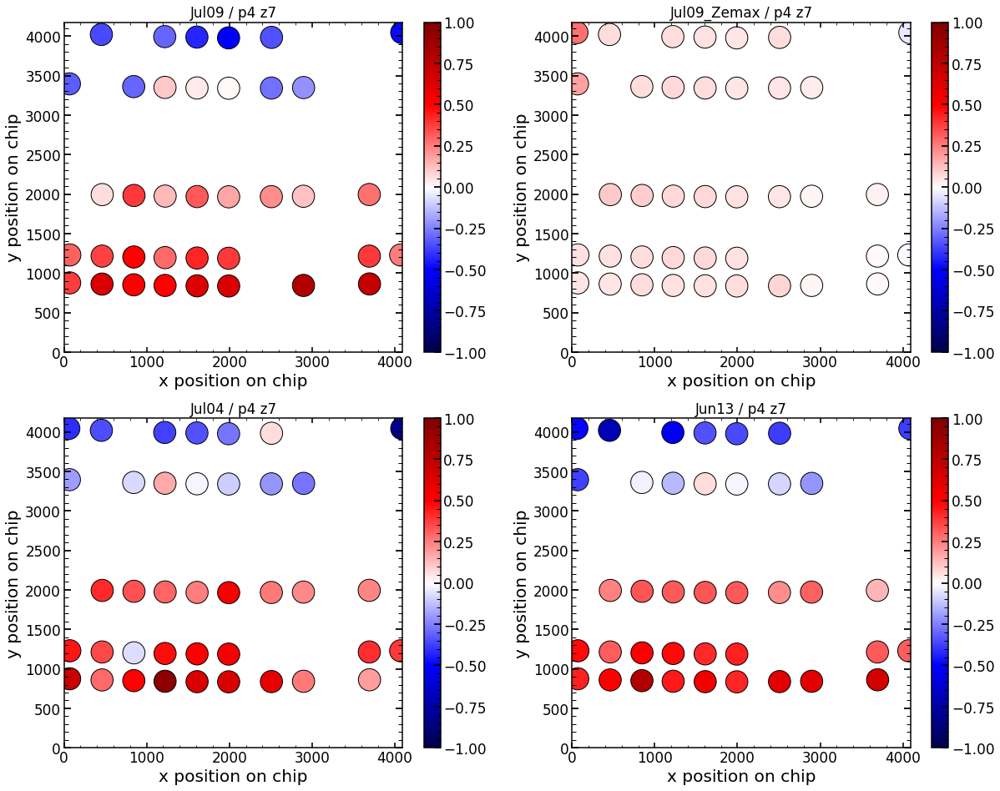

In [872]:
matplotlib.rcParams.update({'font.size': 14})
plt.figure(figsize=(20,16))

plt.subplot(221)
plt.scatter(x_HgAr_Jul09, y_HgAr_Jul09, s=area_Jul09, c=values_HgAr_Jul09, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str(date)+' / '+str(label[j])+" "+str(descriptions[i]))

plt.colorbar()

plt.subplot(223)
plt.scatter(x_HgAr_Jul04, y_HgAr_Jul04, s=area_Jul04, c=values_HgAr_Jul04, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str('Jul04')+' / '+str(label[j])+" "+str(descriptions[i]))

plt.colorbar()


plt.subplot(224)
plt.scatter(x_HgAr_Jun13, y_HgAr_Jun13, s=area_Jun13, c=values_HgAr_Jun13, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str('Jun13')+' / '+str(label[j])+" "+str(descriptions[i]))

plt.colorbar()

plt.subplot(222)
plt.scatter(x_HgAr_Jul09_Zemax, y_HgAr_Jul09_Zemax, s=area_Jul09_Zemax, c=values_HgAr_Jul09_Zemax, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
plt.ylim(0,4176)
plt.xlim(0,4096)
plt.xlabel('x position on chip')
plt.ylabel('y position on chip')
plt.title(str(date)+'_Zemax / '+str(label[j])+" "+str(descriptions[i]))

plt.colorbar()

In [873]:
date='Jul09'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jul09=pickle.load(f)
    
date='Jul09'
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jul090119/'
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_'+str(date)+'_Zemax.pkl', 'rb') as f:
    results_of_fit_many_HgAr_Jul09_Zemax=pickle.load(f)    
    
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
descriptions=results_of_fit_many_HgAr_Jul09[label[0]].columns
jp=-2
jm=0
print(label[j])
print(descriptions[i])    

for i in range(8+11):
    x_HgAr_Jul09_jp=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[jp]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr_Jul09_jp=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[jp]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr_Jul09_jp=np.array(results_of_fit_many_HgAr_Jul09[label[jp]][descriptions[i]])
    area_Jul09_jp=np.full((1,len(values_HgAr_Jul09_jp)),np.pi * (15 * 1)**2)

    x_HgAr_Jul09_jp_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[jp]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr_Jul09_jp_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[jp]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr_Jul09_jp_Zemax=np.array(results_of_fit_many_HgAr_Jul09_Zemax[label[jp]][descriptions[i]])
    area_Jul09_jp_Zemax=np.full((1,len(values_HgAr_Jul09_jp_Zemax)),np.pi * (15 * 1)**2)

    x_HgAr_Jul09_jm=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[jm]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr_Jul09_jm=finalHgAr.loc[results_of_fit_many_HgAr_Jul09[label[jm]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr_Jul09_jm=np.array(results_of_fit_many_HgAr_Jul09[label[jm]][descriptions[i]])
    area_Jul09_jm=np.full((1,len(values_HgAr_Jul09_jm)),np.pi * (15 * 1)**2)

    x_HgAr_Jul09_jm_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[jm]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr_Jul09_jm_Zemax=finalHgAr.loc[results_of_fit_many_HgAr_Jul09_Zemax[label[jm]][descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr_Jul09_jm_Zemax=np.array(results_of_fit_many_HgAr_Jul09_Zemax[label[jm]][descriptions[i]])
    area_Jul09_jm_Zemax=np.full((1,len(values_HgAr_Jul09_jm_Zemax)),np.pi * (15 * 1)**2)   
    
        
    if i >= 8:
        min_colors=-0.25
        max_colors=0.25
    else:
        min_colors=-1
        max_colors=1       
    
    matplotlib.rcParams.update({'font.size': 14})
    plt.figure(figsize=(20,16))

    plt.subplot(221)
    plt.scatter(x_HgAr_Jul09_jp, y_HgAr_Jul09_jp, s=area_Jul09_jp, c=values_HgAr_Jul09_jp, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+str(label[jp])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.subplot(222)
    plt.scatter(x_HgAr_Jul09_jp_Zemax, y_HgAr_Jul09_jp_Zemax, s=area_Jul09_jp_Zemax, c=values_HgAr_Jul09_jp_Zemax, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+'_Zemax / '+str(label[jp])+" "+str(descriptions[i]))
    plt.colorbar()
 
    plt.subplot(223)
    plt.scatter(x_HgAr_Jul09_jm, y_HgAr_Jul09_jm, s=area_Jul09_jm, c=values_HgAr_Jul09_jm, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+str(label[jm])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.subplot(224)
    plt.scatter(x_HgAr_Jul09_jm_Zemax, y_HgAr_Jul09_jm_Zemax, s=area_Jul09_jm_Zemax, c=values_HgAr_Jul09_jm_Zemax, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+'_Zemax / '+str(label[jm])+" "+str(descriptions[i]))
    plt.colorbar()

    plt.savefig('/Users/nevencaplar/Documents/PFS/Images/JIRA-PIPE2D-421/'+str(descriptions[i])+'_Zemax_data')
    plt.clf()

p4
z7


<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

<Figure size 1440x1152 with 0 Axes>

In [874]:
values_HgAr_Jul09_jp=np.array(results_of_fit_many_HgAr_Jul09[label[jp]][descriptions[i]])

In [875]:
print(results_of_fit_many_HgAr_Jul09_Zemax['m4'].iloc[0].name)
finalHgAr.iloc[1]

1


fiber                           2
xc                             69
yc                            875
wavelength               696.7261
close                           1
lamp                         HgAr
xc_effective                   69
old_index_approx                1
superold_index_approx        90.0
Name: 1, dtype: object

In [876]:
print(results_of_fit_many_HgAr_Jul09_Zemax['p4'].iloc[0].name)
finalHgAr.iloc[1]

1


fiber                           2
xc                             69
yc                            875
wavelength               696.7261
close                           1
lamp                         HgAr
xc_effective                   69
old_index_approx                1
superold_index_approx        90.0
Name: 1, dtype: object

In [877]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09_Zemax['m4'].iloc[17].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

45


fiber                         255
xc                           1222
yc                           3350
wavelength               912.5693
close                           1
lamp                         HgAr
xc_effective                 1222
old_index_approx               57
superold_index_approx        22.0
Name: 45, dtype: object

In [878]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09_Zemax['m4'].iloc[17].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

45


fiber                         255
xc                           1222
yc                           3350
wavelength               912.5693
close                           1
lamp                         HgAr
xc_effective                 1222
old_index_approx               57
superold_index_approx        22.0
Name: 45, dtype: object

In [879]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09_Zemax['p4'].iloc[15].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

45


fiber                         255
xc                           1222
yc                           3350
wavelength               912.5693
close                           1
lamp                         HgAr
xc_effective                 1222
old_index_approx               57
superold_index_approx        22.0
Name: 45, dtype: object

In [880]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09_Zemax['m4'].iloc[38].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

119


fiber                         650
xc                           4016
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                 4085
old_index_approx              191
superold_index_approx         5.0
Name: 119, dtype: object

In [881]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09['p4'].iloc[36].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

119


fiber                         650
xc                           4016
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                 4085
old_index_approx              191
superold_index_approx         5.0
Name: 119, dtype: object

In [882]:
index_in_finalHgAr=results_of_fit_many_HgAr_Jul09_Zemax['p4'].iloc[38].name
print(index_in_finalHgAr)
finalHgAr.iloc[index_in_finalHgAr]

119


fiber                         650
xc                           4016
yc                           4044
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                 4085
old_index_approx              191
superold_index_approx         5.0
Name: 119, dtype: object

Text(0.5,1,'Lower left corner (x=69, y=829)')

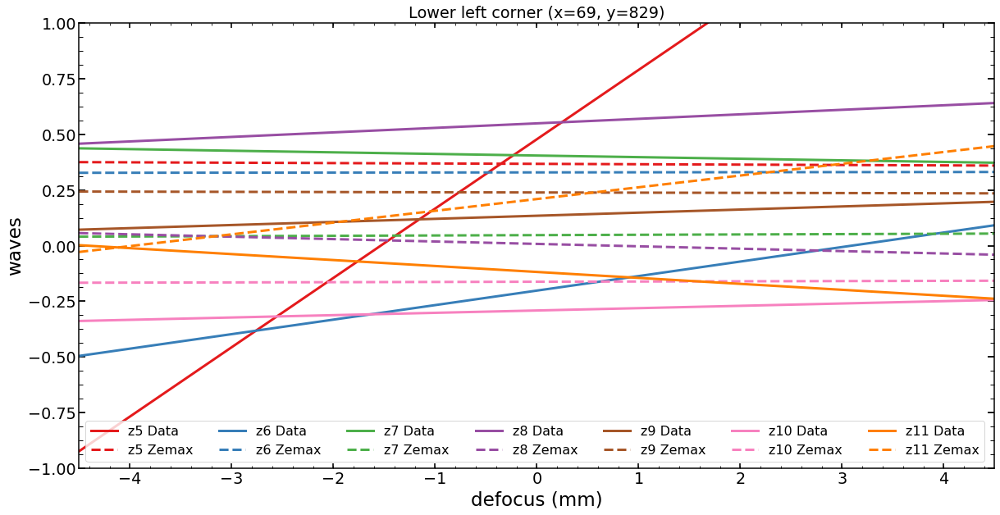

In [883]:
z_real_values=[]
for jp in [0,17]:
    if jp==0:
        select_which=0
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)
    if jp==17:
        select_which=0
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values) 
    
z_real_values=np.array(z_real_values)
    
z_zemax_values=[]
for jp in [0,17]:
    z_zemax_values.append((results_of_fit_many_HgAr_Jul09_Zemax[label[jp]].iloc[0][['z5','z6','z7','z8','z9','z10','z11']]).values)
    
z_zemax_values=np.array(z_zemax_values)

fit_res_real_z5_z11=[]
fit_res_zemax_z5_z11=[]
for zp in range(0,7):
    fit_real=np.polyfit([-4,4],z_real_values[:,zp],1)
    p_real = np.poly1d(fit_real)
    zemax_fit=np.polyfit([-4,4],z_zemax_values[:,zp],1)
    p_zemax = np.poly1d(zemax_fit)

    fit_res_real=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_real.append(p_real(i))
    fit_res_zemax=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_zemax.append(p_zemax(i))
        
    fit_res_real_z5_z11.append(fit_res_real)
    fit_res_zemax_z5_z11.append(fit_res_zemax)




matplotlib.rcParams.update({'font.size': 16})
plt.figure(figsize=(20,10))

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[0],label='z5 Data',color='#e41a1c',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[0],label='z5 Zemax',color='#e41a1c',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[1],label='z6 Data',color='#377eb8',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[1],label='z6 Zemax',color='#377eb8',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[2],label='z7 Data',color='#4daf4a',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[2],label='z7 Zemax',color='#4daf4a',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[3],label='z8 Data',color='#984ea3',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[3],label='z8 Zemax',color='#984ea3',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[4],label='z9 Data',color='#a65628',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[4],label='z9 Zemax',color='#a65628',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[5],label='z10 Data',color='#f781bf',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[5],label='z10 Zemax',color='#f781bf',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[6],label='z11 Data',color='#ff7f00',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[6],label='z11 Zemax',color='#ff7f00',lw=3,ls='--')

plt.legend(ncol=7)
plt.xlim(-4.5,4.5)
plt.ylim(-1,1)
plt.xlabel('defocus (mm)')
plt.ylabel('waves')
plt.title('Lower left corner (x=69, y=829)')

Text(0.5,1,'Upper left corner (x=1222, y=3350)')

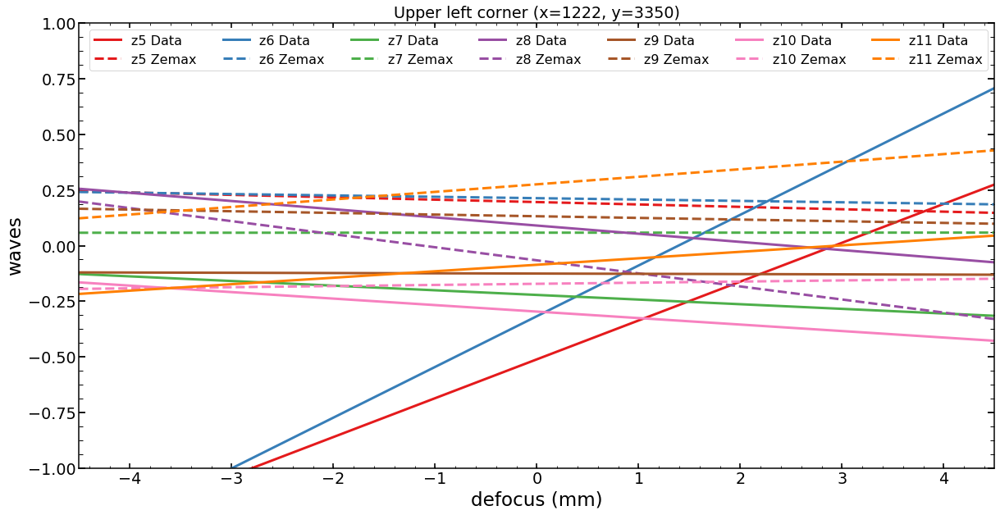

In [884]:
z_real_values=[]
for jp in [0,17]:
    if jp==0:
        select_which=17
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)
    if jp==17:
        select_which=15
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values) 
    
z_real_values=np.array(z_real_values)
    
z_zemax_values=[]
for jp in [0,17]:
    z_zemax_values.append((results_of_fit_many_HgAr_Jul09_Zemax[label[jp]].iloc[17][['z5','z6','z7','z8','z9','z10','z11']]).values)
    
z_zemax_values=np.array(z_zemax_values)

fit_res_real_z5_z11=[]
fit_res_zemax_z5_z11=[]
for zp in range(0,7):
    fit_real=np.polyfit([-4,4],z_real_values[:,zp],1)
    p_real = np.poly1d(fit_real)
    zemax_fit=np.polyfit([-4,4],z_zemax_values[:,zp],1)
    p_zemax = np.poly1d(zemax_fit)

    fit_res_real=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_real.append(p_real(i))
    fit_res_zemax=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_zemax.append(p_zemax(i))
        
    fit_res_real_z5_z11.append(fit_res_real)
    fit_res_zemax_z5_z11.append(fit_res_zemax)




matplotlib.rcParams.update({'font.size': 16})
plt.figure(figsize=(20,10))

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[0],label='z5 Data',color='#e41a1c',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[0],label='z5 Zemax',color='#e41a1c',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[1],label='z6 Data',color='#377eb8',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[1],label='z6 Zemax',color='#377eb8',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[2],label='z7 Data',color='#4daf4a',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[2],label='z7 Zemax',color='#4daf4a',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[3],label='z8 Data',color='#984ea3',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[3],label='z8 Zemax',color='#984ea3',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[4],label='z9 Data',color='#a65628',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[4],label='z9 Zemax',color='#a65628',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[5],label='z10 Data',color='#f781bf',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[5],label='z10 Zemax',color='#f781bf',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[6],label='z11 Data',color='#ff7f00',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[6],label='z11 Zemax',color='#ff7f00',lw=3,ls='--')

plt.legend(ncol=7)
plt.xlim(-4.5,4.5)
plt.ylim(-1,1)
plt.xlabel('defocus (mm)')
plt.ylabel('waves')
plt.title('Upper left corner (x=1222, y=3350)')

Text(0.5,1,'Lower right corner (x=3626, y=862)')

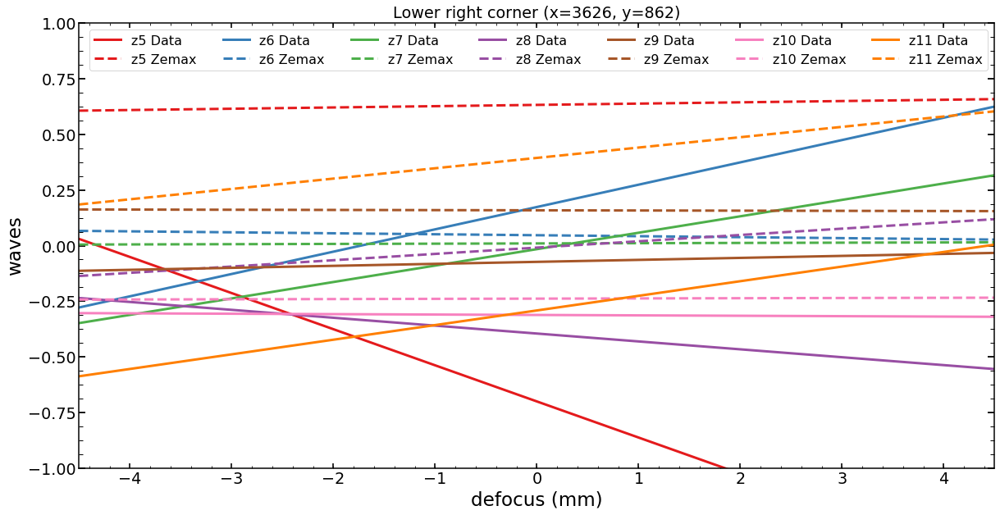

In [885]:
z_real_values=[]
for jp in [0,17]:
    if jp==0:
        select_which=35
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)
    if jp==17:
        select_which=34
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)    
    
z_real_values=np.array(z_real_values)
    
z_zemax_values=[]
for jp in [0,17]:
    z_zemax_values.append((results_of_fit_many_HgAr_Jul09_Zemax[label[jp]].iloc[35][['z5','z6','z7','z8','z9','z10','z11']]).values)
    
z_zemax_values=np.array(z_zemax_values)

fit_res_real_z5_z11=[]
fit_res_zemax_z5_z11=[]
for zp in range(0,7):
    fit_real=np.polyfit([-4,4],z_real_values[:,zp],1)
    p_real = np.poly1d(fit_real)
    zemax_fit=np.polyfit([-4,4],z_zemax_values[:,zp],1)
    p_zemax = np.poly1d(zemax_fit)

    fit_res_real=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_real.append(p_real(i))
    fit_res_zemax=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_zemax.append(p_zemax(i))
        
    fit_res_real_z5_z11.append(fit_res_real)
    fit_res_zemax_z5_z11.append(fit_res_zemax)




matplotlib.rcParams.update({'font.size': 16})
plt.figure(figsize=(20,10))

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[0],label='z5 Data',color='#e41a1c',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[0],label='z5 Zemax',color='#e41a1c',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[1],label='z6 Data',color='#377eb8',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[1],label='z6 Zemax',color='#377eb8',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[2],label='z7 Data',color='#4daf4a',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[2],label='z7 Zemax',color='#4daf4a',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[3],label='z8 Data',color='#984ea3',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[3],label='z8 Zemax',color='#984ea3',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[4],label='z9 Data',color='#a65628',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[4],label='z9 Zemax',color='#a65628',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[5],label='z10 Data',color='#f781bf',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[5],label='z10 Zemax',color='#f781bf',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[6],label='z11 Data',color='#ff7f00',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[6],label='z11 Zemax',color='#ff7f00',lw=3,ls='--')

plt.legend(ncol=7)
plt.xlim(-4.5,4.5)
plt.ylim(-1,1)
plt.xlabel('defocus (mm)')
plt.ylabel('waves')
plt.title('Lower right corner (x=3626, y=862)')

Text(0.5,1,'Upper right corner (x=4016, y=4044)')

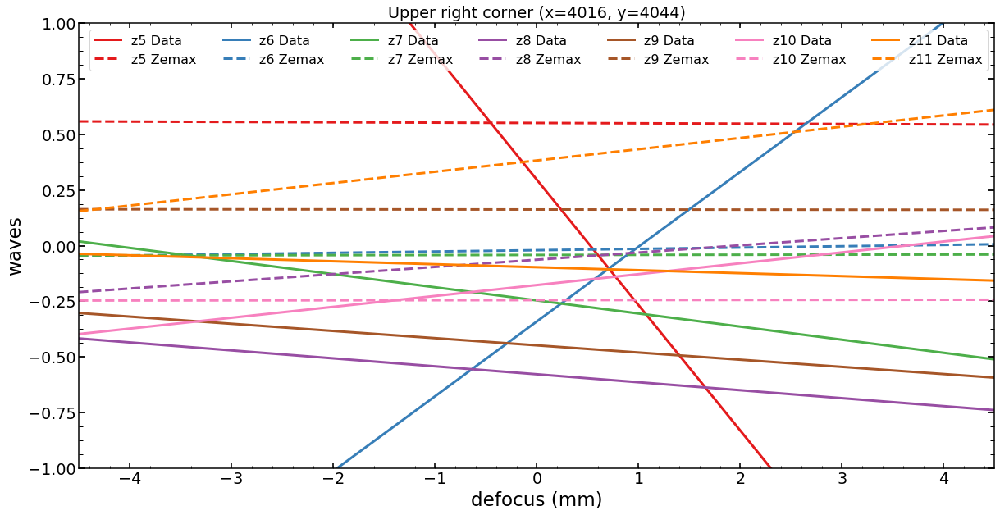

In [886]:
z_real_values=[]
for jp in [0,17]:
    if jp==0:
        select_which=38
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)
    if jp==17:
        select_which=36
        z_real_values.append((results_of_fit_many_HgAr_Jul09[label[jp]].iloc[select_which][['z5','z6','z7','z8','z9','z10','z11']]).values)    
        
z_real_values=np.array(z_real_values)
    
z_zemax_values=[]
for jp in [0,17]:
    z_zemax_values.append((results_of_fit_many_HgAr_Jul09_Zemax[label[jp]].iloc[38][['z5','z6','z7','z8','z9','z10','z11']]).values)
    
z_zemax_values=np.array(z_zemax_values)

fit_res_real_z5_z11=[]
fit_res_zemax_z5_z11=[]
for zp in range(0,7):
    fit_real=np.polyfit([-4,4],z_real_values[:,zp],1)
    p_real = np.poly1d(fit_real)
    zemax_fit=np.polyfit([-4,4],z_zemax_values[:,zp],1)
    p_zemax = np.poly1d(zemax_fit)

    fit_res_real=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_real.append(p_real(i))
    fit_res_zemax=[]
    for i in np.linspace(-4.5,4.5,19):
        fit_res_zemax.append(p_zemax(i))
        
    fit_res_real_z5_z11.append(fit_res_real)
    fit_res_zemax_z5_z11.append(fit_res_zemax)




matplotlib.rcParams.update({'font.size': 16})
plt.figure(figsize=(20,10))

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[0],label='z5 Data',color='#e41a1c',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[0],label='z5 Zemax',color='#e41a1c',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[1],label='z6 Data',color='#377eb8',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[1],label='z6 Zemax',color='#377eb8',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[2],label='z7 Data',color='#4daf4a',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[2],label='z7 Zemax',color='#4daf4a',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[3],label='z8 Data',color='#984ea3',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[3],label='z8 Zemax',color='#984ea3',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[4],label='z9 Data',color='#a65628',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[4],label='z9 Zemax',color='#a65628',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[5],label='z10 Data',color='#f781bf',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[5],label='z10 Zemax',color='#f781bf',lw=3,ls='--')

plt.plot(np.linspace(-4.5,4.5,19),fit_res_real_z5_z11[6],label='z11 Data',color='#ff7f00',lw=3)
plt.plot(np.linspace(-4.5,4.5,19),fit_res_zemax_z5_z11[6],label='z11 Zemax',color='#ff7f00',lw=3,ls='--')

plt.legend(ncol=7)
plt.xlim(-4.5,4.5)
plt.ylim(-1,1)
plt.xlabel('defocus (mm)')
plt.ylabel('waves')
plt.title('Upper right corner (x=4016, y=4044)')

# PIPE2D-422

In [ ]:
# illumination EXP 17915-17992 (2019-05-09)

In [1060]:
from astropy.io import fits
y_pos=920
x_pos=1228
list_of_exp_time=[]
list_of_defocus=[]
list_of_i=[]
list_of_att=[]
list_of_sci_cut=[]
for i in tqdm(range(17915,17993)):
    fits_data=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/Jun_2019_run1/rerun/rerun_1/detrend/calExp/2019-05-09/v00'+str(i)+'/calExp-LA0'+str(i)+'r1.fits')
    hdr = fits_data[0].header
    list_of_i.append(i)
    list_of_defocus.append(hdr['W_ENFCAX'])
    list_of_exp_time.append(hdr['EXPTIME'])
    list_of_att.append(hdr['W_AITATT'])
    sci_data=fits_data[1].data
    list_of_sci_cut.append(sci_data[y_pos-40:y_pos+40,x_pos-40:x_pos+40])

100%|██████████| 78/78 [01:11<00:00,  1.09it/s]


In [1061]:
array_of_sci_cut=np.array(list_of_sci_cut)

In [1062]:
summary_array=np.transpose(np.array([list_of_i,list_of_defocus,list_of_att,list_of_exp_time]))
summary_array[:,0]=summary_array[:,0]-17915
summary_array

array([[  0.     ,   3.99996,   0.     ,  15.003  ],
       [  1.     ,   4.     ,   0.     ,  15.004  ],
       [  2.     ,   4.     , 220.     ,  15.002  ],
       [  3.     ,   4.     , 220.     ,  14.998  ],
       [  4.     ,   4.     , 220.     ,  14.999  ],
       [  5.     ,   4.     , 220.     ,  15.004  ],
       [  6.     ,   4.     , 220.     ,  15.004  ],
       [  7.     ,   4.     , 220.     ,  14.998  ],
       [  8.     ,   4.     , 220.     ,  15.004  ],
       [  9.     ,   4.     , 220.     ,  14.999  ],
       [ 10.     ,   4.     , 220.     ,  15.004  ],
       [ 11.     ,   4.     , 220.     ,  15.     ],
       [ 12.     ,   4.     , 220.     ,  14.998  ],
       [ 13.     ,   4.     , 220.     ,  14.999  ],
       [ 14.     ,  -0.     ,   0.     ,  15.005  ],
       [ 15.     ,  -0.     ,   0.     ,  15.004  ],
       [ 16.     ,  -4.00001, 220.     ,  14.998  ],
       [ 17.     ,  -4.00001, 220.     ,  14.999  ],
       [ 18.     ,  -4.00001, 220.     ,  15.0

## one side

In [1136]:
sci_cut_15s_att_0=array_of_sci_cut[0]+array_of_sci_cut[1]

sci_cut_15s_att_220=array_of_sci_cut[2]+array_of_sci_cut[3]+array_of_sci_cut[4]+array_of_sci_cut[5]+array_of_sci_cut[6]+array_of_sci_cut[7]+\
array_of_sci_cut[8]+array_of_sci_cut[9]+array_of_sci_cut[10]+array_of_sci_cut[11]+array_of_sci_cut[12]+array_of_sci_cut[13]

In [1093]:

sci_cut_15s=array_of_sci_cut[3]

sci_cut_12s=array_of_sci_cut[31]

sci_cut_9s=array_of_sci_cut[32]+array_of_sci_cut[33]

sci_cut_6s=array_of_sci_cut[34]+array_of_sci_cut[35]+array_of_sci_cut[36]+array_of_sci_cut[37]

sci_cut_3s=array_of_sci_cut[38]+array_of_sci_cut[39]+array_of_sci_cut[40]+array_of_sci_cut[41]+array_of_sci_cut[42]+array_of_sci_cut[43]

sci_cut_1s=array_of_sci_cut[44]+array_of_sci_cut[45]+array_of_sci_cut[46]+array_of_sci_cut[47]+array_of_sci_cut[48]+array_of_sci_cut[49]+\
array_of_sci_cut[50]+array_of_sci_cut[51]+array_of_sci_cut[52]+array_of_sci_cut[53]

In [1104]:
#sci_cut_1s_renormalized=sci_cut_1s*np.max(sci_cut_15s)/np.max(sci_cut_1s)
#sci_cut_3s_renormalized=sci_cut_3s*np.max(sci_cut_15s)/np.max(sci_cut_3s)
#sci_cut_6s_renormalized=sci_cut_6s*np.max(sci_cut_15s)/np.max(sci_cut_6s)
#sci_cut_9s_renormalized=sci_cut_9s*np.max(sci_cut_15s)/np.max(sci_cut_9s)


sci_cut_1s_renormalized=sci_cut_1s*np.median(sci_cut_15s[sci_cut_15s>1000])/np.median(sci_cut_1s[sci_cut_15s>1000])
sci_cut_3s_renormalized=sci_cut_3s*np.median(sci_cut_15s[sci_cut_15s>1000])/np.median(sci_cut_3s[sci_cut_15s>1000])
sci_cut_6s_renormalized=sci_cut_6s*np.median(sci_cut_15s[sci_cut_15s>1000])/np.median(sci_cut_6s[sci_cut_15s>1000])
sci_cut_9s_renormalized=sci_cut_9s*np.median(sci_cut_15s[sci_cut_15s>1000])/np.median(sci_cut_9s[sci_cut_15s>1000])


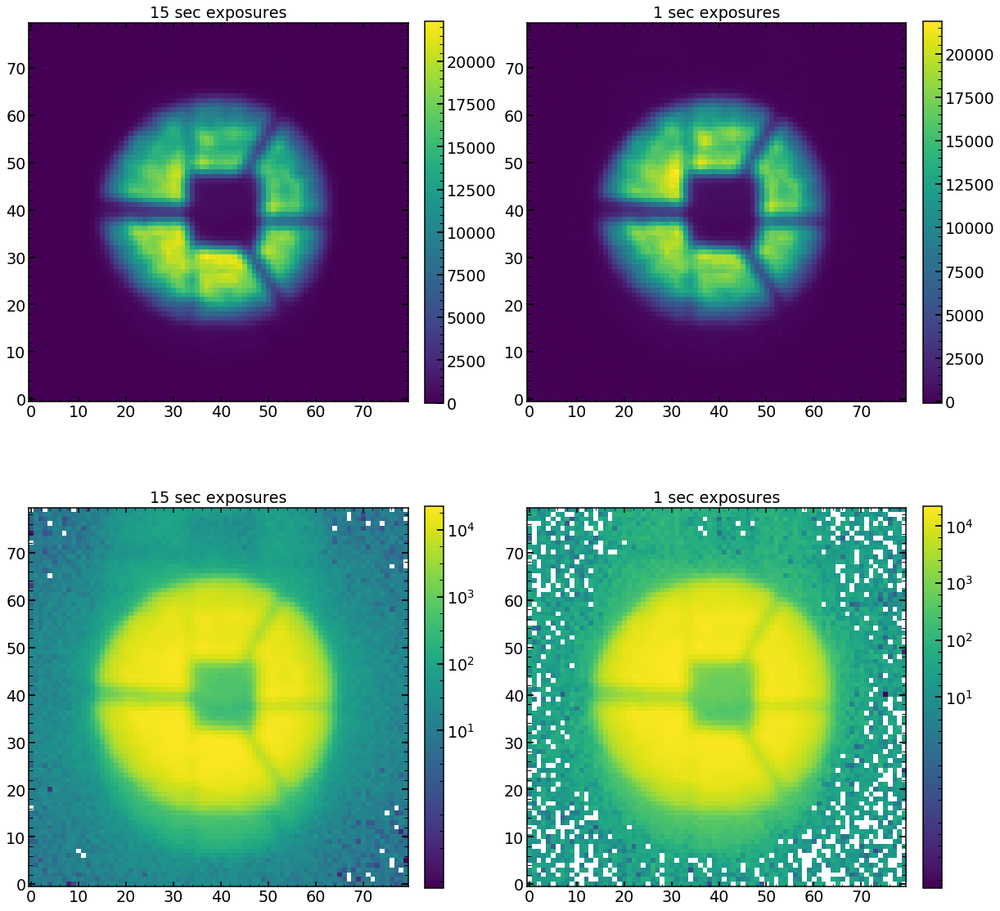

In [1170]:

plt.figure(figsize=(20,20))

plt.subplot(221)
plt.title('15 sec exposures')
plt.imshow(sci_cut_15s,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.title('1 sec exposures')
plt.imshow(sci_cut_1s_renormalized,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(223)
plt.title('15 sec exposures')
plt.imshow(sci_cut_15s,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(224)
plt.title('1 sec exposures')
plt.imshow(sci_cut_1s_renormalized,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

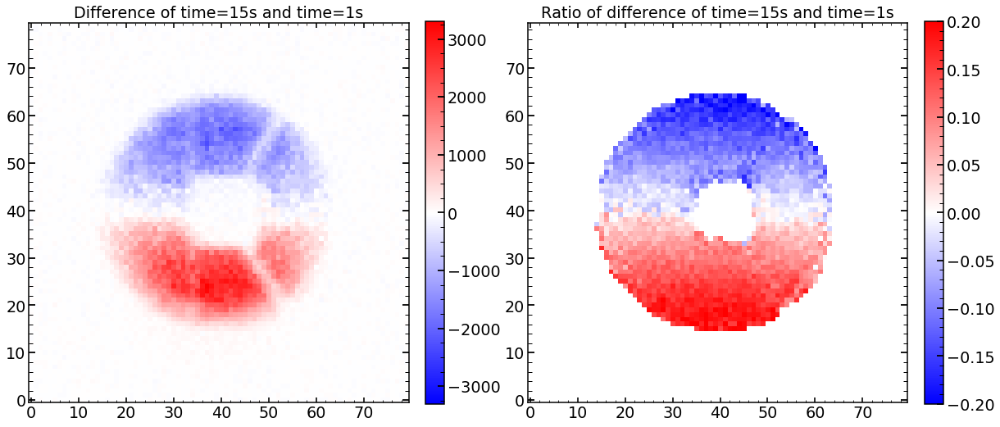

In [1171]:
masked_dif_1=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_1s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.title('Difference of time=15s and time=1s')
plt.imshow(sci_cut_15s-sci_cut_1s_renormalized,origin='lower',cmap='bwr',vmax=np.max(sci_cut_15s-sci_cut_1s_renormalized),vmin=-np.max(sci_cut_15s-sci_cut_1s_renormalized))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.title('Ratio of difference of time=15s and time=1s')
plt.imshow(masked_dif_1,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


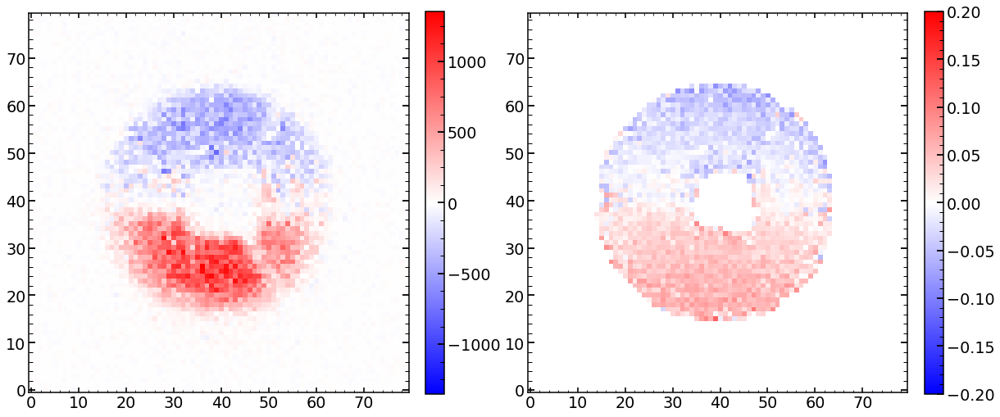

In [1107]:
masked_dif_3=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_3s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_3s_renormalized,origin='lower',cmap='bwr',vmax=np.max(sci_cut_15s-sci_cut_3s_renormalized),vmin=-np.max(sci_cut_15s-sci_cut_3s_renormalized))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_3,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

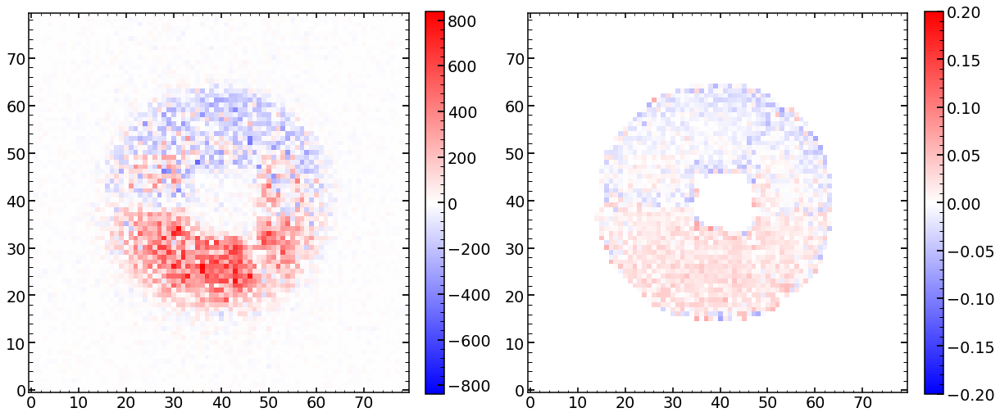

In [1108]:
masked_dif_6=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_6s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_6s_renormalized,origin='lower',cmap='bwr',vmax=np.max(sci_cut_15s-sci_cut_6s_renormalized),vmin=-np.max(sci_cut_15s-sci_cut_6s_renormalized))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_6,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

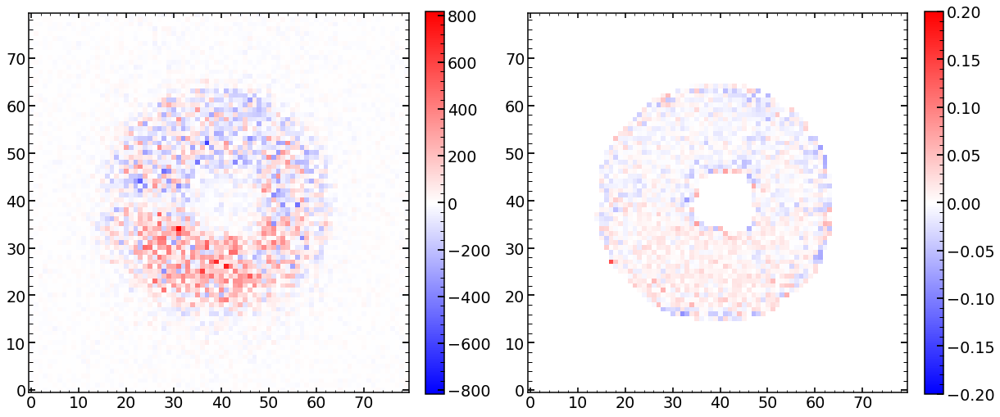

In [1109]:
masked_dif_9=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_9s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_9s_renormalized,origin='lower',cmap='bwr',vmax=np.max(sci_cut_15s-sci_cut_9s_renormalized),vmin=-np.max(sci_cut_15s-sci_cut_9s_renormalized))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_9,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

In [1130]:
med_values_1=[]
med_values_3=[]
med_values_6=[]
med_values_9=[]
for i in range(0,80):
    med_values_1.append(np.median(masked_dif_1[i][~masked_dif_1[i].mask].ravel()))
    med_values_3.append(np.median(masked_dif_3[i][~masked_dif_3[i].mask].ravel()))
    med_values_6.append(np.median(masked_dif_6[i][~masked_dif_6[i].mask].ravel()))
    med_values_9.append(np.median(masked_dif_9[i][~masked_dif_9[i].mask].ravel()))

/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/numpy/core/fromnumeric.py:688: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/numpy/core/numeric.py:553: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order, subok=True)


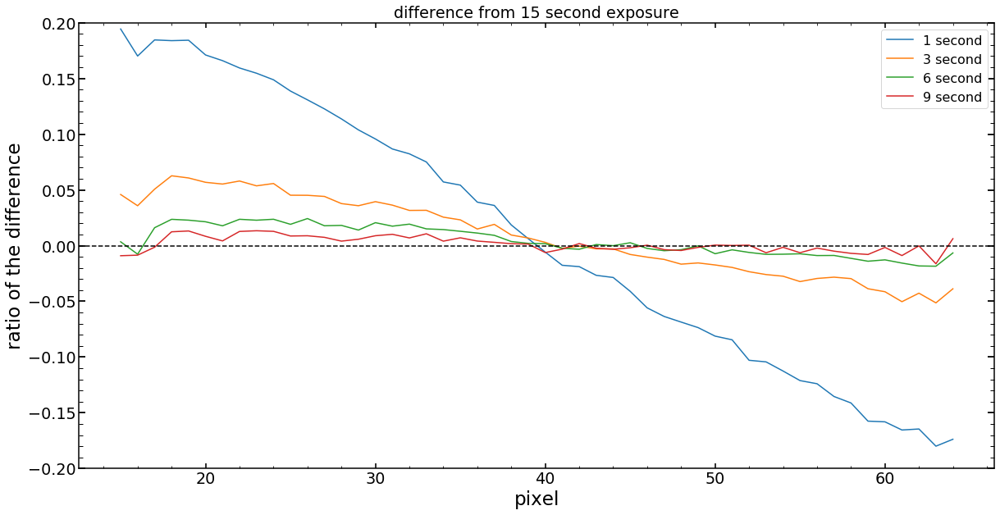

In [1134]:
plt.figure(figsize=(20,10))
plt.plot(med_values_1,label='1 second')
plt.plot(med_values_3,label='3 second')
plt.plot(med_values_6,label='6 second')
plt.plot(med_values_9,label='9 second')
plt.ylim(-0.2,0.2)
plt.legend()
plt.title('difference from 15 second exposure')
plt.ylabel('ratio of the difference')
plt.xlabel('pixel')

plt.axhline(0,ls='--',color='black')

## other side 

In [1059]:
54+17915

17969

In [1070]:

sci_cut_15s=array_of_sci_cut[16]

sci_cut_9s=array_of_sci_cut[32+24]+array_of_sci_cut[33+24]

sci_cut_6s=array_of_sci_cut[34+24]+array_of_sci_cut[35+24]+array_of_sci_cut[36+24]+array_of_sci_cut[37+24]

sci_cut_3s=array_of_sci_cut[38+24]+array_of_sci_cut[39+24]+array_of_sci_cut[40+24]+array_of_sci_cut[41+24]+array_of_sci_cut[42+24]+array_of_sci_cut[43+24]

sci_cut_1s=array_of_sci_cut[44+24]+array_of_sci_cut[45+24]+array_of_sci_cut[46+24]+array_of_sci_cut[47+24]+array_of_sci_cut[48+24]+array_of_sci_cut[49+24]+\
array_of_sci_cut[50+24]+array_of_sci_cut[51+24]+array_of_sci_cut[52+24]+array_of_sci_cut[53+24]

In [1071]:
sci_cut_1s_renormalized=sci_cut_1s*np.max(sci_cut_15s)/np.max(sci_cut_1s)
sci_cut_3s_renormalized=sci_cut_3s*np.max(sci_cut_15s)/np.max(sci_cut_3s)
sci_cut_6s_renormalized=sci_cut_6s*np.max(sci_cut_15s)/np.max(sci_cut_6s)
sci_cut_9s_renormalized=sci_cut_9s*np.max(sci_cut_15s)/np.max(sci_cut_9s)

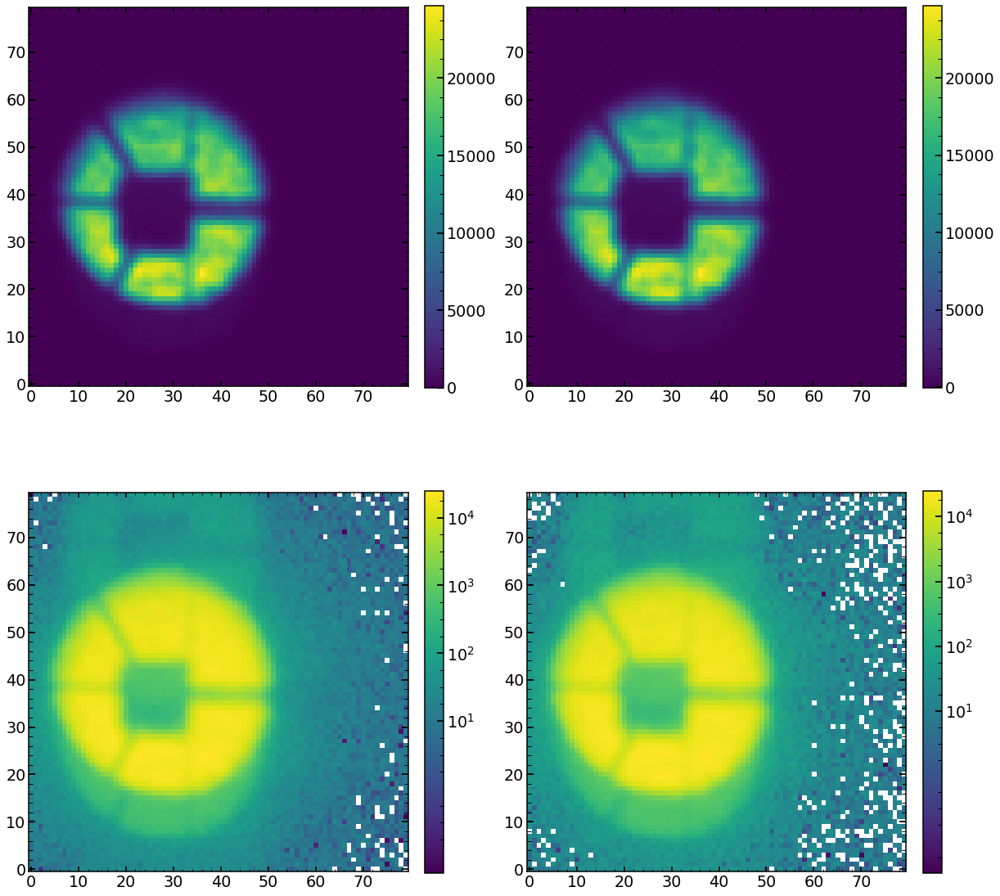

In [1072]:

plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(sci_cut_3s_renormalized,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(223)
plt.imshow(sci_cut_15s,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(224)
plt.imshow(sci_cut_3s_renormalized,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

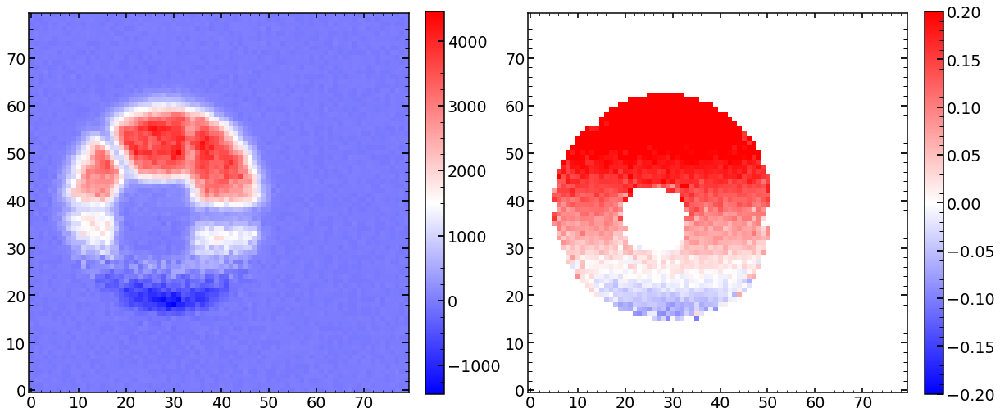

In [1073]:
masked_dif_1=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_1s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_1s_renormalized,origin='lower',cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_1,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


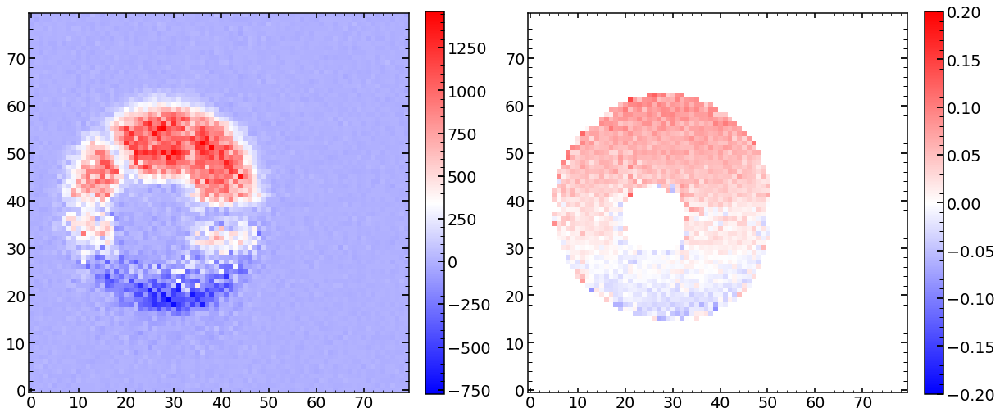

In [1074]:
masked_dif_3=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_3s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_3s_renormalized,origin='lower',cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_3,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

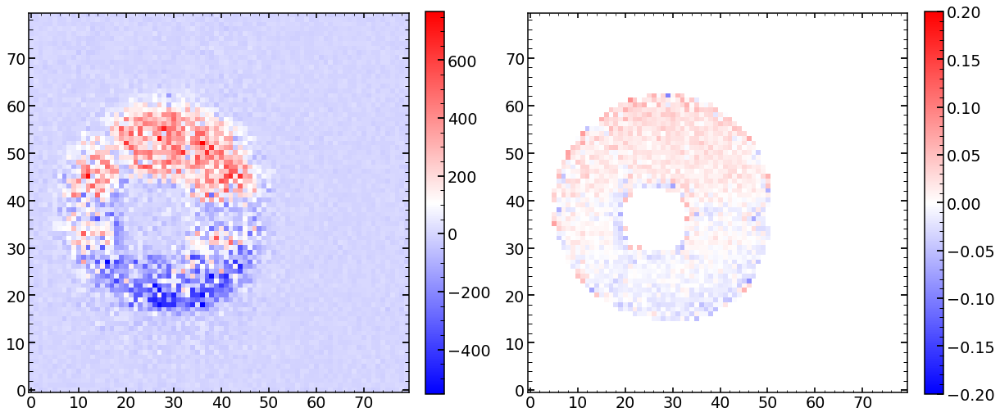

In [1075]:
masked_dif_6=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_6s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_6s_renormalized,origin='lower',cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_6,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

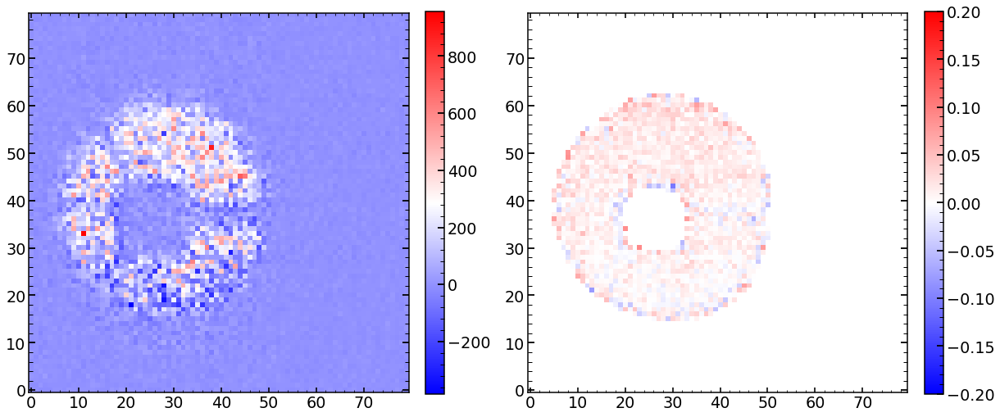

In [1076]:
masked_dif_9=np.ma.masked_where(sci_cut_15s<1000,((sci_cut_15s-sci_cut_9s_renormalized)/sci_cut_15s))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.imshow(sci_cut_15s-sci_cut_9s_renormalized,origin='lower',cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.imshow(masked_dif_9,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/numpy/core/fromnumeric.py:688: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)


(-0.2, 0.2)

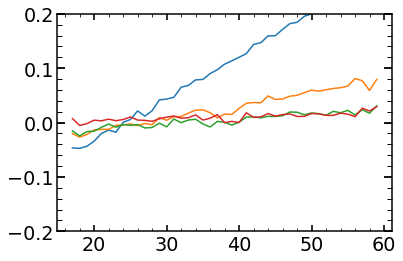

In [1077]:
plt.plot(np.median(masked_dif_1,axis=1))
plt.plot(np.median(masked_dif_3,axis=1))
plt.plot(np.median(masked_dif_6,axis=1))
plt.plot(np.median(masked_dif_9,axis=1))
plt.ylim(-0.2,0.2)

## att=0 and att=220

In [1161]:
from astropy.io import fits
y_pos=1083
x_pos=1228
list_of_exp_time=[]
list_of_defocus=[]
list_of_i=[]
list_of_att=[]
list_of_sci_cut=[]
#for i in tqdm(range(17915,17993)):
for i in tqdm(range(17915,17929)):
    fits_data=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/Jun_2019_run1/rerun/rerun_1/detrend/calExp/2019-05-09/v00'+str(i)+'/calExp-LA0'+str(i)+'r1.fits')
    hdr = fits_data[0].header
    list_of_i.append(i)
    list_of_defocus.append(hdr['W_ENFCAX'])
    list_of_exp_time.append(hdr['EXPTIME'])
    list_of_att.append(hdr['W_AITATT'])
    sci_data=fits_data[1].data
    list_of_sci_cut.append(sci_data[y_pos-40:y_pos+40,x_pos-40:x_pos+40])

100%|██████████| 14/14 [00:11<00:00,  1.21it/s]


In [1162]:
array_of_sci_cut=np.array(list_of_sci_cut)

In [1163]:
sci_cut_15s_att_0=array_of_sci_cut[0]+array_of_sci_cut[1]

sci_cut_15s_att_220=array_of_sci_cut[2]+array_of_sci_cut[3]+array_of_sci_cut[4]+array_of_sci_cut[5]+array_of_sci_cut[6]+array_of_sci_cut[7]+\
array_of_sci_cut[8]+array_of_sci_cut[9]+array_of_sci_cut[10]+array_of_sci_cut[11]+array_of_sci_cut[12]+array_of_sci_cut[13]

In [ ]:
sci_cut_15s_att_0_renormalized=sci_cut_15s_att_0
sci_cut_15s_att_220_renormalized=sci_cut_15s_att_220*np.median(sci_cut_15s_att_0[sci_cut_15s_att_220>1000])/np.median(sci_cut_15s_att_220[sci_cut_15s_att_220>1000])

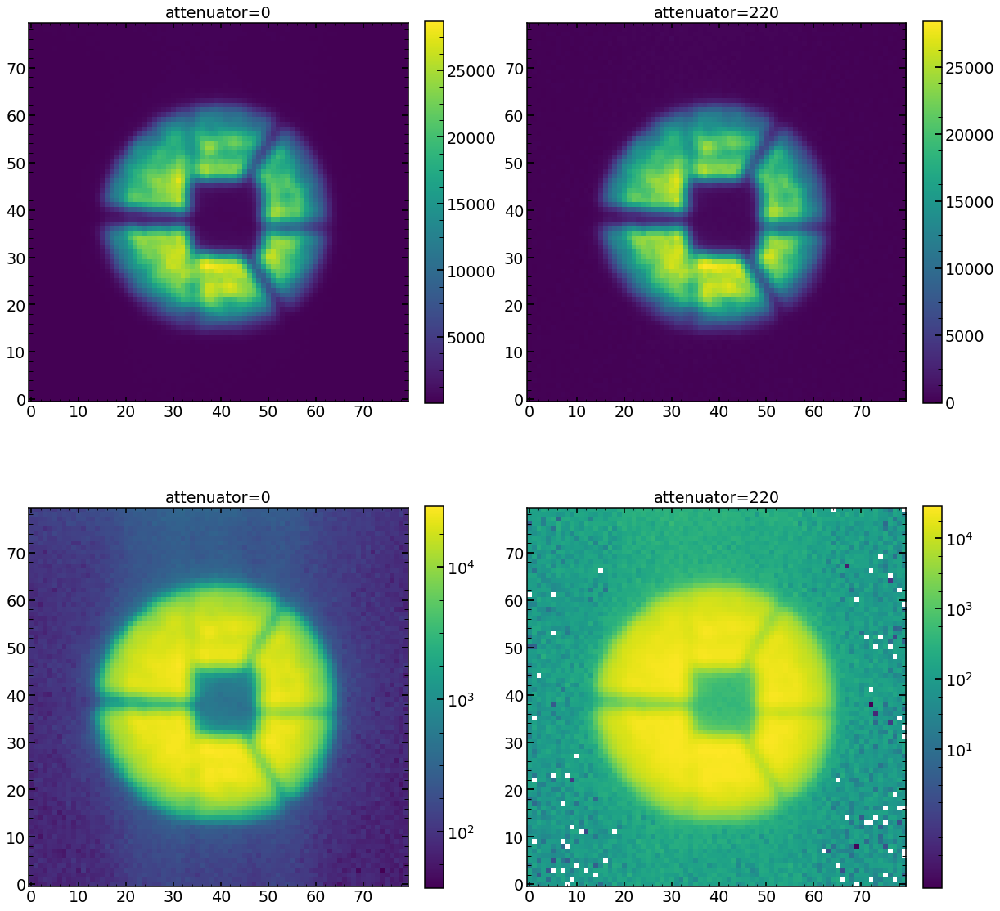

In [1168]:

plt.figure(figsize=(20,20))

plt.subplot(221)
plt.title('attenuator=0')
plt.imshow(sci_cut_15s_att_0_renormalized,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.title('attenuator=220')
plt.imshow(sci_cut_15s_att_220_renormalized,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(223)
plt.title('attenuator=0')
plt.imshow(sci_cut_15s_att_0_renormalized,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(224)
plt.title('attenuator=220')
plt.imshow(sci_cut_15s_att_220_renormalized,origin='lower',norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

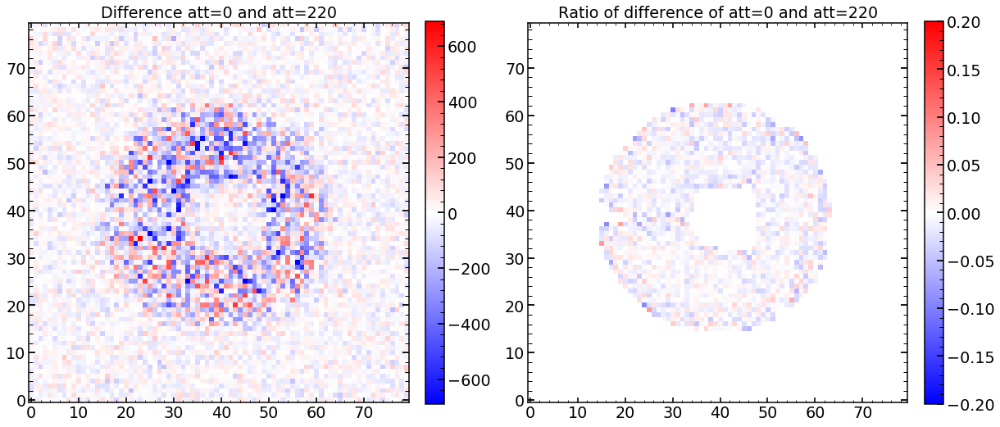

In [1169]:
masked_dif_0_220=np.ma.masked_where(sci_cut_15s_att_220<1000,((sci_cut_15s_att_0_renormalized-sci_cut_15s_att_220_renormalized)/sci_cut_15s_att_0_renormalized))
plt.figure(figsize=(20,20))

plt.subplot(221)
plt.title('Difference att=0 and att=220')
plt.imshow((sci_cut_15s_att_0_renormalized-sci_cut_15s_att_220_renormalized),origin='lower',cmap='bwr',vmax=np.max(sci_cut_15s_att_0_renormalized-sci_cut_15s_att_220_renormalized),vmin=-np.max(sci_cut_15s_att_0_renormalized-sci_cut_15s_att_220_renormalized))
cbar=plt.colorbar(fraction=0.046, pad=0.04)


plt.subplot(222)
plt.title('Ratio of difference of att=0 and att=220')
plt.imshow(masked_dif_0_220,origin='lower',vmin=-0.2,vmax=0.2,cmap='bwr')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

# PIPE2D-443

In [1188]:
f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_11_Z4_0_20_pixels.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_11_image_0=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_12_Z4_0_20_pixels.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_12_image_0=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_11_Z4_0_20_pixels.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_11_image_0=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_12_Z4_0_20_pixels.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_12_image_0=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')


f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_11_Z4_positive_Image.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_11_image_p=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_11_Field_12_Z4_positive_Image.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_11_field_12_image_p=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_11_Z4_positive_Image.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_11_image_p=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

f = io.open('/Users/nevencaplar/Dropbox/PFS/July8_focus/Wave_1_Field_12_Z4_positive_Image.txt', 'rt', encoding='utf-16')
lines=f.read()
WaveField_wave_1_field_12_image_p=np.genfromtxt(io.BytesIO(lines.encode('latin-1')), skip_header=17, delimiter='\t')

Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

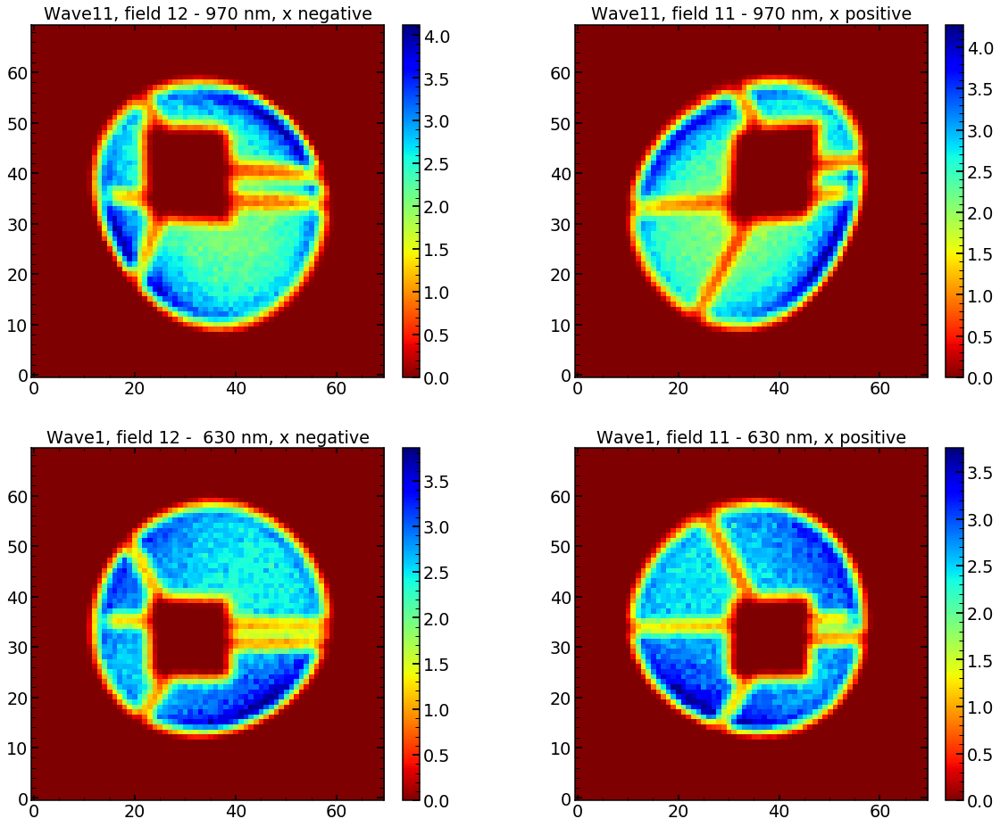

In [1175]:
plt.figure(figsize=(20,16))
plt.subplot(2,2,1)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_12_image_p, 90),vmax=np.max(WaveField_wave_11_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')

plt.subplot(2,2,2)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_11_image_p, 90),vmax=np.max(WaveField_wave_11_field_11_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')

plt.subplot(2,2,3)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_12_image_p, 90),vmax=np.max(WaveField_wave_1_field_12_image),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')

plt.subplot(2,2,4)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_11_image_p, 90),vmax=np.max(WaveField_wave_1_field_11_image)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')

Text(0.5,1,'Wave1, field 11 - 630 nm, x positive')

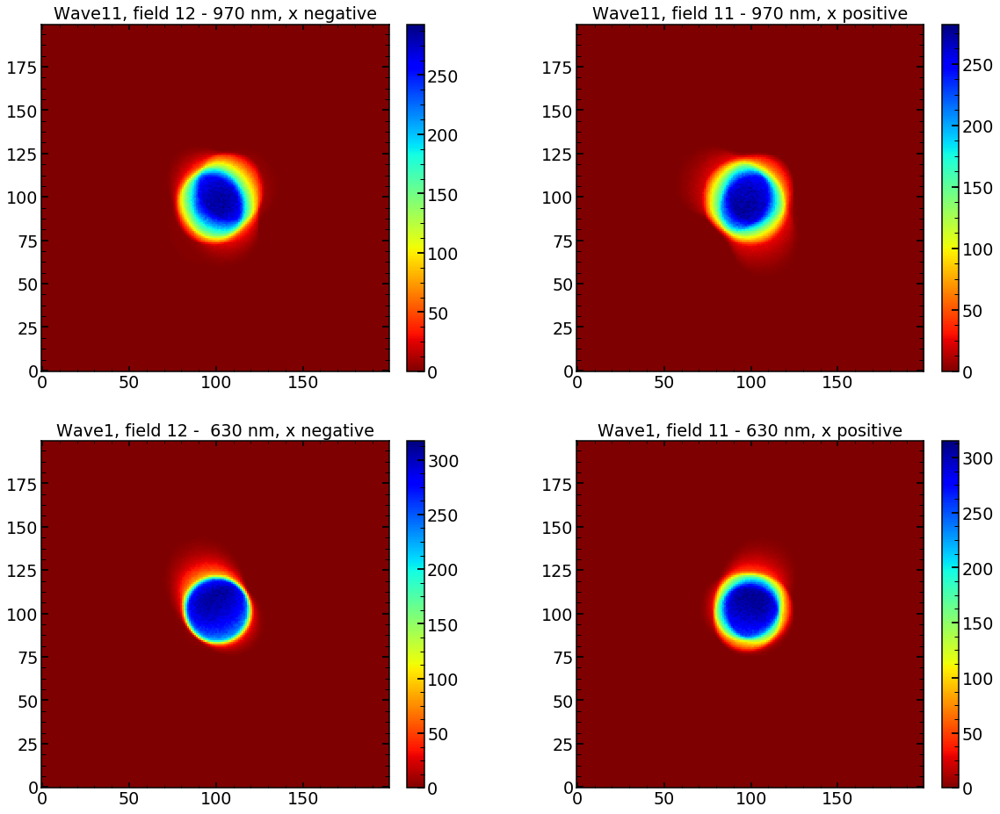

In [1189]:
plt.figure(figsize=(20,16))
plt.subplot(2,2,1)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_12_image_0, 90),vmax=np.max(WaveField_wave_11_field_12_image_0),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 12 - 970 nm, x negative')

plt.subplot(2,2,2)
plt.imshow(ndimage.rotate(WaveField_wave_11_field_11_image_0, 90),vmax=np.max(WaveField_wave_11_field_11_image_0),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave11, field 11 - 970 nm, x positive')

plt.subplot(2,2,3)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_12_image_0, 90),vmax=np.max(WaveField_wave_1_field_12_image_0),cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 12 -  630 nm, x negative')

plt.subplot(2,2,4)
plt.imshow(ndimage.rotate(WaveField_wave_1_field_11_image_0, 90),vmax=np.max(WaveField_wave_1_field_11_image_0)/1,cmap='jet_r',origin='lower')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Wave1, field 11 - 630 nm, x positive')

In [1191]:
WaveField_wave_11_field_12_image_0_downsampled=Zernike_Module.downsample_manual_function(ndimage.rotate(WaveField_wave_11_field_12_image_0, 90),20)
WaveField_wave_11_field_11_image_0_downsampled=Zernike_Module.downsample_manual_function(ndimage.rotate(WaveField_wave_11_field_11_image_0, 90),20)
WaveField_wave_1_field_12_image_0_downsampled=Zernike_Module.downsample_manual_function(ndimage.rotate(WaveField_wave_1_field_12_image_0, 90),20)
WaveField_wave_1_field_11_image_0_downsampled=Zernike_Module.downsample_manual_function(ndimage.rotate(WaveField_wave_1_field_11_image_0, 90),20)

In [1230]:
np.log10(160*365/100)

2.7664128471123997

Text(0.5,1,'Wave1, field 11 - 630 nm, (lower right)')

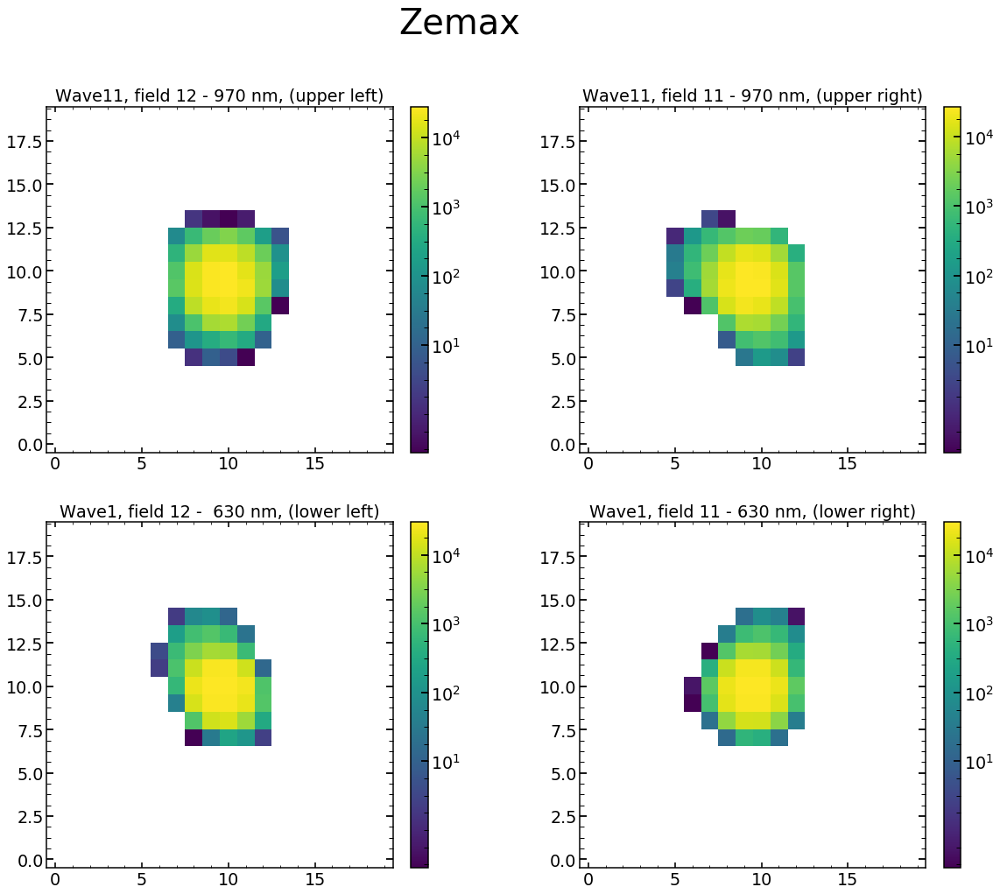

In [1238]:
plt.figure(figsize=(20,16))

plt.suptitle('Zemax',fontsize=40)
plt.subplot(2,2,1)
plt.imshow(WaveField_wave_11_field_12_image_0_downsampled,vmax=np.max(WaveField_wave_11_field_12_image_0_downsampled),origin='lower',vmin=np.max(WaveField_wave_11_field_12_image_0_downsampled)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
#plt.title('Wave11, field 12 - 970 nm, x negative')

plt.title('Wave11, field 12 - 970 nm, (upper left)')

plt.subplot(2,2,2)
plt.imshow(WaveField_wave_11_field_11_image_0_downsampled,vmax=np.max(WaveField_wave_11_field_11_image_0_downsampled),origin='lower',vmin=np.max(WaveField_wave_11_field_12_image_0_downsampled)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('Wave11, field 11 - 970 nm, (upper right)')

plt.subplot(2,2,3)
plt.imshow(WaveField_wave_1_field_12_image_0_downsampled,vmax=np.max(WaveField_wave_1_field_12_image_0_downsampled),origin='lower',vmin=np.max(WaveField_wave_11_field_12_image_0_downsampled)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('Wave1, field 12 -  630 nm, (lower left)')

plt.subplot(2,2,4)
plt.imshow(WaveField_wave_1_field_11_image_0_downsampled,vmax=np.max(WaveField_wave_1_field_11_image_0_downsampled)/1,origin='lower',vmin=np.max(WaveField_wave_11_field_12_image_0_downsampled)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('Wave1, field 11 - 630 nm, (lower right)')

In [ ]:
from astro

In [1201]:
FA000031r1=astropy.io.fits.open('/Users/nevencaplar/Documents/PFS/ReducedData/v0000031/calExp-FA000031r1.fits')[1].data

In [1222]:
Lower_left_31=FA000031r1[550-10:550+10,77-10:77+10]
Lower_right_31=FA000031r1[550-10:550+10,4021-10:4021+10]

Upper_left_31=FA000031r1[3764-10:3764+10,74-10:74+10]
Upper_right_31=FA000031r1[3764-10:3764+10,4024-10:4024+10]

Text(0.5,1,'x=4021, y=550 - 630 nm, (lower right)')

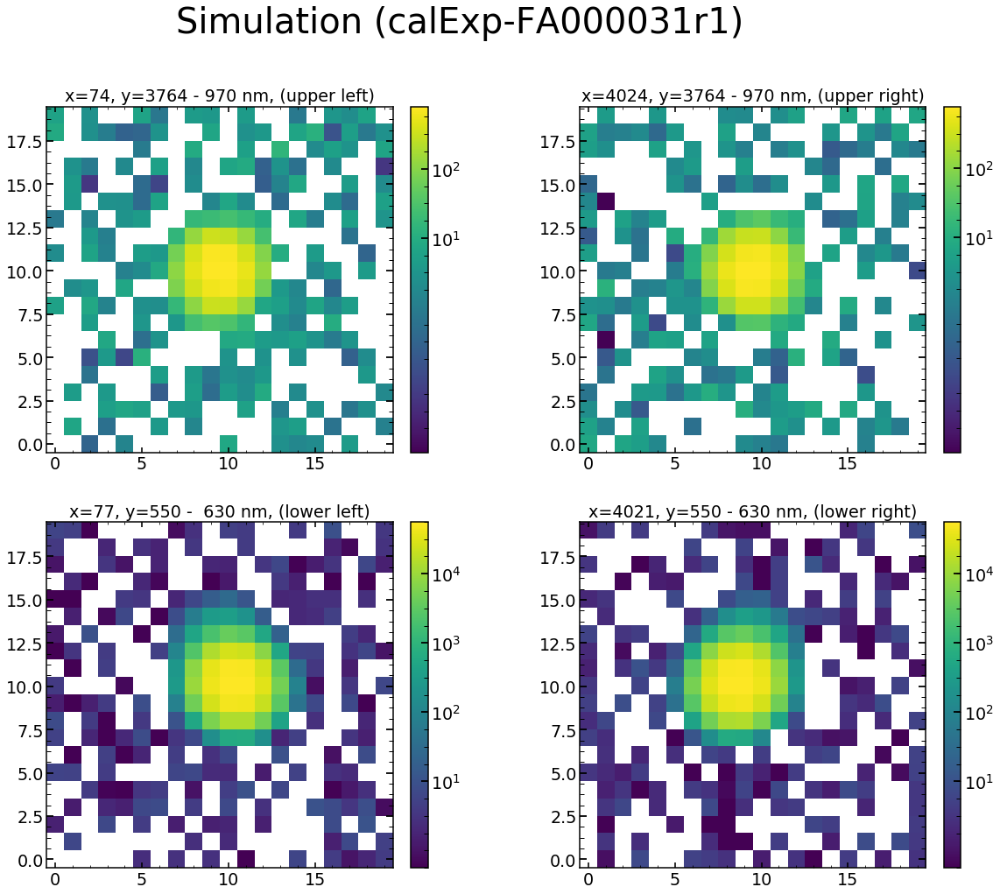

In [1240]:
plt.figure(figsize=(20,16))

plt.suptitle('Simulation (calExp-FA000031r1)',fontsize=40)

plt.subplot(2,2,1)
plt.imshow(Upper_left_31,vmax=np.max(Upper_left_31),origin='lower',vmin=np.max(Upper_left_31)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=74, y=3764 - 970 nm, (upper left)')

plt.subplot(2,2,2)
plt.imshow(Upper_right_31,vmax=np.max(Upper_right_31),origin='lower',vmin=np.max(Upper_right_31)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4024, y=3764 - 970 nm, (upper right)')

plt.subplot(2,2,3)
plt.imshow(Lower_left_31,vmax=np.max(Lower_left_31),origin='lower',vmin=np.max(Lower_left_31)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=77, y=550 -  630 nm, (lower left)')

plt.subplot(2,2,4)
plt.imshow(Lower_right_31,vmax=np.max(Lower_right_31)/1,origin='lower',vmin=np.max(Lower_right_31)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4021, y=550 - 630 nm, (lower right)')

In [1241]:
real_data_r1_HgAr=astropy.io.fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/May_2019_run3/rerun/rerun_3/arc/calExp/2019-05-06/v0017071/calExp-LA017071r1.fits')[1].data

real_data_r1_Ne=astropy.io.fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/ReducedData/NeonApr_2019/rerun/Apr30_2019/detrend/calExp/2019-04-17/v0016293/calExp-LA016293r1.fits')[1].data

In [1248]:
Lower_left_16293=real_data_r1_Ne[152-10:152+10,64-10:64+10]
Lower_right_16293=real_data_r1_Ne[152-10:152+10,4014-10:4014+10]

Upper_left_17071=real_data_r1_HgAr[4037-10:4037+10,58-10:58+10]
Upper_right_17071=real_data_r1_HgAr[4037-10:4037+10,4013-10:4013+10]

Text(0.5,1,'x=4014, y=152 - 630 nm, (lower right)')

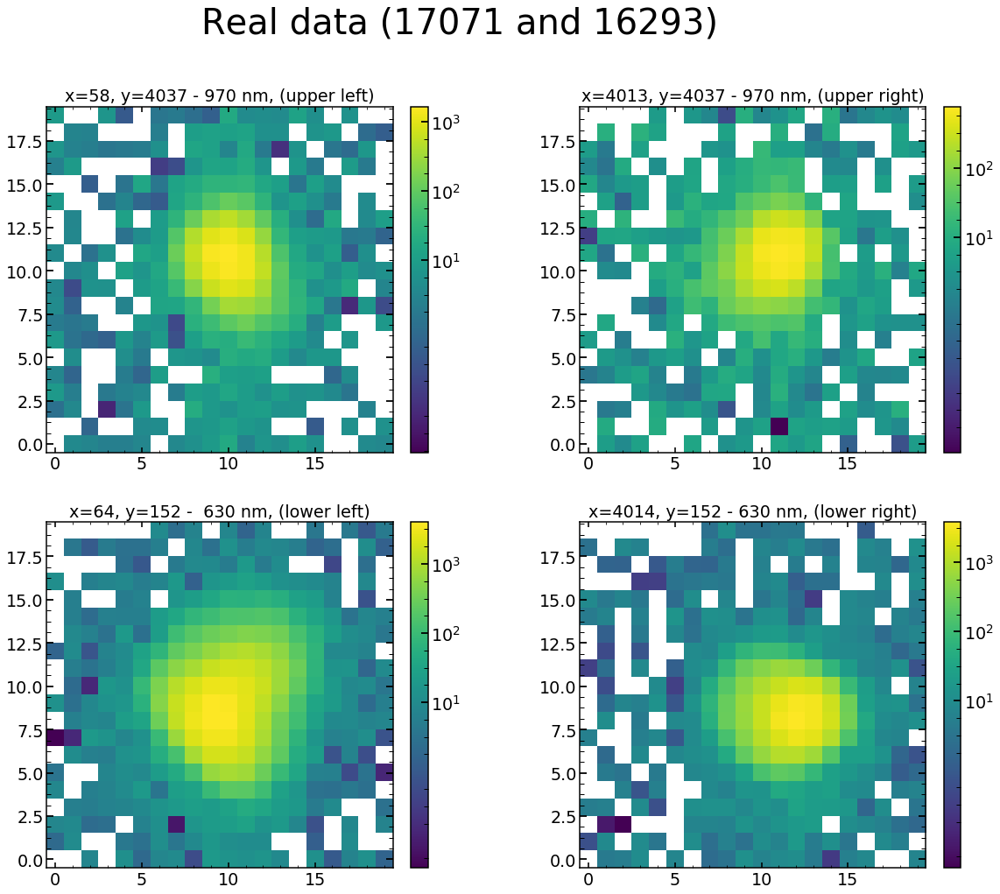

In [1250]:
plt.figure(figsize=(20,16))

plt.suptitle('Real data (17071 and 16293)',fontsize=40)

plt.subplot(2,2,1)
plt.imshow(Upper_left_17071,vmax=np.max(Upper_left_17071),origin='lower',vmin=np.max(Upper_left_17071)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=58, y=4037 - 970 nm, (upper left)')

plt.subplot(2,2,2)
plt.imshow(Upper_right_17071,vmax=np.max(Upper_right_17071),origin='lower',vmin=np.max(Upper_right_17071)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4013, y=4037 - 970 nm, (upper right)')

plt.subplot(2,2,3)
plt.imshow(Lower_left_16293,vmax=np.max(Lower_left_16293),origin='lower',vmin=np.max(Lower_left_16293)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=64, y=152 -  630 nm, (lower left)')

plt.subplot(2,2,4)
plt.imshow(Lower_right_16293,vmax=np.max(Lower_right_16293)/1,origin='lower',vmin=np.max(Lower_right_16293)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4014, y=152 - 630 nm, (lower right)')

Text(0.5,1,'x=4014, y=152 - 630 nm, (lower right)')

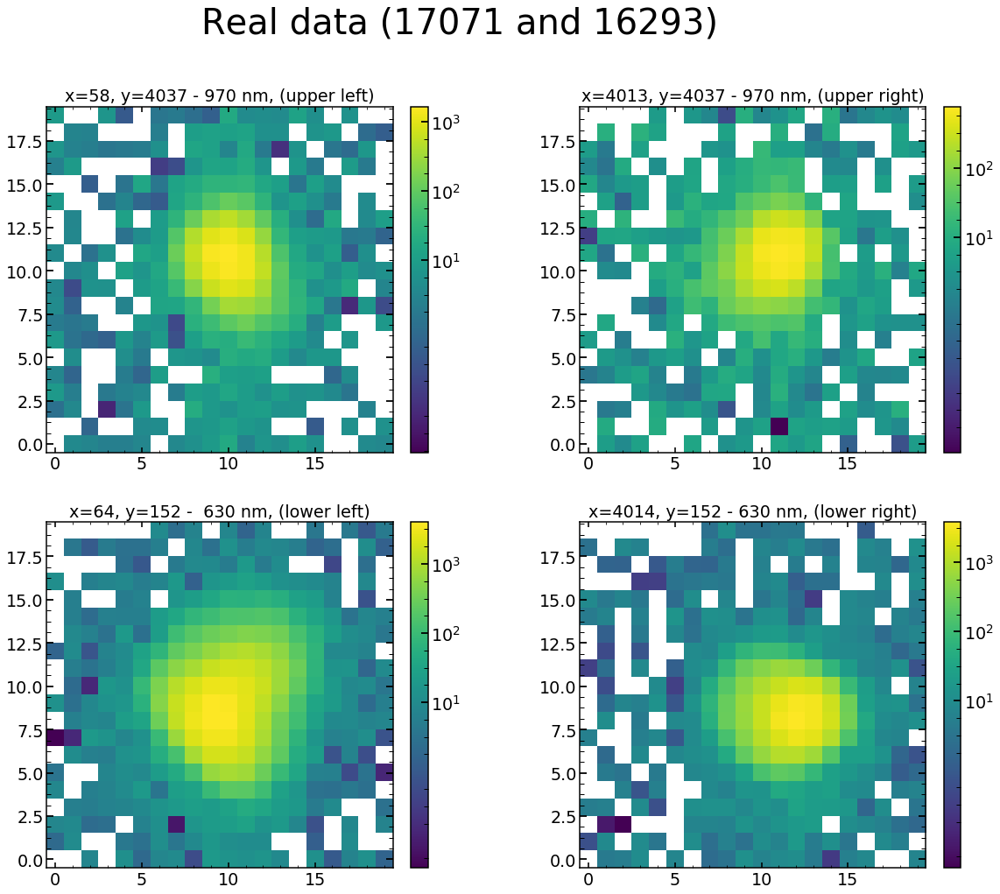

In [1271]:
plt.figure(figsize=(20,16))

plt.suptitle('Real data (17071 and 16293)',fontsize=40)

plt.subplot(2,2,1)
plt.imshow(Upper_left_17071,vmax=np.max(Upper_left_17071),origin='lower',vmin=np.max(Upper_left_17071)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=58, y=4037 - 970 nm, (upper left)')

plt.subplot(2,2,2)
plt.imshow(Upper_right_17071,vmax=np.max(Upper_right_17071),origin='lower',vmin=np.max(Upper_right_17071)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4013, y=4037 - 970 nm, (upper right)')

plt.subplot(2,2,3)
plt.imshow(Lower_left_16293,vmax=np.max(Lower_left_16293),origin='lower',vmin=np.max(Lower_left_16293)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=64, y=152 -  630 nm, (lower left)')

plt.subplot(2,2,4)
plt.imshow(Lower_right_16293,vmax=np.max(Lower_right_16293)/1,origin='lower',vmin=np.max(Lower_right_16293)/10**5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])
plt.title('x=4014, y=152 - 630 nm, (lower right)')

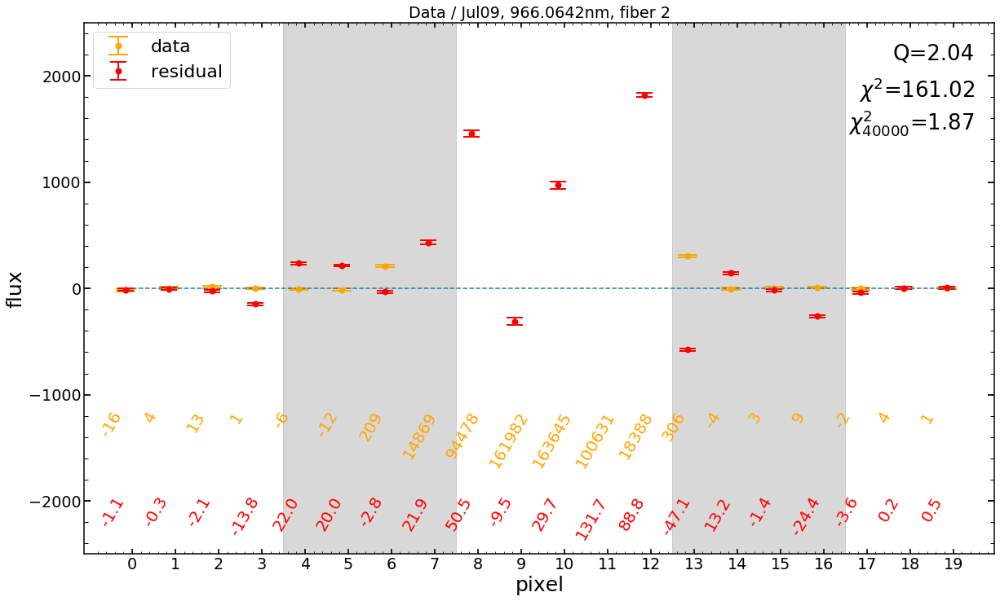

In [1268]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)

plt.figure(figsize=(20,12))
plt.errorbar(np.array(range(len(init_lamda)))-0.15,init_lamda,yerr=std_init_lamda,fmt='o',elinewidth=2,capsize=12,markeredgewidth=2,label='data',color='orange')
plt.errorbar(np.array(range(len(init_removal_lamda)))-0.15,init_removal_lamda,yerr=std_init_removal_lamda,color='red',fmt='o',elinewidth=2,capsize=10,markeredgewidth=2,label='residual')
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.legend(loc=2, fontsize=22)
plt.plot(np.zeros(20),'--')
plt.ylim(-2500,2500)
plt.ylabel('flux',size=25)
plt.xlabel('pixel',size=25)
plt.xticks(range(20))




for i in range(20):
    plt.text(-0.8+i, -1250, str("{:1.0f}".format(init_lamda[i])), fontsize=20,rotation=60.,color='orange')
    
for i in range(20):
    plt.text(-0.8+i, -2050, str("{:1.1f}".format(init_removal_lamda[i]/std_init_removal_lamda[i])), fontsize=20,rotation=60.,color='red')

sci_image_40000,var_image_40000,res_iapetus_40000=add_artificial_noise(sci_image,var_image,res_iapetus)
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image_40000,var_image_40000,res_iapetus_40000)

position_of_max_flux=np.where(init_lamda==np.max(init_lamda))[0][0]
difference_from_max=range(20)-position_of_max_flux
pixels_to_test=np.array(range(20))[(np.abs(difference_from_max)>2)&(np.abs(difference_from_max)<=6)]
Q=np.mean(np.abs(init_removal_lamda[pixels_to_test]/std_init_removal_lamda[pixels_to_test]))

plt.text(19.5,2300, 'Q='+str("{:1.2f}".format(Q)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2=np.mean((res_iapetus-sci_image)**2/var_image)

plt.text(19.5,2000, '$\chi^{2}$='+str("{:1.2f}".format(chi2)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)

chi2_40000=np.mean((res_iapetus_40000-sci_image_40000)**2/var_image_40000)

plt.text(19.5,1700, '$\chi^{2}_{40000}$='+str("{:1.2f}".format(chi2_40000)),
        horizontalalignment='right',
        verticalalignment='top',fontsize=26)


plt.axvspan(pixels_to_test[0]-0.5, pixels_to_test[3]+0.5, alpha=0.3, color='grey')
plt.axvspan(pixels_to_test[4]-0.5, pixels_to_test[7]+0.5, alpha=0.3, color='grey')

# Aug01

In [ ]:
# interpolating results from Jun, running next iteration, preparing results

In [22]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

## Creation of prediction for the fit (from Jun13) and verification

In [1274]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_Ne=pickle.load(f)

In [1289]:
from scipy.optimize import curve_fit

def lin_fit_2D(x_y, a, b,c):
    x=x_y[:,0]
    y=x_y[:,1]
    return a * x + b*y+c

def lin_fit_3D(dz_dx_dy, a, b,c,d):
    z=dz_dx_dy[:,0]
    x=dz_dx_dy[:,1]
    y=dz_dx_dy[:,2]
    return a * z + b*x+c*y+d


def func(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]


def funcz4(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1,c2):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+c2*x[2]**2+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]

#def func(x, a1,a2,a3,a4,a5,b1,b2,b3,b4,b5,c):
#    return np.polynomial.chebyshev.chebval(x[0],[a1,a2,a3,a4,a5])+np.polynomial.chebyshev.chebval(x[1],[b1,b2,b3,b4,b5])+c

#popt1, pcov = curve_fit(func, np.transpose(res_convolving_array1[:,[0,1]]), 10/4*res_convolving_array1[:,2])



label_short=['m4','m35','m3','m15','m05','0d','0','p05','p15','p3','p35','p4']
label_defocus=['m4','m35','m3','m15','p15','p3','p35','p4']
label_focus=['m05','0d','0','p05']
label_focus_focus=['0']
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
mm=np.array([-4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5, -0. , -0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4.,0 ])

In [1290]:
results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)

results_of_fit_many_single_defocus_Kr=pd.DataFrame(np.zeros((len(finalKr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_Kr_pd=pd.DataFrame(results_of_fit_many_single_defocus_Kr)

In [1316]:
results_of_fit_many_interpolation_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

results_of_fit_many_interpolation_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

results_of_fit_many_interpolation_Kr = {'m4': results_of_fit_many_single_defocus_Kr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Kr_pd.copy()}


# find coordinates of all spots on the detector
all_x_HgAr=finalHgAr['xc_effective']
all_y_HgAr=finalHgAr['yc']

all_x_Ne=finalNe['xc_effective']
all_y_Ne=finalNe['yc']

all_x_Kr=finalKr['xc_effective']
all_y_Kr=finalKr['yc']

# detector is 4096 pixels in x direction and 4176 in y direction
all_x_HgAr_in_respect_to_center=all_x_HgAr-int((4096+69)/2)
all_y_HgAr_in_respect_to_center=all_y_HgAr-int(4176/2)

all_x_Ne_in_respect_to_center=all_x_Ne-int((4096+69)/2)
all_y_Ne_in_respect_to_center=all_y_Ne-int(4176/2)

all_x_Kr_in_respect_to_center=all_x_Kr-int((4096+69)/2)
all_y_Kr_in_respect_to_center=all_y_Kr-int(4176/2)

In [1317]:
single_selection_Ne_index

array([ 6, 14, 15, 20, 23, 24, 29, 32, 33, 38, 41, 42, 47, 50, 51, 56, 59,
       60, 68, 69, 74, 77, 86, 87, 88])

In [1429]:
zMax=22

if zMax==11:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx',\
                 'radiometricEffect','radiometricExponent','x_ilum','y_ilum']
else:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22','hscFrac','effective_radius_illumination',\
                 'strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']


single_parameter=[]
for j in labels_cont:
    for i in label_defocus:

        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        # fibers 2 and 3 are too close and remove them from analysis - this is only the case for Feb data
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)          
        
        # no Kr data avaliable
        #single_selection_Kr_index=results_of_fit_many_Kr[i][j].index.values
        
        #########
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]      
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]    
        #single_selection_Kr=results_of_fit_many_Kr[i][j][single_selection_Kr_index]   
        #########
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values

        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values

        #single_selection_x_Kr=all_x_Kr_in_respect_to_center[single_selection_Kr.index.astype(int)]
        #single_selection_y_Kr=all_y_Kr_in_respect_to_center[single_selection_Kr.index.astype(int)]    
        #single_selection_z_Kr=np.full(len(single_selection_Kr),mm[label.index(i)])
        #single_selection_values_Kr=single_selection_Kr.values
        #########
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        #single_selection_array_Kr=np.transpose(np.array([single_selection_Kr.index,single_selection_x_Kr.values,single_selection_y_Kr.values,single_selection_z_Kr,single_selection_values_Kr]))         
        #########     
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        #single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne,single_selection_array_Kr))
        single_selection_array=single_selection_array_HgAr
        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-5*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))        
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))      
    elif j in ['slitHolder_frac_dx','x_ilum']:
        # I force to have no z-dependance and positive x dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[-0.000001,0,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        ##############
        # I am manually overiding the fit!!!!
        ##############
        #popt=[-3*10e-5,0,0,0,0,0,0,0,0]
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['y_ilum']:
        # I force to have no z-dependance and no x-dependence, only y dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.0,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,0,0,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,np.inf,np.inf,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['effective_radius_illumination']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt)))     
        
    elif j in ['radiometricEffect','radiometricExponent']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    else:     
        # 'z5','z6','z7','z8','z9','z10','z11'
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0])
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]        

        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0])        
    #########      
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
  
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Kr[i].at[:,j]=func([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)     
print('Done')

z5: [-0.00000313 -0.00000003 -0.00004035 -0.         -0.00557912 -0.16888346
  0.00000025 -0.00017189  0.00000043]
Value in center for z5: -0.7433987626344264
First fit for z5: [-0.00000313 -0.00000003 -0.00004035 -0.         -0.00557912 -0.16888346
  0.00000025 -0.00017189  0.00000043]
z6: [ 0.00002121  0.00000012 -0.00002681 -0.00000017  0.1599048  -0.35762127
  0.          0.00001752  0.00009095]
Value in center for z6: 0.9806676768555561
First fit for z6: [ 0.00002121  0.00000012 -0.00002681 -0.00000017  0.1599048  -0.35762127
  0.          0.00001752  0.00009095]
z7: [-0.00000718 -0.00000001 -0.00025577  0.         -0.01145901  0.21903495
  0.00000002  0.00000096 -0.00000654]
Value in center for z7: -0.3534819036819071
First fit for z7: [-0.00000718 -0.00000001 -0.00025577  0.         -0.01145901  0.21903495
  0.00000002  0.00000096 -0.00000654]
z8: [-0.00036449 -0.         -0.00001763  0.00000005 -0.00080204 -0.27036845
  0.00000003  0.00000523 -0.0000035 ]
Value in center for z8

x_ilum: [-0.000001   -0.          0.          0.          0.          0.97291238
  0.         -0.         -0.        ]
Value in center for x_ilum: 0.9708724243441301
Value in center for x_ilum: 0.9708725482403351
y_ilum: [ 0.        0.        0.        0.       -0.        0.948338 -0.
 -0.        0.      ]
Value in center for y_ilum: 0.9483363136645223
Value in center for y_ilum: 0.9483363305158613
Done


In [1430]:
single_parameter=[]
for j in ['z4']:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr

        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['z4']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(funcz4, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0,0])
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,0],*popt)))            
   
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=funcz4([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=funcz4([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Kr[i].at[:,j]=funcz4([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)    

First fit for z4: [-0.00023447  0.00000031  0.00002931 -0.00000045 -0.          4.64219029
 -0.00000016  0.         -0.        ]
z4: [ 0.000007    0.00000015  0.00002016  0.00000007 -7.67864732 -0.15125163
 -0.00000003 -0.0000144  -0.00009471  0.01058884]
Value in center for z4: -30.733241011698013
Value in center for z4: 0.7228533202035997


In [1431]:
# parameters that vary as a function of fiber, sensitive in defocus - describing illumination of the pupil)
# we just select median value across all defocused measurments?

inerpolation_mean_par_dx=[]
for j in ['x_fiber','y_fiber','frd_sigma','frd_lorentz_factor']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]
    # dspot = number of fiber
    # fill the values
    for i in label_defocus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j])) 
            
            
            
    values=np.concatenate((values_HgAr,values_Ne))      
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)    

    # when I had only HgAr
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)    

    
    # taking median
    parameter_res=[]
    # number of fibers
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1
    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['fiber']
        dspot_Ne=finalNe['fiber']
        dspot_Kr=finalKr['fiber']
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])
        for l in range(len(dspot_Kr)):
            values_Kr.append(parameter_res[int(float(dspot_Kr[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr
        

In [1432]:
# parameters that vary slowly across the pupil, sensitive in focus

single_parameter=[]
for j in ['scattering_slope','scattering_amplitude','pixel_effect','flux']:
    for i in label_focus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr,single_selection_y_HgAr,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne,single_selection_y_Ne,single_selection_z_Ne,single_selection_values_Ne]))         
        
        # when we had only HgAr
        #single_selection_array=single_selection_array_HgAr
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
       
        if i==label_focus[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))
    if j in ['pixel_effect']:
        # no z dependence, no dependence has to become stronger towards lower wavelengths
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))
        
    else:
        # no z dependence
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-10,-np.inf,-np.inf,-10e-10,-10e-10],[np.inf,np.inf,np.inf,np.inf,10e-10,np.inf,np.inf,10e-10,10e-10]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))

    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=func([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for scattering_slope: [ 0.00001644  0.00000001  0.00004279 -0.          0.          2.48473608
  0.00000001 -0.         -0.        ]
scattering_slope [ 0.00001675  0.00000001  0.00004513 -0.00000001  0.          2.50049259
  0.00000001 -0.         -0.        ]
Value in center for scattering_slope :2.683616118451964
First fit for scattering_amplitude: [ 0.00000068  0.          0.00000094  0.          0.          0.00279265
  0.         -0.         -0.        ]
scattering_amplitude [ 0.00000069  0.          0.00000099  0.          0.          0.00285024
  0.         -0.         -0.        ]
Value in center for scattering_amplitude :0.01217707644421511
First fit for pixel_effect: [-0.         -0.          0.          0.          0.          0.39976003
 -0.         -0.         -0.        ]
pixel_effect [-0.         -0.          0.          0.          0.          0.38784171
 -0.         -0.         -0.        ]
Value in center for pixel_effect :0.3877984625942059
First fit for fl

In [1433]:
# factors depending on dy as a non-smooth function
# fits grating lines as a median value of grating value for a given wavelength for focus
inerpolation_mean_par_dy=[]
for j in ['grating_lines']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]
    
    
    # dspot = number of fiber
    # fill the values
    for i in label_focus_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['wavelength'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['wavelength'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            

    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne))    
    
    #values=values_HgAr       
    #dspot=dspot_HgAr 
    
    
    parameter_res=[]
    for i in range(len(np.unique(dspot))):
        if len(values[dspot==np.unique(dspot)[i]])>1:
            print(np.unique(dspot)[i])
            print(values[dspot==np.unique(dspot)[i]])
            print(np.median(values[dspot==np.unique(dspot)[i]]))
            parameter_res.append(np.median(values[dspot==np.unique(dspot)[i]]))
        else:
            parameter_res.append(100000)
    parameter_res=np.array(parameter_res)                                   
    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['wavelength']
        dspot_Ne=finalNe['wavelength']
        dspot_Kr=finalKr['wavelength']     
        
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        
        for l in range(len(dspot_HgAr)):
            if np.sum((np.unique(dspot)==dspot_HgAr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_HgAr.append(100000)
            else:
                values_HgAr.append(parameter_res[(np.unique(dspot)==dspot_HgAr[l])][0])
        for l in range(len(dspot_Ne)):
            if np.sum((np.unique(dspot)==dspot_Ne[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Ne.append(100000)
            else:
                values_Ne.append(parameter_res[(np.unique(dspot)==dspot_Ne[l])][0])
        for l in range(len(dspot_Kr)):
            if np.sum((np.unique(dspot)==dspot_Kr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Kr.append(100000)
            else:
                values_Kr.append(parameter_res[(np.unique(dspot)==dspot_Kr[l])][0])
            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr

660.0668
[66943.67448227 67390.34146526 66657.98435168 69121.81019212
 73419.66572046 78732.08429569]
68256.07582869133
693.13116
[54760.01513343 64477.57378204 61416.67462403 72898.2428448
 77337.39652256 63429.36927594 69383.72724845 60564.84221914]
63953.47152898653
696.7261
[119842.67328554  92418.66969182 102343.20398419  81150.92272852
  95672.98058559  82322.47650214  92729.23899571 119893.49973135
  92508.00828352]
92729.23899571027
717.59015
[52570.59673706 75528.62501274 62159.4870593  62563.02424725
 81652.12498779 65828.41293247 72728.87052149 78555.30542312
 53699.23752254]
65828.41293247015
727.47876
[ 72102.42308027  61201.72130525 108046.11382483  55371.71942381
  69575.81550269  54699.28786813  58059.39937855  91238.71798706
  88604.51421694]
69575.81550269102
795.0522
[ 78790.81447657  77297.16636756 119757.79610559 119731.64265397
  80120.13911164  98151.86307782 106542.73772186  97543.90455243
 107995.05729812]
98151.86307781782
912.5693
[63585.2566152  57400.307062

In [1434]:
# parameters that vary as a function of fiber, sensitive in focus

inerpolation_mean_par_dx=[]
for j in ['fiber_r']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]    
    # dspot = number of fiber
    # fill the values
    for i in label_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)
    
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)
    
    
    # taking median
    parameter_res=[]
    # atm range 10
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1

    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['fiber']
        dspot_Ne=finalNe['fiber']
        dspot_Kr=finalKr['fiber']
        
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])
        for l in range(len(dspot_Kr)):
            values_Kr.append(parameter_res[int(float(dspot_Kr[l]))])
            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr

In [1435]:
import pickle
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/' + 'results_of_fit_many_interpolation_HgAr_from_Jun13.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/' + 'results_of_fit_many_interpolation_Ne_from_Jun13.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/' + 'results_of_fit_many_interpolation_Kr_from_Jun13.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Kr,f, protocol=pickle.HIGHEST_PROTOCOL)

In [1436]:
results_of_fit_many_interpolation_Kr['m4'].iloc[17]

z4                               3.080102e+01
z5                              -5.476527e-01
z6                              -1.034584e+00
z7                               2.386846e-01
z8                              -9.839556e-02
z9                              -9.397458e-02
z10                             -3.503830e-01
z11                             -3.680598e-01
z12                             -6.923839e-02
z13                              7.734593e-03
z14                              2.082313e-03
z15                              3.327524e-02
z16                             -2.742167e-02
z17                              9.256449e-02
z18                              1.115724e-02
z19                             -7.418813e-03
z20                             -3.709120e-02
z21                              3.233956e-02
z22                              8.490695e-03
hscFrac                          6.668641e-01
strutFrac                        7.936001e-02
dxFocal                         -4

### verification - not complete (rest in Zernike_Work_March)

In [1437]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [1438]:
# plot the results of the interpolation

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Jun13'
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocu that we have analyzed

for j in tqdm(labels_with_data):
    # i runs through all the parameters
    for i in range(0,len(descriptions)):

        # take values for HgAr
        x_HgAr=finalHgAr.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]])
        
        # take values for Krypton        
        x_Kr=finalKr.loc[results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Kr=finalKr.loc[results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Kr=np.array(results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]])        
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne,x_Kr))
        y=np.concatenate((y_HgAr,y_Ne,y_Kr))    
        colors= np.concatenate((values_HgAr,values_Ne,values_Kr))
        

        
        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1  

        plt.scatter(x_HgAr, y_HgAr, s=np.pi * (12 * 1)**2, c=values_HgAr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='o')
        plt.scatter(x_Ne, y_Ne, s=np.pi * (8 * 1)**2, c=values_Ne, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='s')
        plt.scatter(x_Kr, y_Kr, s=np.pi * (12 * 1)**2, c=values_Kr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='p')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+'Interpolation: '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

100%|██████████| 14/14 [06:47<00:00, 29.14s/it]


<Figure size 864x720 with 0 Axes>

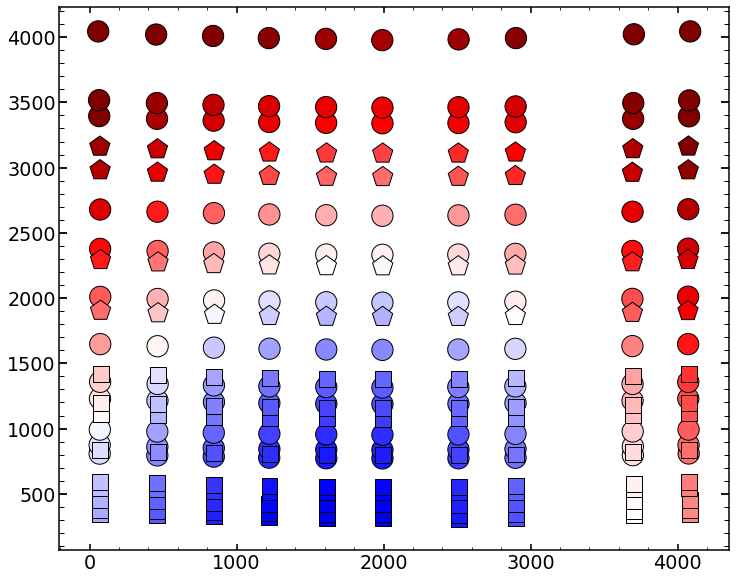

In [1357]:
        plt.scatter(x_HgAr, y_HgAr, s=np.pi * (12 * 1)**2, c=values_HgAr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='o')
        plt.scatter(x_Ne, y_Ne, s=np.pi * (8 * 1)**2, c=values_Ne, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='s')
        plt.scatter(x_Kr, y_Kr, s=np.pi * (12 * 1)**2, c=values_Kr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='p')

## Scripts

In [107]:
list_of_HgAr_to_analyze=finalHgAr_May2019.index[(finalHgAr_May2019['fiber'].values.astype(int)<=650)&(finalHgAr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_May2019['close'].values.astype(int)==1)]
print(len(list_of_HgAr_to_analyze))

list_of_Ne_to_analyze=finalNe_May2019.index[(finalNe_May2019['fiber'].values.astype(int)<=650)&(finalNe_May2019['fiber'].values.astype(int)>=2)
                                        &(finalNe_May2019['close'].values.astype(int)==1)]
print(len(list_of_Ne_to_analyze))

list_of_Kr_to_analyze=finalKr_May2019.index[(finalKr_May2019['fiber'].values.astype(int)<=650)&(finalKr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalKr_May2019['close'].values.astype(int)==1)]
print(len(list_of_Kr_to_analyze))



50
40
10


In [109]:
#MPI
for single_spot in list_of_HgAr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01S'+str(single_spot)+'Aug.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, p35, m05, p05,m3,p3,m15,p15
    for obs in [17017+6,17017+102,17017+54,17017+12,17017+96,17017+48,17017+60,17017+18,17017+90,17017+36,17017+72]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger01'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_HgAr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T01S'+str(single_spot)+'Aug.sh \n')

file.close()
##################
##################
##################

for single_spot in list_of_Ne_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02S'+str(single_spot)+'Aug.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, p35, m05, p05,m3,p3,m15,p15
    for obs in [16238+6,16238+102,16238+54,16238+12,16238+96,16238+48,16238+60,16238+18,16238+90,16238+36,16238+72]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger02'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Ne_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T02S'+str(single_spot)+'Aug.sh \n')

file.close()
##################
##################
##################
for single_spot in list_of_Kr_to_analyze:
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03S'+str(single_spot)+'Aug.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 17:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    # m4, p4, 0, m35, p35, m05, p05,m3,p3,m15,p15
    for obs in [17310+6,17310+102,17310+54,17310+12,17310+96,17310+48,17310+60,17310+18,17310+90,17310+36,17310+72]:
        file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01.py "+str(obs)+" "+str(single_spot)+" 40 5 Kr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger03'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for single_spot in list_of_Kr_to_analyze:
    file.write('sbatch /home/ncaplar/Scripts/T03S'+str(single_spot)+'Aug.sh \n')

file.close()


## estimating parameter spread 

In [1472]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Jun130119/'

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Jun13.pkl', 'rb') as f:
    results_of_fit_many_Ne=pickle.load(f)

In [1474]:
columns22

['z4',
 'z5',
 'z6',
 'z7',
 'z8',
 'z9',
 'z10',
 'z11',
 'z12',
 'z13',
 'z14',
 'z15',
 'z16',
 'z17',
 'z18',
 'z19',
 'z20',
 'z21',
 'z22',
 'hscFrac',
 'strutFrac',
 'dxFocal',
 'dyFocal',
 'slitFrac',
 'slitFrac_dy',
 'radiometricEffect',
 'radiometricExponent',
 'x_ilum',
 'y_ilum',
 'x_fiber',
 'y_fiber',
 'effective_radius_illumination',
 'frd_sigma',
 'frd_lorentz_factor',
 'det_vert',
 'slitHolder_frac_dx',
 'grating_lines',
 'scattering_slope',
 'scattering_amplitude',
 'pixel_effect',
 'fiber_r',
 'flux']

In [1477]:
columns22[19]

'hscFrac'

In [1490]:
for i in range(19,42):
    values=np.concatenate((results_of_fit_many_HgAr['m4'][columns22[i]].values,results_of_fit_many_Ne['m4'][columns22[i]].values,results_of_fit_many_HgAr['p4'][columns22[i]].values,results_of_fit_many_Ne['p4'][columns22[i]].values))
    print(columns22[i],3*np.std(values))

hscFrac 0.07963933172331203
strutFrac 0.03063433096508823
dxFocal 0.33538765587300656
dyFocal 0.3523915875576798
slitFrac 0.016005388912058147
slitFrac_dy 0.1221525781661345
radiometricEffect 0.04642756216877754
radiometricExponent 0.06078639341174438
x_ilum 0.027969329327242255
y_ilum 0.037653827544953104
x_fiber 0.1500305012208049
y_fiber 0.13856324560053296
effective_radius_illumination 0.11235821989099168
frd_sigma 0.10478106061463599
frd_lorentz_factor 0.6443732200301979
det_vert 0.09655403474925922
slitHolder_frac_dx 1.0714234632301813
grating_lines 82434.44713497942
scattering_slope 0.9501799972614687
scattering_amplitude 0.014574905539192357
pixel_effect 0.22591738058708427
fiber_r 0.14134775545806028
flux 0.014473876907955076


In [1487]:
np.concatenate((results_of_fit_many_HgAr['m4'][columns22[i]].values,results_of_fit_many_Ne['m4'][columns22[i]].values,results_of_fit_many_HgAr['p4'][columns22[i]].values,results_of_fit_many_Ne['p4'][columns22[i]].values))

array([ 0.05545257, -0.00625508,  0.07083457,  0.08167123,  0.04612443,
        0.00490668,  0.0458674 ,  0.19537759,  0.03026842,  0.09703712,
        0.06867973,  0.00501362,  0.12912842,  0.00956763,  0.01080517,
        0.03737013,  0.02912294,  0.03102774,  0.03962209,  0.00645046,
        0.02487318,  0.05629705,  0.00324094,  0.02653139, -0.0691585 ,
        0.00936827,  0.07420789,  0.00460545,  0.05548966, -0.00271175,
        0.01502024,  0.04871884,  0.08923546,  0.03191198,  0.06507724,
        0.04492797,  0.1359182 ,  0.04642041,  0.02260706,  0.02419171,
        0.00440069,  0.03685244,  0.06261762,  0.10893621,  0.04580611,
        0.08336868,  0.16473474,  0.11326363,  0.10431233,  0.03822731,
        0.05388871,  0.07686031,  0.01420395,  0.01274636,  0.03765566,
        0.08859453,  0.09015794,  0.02289893,  0.04134685,  0.01633569,
        0.03920306,  0.04746102, -0.00531854,  0.03807078, -0.03518129,
        0.01550631,  0.05000923,  0.04480497,  0.0098074 ,  0.04

## which images are avaliable 

In [175]:
import glob
date='Aug01'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)

In [176]:
#analyzed_Neon_images=[]
#for i in range(len(Emcee3_Ne)):
#    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
#    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
#    
#analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [177]:
#arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
#arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [178]:
arranged_by_spot_number_HgAr

array([[17023,     1],
       [17035,     1],
       [17107,     1],
       [17053,     1],
       [17077,     1],
       [17065,     1],
       [17119,     1],
       [17113,     1],
       [17029,     1],
       [17071,     1],
       [17107,     3],
       [17089,     3],
       [17023,     3],
       [17035,     3],
       [17113,     3],
       [17119,     3],
       [17029,     3],
       [17053,     3],
       [17071,     3],
       [17077,     3],
       [17065,     3],
       [17029,     6],
       [17119,     6],
       [17113,     6],
       [17023,     6],
       [17065,     6],
       [17071,     6],
       [17077,     6],
       [17065,     9],
       [17089,     9],
       [17107,     9],
       [17053,     9],
       [17119,     9],
       [17113,     9],
       [17035,     9],
       [17029,     9],
       [17023,     9],
       [17071,     9],
       [17077,     9],
       [17071,    11],
       [17065,    11],
       [17107,    11],
       [17023,    11],
       [170

## single image 

In [23]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  




date='Aug01'
obs=17119
single_number='93'
image_index=int(single_number)
eps=5
arc="HgAr"
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    print('dataset is: ' + str(dataset))
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    print('dataset is: ' + str(dataset))
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    elif arc=="Kr":
        single_number_focus=17310+54  
    else:
        print("Not recognized arc-line")
if dataset==3:
    print('dataset is: ' + str(dataset))
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
    elif arc=='Kr':
         obs_possibilites=np.array([17310+6,17310+12,17310+18,17310+24,17310+30,17310+36,17310+42,17310+48,17310+54,17310+54,17310+60,17310+66,17310+72,17310+78,17310+84,17310+90,17310+96,17310+102,17310+54])
        
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    elif arc=="Kr":
        finalArc=finalKr_May2019        
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

dataset is: 2
p4


fiber                         525
xc                           2829
yc                           3348
wavelength               912.5693
close                           1
lamp                         HgAr
xc_effective                 2898
old_index_approx              153
superold_index_approx        24.0
Name: 93, dtype: object

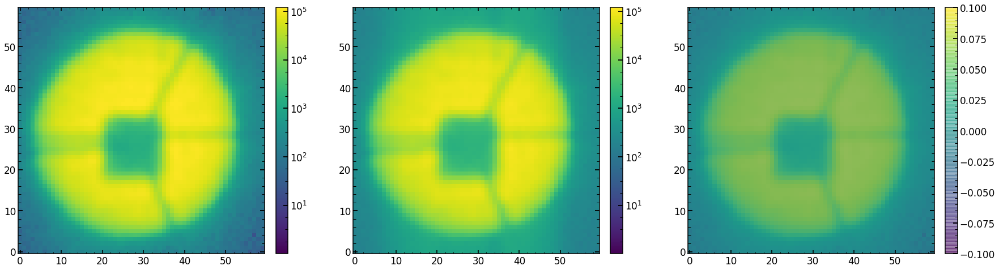

In [24]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(132)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(133)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
plt.imshow(mask_image,origin='lower',vmin=0,vmax=np.max(mask_image),alpha=0.5)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [25]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 20, 42)
minimal likelihood is: 299996.68972149875
minimal chi2 reduced is: 166.65924582362553


In [26]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
          z4        z5        z6       z7        z8       z9       z10  \
0 -30.744163 -0.429061  0.658937 -0.15534 -0.383875 -0.16186 -0.258595   

        z11  
0 -0.081556  
        z12       z13       z14       z15       z16       z17      z18  \
0 -0.009529 -0.017286  0.014532  0.018501 -0.036556  0.043214 -0.01212   

       z19       z20       z21  
0  0.00585 -0.012922  0.023731  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.060956  0.661448   0.077211  0.073883  0.138443  0.062387     0.021506   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000019             0.000019  0.972115    ...      0.088634   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.839082  1.032942           -0.258294   80990.840843   

   scattering_slope  scattering_amplitude  pixel_effect  fiber_r      flux  
0          2.578984              0.005451      0.410307  1.80366  0.9921

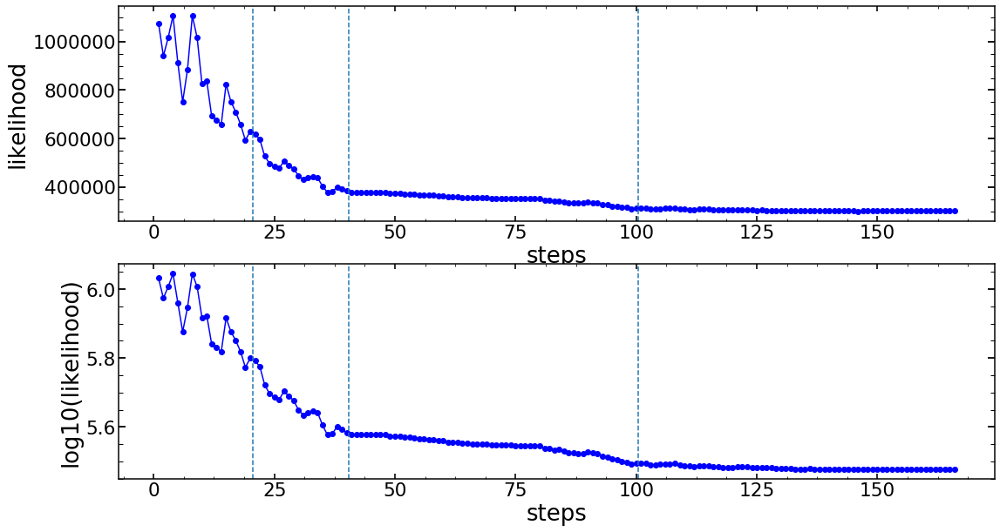

In [27]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [28]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-300243.34128625394

In [29]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

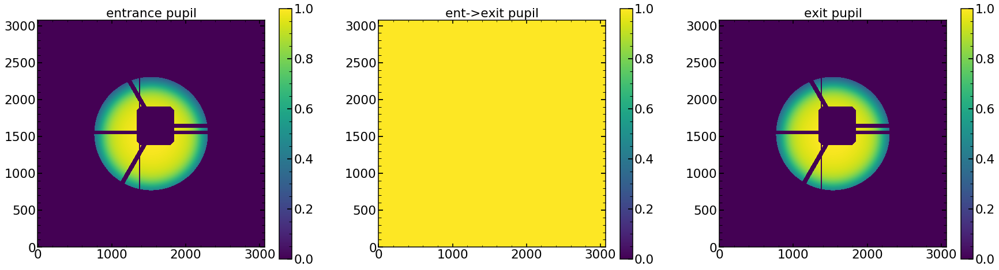

In [30]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

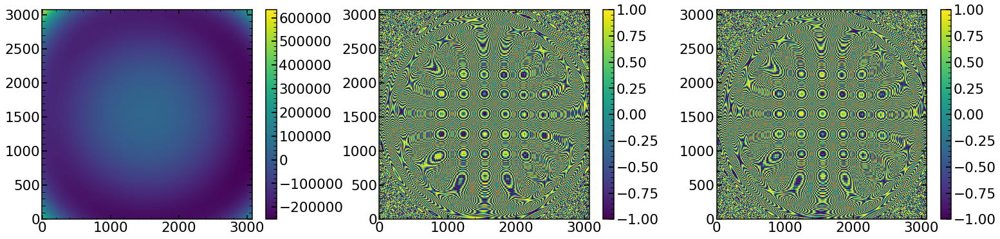

In [31]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

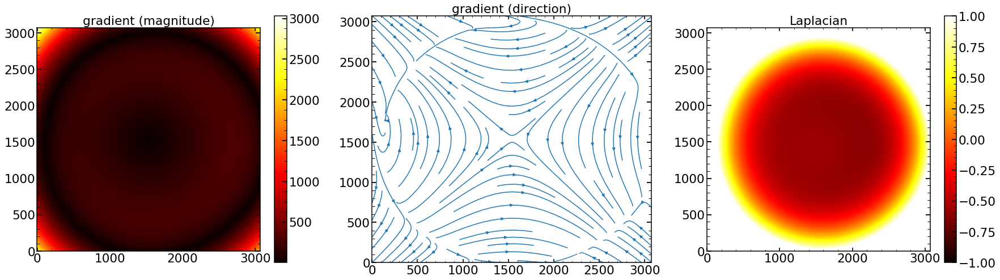

In [32]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

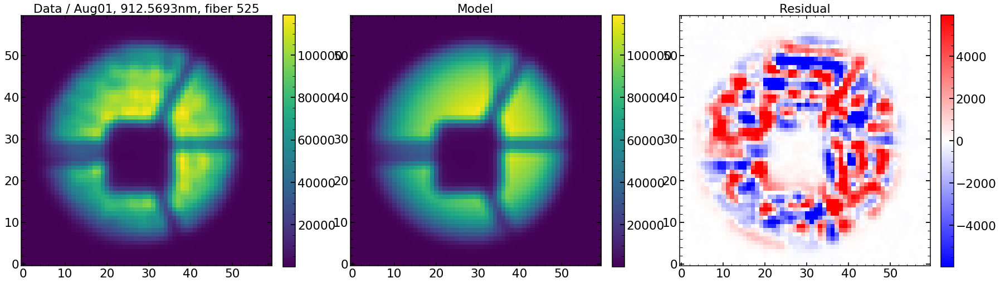

In [33]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 166.79627540750954
Abs of residual divided by total flux is: 0.053911288667753646
Abs of residual divided by largest value of a flux in the image is: 0.15939104848191504


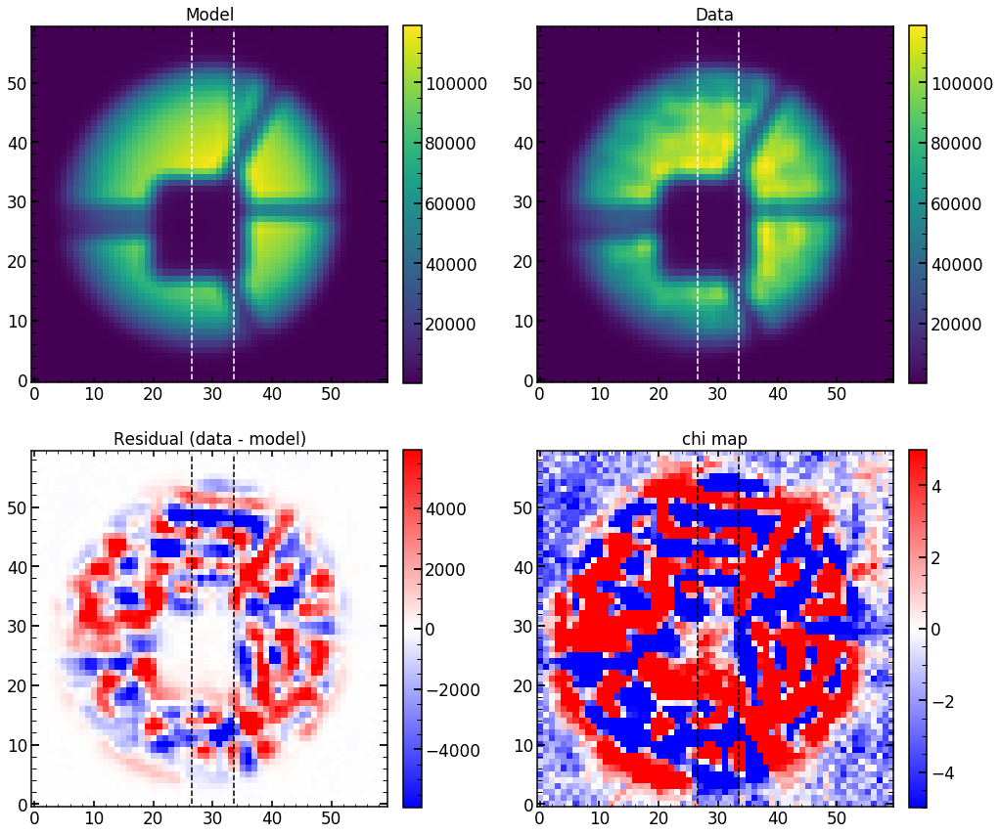

In [134]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

166.79627540750954
chi**2 reduced is: 166.79627540750954
Abs of residual divided by total flux is: 0.053911288667753646
Abs of residual divided by largest value of a flux in the image is: 0.15939104848191504


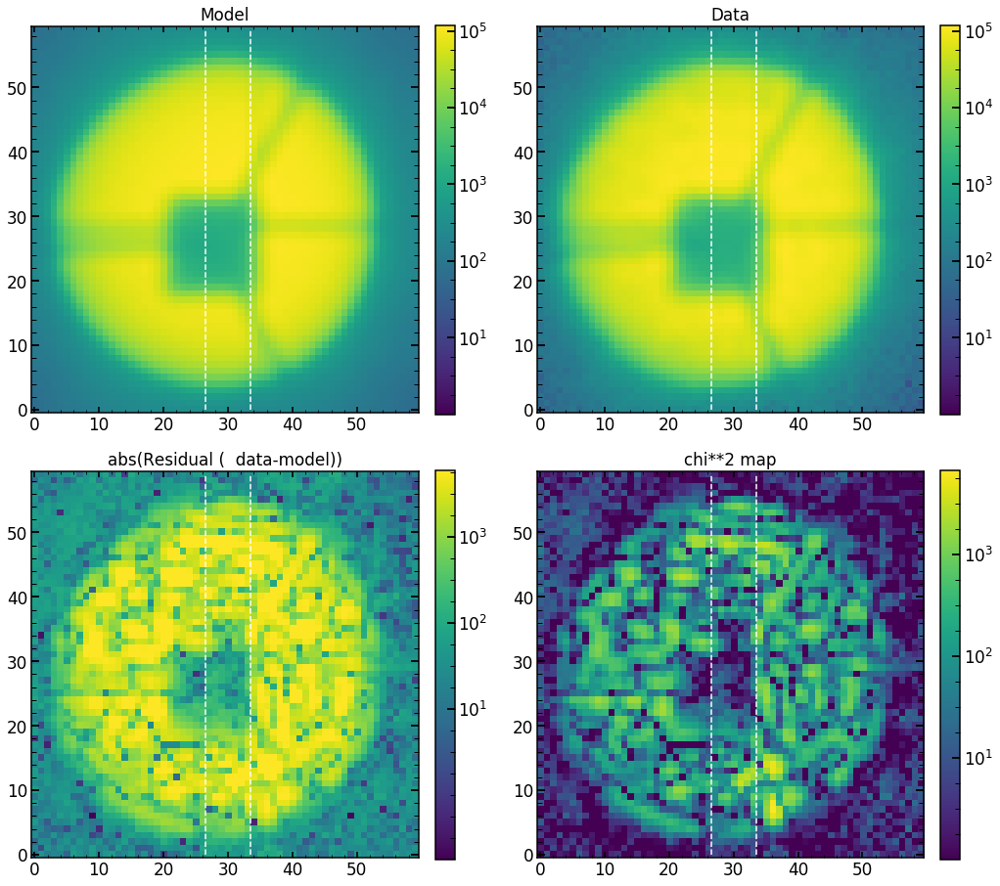

In [135]:
single_analysis.create_basic_comparison_plot_log()

166.79627540750954
chi**2 reduced is: 166.79627540750954
Abs of residual divided by total flux is: 0.053911288667753646
Abs of residual divided by largest value of a flux in the image is: 0.15939104848191504


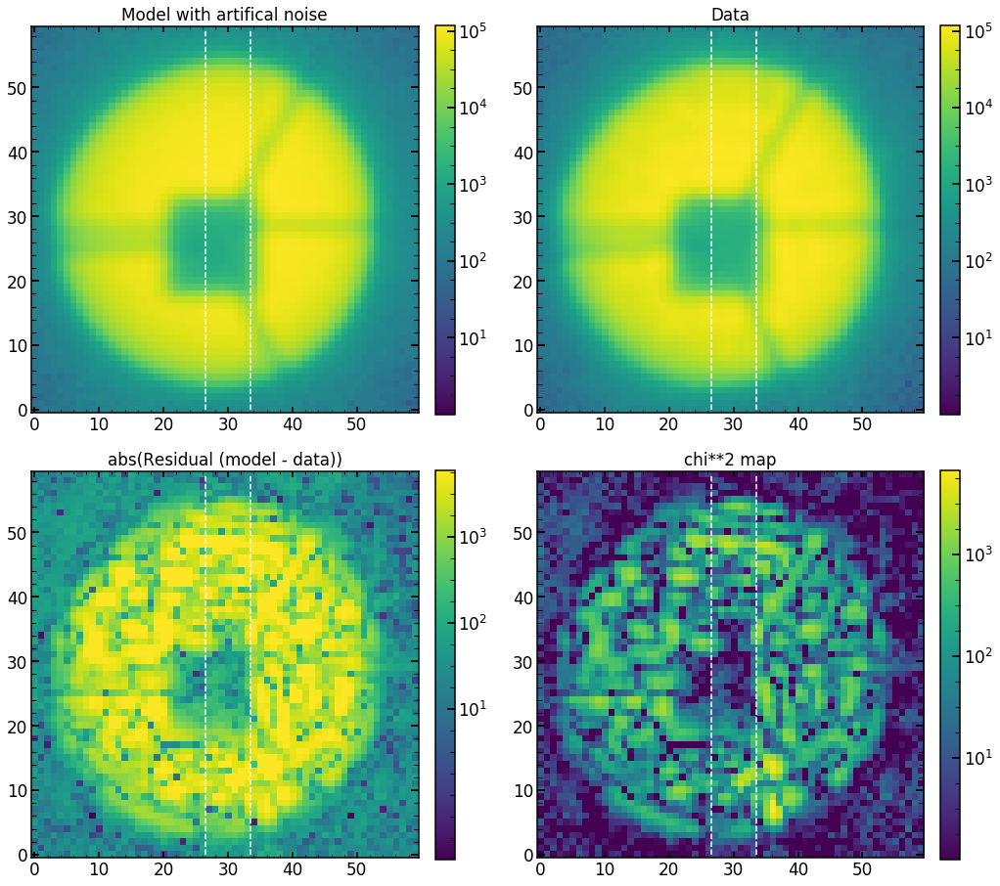

In [136]:
single_analysis.create_basic_comparison_plot_log_artifical()

## Creating results everywhere

In [137]:
#single_number_for_single_pos_full=np.load("/Users/nevencaplar/Documents/PFS/2017-12-15/single_number_for_single_pos_full.npy") 

finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019
date='Aug01'


results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)
err_results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

label=['m4','m35','m3','m25','m2','m15','m1','m05','0','0d','p05','p1','p15','p2','p25','p3','p35','p4','0p']

for single_number in range(1,len(finalHgAr)):
    # which date, which nubmer, which arc, how many z, which dataset    
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'HgAr',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,False,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_HgAr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_HgAr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_HgAr[label[i]]=results_of_fit_many_HgAr[label[i]][np.abs(results_of_fit_many_HgAr[label[i]]['z4'])>0]

22
1 obs (Emcee3): 17023 is found!
y_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17029 is found!
1 obs (Emcee3): 17035 is found!
x_ilum: failed!
x_ilum: failed!
1 17041 HgAr is NOT found or failed!
1 17047 HgAr is NOT found or failed!
1 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 17059 HgAr is NOT found or failed!
1 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
1 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExpone

radiometricExponent: failed!
9 obs (Emcee3): 17029 is found!
x_ilum: failed!
x_ilum: failed!
9 obs (Emcee3): 17035 is found!
9 17041 HgAr is NOT found or failed!
9 17047 HgAr is NOT found or failed!
9 obs (Emcee3): 17053 is found!
9 17059 HgAr is NOT found or failed!
9 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
9 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
9 17083 HgAr is NOT found or failed!
9 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
9 17095 HgAr is NOT found or failed!
9 17101 HgAr is NOT found or failed!

15 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 17083 HgAr is NOT found or failed!
15 17089 HgAr is NOT found or failed!
15 17095 HgAr is NOT found or failed!
15 17101 HgAr is NOT found or failed!
15 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 obs (Emcee3): 17113 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
15 obs (Emcee3): 17119 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
15 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: 

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17059 HgAr is NOT found or failed!
23 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
radiometricExponent: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
radiometricExponent: failed!
23 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
radiometricExponent: failed!
23 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17083 HgAr is NOT found or failed!
23 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 17095 HgAr is NOT found or failed!
23 17101 HgAr is NOT found or failed!
23 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
23 obs (Emcee3): 17113 is found!
x_ilum: failed!


x_ilum: failed!
y_ilum: failed!
30 17059 HgAr is NOT found or failed!
30 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
30 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
30 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
30 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
30 17083 HgAr is NOT found or failed!
30 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
30 17095 HgAr is NOT found or failed!
30 17101 HgAr is NOT found or failed!
30 obs (Emcee3): 17107 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
30 obs (

x_ilum: failed!
y_ilum: failed!
37 17059 HgAr is NOT found or failed!
37 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
37 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
37 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
37 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
37 17083 HgAr is NOT found or failed!
37 17089 HgAr is NOT found or failed!
37 17095 HgAr is NOT found or failed!
37 17101 HgAr is NOT found or failed!
37 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
37 obs (Emcee3): 17113 is found!
ra

45 obs (Emcee3): 17029 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
45 obs (Emcee3): 17035 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
45 17041 HgAr is NOT found or failed!
45 17047 HgAr is NOT found or failed!
45 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
45 17059 HgAr is NOT found or failed!
45 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
45 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
45 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
45 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: f

x_ilum: failed!
y_ilum: failed!
51 17071 HgAr is NOT found or failed!
22
52 17023 HgAr is NOT found or failed!
52 17029 HgAr is NOT found or failed!
52 17035 HgAr is NOT found or failed!
52 17041 HgAr is NOT found or failed!
52 17047 HgAr is NOT found or failed!
52 17053 HgAr is NOT found or failed!
52 17059 HgAr is NOT found or failed!
52 17065 HgAr is NOT found or failed!
52 17071 HgAr is NOT found or failed!
52 17071 HgAr is NOT found or failed!
52 17077 HgAr is NOT found or failed!
52 17083 HgAr is NOT found or failed!
52 17089 HgAr is NOT found or failed!
52 17095 HgAr is NOT found or failed!
52 17101 HgAr is NOT found or failed!
52 17107 HgAr is NOT found or failed!
52 17113 HgAr is NOT found or failed!
52 17119 HgAr is NOT found or failed!
52 17071 HgAr is NOT found or failed!
22
53 17023 HgAr is NOT found or failed!
53 17029 HgAr is NOT found or failed!
53 17035 HgAr is NOT found or failed!
53 17041 HgAr is NOT found or failed!
53 17047 HgAr is NOT found or failed!
53 17053 HgA

x_ilum: failed!
y_ilum: failed!
59 17083 HgAr is NOT found or failed!
59 obs (Emcee3): 17089 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 17095 HgAr is NOT found or failed!
59 17101 HgAr is NOT found or failed!
59 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17113 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
59 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
59 17071 HgAr is NOT found or failed!
22
60 17023 HgAr is NOT found or failed!
60 17029 HgAr is NOT found or failed!
60 17035 HgAr is NOT found or failed!
60 17041 HgAr 

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 17041 HgAr is NOT found or failed!
66 17047 HgAr is NOT found or failed!
66 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 17059 HgAr is NOT found or failed!
66 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
66 17083 HgAr is NOT found or failed!
66 obs (Emce

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 17035 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
73 17041 HgAr is NOT found or failed!
73 17047 HgAr is NOT found or failed!
73 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 17059 HgAr is NOT found or failed!
73 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
73 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExp

radiometricExponent: failed!
81 obs (Emcee3): 17029 is found!
81 obs (Emcee3): 17035 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
81 17041 HgAr is NOT found or failed!
81 17047 HgAr is NOT found or failed!
81 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
radiometricExponent: failed!
81 17059 HgAr is NOT found or failed!
81 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
81 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
81 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
81 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
81 17083 HgAr is NOT found or failed!
81 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: f

x_ilum: failed!
y_ilum: failed!
87 17095 HgAr is NOT found or failed!
87 17101 HgAr is NOT found or failed!
87 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
87 obs (Emcee3): 17113 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
87 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
87 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
87 17071 HgAr is NOT found or failed!
22
88 17023 HgAr is NOT found or failed!
88 17029 HgAr is NOT found or failed!
88 17035 HgAr is NOT found or failed!
88 17041 HgAr is NOT found or failed!
88 17047 HgAr is NOT found or failed!
88 17053 HgAr is NOT found or failed!
88 17059 HgAr is NOT found or faile

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
95 17083 HgAr is NOT found or failed!
95obs (Emcee2): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
95 17095 HgAr is NOT found or failed!
95 17101 HgAr is NOT found or failed!
95 obs (Emcee3): 17107 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 17113 is found!
y_ilum: failed!
y_ilum: failed!
95 obs (Emcee3): 17119 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiomet

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17029 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17035 is found!
radiometricExponent: failed!
radiometricExponent: failed!
102 17041 HgAr is NOT found or failed!
102 17047 HgAr is NOT found or failed!
102 17053 HgAr is NOT found or failed!
102 17059 HgAr is NOT found or failed!
102 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
102 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_il

radiometricExponent: failed!
109 obs (Emcee3): 17029 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
109 obs (Emcee3): 17035 is found!
x_ilum: failed!
x_ilum: failed!
109 17041 HgAr is NOT found or failed!
109 17047 HgAr is NOT found or failed!
109 obs (Emcee3): 17053 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
109 17059 HgAr is NOT found or failed!
109 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
109 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
109 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
109 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum

117 obs (Emcee3): 17029 is found!
117 obs (Emcee3): 17035 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
117 17041 HgAr is NOT found or failed!
117 17047 HgAr is NOT found or failed!
117 obs (Emcee3): 17053 is found!
117 17059 HgAr is NOT found or failed!
117 obs (Emcee3): 17065 is found!
x_ilum: failed!
x_ilum: failed!
117 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
117 obs (Emcee3): 17071 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
117 obs (Emcee3): 17077 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
117 17083 HgAr is NOT found or failed!
117 obs (Emcee3): 17089 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
117 17095 HgAr is NOT found or failed!
117 171

In [138]:
results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)
err_results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Ne)


results_of_fit_many_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

for single_number in range(len(finalNe)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'Ne',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'Ne',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Ne[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Ne[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Ne[label[i]]=results_of_fit_many_Ne[label[i]][np.abs(results_of_fit_many_Ne[label[i]]['z4'])>0]

22
0 16244 Ne is NOT found or failed!
0 16250 Ne is NOT found or failed!
0 16256 Ne is NOT found or failed!
0 16262 Ne is NOT found or failed!
0 16268 Ne is NOT found or failed!
0 16274 Ne is NOT found or failed!
0 16280 Ne is NOT found or failed!
0 16286 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
0 16298 Ne is NOT found or failed!
0 16304 Ne is NOT found or failed!
0 16310 Ne is NOT found or failed!
0 16316 Ne is NOT found or failed!
0 16322 Ne is NOT found or failed!
0 16328 Ne is NOT found or failed!
0 16334 Ne is NOT found or failed!
0 16340 Ne is NOT found or failed!
0 16292 Ne is NOT found or failed!
22
1 16244 Ne is NOT found or failed!
1 16250 Ne is NOT found or failed!
1 16256 Ne is NOT found or failed!
1 16262 Ne is NOT found or failed!
1 16268 Ne is NOT found or failed!
1 16274 Ne is NOT found or failed!
1 16280 Ne is NOT found or failed!
1 16286 Ne is NOT found or failed!
1 16292 Ne is NOT found or failed!
1 16292 Ne is 

x_ilum: failed!
scattering_amplitude: failed!
11 obs (Emcee3): 16250 is found!
11 obs (Emcee3): 16256 is found!
z8: failed!
z8: failed!
11 16262 Ne is NOT found or failed!
11 16268 Ne is NOT found or failed!
11 obs (Emcee3): 16274 is found!
11 16280 Ne is NOT found or failed!
11 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
radiometricExponent: failed!
11 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
radiometricExponent: failed!
11 obs (Emcee3): 16298 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 16304 Ne is NOT found or failed!
11 obs (Emcee3): 16310 is found!
11 16316 Ne is NOT found or failed!
11 16322 Ne is NOT found or failed!
11 obs (Emcee3): 16328 is found!
z8: failed!
x_ilum: failed!
z8: failed!
x_ilum: failed!
1

slitFrac_dy: failed!
20 obs (Emcee3): 16250 is found!
20 obs (Emcee3): 16256 is found!
slitHolder_frac_dx: failed!
pixel_effect: failed!
slitHolder_frac_dx: failed!
pixel_effect: failed!
20 16262 Ne is NOT found or failed!
20 16268 Ne is NOT found or failed!
20 obs (Emcee3): 16274 is found!
y_ilum: failed!
y_ilum: failed!
20 16280 Ne is NOT found or failed!
20 obs (Emcee3): 16286 is found!
y_ilum: failed!
y_ilum: failed!
20 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
20 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
20 obs (Emcee3): 16298 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
20 16304 Ne is NOT found or failed!
20 obs (Emcee3): 16310 is found!
radiometricExponent: failed!
x_ilum: fail

29 obs (Emcee3): 16250 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
29 obs (Emcee3): 16256 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
29 16262 Ne is NOT found or failed!
29 16268 Ne is NOT found or failed!
29 obs (Emcee3): 16274 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
29 16280 Ne is NOT found or failed!
29 obs (Emcee3): 16286 is found!
29 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
radiometricExponent: failed!
29 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
radiometricExponent: failed!
29 obs (Emcee3): 16298 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
29 16304 Ne is NOT found or failed!
29 obs (Emcee3): 16310 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
29 16316 Ne is NOT found or failed!
29 16322 N

38 obs (Emcee3): 16250 is found!
38 obs (Emcee3): 16256 is found!
38 16262 Ne is NOT found or failed!
38 16268 Ne is NOT found or failed!
38 16274 Ne is NOT found or failed!
38 16280 Ne is NOT found or failed!
38 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
38 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
38 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
38 obs (Emcee3): 16298 is found!
y_ilum: failed!
y_ilum: failed!
38 16304 Ne is NOT found or failed!
38 16310 Ne is NOT found or failed!
38 16316 Ne is NOT found or failed!
38 16322 Ne is NOT found or failed!
38 obs (Emcee3): 16328 is found!
radiometricExponent: failed!
radiometricExponent: failed!
38 obs (Emcee3): 16334 is found!
slitFrac_dy: failed!
frd

radiometricExponent: failed!
det_vert: failed!
strutFrac: failed!
radiometricExponent: failed!
det_vert: failed!
47 obs (Emcee3): 16250 is found!
radiometricExponent: failed!
radiometricExponent: failed!
47 obs (Emcee3): 16256 is found!
47 16262 Ne is NOT found or failed!
47 16268 Ne is NOT found or failed!
47 obs (Emcee3): 16274 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 16280 Ne is NOT found or failed!
47 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
47 obs (Emcee3): 16298 is found!
ra

56 obs (Emcee3): 16250 is found!
56 obs (Emcee3): 16256 is found!
56 16262 Ne is NOT found or failed!
56 16268 Ne is NOT found or failed!
56 16274 Ne is NOT found or failed!
56 16280 Ne is NOT found or failed!
56 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
56 obs (Emcee3): 16292 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
56 obs (Emcee3): 16292 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
56 obs (Emcee3): 16298 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
56 16304 Ne is NOT found or failed!
56 16310 Ne is NOT found or failed!
56 16316 Ne is NOT found or failed!
56 16322 Ne is NOT found or failed!
56 obs (Emcee3): 16328 is found!
x_ilum: failed!
x_ilum: failed!
56 obs (Emcee3): 16334 is found!
56 obs (Emcee3): 16340 is found!
56 obs (Emcee3): 16292 is found!
x_ilum: failed!
y_ilum: failed!
x_il

y_ilum: failed!
y_ilum: failed!
65 obs (Emcee3): 16250 is found!
z4: failed!
radiometricExponent: failed!
scattering_amplitude: failed!
z4: failed!
radiometricExponent: failed!
scattering_amplitude: failed!
65 obs (Emcee3): 16256 is found!
slitFrac_dy: failed!
slitFrac_dy: failed!
65 16262 Ne is NOT found or failed!
65 16268 Ne is NOT found or failed!
65 obs (Emcee3): 16274 is found!
hscFrac: failed!
x_ilum: failed!
fiber_r: failed!
hscFrac: failed!
x_ilum: failed!
fiber_r: failed!
65 16280 Ne is NOT found or failed!
65 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
65 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
65 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
65 obs (Emcee3): 16298 is found!
radiometricExponent: failed!
x_ilum: failed

radiometricExponent: failed!
radiometricExponent: failed!
74 obs (Emcee3): 16250 is found!
74 obs (Emcee3): 16256 is found!
74 16262 Ne is NOT found or failed!
74 16268 Ne is NOT found or failed!
74 obs (Emcee3): 16274 is found!
radiometricExponent: failed!
y_ilum: failed!
pixel_effect: failed!
radiometricExponent: failed!
y_ilum: failed!
pixel_effect: failed!
74 16280 Ne is NOT found or failed!
74 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
74 obs (Emcee3): 16292 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
74 obs (Emcee3): 16292 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
74 obs (Emcee3): 16298 is found!
x_ilum: failed!
x_ilum: failed!
74 16304 Ne is NOT found or failed!
74 obs (Emcee3): 16310 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
74 16316 Ne is NOT found or 

83 obs (Emcee3): 16250 is found!
grating_lines: failed!
grating_lines: failed!
83 obs (Emcee3): 16256 is found!
z19: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
z19: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
83 16262 Ne is NOT found or failed!
83 16268 Ne is NOT found or failed!
83 obs (Emcee3): 16274 is found!
y_ilum: failed!
y_ilum: failed!
83 16280 Ne is NOT found or failed!
83 obs (Emcee3): 16286 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
83 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
83 obs (Emcee3): 16292 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
83 obs (Emcee3): 16298 is found!
x_ilum: failed!
x_ilum: failed!
83 16304 Ne is NOT found or failed!
83 obs (Emcee3): 16310 is fou

In [183]:
results_of_fit_many_single_defocus_Kr=pd.DataFrame(np.zeros((len(finalKr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr.index,columns=columns22_analysis)
err_results_of_fit_many_single_defocus_Kr=pd.DataFrame(np.zeros((len(finalKr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr.index,columns=columns22_analysis)

results_of_fit_many_single_defocus_Kr_pd=pd.DataFrame(results_of_fit_many_single_defocus_Kr)
err_results_of_fit_many_single_defocus_Kr_pd=pd.DataFrame(err_results_of_fit_many_single_defocus_Kr)


results_of_fit_many_Kr = {'m4': results_of_fit_many_single_defocus_Kr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Kr_pd.copy()}

for single_number in range(len(finalKr)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'Kr',22,2)
    solution_at_0=solution_at_0_and_plots(date,single_number,'Kr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,True,22)
    
    for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:
        #print(single_number,i)
        if len(results_of_fit_single)<=4:
            pass
        else:
            if i<18:
                results_of_fit_many_Kr[label[i]].at[single_number]=results_of_fit_single.iloc[i]    
            else:
                results_of_fit_many_Kr[label[18]].at[single_number]=np.concatenate((solution_at_0,np.array([1,1]))) 
            
for i in [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18]:        
    results_of_fit_many_Kr[label[i]]=results_of_fit_many_Kr[label[i]][np.abs(results_of_fit_many_Kr[label[i]]['z4'])>0]

22
0 17316 Kr is NOT found or failed!
0 17322 Kr is NOT found or failed!
0 17328 Kr is NOT found or failed!
0 17334 Kr is NOT found or failed!
0 17340 Kr is NOT found or failed!
0 17346 Kr is NOT found or failed!
0 17352 Kr is NOT found or failed!
0 17358 Kr is NOT found or failed!
0 17364 Kr is NOT found or failed!
0 17364 Kr is NOT found or failed!
0 17370 Kr is NOT found or failed!
0 17376 Kr is NOT found or failed!
0 17382 Kr is NOT found or failed!
0 17388 Kr is NOT found or failed!
0 17394 Kr is NOT found or failed!
0 17400 Kr is NOT found or failed!
0 17406 Kr is NOT found or failed!
0 17412 Kr is NOT found or failed!
0 17364 Kr is NOT found or failed!
22
1 17316 Kr is NOT found or failed!
1 17322 Kr is NOT found or failed!
1 17328 Kr is NOT found or failed!
1 17334 Kr is NOT found or failed!
1 17340 Kr is NOT found or failed!
1 17346 Kr is NOT found or failed!
1 17352 Kr is NOT found or failed!
1 17358 Kr is NOT found or failed!
1 17364 Kr is NOT found or failed!
1 17364 Kr is 

11 obs (Emcee3): 17322 is found!
11 obs (Emcee3): 17328 is found!
11 17334 Kr is NOT found or failed!
11 17340 Kr is NOT found or failed!
11 obs (Emcee3): 17346 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 17352 Kr is NOT found or failed!
11 obs (Emcee3): 17358 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
11 obs (Emcee3): 17364 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 17364 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 obs (Emcee3): 17370 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
11 17376 Kr is NOT found or failed!
11 obs (Emcee3): 17382 is found!
radiometricExp

radiometricExponent: failed!
19 obs (Emcee3): 17406 is found!
19 obs (Emcee3): 17412 is found!
radiometricExponent: failed!
radiometricExponent: failed!
19 obs (Emcee3): 17364 is found!
x_ilum: failed!
x_ilum: failed!
19 17364 Kr is NOT found or failed!
22
20 17316 Kr is NOT found or failed!
20 17322 Kr is NOT found or failed!
20 17328 Kr is NOT found or failed!
20 17334 Kr is NOT found or failed!
20 17340 Kr is NOT found or failed!
20 17346 Kr is NOT found or failed!
20 17352 Kr is NOT found or failed!
20 17358 Kr is NOT found or failed!
20 17364 Kr is NOT found or failed!
20 17364 Kr is NOT found or failed!
20 17370 Kr is NOT found or failed!
20 17376 Kr is NOT found or failed!
20 17382 Kr is NOT found or failed!
20 17388 Kr is NOT found or failed!
20 17394 Kr is NOT found or failed!
20 17400 Kr is NOT found or failed!
20 17406 Kr is NOT found or failed!
20 17412 Kr is NOT found or failed!
20 17364 Kr is NOT found or failed!
22
21 17316 Kr is NOT found or failed!
21 17322 Kr is NOT f

radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
27 obs (Emcee3): 17406 is found!
radiometricExponent: failed!
x_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
27 obs (Emcee3): 17412 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
27 obs (Emcee3): 17364 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
27 17364 Kr is NOT found or failed!
22
28 17316 Kr is NOT found or failed!
28 17322 Kr is NOT found or failed!
28 17328 Kr is NOT found or failed!
28 17334 Kr is NOT found or failed!
28 17340 Kr is NOT found or failed!
28 17346 Kr is NOT found or failed!
28 17352 Kr is NOT found or failed!
28 17358 Kr is NOT found or failed!
28 17364 Kr is NOT found or failed!
28 17364 Kr is NOT found or failed!
28 17370 Kr is NOT found or failed!
28 17376 Kr is NOT found or failed!
28 17382 Kr is NOT found or failed!
28 17388 Kr is NOT found or failed!
28 17394 Kr is NOT fo

slitFrac_dy: failed!
radiometricExponent: failed!
39 obs (Emcee3): 17322 is found!
x_ilum: failed!
x_ilum: failed!
39 obs (Emcee3): 17328 is found!
39 17334 Kr is NOT found or failed!
39 17340 Kr is NOT found or failed!
39 obs (Emcee3): 17346 is found!
radiometricExponent: failed!
y_ilum: failed!
radiometricExponent: failed!
y_ilum: failed!
39 17352 Kr is NOT found or failed!
39 obs (Emcee3): 17358 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17364 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17364 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
39 obs (Emcee3): 17370 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
39 17376 Kr is NOT found or failed!
39 17382 Kr is NOT found or failed!
39 17388 Kr is NOT found or failed!
39 17394 

In [184]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
   
labels_with_data_Kr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Kr[label[i]])>5:
        labels_with_data_Kr.append(i)

labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne+labels_with_data_Kr)

In [185]:
pd.reset_option("display.max_rows")
import pickle
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Aug010119/'
if not os.path.exists(DATAFRAMES_FOLDER):
    os.makedirs(DATAFRAMES_FOLDER )

with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Kr_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_Kr,f, protocol=pickle.HIGHEST_PROTOCOL)

In [186]:
# plot the results of the interpolation
zMax=22
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Aug01'
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocu that we have analyzed

for j in tqdm(labels_with_data):
    # i runs through all the parameters
    for i in range(0,len(descriptions)):

        # take values for HgAr
        x_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr.loc[results_of_fit_many_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe.loc[results_of_fit_many_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_Ne[label[j]][descriptions[i]])
        
        # take values for Krypton        
        x_Kr=finalKr.loc[results_of_fit_many_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Kr=finalKr.loc[results_of_fit_many_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Kr=np.array(results_of_fit_many_Kr[label[j]][descriptions[i]])        
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne,x_Kr))
        y=np.concatenate((y_HgAr,y_Ne,y_Kr))    
        colors= np.concatenate((values_HgAr,values_Ne,values_Kr))
        

        
        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1  

        plt.scatter(x_HgAr, y_HgAr, s=np.pi * (14 * 1)**2, c=values_HgAr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='o')
        plt.scatter(x_Ne, y_Ne, s=np.pi * (10 * 1)**2, c=values_Ne, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='s')
        plt.scatter(x_Kr, y_Kr, s=np.pi * (14 * 1)**2, c=values_Kr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='p')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+': '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()

100%|██████████| 12/12 [04:51<00:00, 24.30s/it]


<Figure size 864x720 with 0 Axes>

## Creation of prediction for the fit and verification

In [198]:
from scipy.optimize import curve_fit

def lin_fit_2D(x_y, a, b,c):
    x=x_y[:,0]
    y=x_y[:,1]
    return a * x + b*y+c

def lin_fit_3D(dz_dx_dy, a, b,c,d):
    z=dz_dx_dy[:,0]
    x=dz_dx_dy[:,1]
    y=dz_dx_dy[:,2]
    return a * z + b*x+c*y+d


def func(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]


def funcz4(x,a1,a2,b1,b2,c1,d,a1b1,a1c1,b1c1,c2):
    ''' 
    a1, a2 - connected with x
    b1, b2 - connected with y
    c1 - connected with z (defocus)
    d - overal factor
    a1b1-xy
    a1c1 -xz
    b1c1 -yz
    
    '''
    return a1*x[0]+a2*x[0]**2+b1*x[1]+b2*x[1]**2+c1*x[2]+c2*x[2]**2+d+a1b1*x[0]*x[1]+a1c1*x[0]*x[2]+b1c1*x[1]*x[2]

#def func(x, a1,a2,a3,a4,a5,b1,b2,b3,b4,b5,c):
#    return np.polynomial.chebyshev.chebval(x[0],[a1,a2,a3,a4,a5])+np.polynomial.chebyshev.chebval(x[1],[b1,b2,b3,b4,b5])+c

#popt1, pcov = curve_fit(func, np.transpose(res_convolving_array1[:,[0,1]]), 10/4*res_convolving_array1[:,2])



label_short=['m4','m35','m3','m15','m05','0d','0','p05','p15','p3','p35','p4']
label_defocus=['m4','m35','m3','m15','p15','p3','p35','p4']
label_focus=['m05','0d','0','p05']
label_focus_focus=['0']
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
mm=np.array([-4. , -3.5, -3. , -2.5, -2. , -1.5, -1. , -0.5, -0. , -0. ,  0.5,
        1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4.,0 ])

In [199]:
results_of_fit_many_single_defocus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_defocus_HgAr)

results_of_fit_many_single_defocus_Ne=pd.DataFrame(np.zeros((len(finalNe),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_Ne_pd=pd.DataFrame(results_of_fit_many_single_defocus_Ne)

results_of_fit_many_single_defocus_Kr=pd.DataFrame(np.zeros((len(finalKr),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr.index,columns=columns22_analysis)
results_of_fit_many_single_defocus_Kr_pd=pd.DataFrame(results_of_fit_many_single_defocus_Kr)

In [200]:
results_of_fit_many_interpolation_HgAr = {'m4': results_of_fit_many_single_defocus_HgAr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_HgAr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_HgAr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_HgAr_pd.copy()}

results_of_fit_many_interpolation_Ne = {'m4': results_of_fit_many_single_defocus_Ne_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Ne_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Ne_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Ne_pd.copy()}

results_of_fit_many_interpolation_Kr = {'m4': results_of_fit_many_single_defocus_Kr_pd.copy(), 
                       'm35' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm3' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm25' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm2' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm15' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm1' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'm05' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       '0d' :  results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p05' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p1' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p15': results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p2' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p25' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p3' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                       'p35' : results_of_fit_many_single_defocus_Kr_pd.copy(),
                        'p4' :results_of_fit_many_single_defocus_Kr_pd.copy(),
                      '0p' :results_of_fit_many_single_defocus_Kr_pd.copy()}


# find coordinates of all spots on the detector
all_x_HgAr=finalHgAr['xc_effective']
all_y_HgAr=finalHgAr['yc']

all_x_Ne=finalNe['xc_effective']
all_y_Ne=finalNe['yc']

all_x_Kr=finalKr['xc_effective']
all_y_Kr=finalKr['yc']

# detector is 4096 pixels in x direction and 4176 in y direction
all_x_HgAr_in_respect_to_center=all_x_HgAr-int((4096+69)/2)
all_y_HgAr_in_respect_to_center=all_y_HgAr-int(4176/2)

all_x_Ne_in_respect_to_center=all_x_Ne-int((4096+69)/2)
all_y_Ne_in_respect_to_center=all_y_Ne-int(4176/2)

all_x_Kr_in_respect_to_center=all_x_Kr-int((4096+69)/2)
all_y_Kr_in_respect_to_center=all_y_Kr-int(4176/2)

In [201]:
single_selection_Ne_index

array([ 5,  6, 11, 14, 15, 16, 20, 23, 24, 29, 32, 33, 38, 41, 42, 47, 50,
       51, 56, 59, 60, 65, 68, 69, 74, 77, 78, 83, 86, 87, 88])

In [202]:
zMax=22

if zMax==11:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx',\
                 'radiometricEffect','radiometricExponent','x_ilum','y_ilum']
else:
    labels_cont=['z5','z6','z7','z8','z9','z10','z11','z12','z13','z14','z15','z16','z17','z18','z19','z20','z21','z22','hscFrac','effective_radius_illumination',\
                 'strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert','slitHolder_frac_dx','radiometricEffect','radiometricExponent','x_ilum','y_ilum']


single_parameter=[]
for j in labels_cont:
    for i in label_defocus:

        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        # fibers 2 and 3 are too close and remove them from analysis - this is only the case for Feb data
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)          
        
        # no Kr data avaliable
        #single_selection_Kr_index=results_of_fit_many_Kr[i][j].index.values
        
        #########
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]      
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]    
        #single_selection_Kr=results_of_fit_many_Kr[i][j][single_selection_Kr_index]   
        #########
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values

        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values

        #single_selection_x_Kr=all_x_Kr_in_respect_to_center[single_selection_Kr.index.astype(int)]
        #single_selection_y_Kr=all_y_Kr_in_respect_to_center[single_selection_Kr.index.astype(int)]    
        #single_selection_z_Kr=np.full(len(single_selection_Kr),mm[label.index(i)])
        #single_selection_values_Kr=single_selection_Kr.values
        #########
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        #single_selection_array_Kr=np.transpose(np.array([single_selection_Kr.index,single_selection_x_Kr.values,single_selection_y_Kr.values,single_selection_z_Kr,single_selection_values_Kr]))         
        #########     
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        #single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne,single_selection_array_Kr))
        single_selection_array=single_selection_array_HgAr
        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy','det_vert']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-5*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))        
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))      
    elif j in ['slitHolder_frac_dx','x_ilum']:
        # I force to have no z-dependance and positive x dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[-0.000001,0,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        ##############
        # I am manually overiding the fit!!!!
        ##############
        #popt=[-3*10e-5,0,0,0,0,0,0,0,0]
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['y_ilum']:
        # I force to have no z-dependance and no x-dependence, only y dependence
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.0,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,0,0,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,np.inf,np.inf,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    elif j in ['effective_radius_illumination']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt)))     
        
    elif j in ['radiometricEffect','radiometricExponent']:
        # I force to have no z-dependance,no x and no y dependence
        # killing it at the moment
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0.000,0,0,0,0,0,0,0,0],
                                   bounds=([-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12,10e-12]))
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(func([2082,2088,1],*popt))) 
    else:     
        # 'z5','z6','z7','z8','z9','z10','z11'
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0])
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(func([2082,2088,mm[label.index(i)]],*popt)))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]        

        popt, pcov = curve_fit(func, xdata_selected, ydata_selected,p0=[0,0,0,0,0,0,0,0,0])        
    #########      
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
  
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Kr[i].at[:,j]=func([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)     
print('Done')

z5: [ 0.00002123 -0.00000002 -0.00003913  0.00000001 -0.00336173 -0.18541643
  0.00000025 -0.00016976 -0.0000028 ]
Value in center for z5: -0.6072815250153305
First fit for z5: [ 0.00002123 -0.00000002 -0.00003913  0.00000001 -0.00336173 -0.18541643
  0.00000025 -0.00016976 -0.0000028 ]
z6: [ 0.00000765  0.00000011 -0.00003309 -0.00000015  0.16022521 -0.36251154
  0.          0.00001463  0.00008751]
Value in center for z6: 0.9150299906460218
First fit for z6: [ 0.00000765  0.00000011 -0.00003309 -0.00000015  0.16022521 -0.36251154
  0.          0.00001463  0.00008751]
z7: [ 0.00000448 -0.00000003 -0.00027251  0.         -0.01398396  0.24934165
  0.          0.00000103 -0.00001227]
Value in center for z7: -0.543257497380955
First fit for z7: [ 0.00000448 -0.00000003 -0.00027251  0.         -0.01398396  0.24934165
  0.          0.00000103 -0.00001227]
z8: [-0.00037941 -0.00000001 -0.0000051   0.00000002  0.00479658 -0.24029537
  0.00000003  0.00001    -0.00000304]
Value in center for z8:

y_ilum: [-0.          0.          0.          0.          0.          0.94833753
 -0.         -0.          0.        ]
Value in center for y_ilum: 0.9483475220249171
Value in center for y_ilum: 0.9483475514583484
Done


In [203]:
single_parameter=[]
for j in ['z4']:
    for i in label_defocus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  

        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr.values,single_selection_y_HgAr.values,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne.values,single_selection_y_Ne.values,single_selection_z_Ne,single_selection_values_Ne]))         
        
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
        single_selection_array=single_selection_array_HgAr

        if i==label_short[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))

    if j in ['z4']:
        # I force to have no z-dependance
        popt, pcov = curve_fit(func, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[0,0,0,0,0,0,0,0,0],
                                   bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))
        
        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata
        
        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]
        #res_selected=res[np.logical_or((res<np.median(res)+2*np.std(res)),(res<np.median(res)-2*np.std(res))).astype(int)]
        
        popt, pcov = curve_fit(funcz4, xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float), ydata=single_parameter[:,4].astype(float),p0=[-0.0003,0,0,0,0,0,0,0,0,0])
        
        
        print(str(j)+': '+str(popt))
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,mm[label.index(i)]],*popt)))        
        print('Value in center for '+str(j)+': '+str(funcz4([2082,2088,0],*popt)))            
   
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=funcz4([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Ne[i].at[:,j]=funcz4([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        z=mm[label.index(i)]
        results_of_fit_many_interpolation_Kr[i].at[:,j]=funcz4([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)    

First fit for z4: [ 0.00019239  0.00000014  0.00000073 -0.0000001  -0.          0.55425006
  0.00000004  0.         -0.        ]
z4: [ 0.00019525  0.00000017  0.00003305  0.00000008 -7.70994629 -0.29441559
  0.         -0.0000323  -0.00009042  0.0200802 ]
Value in center for z4: -30.284816743357446
Value in center for z4: 1.2579277307095489


In [204]:
# parameters that vary as a function of fiber, sensitive in defocus - describing illumination of the pupil)
# we just select median value across all defocused measurments?

inerpolation_mean_par_dx=[]
for j in ['x_fiber','y_fiber','frd_sigma','frd_lorentz_factor']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]
    # dspot = number of fiber
    # fill the values
    for i in label_defocus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j])) 
            
            
            
    values=np.concatenate((values_HgAr,values_Ne))      
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)    

    # when I had only HgAr
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)    

    
    # taking median
    parameter_res=[]
    # number of fibers
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1
    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['fiber']
        dspot_Ne=finalNe['fiber']
        dspot_Kr=finalKr['fiber']
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])
        for l in range(len(dspot_Kr)):
            values_Kr.append(parameter_res[int(float(dspot_Kr[l]))])

            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr
        

In [205]:
# parameters that vary slowly across the pupil, sensitive in focus

single_parameter=[]
for j in ['scattering_slope','scattering_amplitude','pixel_effect','flux']:
    for i in label_focus:
        # fibers 2 and 3 are too close and remove them from analysis
        single_selection_HgAr_index=results_of_fit_many_HgAr[i][j].index.values
        #single_selection_HgAr_index_avaliable_without_2_3=finalHgAr_Feb2019[(finalHgAr_Feb2019['fiber']!='2')&(finalHgAr_Feb2019['fiber']!='3')].index.values
        #single_selection_HgAr_index=np.intersect1d(single_selection_HgAr_index_avaliable_without_2_3,single_selection_HgAr_index)  
        
        single_selection_Ne_index=results_of_fit_many_Ne[i][j].index.values
        #single_selection_Ne_index_avaliable_without_2_3=finalNe_Feb2019[(finalNe_Feb2019['fiber']!='2')&(finalNe_Feb2019['fiber']!='3')].index.values
        #single_selection_Ne_index=np.intersect1d(single_selection_Ne_index_avaliable_without_2_3,single_selection_Ne_index)       
        
        single_selection_HgAr=results_of_fit_many_HgAr[i][j][single_selection_HgAr_index]  
        single_selection_Ne=results_of_fit_many_Ne[i][j][single_selection_Ne_index]  
        
        single_selection_x_HgAr=all_x_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_y_HgAr=all_y_HgAr_in_respect_to_center[single_selection_HgAr.index.astype(int)]
        single_selection_z_HgAr=np.full(len(single_selection_HgAr),mm[label.index(i)])
        single_selection_values_HgAr=single_selection_HgAr.values
        
        single_selection_x_Ne=all_x_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]
        single_selection_y_Ne=all_y_Ne_in_respect_to_center[single_selection_Ne.index.astype(int)]    
        single_selection_z_Ne=np.full(len(single_selection_Ne),mm[label.index(i)])
        single_selection_values_Ne=single_selection_Ne.values
        
        single_selection_array_HgAr=np.transpose(np.array([single_selection_HgAr.index,single_selection_x_HgAr,single_selection_y_HgAr,single_selection_z_HgAr,single_selection_values_HgAr]))    
        single_selection_array_Ne=np.transpose(np.array([single_selection_Ne.index,single_selection_x_Ne,single_selection_y_Ne,single_selection_z_Ne,single_selection_values_Ne]))         
        
        # when we had only HgAr
        #single_selection_array=single_selection_array_HgAr
        single_selection_array=np.concatenate((single_selection_array_HgAr,single_selection_array_Ne))
       
        if i==label_focus[0]:
            single_parameter=single_selection_array
        else:
            single_parameter=np.vstack((single_parameter,single_selection_array))
    if j in ['pixel_effect']:
        # no z dependence, no dependence has to become stronger towards lower wavelengths
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-np.inf,-10e-12,-10e-12,-10e-12],[10e-12,10e-12,10e-12,10e-12,10e-12,np.inf,10e-12,10e-12,10e-12]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))
        
    else:
        # no z dependence
        popt, pcov = curve_fit(func, np.transpose(single_parameter[:,[1,2,3]]).astype(float), single_parameter[:,4].astype(float),
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-12,-np.inf,-np.inf,-10e-12,-10e-12],[np.inf,np.inf,np.inf,np.inf,10e-12,np.inf,np.inf,10e-12,10e-12]))

        xdata=np.transpose(single_parameter[:,[1,2,3]]).astype(float)
        ydata=single_parameter[:,4].astype(float)
        res=func(xdata,*popt)-ydata

        print('First fit for '+str(j)+': '+str(popt))
        selection_array=np.logical_and((res<np.median(res)+3*np.std(res)),(res>np.median(res)-3*np.std(res))).astype(int)
        xdata_selected=xdata[:,np.where(selection_array)[0]]
        ydata_selected=ydata[np.where(selection_array)[0]]      

        popt, pcov = curve_fit(func,  xdata_selected, ydata_selected,
                               bounds=([-np.inf,-np.inf,-np.inf,-np.inf,-10e-10,-np.inf,-np.inf,-10e-10,-10e-10],[np.inf,np.inf,np.inf,np.inf,10e-10,np.inf,np.inf,10e-10,10e-10]))

        print(str(j)+' '+str(popt))
        print('Value in center for '+str(j)+' :'+str(func([2082,2088,mm[label.index(i)]],*popt)))

    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=func([all_x_HgAr_in_respect_to_center,all_y_HgAr_in_respect_to_center,np.full(len(all_x_HgAr_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=func([all_x_Ne_in_respect_to_center,all_y_Ne_in_respect_to_center,np.full(len(all_x_Ne_in_respect_to_center),mm[label.index(i)])],*popt)
        
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=func([all_x_Kr_in_respect_to_center,all_y_Kr_in_respect_to_center,np.full(len(all_x_Kr_in_respect_to_center),mm[label.index(i)])],*popt)

First fit for scattering_slope: [ 0.00000956  0.          0.00005051 -0.00000001  0.          2.48134124
 -0.          0.          0.        ]
scattering_slope [ 0.00000761  0.          0.00005019 -0.00000001  0.          2.47970535
 -0.          0.          0.        ]
Value in center for scattering_slope :2.5604458501266514
First fit for scattering_amplitude: [ 0.00000019  0.          0.00000074  0.          0.          0.00257554
  0.         -0.         -0.        ]
scattering_amplitude [ 0.00000013  0.          0.00000061  0.          0.          0.002687
 -0.          0.         -0.        ]
Value in center for scattering_amplitude :0.006282119292507208
First fit for pixel_effect: [-0.         -0.          0.          0.          0.          0.37922827
 -0.          0.         -0.        ]
pixel_effect [-0.        -0.         0.         0.         0.         0.3735549
 -0.         0.        -0.       ]
Value in center for pixel_effect :0.37351167519030737
First fit for flux: [-0.

In [206]:
# factors depending on dy as a non-smooth function
# fits grating lines as a median value of grating value for a given wavelength for focus
inerpolation_mean_par_dy=[]
for j in ['grating_lines']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]
    
    
    # dspot = number of fiber
    # fill the values
    for i in label_focus_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['wavelength'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['wavelength'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['wavelength'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            

    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne))    
    
    #values=values_HgAr       
    #dspot=dspot_HgAr 
    
    
    parameter_res=[]
    for i in range(len(np.unique(dspot))):
        if len(values[dspot==np.unique(dspot)[i]])>1:
            print(np.unique(dspot)[i])
            print(values[dspot==np.unique(dspot)[i]])
            print(np.median(values[dspot==np.unique(dspot)[i]]))
            parameter_res.append(np.median(values[dspot==np.unique(dspot)[i]]))
        else:
            parameter_res.append(100000)
    parameter_res=np.array(parameter_res)                                   
    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['wavelength']
        dspot_Ne=finalNe['wavelength']
        dspot_Kr=finalKr['wavelength']     
        
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        
        for l in range(len(dspot_HgAr)):
            if np.sum((np.unique(dspot)==dspot_HgAr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_HgAr.append(100000)
            else:
                values_HgAr.append(parameter_res[(np.unique(dspot)==dspot_HgAr[l])][0])
        for l in range(len(dspot_Ne)):
            if np.sum((np.unique(dspot)==dspot_Ne[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Ne.append(100000)
            else:
                values_Ne.append(parameter_res[(np.unique(dspot)==dspot_Ne[l])][0])
        for l in range(len(dspot_Kr)):
            if np.sum((np.unique(dspot)==dspot_Kr[l]).astype(int))==0:
            #if it is not in array, i.e., has not been analyzed
                values_Kr.append(100000)
            else:
                values_Kr.append(parameter_res[(np.unique(dspot)==dspot_Kr[l])][0])
            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr

660.0668
[72334.19444947 65686.17966782 56670.00180918 60888.22649433
 73288.18401359 73638.66302899 58585.29461215 65007.45103999
 63677.74794838]
65007.4510399912
693.13116
[55432.87164156 64304.72628942 66455.12710874 61985.12341172
 47924.31185818 61924.13138818 62423.44570061 54430.89107374
 58877.73481916 59399.86362996]
60661.997509067194
696.7261
[103874.67351326 101796.96291243  87507.46839585  86592.46865359
  92155.99419273 121611.67298342 113760.28597895  81031.04890744
 121814.31079136  92086.03033661]
96976.4785525781
717.59015
[43568.37833105 52844.56101585 59776.62905963 54225.16169265
 52743.96210913 54856.35529953 58471.48846374 54169.3228876
 46653.62787816 50344.4771153 ]
53506.94195172607
724.72437
[116814.14285249  97219.95610777 109917.23003805]
109917.23003804663
727.47876
[78527.6943784  56784.85637394 55906.62610821 65532.41023822
 46002.55704429 51050.97731138 65941.85251252 81025.56723771
 77304.67536353]
65532.41023821874
795.0522
[ 92347.40947936  85866.78

In [207]:
# parameters that vary as a function of fiber, sensitive in focus

inerpolation_mean_par_dx=[]
for j in ['fiber_r']:
    dspot_HgAr=[]
    values_HgAr=[]
    dspot_Ne=[]
    values_Ne=[]
    dspot_Kr=[]
    values_Kr=[]    
    # dspot = number of fiber
    # fill the values
    for i in label_focus:
        if len(dspot_HgAr)==0:
            dspot_HgAr=finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]
            values_HgAr=results_of_fit_many_HgAr[i][j]
        else:
            dspot_HgAr=np.hstack((dspot_HgAr,finalHgAr['fiber'].loc[results_of_fit_many_HgAr[i][j].index]))
            values_HgAr=np.hstack((values_HgAr,results_of_fit_many_HgAr[i][j]))    
        if len(dspot_Ne)==0:
            dspot_Ne=finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]
            values_Ne=results_of_fit_many_Ne[i][j]
        else:
            dspot_Ne=np.hstack((dspot_Ne,finalNe['fiber'].loc[results_of_fit_many_Ne[i][j].index]))
            values_Ne=np.hstack((values_Ne,results_of_fit_many_Ne[i][j]))   
            
    values=np.concatenate((values_HgAr,values_Ne))       
    dspot=np.concatenate((dspot_HgAr,dspot_Ne)).astype(float).astype(int)
    
    #values=values_HgAr      
    #dspot=dspot_HgAr.astype(float).astype(int)
    
    
    # taking median
    parameter_res=[]
    # atm range 10
    number_of_fibers=int(np.max(dspot_HgAr.astype(float)))+1

    for i in range(number_of_fibers):
        if len(values[dspot==i])>1:
            parameter_res.append(np.median(values[dspot==i]))
        else:
            parameter_res.append(np.median(values))

    # filling the values back to interpolation pandas array
    dx=[]
    for i in label:
        dspot_HgAr=finalHgAr['fiber']
        dspot_Ne=finalNe['fiber']
        dspot_Kr=finalKr['fiber']
        
        values_HgAr=[]
        values_Ne=[]
        values_Kr=[]
        for l in range(len(dspot_HgAr)):
            values_HgAr.append(parameter_res[int(dspot_HgAr[l])])
        for l in range(len(dspot_Ne)):
            values_Ne.append(parameter_res[int(float(dspot_Ne[l]))])
        for l in range(len(dspot_Kr)):
            values_Kr.append(parameter_res[int(float(dspot_Kr[l]))])
            
    for i in label:
        results_of_fit_many_interpolation_HgAr[i].at[:,j]=values_HgAr
    for i in label:
        results_of_fit_many_interpolation_Ne[i].at[:,j]=values_Ne
    for i in label:
        results_of_fit_many_interpolation_Kr[i].at[:,j]=values_Kr

In [208]:
import pickle
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug010119/' + 'results_of_fit_many_interpolation_HgAr_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_HgAr,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug010119/' + 'results_of_fit_many_interpolation_Ne_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Ne,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug010119/' + 'results_of_fit_many_interpolation_Kr_from_Aug01.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_interpolation_Kr,f, protocol=pickle.HIGHEST_PROTOCOL)

### verification - not complete (rest in Zernike_Work_March)

In [171]:
labels_with_data_HgAr=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_HgAr[label[i]])>5:
        labels_with_data_HgAr.append(i)
        
labels_with_data_Ne=[]
for i in range(len(label[:-1])):
    if len(results_of_fit_many_Ne[label[i]])>5:
        labels_with_data_Ne.append(i)
        
labels_with_data=np.unique(labels_with_data_HgAr+labels_with_data_Ne)

In [173]:
# plot the results of the interpolation

from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Aug01'
descriptions=results_of_fit_many_HgAr[label[0]].columns
# j runs throught the amount of defocu that we have analyzed

for j in tqdm(labels_with_data):
    # i runs through all the parameters
    for i in range(0,len(descriptions)):

        # take values for HgAr
        x_HgAr=finalHgAr.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_HgAr=finalHgAr.loc[results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_HgAr=np.array(results_of_fit_many_interpolation_HgAr[label[j]][descriptions[i]])
        
        # take values for Neon        
        x_Ne=finalNe.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Ne=finalNe.loc[results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Ne=np.array(results_of_fit_many_interpolation_Ne[label[j]][descriptions[i]])
        
        # take values for Krypton        
        x_Kr=finalKr.loc[results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
        y_Kr=finalKr.loc[results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]].index.astype(int).ravel()]['yc'].values
        values_Kr=np.array(results_of_fit_many_interpolation_Kr[label[j]][descriptions[i]])        
        #x=x_HgAr
        #y=y_HgAr  
        #colors=values_HgAr
        
        # join these values
        x=np.concatenate((x_HgAr,x_Ne,x_Kr))
        y=np.concatenate((y_HgAr,y_Ne,y_Kr))    
        colors= np.concatenate((values_HgAr,values_Ne,values_Kr))
        

        
        if zMax==11:

            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[31,32])[0] == True:   
                max_colors=10
                min_colors=1

        else:
            # limits of color for z5-z11
            if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                    abs_max_colors=max(np.abs(colors))
                    max_colors=1
                    min_colors=-1 

            # limits for all other parameters    
            if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
                median_color=np.median(colors)
                up_limit=np.abs(max(colors)-median_color)
                low_limit=np.abs(min(colors)-median_color)
                max_dif=np.max([low_limit,up_limit])
                min_dif=np.min([low_limit,up_limit])
                max_colors=median_color+(min_dif+max_dif)/2
                min_colors=median_color-(min_dif+max_dif)/2

            #'chi2, chi2max'
            if np.in1d([i],[41,42])[0] == True:   
                max_colors=10
                min_colors=1  

        plt.scatter(x_HgAr, y_HgAr, s=np.pi * (12 * 1)**2, c=values_HgAr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='o')
        plt.scatter(x_Ne, y_Ne, s=np.pi * (8 * 1)**2, c=values_Ne, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='s')
        plt.scatter(x_Kr, y_Kr, s=np.pi * (12 * 1)**2, c=values_Kr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='p')
        plt.ylim(0,4176)
        plt.xlim(0,4096)
        plt.xlabel('x position on chip')
        plt.ylabel('y position on chip')
        plt.title(str(date)+' / '+'Interpolation: '+str(label[j])+" "+str(descriptions[i]))

        plt.colorbar()
        #plt.show()

        IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(label[j])+'/'
        IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/PlaneInterpolation/'+str(descriptions[i])+'/'
        if not os.path.exists(IMAGES_FOLDER1):
            os.makedirs(IMAGES_FOLDER1)
            print('Images are in folder: '+str(IMAGES_FOLDER1))
            
        if not os.path.exists(IMAGES_FOLDER2):
            os.makedirs(IMAGES_FOLDER2)
            print('Images are in folder: '+str(IMAGES_FOLDER2))
            
        plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
        plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
        plt.clf()


  0%|          | 0/12 [00:00<?, ?it/s]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/m4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z9/



Exception in thread Thread-7:
Traceback (most recent call last):
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/threading.py", line 916, in _bootstrap_inner
    self.run()
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/site-packages/tqdm/_tqdm.py", line 144, in run
    for instance in self.tqdm_cls._instances:
  File "/Users/nevencaplar/anaconda2/envs/py36/lib/python3.6/_weakrefset.py", line 60, in __iter__
    for itemref in self.data:
RuntimeError: Set changed size during iteration



Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z14/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z15/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z16/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z17/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z18/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/z19/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpo

  8%|▊         | 1/12 [00:24<04:31, 24.70s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/m35/


 17%|█▋        | 2/12 [00:49<04:05, 24.50s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/m3/


 25%|██▌       | 3/12 [01:14<03:42, 24.72s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/m15/


 33%|███▎      | 4/12 [01:38<03:16, 24.59s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/m05/


 42%|████▏     | 5/12 [02:01<02:50, 24.38s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/0d/


 50%|█████     | 6/12 [02:27<02:27, 24.53s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/0/


 58%|█████▊    | 7/12 [02:50<02:02, 24.41s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/p05/


 67%|██████▋   | 8/12 [03:16<01:38, 24.56s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/p15/


 75%|███████▌  | 9/12 [03:41<01:13, 24.62s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/p3/


 83%|████████▎ | 10/12 [04:05<00:49, 24.58s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/p35/


 92%|█████████▏| 11/12 [04:31<00:24, 24.65s/it]

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug01/PlaneInterpolation/p4/


100%|██████████| 12/12 [04:56<00:00, 24.71s/it]


<Figure size 864x720 with 0 Axes>

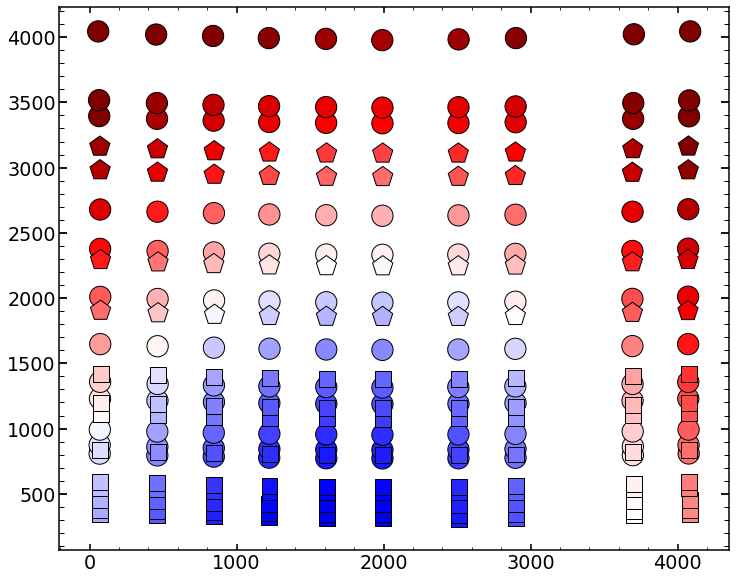

In [1357]:
        plt.scatter(x_HgAr, y_HgAr, s=np.pi * (12 * 1)**2, c=values_HgAr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='o')
        plt.scatter(x_Ne, y_Ne, s=np.pi * (8 * 1)**2, c=values_Ne, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='s')
        plt.scatter(x_Kr, y_Kr, s=np.pi * (12 * 1)**2, c=values_Kr, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black',marker='p')

# Aug 05 (focus, from direct)

## scripts 

In [223]:
DATAFRAMES_FOLDER='/Users/nevencaplar/Documents/PFS/Fit_Results/Aug010119/'

# where are the dataframe which we use to guess the initial solution
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_HgAr_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Ne_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_Ne=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_direct_Kr_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_direct_preDecemberrun_Kr=pickle.load(f)
    

# where are the dataframe which we use to guess the initial solution
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_HgAr_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_interpolation_preDecemberrun_HgAr=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_Ne_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_interpolation_preDecemberrun_Ne=pickle.load(f)
with open(DATAFRAMES_FOLDER + 'results_of_fit_many_interpolation_Kr_from_Aug01.pkl', 'rb') as f:
    results_of_fit_many_interpolation_preDecemberrun_Kr=pickle.load(f)

In [254]:
list_of_HgAr_to_analyze_10=np.array_split(results_of_fit_many_direct_preDecemberrun_HgAr['0p'].index.astype(int).values,8)

list_of_Ne_to_analyze_10=np.array_split(results_of_fit_many_direct_preDecemberrun_Ne['0p'].index.astype(int).values,6)

list_of_Kr_to_analyze_10=np.array_split(results_of_fit_many_direct_preDecemberrun_Kr['0p'].index.astype(int).values,2)

In [255]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T01'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [17071]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger01_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T01'+str(i)+'Aug_focus.sh \n')

file.close()

#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T02'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [16292]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger02_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T02'+str(i)+'Aug_focus.sh \n')

file.close()

#MPI
for i in range(len(list_of_Kr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T03'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Kr_to_analyze_10[i]:
        for obs in [17364]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI01_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Kr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger03_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Kr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T03'+str(i)+'Aug_focus.sh \n')

file.close()

## which images are avaliable 

In [18]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

In [19]:
import glob
date='Aug05'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)
Emcee3_Kr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5KrEmcee3.npy', recursive=True)

In [20]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
   
analyzed_Neon_images=np.array(analyzed_Neon_images)
###########
analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
 

analyzed_HgAr_images=np.array(analyzed_HgAr_images)
###########
analyzed_Kr_images=[]
for i in range(len(Emcee3_Kr)):
    single_string=Emcee3_Kr[i][90:len(Emcee3_Kr[i])-13]
    analyzed_Kr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Kr_images=np.array(analyzed_Kr_images)

In [21]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

arranged_by_defocus_Kr=analyzed_Kr_images[analyzed_Kr_images[:,0].argsort()]
arranged_by_spot_number_Kr=analyzed_Kr_images[analyzed_Kr_images[:,1].argsort()]

In [22]:
arranged_by_spot_number_Kr

array([[17364,     3],
       [17364,     7],
       [17364,    11],
       [17364,    15],
       [17364,    19],
       [17364,    23],
       [17364,    27],
       [17364,    31],
       [17364,    35],
       [17364,    39]])

## single analysis 

In [50]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


# add Kr   
date='Aug05'
obs=17364
single_number='31'
image_index=int(single_number)
eps=5
arc='Kr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    elif arc=="Kr":
        single_number_focus=17364  
    else:
        print("Not recognized arc-line")
        
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    if arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])
    if arc=='Kr':
         obs_possibilites=np.array([17310+6,17310+12,17310+18,17310+24,17310+30,17310+36,17310+42,17310+48,17310+54,17310+54,17310+60,17310+66,17310+72,17310+78,17310+84,17310+90,17310+96,17310+102,17310+54])

if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    elif arc=="Kr":
        finalArc=finalKr_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber              525
xc                2828
yc                3115
wavelength      892.87
close                1
lamp                Kr
xc_effective      2897
Name: 31, dtype: object

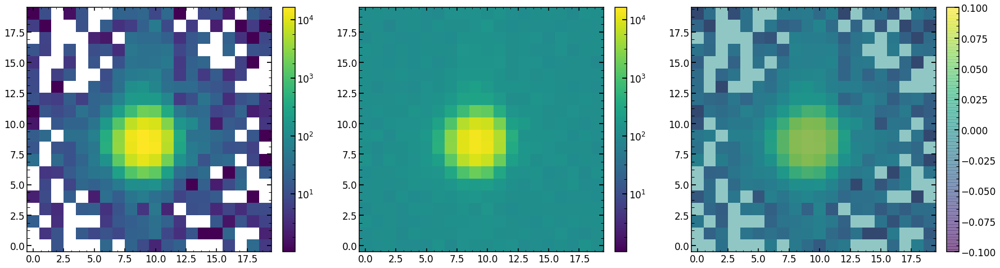

In [51]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(132)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(133)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
plt.imshow(mask_image,origin='lower',vmin=0,vmax=np.max(mask_image),alpha=0.5)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [52]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 564.9272462550338
minimal chi2 reduced is: 2.7895310389157224


In [53]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4        z5        z6        z7        z8        z9       z10  \
0  0.587354  0.288418 -0.546748  0.020821 -0.424296 -0.145625 -0.346655   

        z11  
0 -0.183964  
        z12       z13       z14       z15       z16       z17       z18  \
0 -0.032136 -0.049041  0.003438  0.026471 -0.012742  0.069362 -0.002055   

        z19       z20       z21  
0 -0.004563 -0.041273  0.034652  
        z22   hscFrac  strutFrac   dxFocal  dyFocal  slitFrac  slitFrac_dy  \
0  0.043207  0.665212   0.079853  0.068154   0.1253  0.060867     0.026456   

   radiometricEffect  radiometricExponent   x_ilum    ...     frd_sigma  \
0           0.000015             0.000015  0.97211    ...      0.070005   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.761975  1.035533           -0.261677    53276.59534   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.503669              0.002531          0.35  1.814276  0.

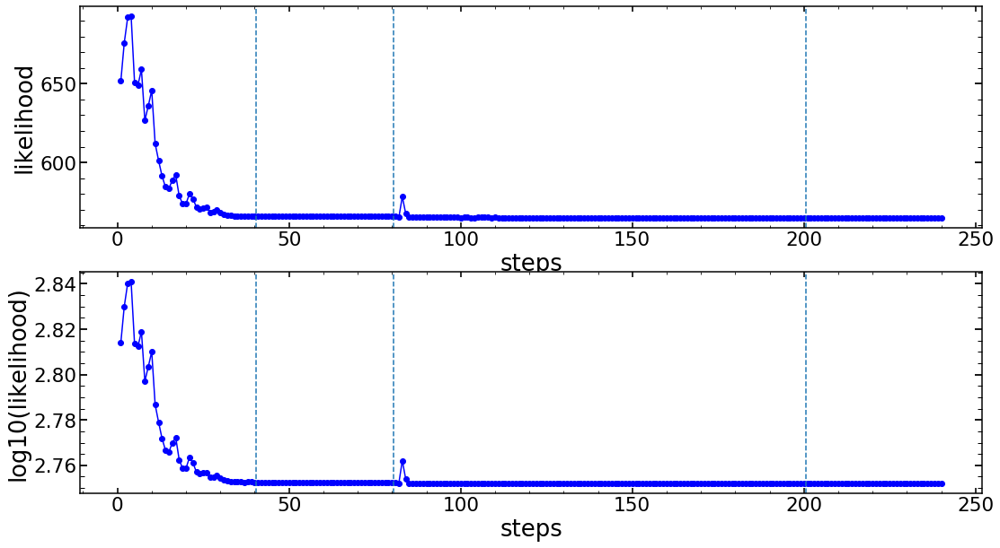

In [54]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [55]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42
None


-564.92724632491

In [56]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

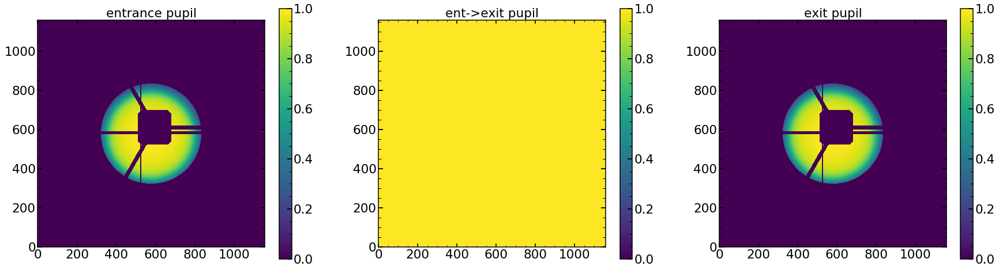

In [57]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

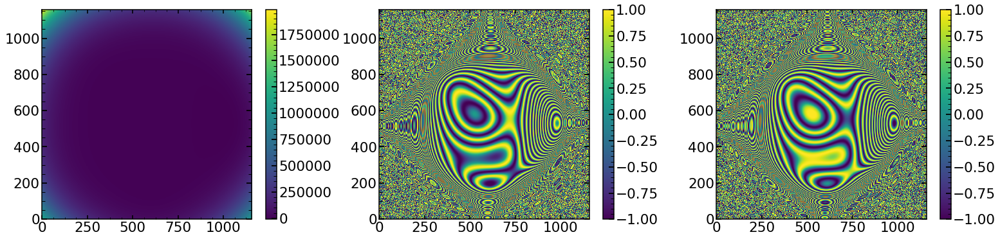

In [58]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

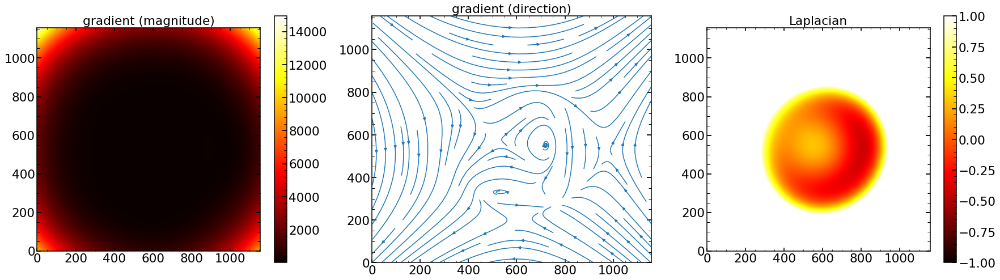

In [59]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

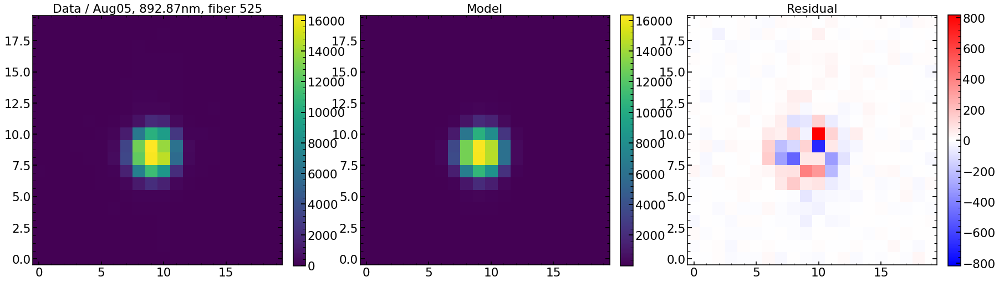

In [60]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

In [61]:
np.sum(sci_image)

183507.66

chi**2 reduced is: 2.7895310425871864
Abs of residual divided by total flux is: 0.055868113228108036
Abs of residual divided by largest value of a flux in the image is: 0.06369978518564386


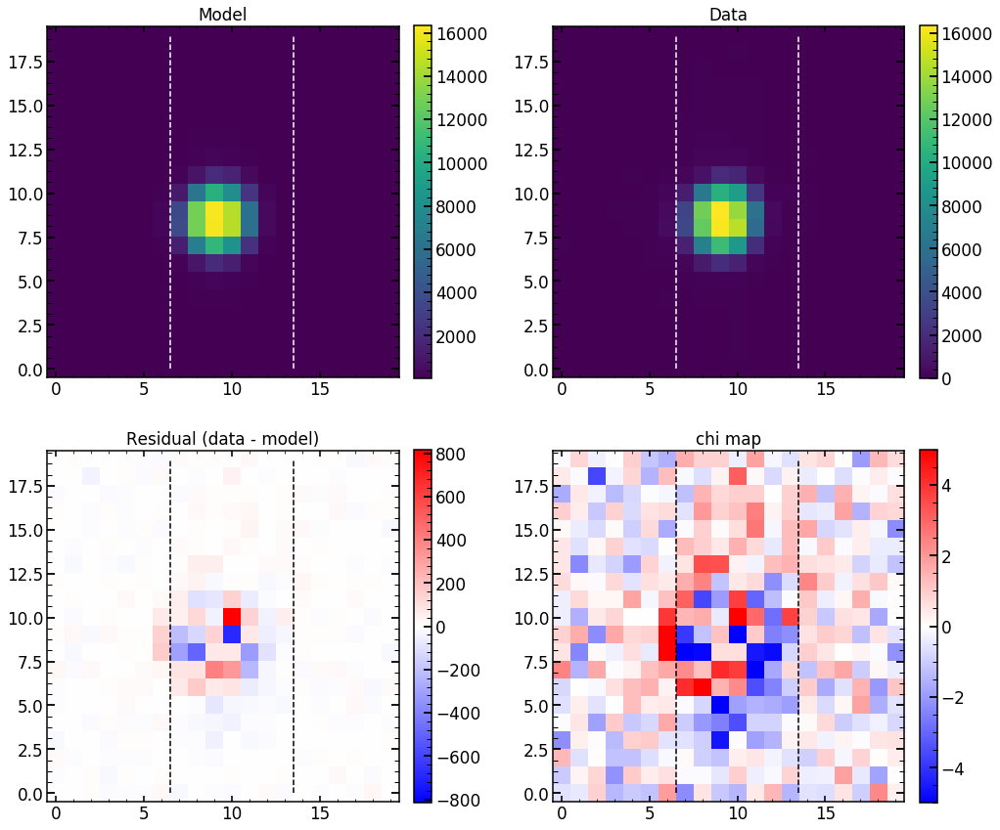

In [62]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

2.7895310425871864
chi**2 reduced is: 2.7895310425871864
Abs of residual divided by total flux is: 0.055868113228108036
Abs of residual divided by largest value of a flux in the image is: 0.06369978518564386


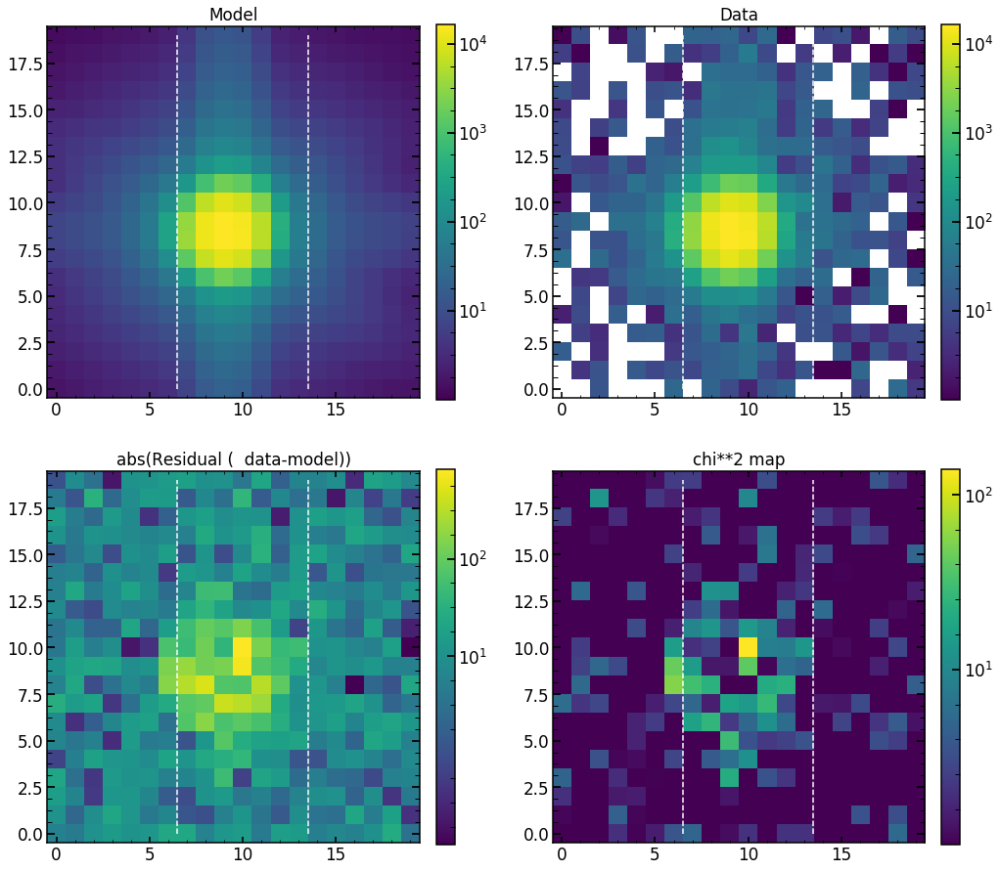

In [63]:
single_analysis.create_basic_comparison_plot_log()

2.7895310425871864
chi**2 reduced is: 2.7895310425871864
Abs of residual divided by total flux is: 0.055868113228108036
Abs of residual divided by largest value of a flux in the image is: 0.06369978518564386


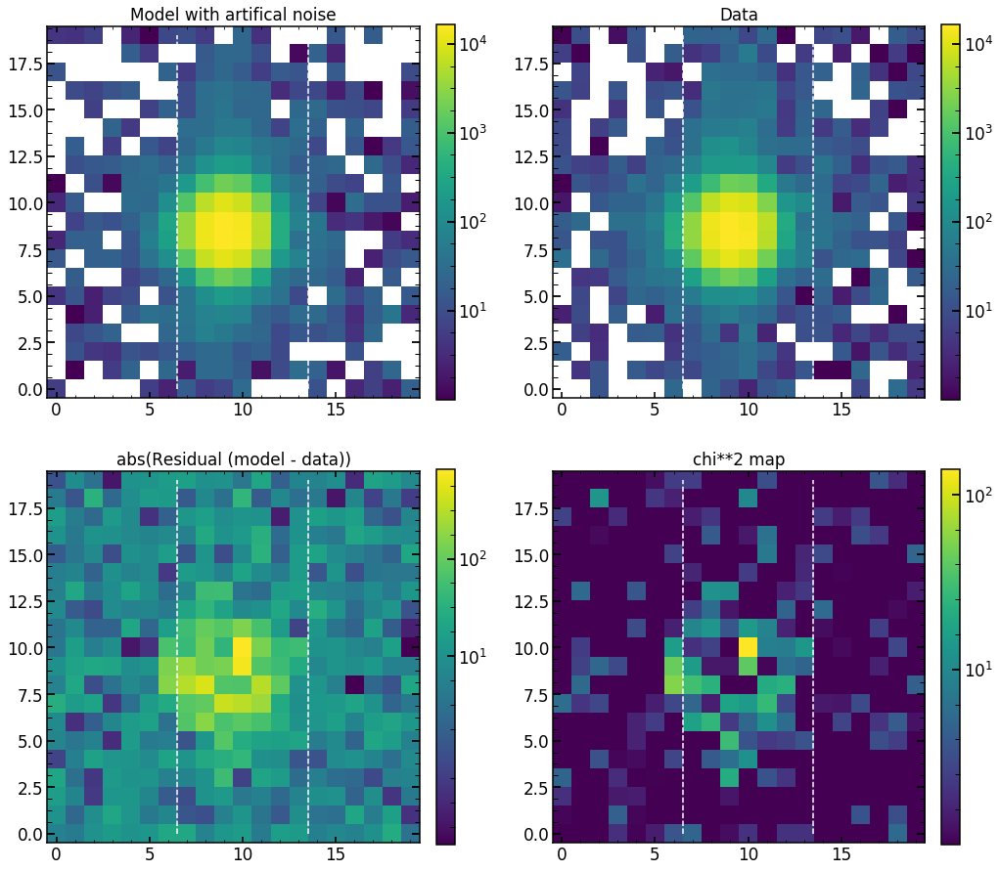

In [64]:
single_analysis.create_basic_comparison_plot_log_artifical()

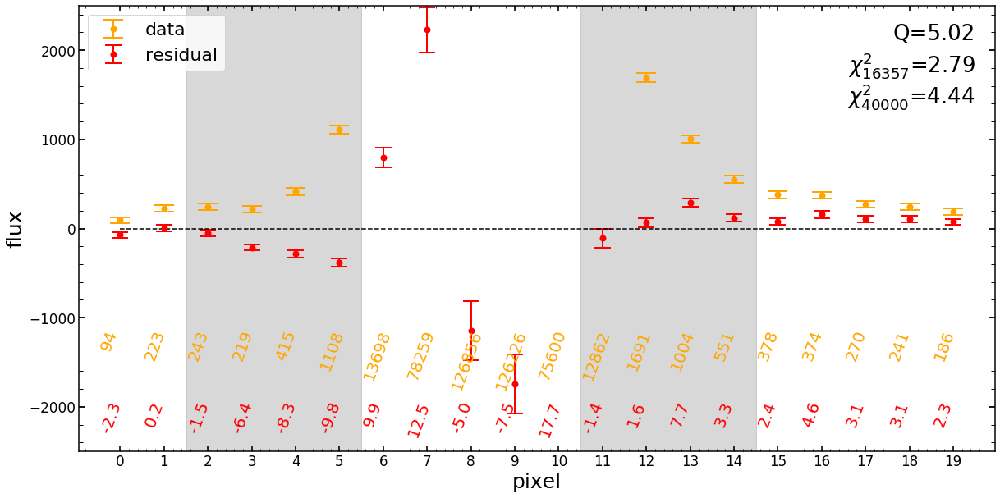

In [65]:
plot_1D_residual(sci_image,var_image,res_iapetus)

## results everywhere 

In [160]:
assert date=='Aug05'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)

#####

results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

#####

results_of_fit_many_single_focus_Kr=pd.DataFrame(np.zeros((len(finalKr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Kr=pd.DataFrame(np.zeros((len(finalKr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Kr_pd=pd.DataFrame(results_of_fit_many_single_focus_Kr)
err_results_of_fit_many_single_focus_Kr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Kr)




In [161]:
columns_analysis=columns22_analysis

for single_number in range(len(finalHgAr_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug05',single_number,'HgAr',22,2)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]



for single_number in range(len(finalNe_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug05',single_number,'Ne',22,2)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]



for single_number in range(len(finalKr_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug05',single_number,'Kr',22,2)
    results_of_fit_many_single_focus_Kr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Kr_pd=results_of_fit_many_single_focus_Kr_pd[np.abs(results_of_fit_many_single_focus_Kr_pd['z4'])>0]



22
0 17071 HgAr is NOT found or failed!
22
1 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z19: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z19: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
2 17071 HgAr is NOT found or failed!
22
3 obs (Emcee3): 17071 is found!
z7: failed!
z10: failed!
z11: fail

22
31 17071 HgAr is NOT found or failed!
22
32 17071 HgAr is NOT found or failed!
22
33 obs (Emcee3): 17071 is found!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
34 17071 HgAr i

61 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
x_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
62 17071 HgAr is NOT found or failed!
22
63 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z10: failed!
z13: failed!
z15: failed!

z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z15: failed!
z17: failed!
z18: failed!
z20: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
radiometricExponent: failed!
y_fiber: failed!
effective_radius_illumination: failed!
det_vert: failed!
22
88 17071 HgAr is NOT found or failed!
22
89 17071 HgAr is NOT found or failed!
22
90 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
ra

z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z19: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
112 17071 HgAr is NOT found or failed!
22
113 17071 HgAr is NOT found or failed!
22
114 17071 HgAr is NOT found or failed!
22
115 17071 HgAr is NOT found or failed!
22
116 17071 HgAr is NOT found or failed!
22
117 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!

41 16292 Ne is NOT found or failed!
22
42 obs (Emcee3): 16292 is found!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed

80 16292 Ne is NOT found or failed!
22
81 16292 Ne is NOT found or failed!
22
82 16292 Ne is NOT found or failed!
22
83 obs (Emcee3): 16292 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
effective_radius_illumin

23 obs (Emcee3): 17364 is found!
z5: failed!
z6: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z8: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
effective_radius_illumination: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
24 17364 Kr is NOT found or failed!
22
25 17364 Kr is NOT found or failed!
22
26 17364 Kr is NOT found or failed!
22
27 obs (Emcee3): 17364 is found!
z8: failed!
z18: failed!
strutFrac: failed!
y_ilum: fa

In [358]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,0.485820,0.216309,-0.155608,0.497319,0.695032,0.221204,-0.312896,-0.005409,-0.124327,-0.130733,...,1.005494,0.370127,52402.667359,2.193369,0.001092,0.350000,1.786825,0.998654,7.116274,1739.032227
3,0.512955,0.048485,-0.118321,0.406337,0.611989,0.134511,-0.260751,-0.006447,-0.145177,-0.118622,...,0.989966,0.544219,38410.505110,1.832619,0.000526,0.350000,1.780012,0.997835,2.099496,477.556244
6,0.048289,-0.298191,0.534664,0.319142,0.977983,-0.009211,-0.154583,-0.455273,-0.141969,0.042466,...,0.988086,0.111895,164668.117951,2.641754,0.000044,0.350026,1.780215,0.980440,33.650412,1472.755371
15,-0.276967,0.236277,-0.121554,0.442727,0.406962,0.034231,-0.320223,-0.234965,-0.118765,-0.085984,...,1.006957,0.524931,38508.499007,2.269630,0.000964,0.350000,1.802808,0.999510,2.085322,514.938660
18,0.231522,-0.233108,0.055913,0.176056,0.346944,-0.044744,-0.256890,-0.333129,-0.143049,-0.003149,...,1.003758,0.495343,50809.574969,2.107247,0.000893,0.350000,1.824144,0.999672,3.789142,1574.751221
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105,1.031551,0.434017,-0.311969,-0.268526,-0.804200,-0.230131,-0.406254,0.074415,-0.024390,-0.122810,...,1.024782,-0.241430,44734.913930,2.273288,0.001862,0.350000,1.781958,0.994969,32.469620,5678.711426
107,1.057471,0.369189,-0.548284,-0.289100,-0.766522,-0.288092,-0.238364,0.365569,0.049922,-0.202956,...,1.057262,-0.195525,17485.156452,2.355148,0.005390,0.350000,1.815306,0.989934,4.560646,313.088470
109,0.873508,-0.572711,-0.179791,0.564382,-1.207656,0.209022,-0.247234,0.046205,-0.123192,0.119952,...,0.984884,-0.224803,38576.537786,2.138000,0.001008,0.350000,1.854998,0.998163,4.595841,1118.098145
111,0.652210,-0.484883,-0.072029,0.402662,-1.128273,0.094874,-0.338288,0.065309,-0.142128,0.084201,...,0.989012,-0.241673,27828.645653,2.022012,0.000610,0.350000,1.875217,0.997782,1.732261,296.779419


In [359]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
20,1.674561,0.436930,-0.499183,0.804384,0.469545,0.009858,-0.404887,-0.156453,-0.014792,-0.149471,...,1.042425,0.404786,48799.752797,2.425667,0.002691,0.387500,1.784396,0.998919,10.314723,8236.346680
23,1.506449,0.478235,-0.343216,0.651263,0.252387,-0.007110,-0.340413,-0.239819,-0.049094,-0.120743,...,1.016130,0.424464,47529.664424,2.293479,0.001752,0.390955,1.821933,0.998663,21.286833,13726.793945
24,1.197632,0.373225,-0.218454,0.727255,0.196116,-0.038539,-0.402876,-0.177548,-0.067374,-0.100502,...,1.006894,0.377177,37974.008645,1.834002,0.000560,0.437500,1.807076,0.997829,7.550476,2853.855225
29,1.116045,0.358558,-0.622596,0.809085,0.123121,-0.064046,-0.398524,-0.245864,0.037049,-0.107410,...,1.045513,0.280885,51336.782542,2.253867,0.001745,0.350000,1.780971,0.998332,19.354806,9835.326172
33,0.865190,0.259201,-0.432309,0.511783,0.029818,-0.046765,-0.335428,-0.398787,-0.017235,-0.083344,...,1.016670,0.215694,44672.775537,2.077147,0.001145,0.350000,1.780146,0.998795,5.692741,3362.895996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,-2.419056,-0.548557,-0.152566,0.427102,-0.798299,-0.012494,-0.221449,-0.171652,-0.099688,0.108607,...,0.995645,-0.202397,67048.296177,2.397947,0.003825,0.350000,1.780035,0.998295,4.265227,1922.637085
83,-2.415587,-0.464653,-0.321149,0.508598,-1.097058,0.325045,-0.029996,0.104260,-0.095591,0.172331,...,1.004559,-0.256303,56595.139289,2.204571,0.001723,0.350000,1.780056,0.998831,7.582019,4932.035645
86,-2.619091,-0.390390,-0.303213,0.444945,-1.018834,0.206335,-0.185728,0.075256,-0.134876,0.136843,...,0.989072,-0.228604,45705.005427,2.214472,0.001576,0.350000,1.780043,0.998018,18.205812,8092.833984
87,-2.706967,-0.381632,-0.243129,0.370857,-1.037317,0.130734,-0.290255,-0.024154,-0.143712,0.107093,...,0.982603,-0.277821,42970.923794,1.814689,0.000646,0.350000,1.792785,0.997976,3.876468,1636.612549


In [203]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Kr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
3,0.581457,-0.993836,-0.307047,-0.184955,0.418961,-0.234913,-0.239133,0.115592,-0.094287,0.137962,...,1.014593,0.577426,61074.222898,2.369851,0.001875,0.397085,1.794676,0.995147,2.928701,520.746643
7,0.396865,-0.869666,-0.317741,-0.147031,0.371294,-0.162339,-0.293462,-0.040024,-0.079016,0.131335,...,1.029078,0.393738,75101.325332,2.614114,0.003395,0.357312,1.834211,0.995443,3.354170,596.408264
11,0.262063,-0.850771,-0.377827,-0.015761,0.127826,-0.127436,-0.302041,-0.180581,-0.038256,0.091236,...,1.035584,0.357012,56121.806205,2.373873,0.001702,0.393254,1.824969,0.995408,3.447100,612.662720
15,0.193651,-0.668588,-0.487951,0.026682,-0.042340,-0.128721,-0.341405,-0.152750,-0.019188,0.061360,...,1.040753,0.255689,70672.422207,2.849991,0.005409,0.382193,1.837036,0.993295,4.446273,690.702820
19,-0.068336,-0.450587,-0.625248,0.041272,-0.110960,-0.130879,-0.340375,-0.235290,0.015615,0.037438,...,1.045046,0.146267,58312.733071,2.312660,0.001753,0.400135,1.837672,0.994208,4.161260,615.926697
23,0.055598,-0.257438,-0.704842,0.071714,-0.157884,-0.120488,-0.331953,-0.297319,0.004957,0.001019,...,1.047336,0.032169,51296.474362,2.108179,0.001034,0.403484,1.797218,0.993623,3.135793,498.170013
27,0.476466,0.091715,-0.600737,0.057268,-0.309087,-0.141935,-0.362538,-0.199380,-0.008941,-0.039619,...,1.049689,-0.152941,69676.807253,2.819743,0.004885,0.388283,1.797370,0.993448,3.161104,519.784302
31,0.587354,0.288418,-0.546748,0.020821,-0.424296,-0.145625,-0.346655,-0.183964,-0.032136,-0.049041,...,1.035533,-0.261677,53276.595340,2.503669,0.002531,0.350000,1.814276,0.995274,2.824636,524.610962
35,0.931506,0.440378,-0.254437,-0.134840,-0.855551,-0.212309,-0.420911,0.048852,-0.065359,-0.120768,...,1.015592,-0.180204,55913.476819,1.708273,0.000472,0.350000,1.780008,0.992306,3.441416,400.457642
39,1.022375,0.307697,-0.263741,-0.239309,-0.829669,-0.305339,-0.416537,0.252032,-0.108593,-0.146029,...,0.995645,-0.233564,53098.095223,1.500000,0.000191,0.350000,1.843818,0.987741,3.217906,283.682281


In [204]:
#with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_HgAr_from_Aug05.pkl', 'wb') as f:
#    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
#with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_Ne_from_Aug05.pkl', 'wb') as f:
#    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_Kr_from_Aug05.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Kr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [369]:
label=['0d','0']
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Aug05'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns

j=0
# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_May2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_May2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_May2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_May2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/0d/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z4/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z5/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z6/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z7/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z8/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z9/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z10/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z11/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z12/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z13/
Images are in folder: /Users/nevencaplar/Documents/PFS/Images/Aug05/Plane/z14/
Images are in folder: /Users/nevencaplar/Documents/PFS/Imag

<Figure size 864x720 with 0 Axes>

In [368]:
j

'fiber_r'

## compare discrepant

In [406]:
np.unique(finalHgAr['fiber'].values)

array([  2,  63, 192, 255, 339, 401, 464, 525, 587, 650])

In [410]:
finalHgAr[(finalHgAr['fiber']==192)&(finalHgAr['close']=='1')]

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
25,192,845,851,696.7261,1,HgAr,845,25,92.0
27,192,846,1203,727.47876,1,HgAr,846,27,nan
30,192,847,1982,795.0522,1,HgAr,847,30,52.0
33,192,844,3360,912.5693,1,HgAr,844,33,22.0
35,192,840,4009,966.0642,1,HgAr,840,35,2.0


In [411]:
finalNe[(finalNe['fiber']==192)&(finalNe['close']=='1')]

,fiber,xc,yc,wavelength,close,lamp,xc_effective,old_index_approx,superold_index_approx
20,192,846,432,660.0668,1,Ne,846,20,nan
23,192,848,810,693.13116,1,Ne,848,23,nan
24,192,849,1090,717.59015,1,Ne,849,24,nan
25,192,849,1172,724.72437,1,Ne,849,25,nan


### HgAr

In [419]:
date='Aug05'
obs=17017+54
single_number='25'
image_index=int(single_number)
eps=5
arc='HgAr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    else:
        print("Not recognized arc-line")
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber                         192
xc                            845
yc                            851
wavelength               696.7261
close                           1
lamp                         HgAr
xc_effective                  845
old_index_approx               25
superold_index_approx        92.0
Name: 25, dtype: object

In [420]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 657.2185222613786
minimal chi2 reduced is: 3.248233234634739
extraZernike: None
zmax: 22
42


-657.2185222709082

In [423]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(42,)
        z4        z5        z6       z7        z8        z9       z10      z11
0 -0.23743  0.370273 -0.347781  0.59548  0.259674  0.005071 -0.310287 -0.26188
        z12       z13      z14       z15       z16       z17       z18  \
0 -0.041645 -0.115227 -0.00267  0.020478 -0.004184  0.001716 -0.000009   

        z19       z20       z21  
0  0.015484 -0.022363  0.016192  
       z22   hscFrac  strutFrac  dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0 -0.01603  0.665092   0.091643 -0.10485 -0.065748  0.057264     0.036783   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000026             0.000026  0.974166    ...      0.045231   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0             0.81745  1.022304             0.40686   62451.946103   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.243311              0.001364      0.356644  1.814332  1.000191  

[1 rows x 24 

In [421]:
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

Text(0.5,1,'Residual')

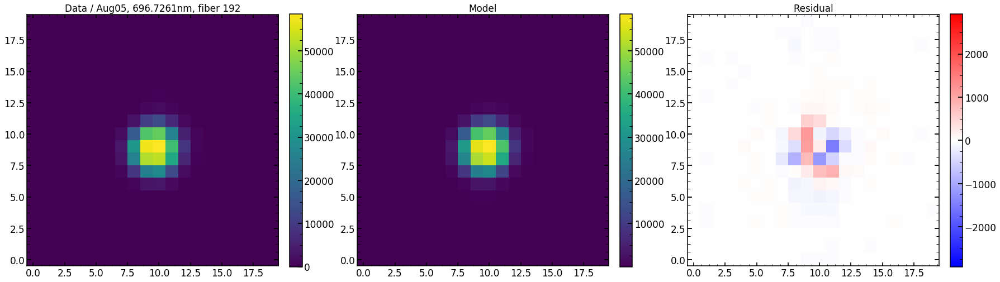

In [422]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

### Neon

In [424]:
date='Aug05'
obs=16292
single_number='23'
image_index=int(single_number)
eps=5
arc='Ne'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    else:
        print("Not recognized arc-line")
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber                          192
xc                             848
yc                             810
wavelength               693.13116
close                            1
lamp                            Ne
xc_effective                   848
old_index_approx                23
superold_index_approx          nan
Name: 23, dtype: object

In [425]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 4257.366642866677
minimal chi2 reduced is: 21.244468386734752
extraZernike: None
zmax: 22
42


-4257.3666428668275

In [426]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)

(42,)
         z4        z5        z6        z7        z8       z9       z10  \
0  1.506449  0.478235 -0.343216  0.651263  0.252387 -0.00711 -0.340413   

        z11  
0 -0.239819  
        z12       z13       z14       z15       z16       z17       z18  \
0 -0.049094 -0.120743 -0.016314  0.017693 -0.005683 -0.003219 -0.000552   

        z19       z20      z21  
0  0.012084 -0.024638  0.02305  
        z22  hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.012859  0.66171   0.089746 -0.101762 -0.065023  0.056775      0.03416   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000027             0.000027  0.974164    ...      0.039577   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.791941   1.01613            0.424464   47529.664424   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.293479              0.001752      0.390955  1.821933  0.99

In [427]:
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

Text(0.5,1,'Residual')

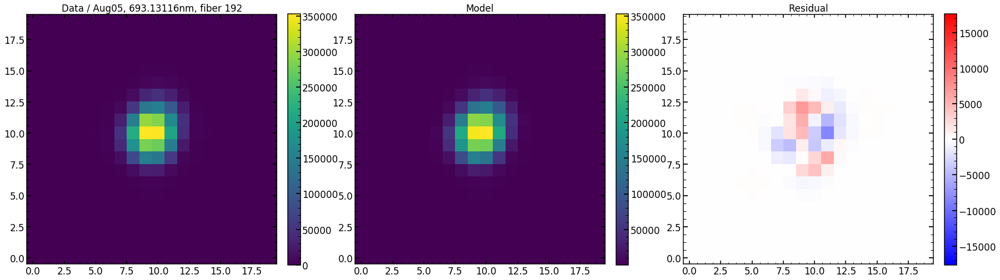

In [428]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

# Aug 07 (focus, from interpolation)

## Scripts

In [257]:
list_of_HgAr_to_analyze=finalHgAr_May2019.index[(finalHgAr_May2019['fiber'].values.astype(int)<=650)&(finalHgAr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalHgAr_May2019['close'].values.astype(int)==1)]
print(len(list_of_HgAr_to_analyze))

list_of_Ne_to_analyze=finalNe_May2019.index[(finalNe_May2019['fiber'].values.astype(int)<=650)&(finalNe_May2019['fiber'].values.astype(int)>=2)
                                        &(finalNe_May2019['close'].values.astype(int)==1)]
print(len(list_of_Ne_to_analyze))

list_of_Kr_to_analyze=finalKr_May2019.index[(finalKr_May2019['fiber'].values.astype(int)<=650)&(finalKr_May2019['fiber'].values.astype(int)>=2)
                                        &(finalKr_May2019['close'].values.astype(int)==1)]
print(len(list_of_Kr_to_analyze))


50
40
10


In [258]:
list_of_HgAr_to_analyze_10=np.array_split(np.array(list_of_HgAr_to_analyze),10)
print(len(list_of_HgAr_to_analyze_10[0]))
list_of_Ne_to_analyze_10=np.array_split(np.array(list_of_Ne_to_analyze),8)
print(len(list_of_Ne_to_analyze_10[0]))
list_of_Kr_to_analyze_10=np.array_split(np.array(list_of_Kr_to_analyze),2)
print(len(list_of_Kr_to_analyze_10[0]))

5
5
5


In [259]:
#MPI
for i in range(len(list_of_HgAr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T04'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_HgAr_to_analyze_10[i]:
        for obs in [17071]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI02_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 HgAr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger04_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_HgAr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T04'+str(i)+'Aug_focus.sh \n')

file.close()

#MPI
for i in range(len(list_of_Ne_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T05'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Ne_to_analyze_10[i]:
        for obs in [16292]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI02_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Ne 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger05_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Ne_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T05'+str(i)+'Aug_focus.sh \n')

file.close()

#MPI
for i in range(len(list_of_Kr_to_analyze_10)):
    file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/T06'+str(i)+'Aug_focus.sh','w') 
    file.write("#!/bin/bash \n")
    file.write("#SBATCH --nodes=4 # node count \n")
    file.write("#SBATCH --ntasks-per-node=40 \n") 
    file.write("#SBATCH --time 13:59:59 \n")
    file.write("#SBATCH --mail-type=begin  \n")
    file.write("#SBATCH --mail-type=end   \n") 
    file.write("#SBATCH --mail-user=ncaplar@princeton.edu \n") 

    file.write("\n")
    file.write("#1. Observation (e.g., 8567) \n") 
    file.write("#2. Threads \n") 
    file.write("#3. Steps \n") 
    file.write("\n")
    for single_spot in list_of_Kr_to_analyze_10[i]:
        for obs in [17364]:
            file.write("mpirun python /home/ncaplar/Code/ZernikeSingle_Aug_MPI02_focus.py "+str(obs)+" "+str(single_spot)+" 40 5 Kr 2\n")
    file.close()    
    
file = open('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ScriptsForTiger/AugScriptToSubmitScriptsTiger06_focus'+'.sh','w')
file.write("#!/bin/bash \n")
file.write("\n")
#for obs in [1,2,3,4]:
#    for single_spot in [35,45,55,75,85,95]:
#        file.write('sbatch /home/ncaplar/Scripts/T'+str(obs)+'S'+str(single_spot)+'Sep_P.sh \n')

for i in range(len(list_of_Kr_to_analyze_10)):
    file.write('sbatch /home/ncaplar/Scripts/T06'+str(i)+'Aug_focus.sh \n')

file.close()

### which images are avaliable

In [301]:
import glob
date='Aug07'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)

In [302]:
#analyzed_Neon_images=[]
#for i in range(len(Emcee3_Ne)):
#    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
#    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
#    
#analyzed_Neon_images=np.array(analyzed_Neon_images)

analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_HgAr_images=np.array(analyzed_HgAr_images)

In [303]:
#arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
#arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

In [304]:
arranged_by_spot_number_HgAr

array([[17071,     1],
       [17071,     3],
       [17071,     6],
       [17071,     9],
       [17071,    11],
       [17071,    13],
       [17071,    15],
       [17071,    18],
       [17071,    21],
       [17071,    23],
       [17071,    25],
       [17071,    27],
       [17071,    30],
       [17071,    33],
       [17071,    35],
       [17071,    37],
       [17071,    39],
       [17071,    42],
       [17071,    45],
       [17071,    47],
       [17071,    49],
       [17071,    59],
       [17071,    61],
       [17071,    63],
       [17071,    66],
       [17071,    69],
       [17071,    71],
       [17071,    73],
       [17071,    75],
       [17071,    78],
       [17071,    81],
       [17071,    83],
       [17071,    85],
       [17071,    87],
       [17071,    90],
       [17071,    93],
       [17071,    95],
       [17071,    97],
       [17071,    99],
       [17071,   102],
       [17071,   105],
       [17071,   107],
       [17071,   109],
       [170

## single analysis 

In [206]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


    
date='Aug07'
obs=17017+54
single_number='59'
image_index=int(single_number)
eps=5
arc='HgAr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    else:
        print("Not recognized arc-line")
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    elif arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])    
if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber                         339
xc                           1608
yc                           3987
wavelength               966.0642
close                           1
lamp                         HgAr
xc_effective                 1608
old_index_approx               83
superold_index_approx         2.0
Name: 59, dtype: object

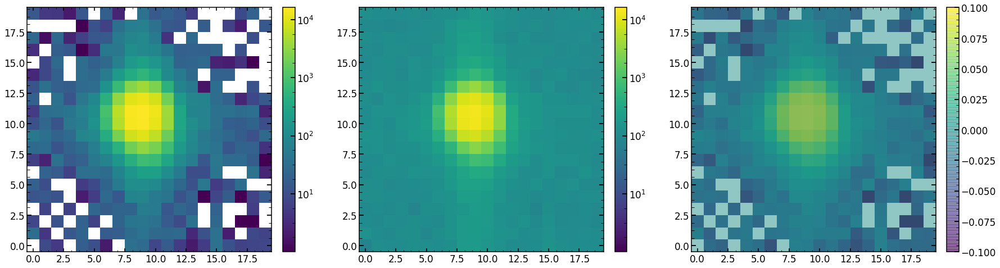

In [207]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(132)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(133)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
plt.imshow(mask_image,origin='lower',vmin=0,vmax=np.max(mask_image),alpha=0.5)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [208]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 7, 42)
minimal likelihood is: 996.253465854598
minimal chi2 reduced is: 4.945929555092574


In [209]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
    
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4        z5        z6        z7        z8        z9       z10  \
0  0.379547 -0.443303 -0.966454 -0.263436 -0.023338 -0.212146 -0.378864   

        z11  
0  0.086487  
        z12       z13       z14       z15       z16       z17      z18  \
0  0.111811  0.060065  0.008844  0.039872 -0.003026  0.012373  0.00035   

        z19       z20       z21  
0  0.001763 -0.037845  0.036497  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.024274  0.659834   0.093217 -0.047925  0.222373  0.062051     0.053136   

   radiometricEffect  radiometricExponent    x_ilum    ...     frd_sigma  \
0           0.000016             0.000016  0.973412    ...      0.040234   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.879186  1.084311            0.118974    18163.20707   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r      flux  
0          2.544071              0.006891      0.427018  1.840256  

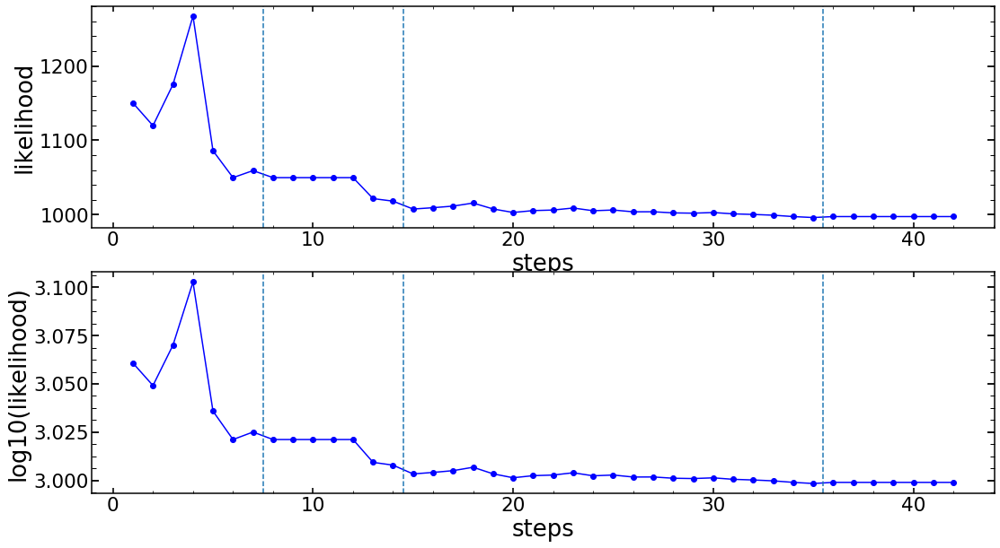

In [210]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [211]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42


-997.5700277848524

In [212]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

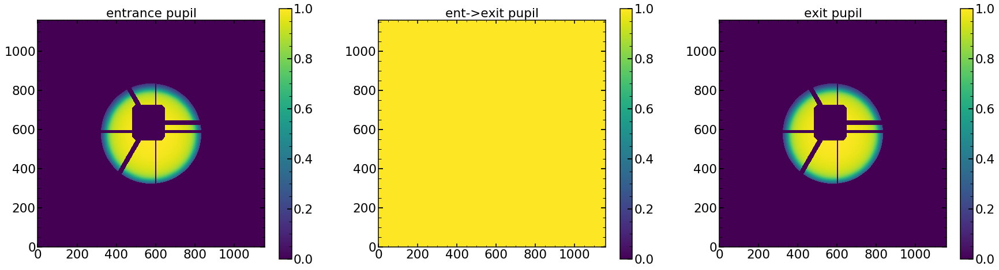

In [213]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

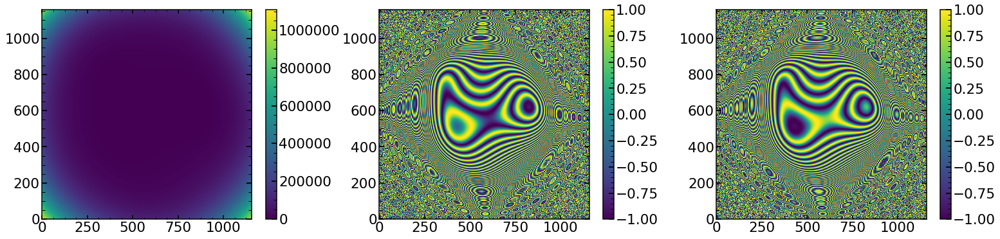

In [214]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

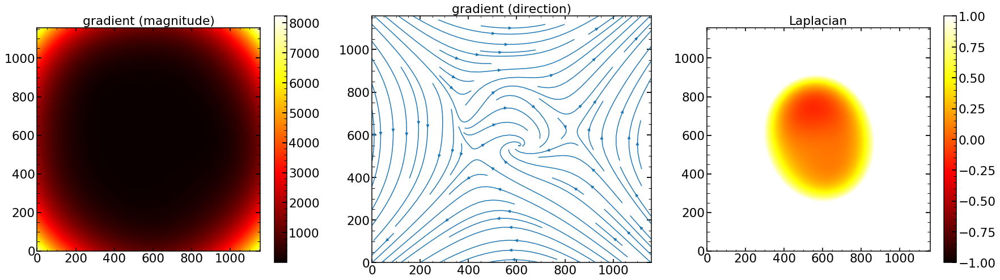

In [215]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

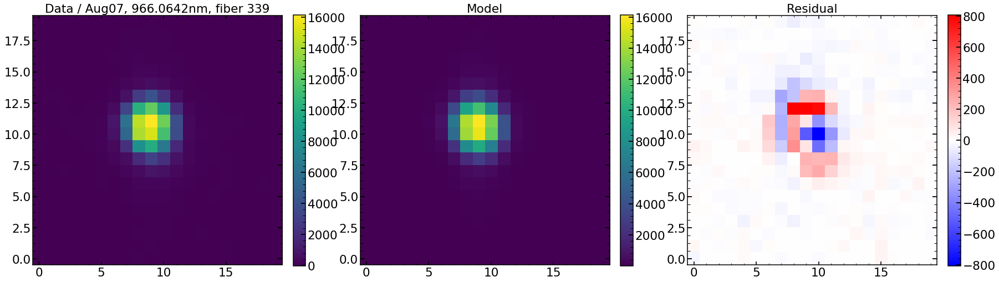

In [216]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

chi**2 reduced is: 4.95251232942816
Abs of residual divided by total flux is: 0.07657273706198801
Abs of residual divided by largest value of a flux in the image is: 0.06056011165369511


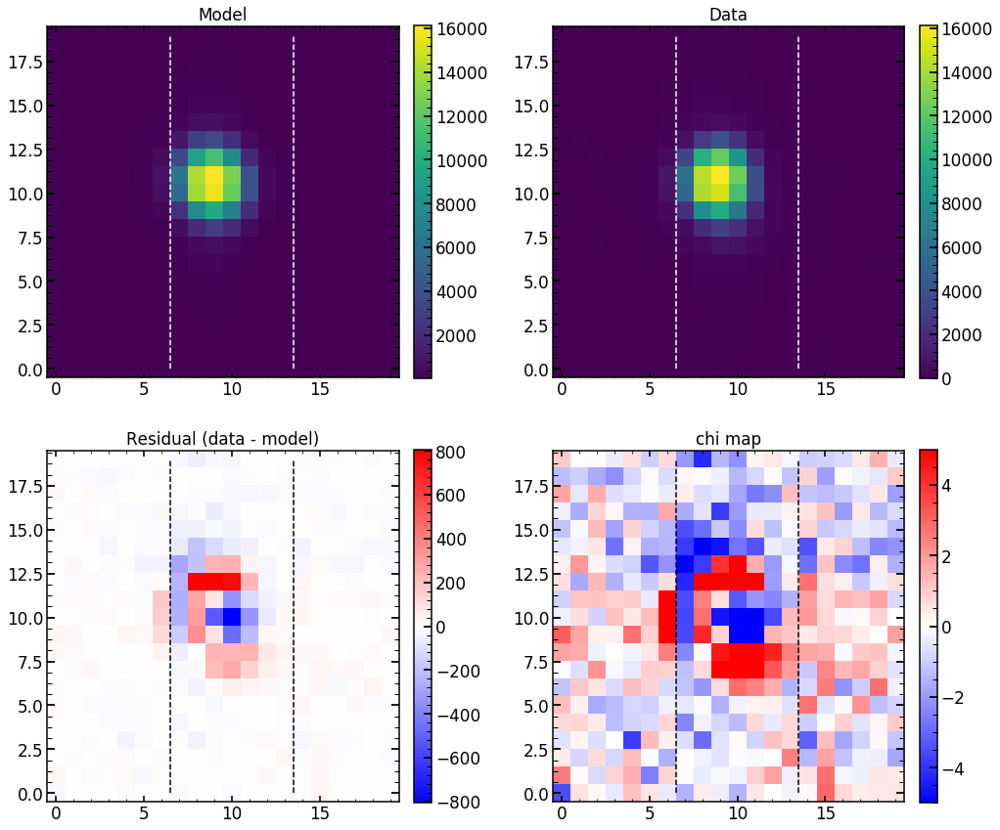

In [217]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

4.95251232942816
chi**2 reduced is: 4.95251232942816
Abs of residual divided by total flux is: 0.07657273706198801
Abs of residual divided by largest value of a flux in the image is: 0.06056011165369511


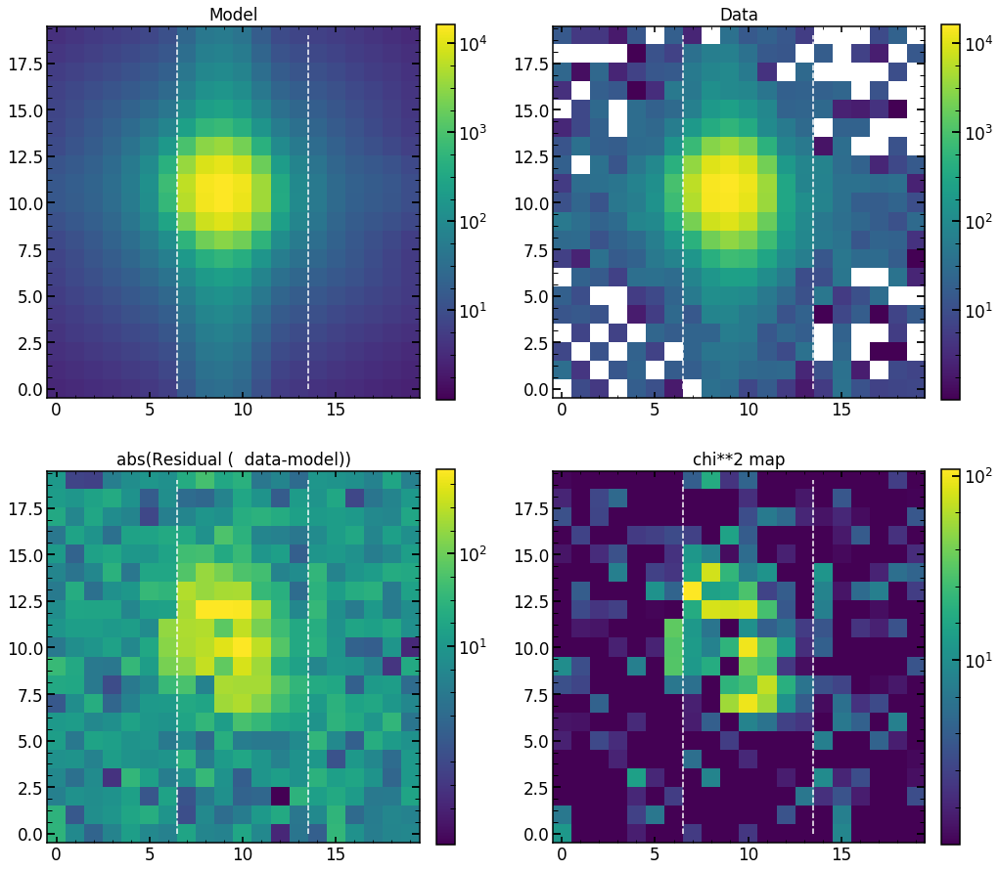

In [218]:
single_analysis.create_basic_comparison_plot_log()

4.95251232942816
chi**2 reduced is: 4.95251232942816
Abs of residual divided by total flux is: 0.07657273706198801
Abs of residual divided by largest value of a flux in the image is: 0.06056011165369511


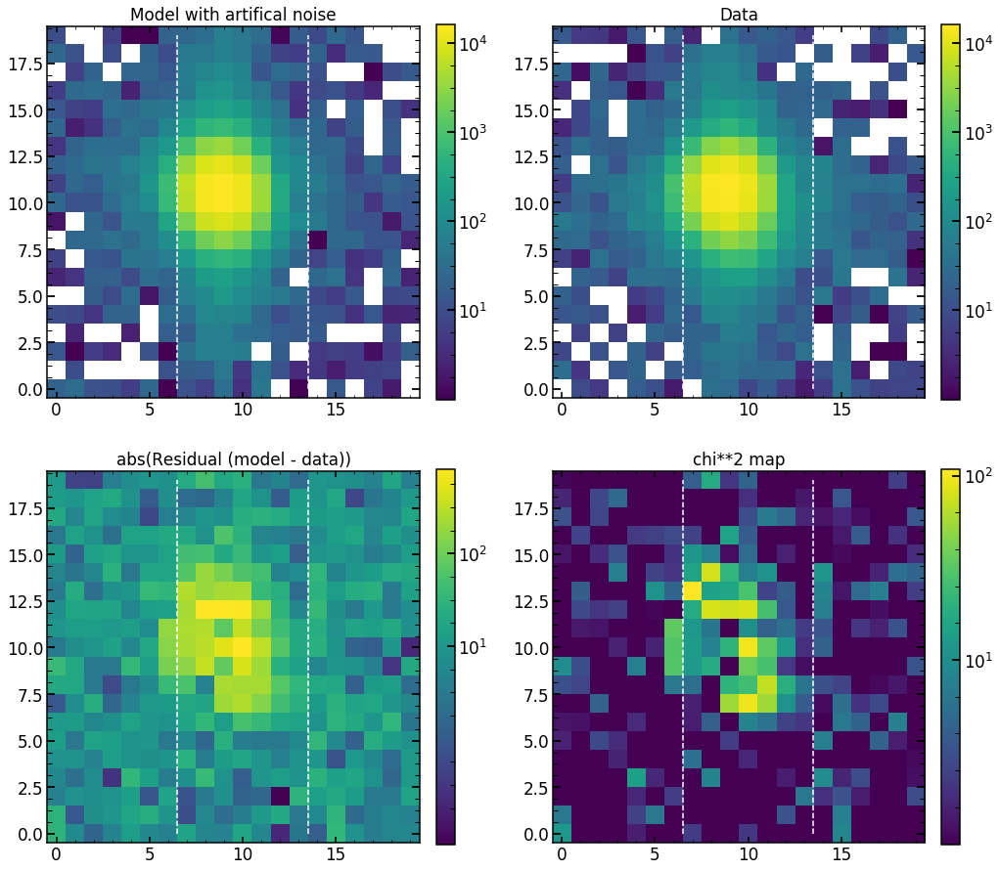

In [219]:
single_analysis.create_basic_comparison_plot_log_artifical()

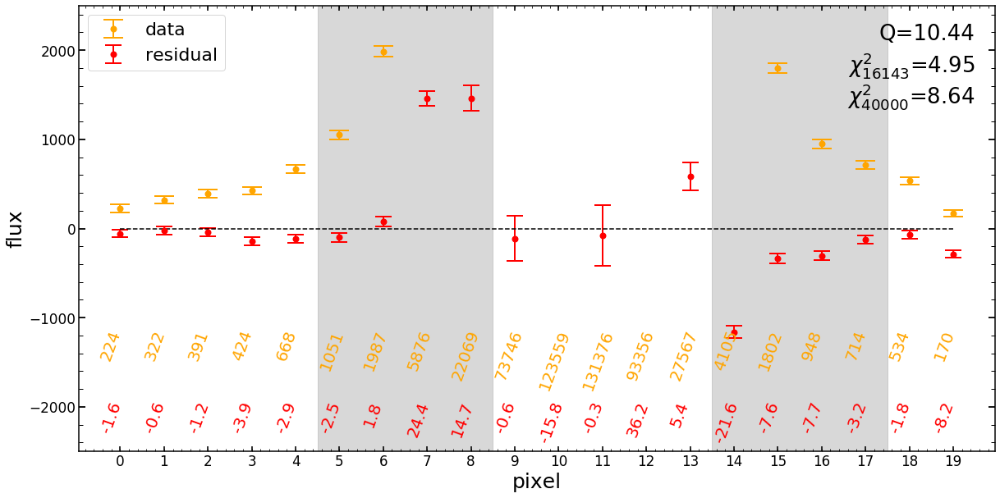

In [220]:
plot_1D_residual(sci_image,var_image,res_iapetus)

## results everywhere 

In [221]:
assert date=='Aug07'

results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_HgAr=pd.DataFrame(np.zeros((len(finalHgAr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalHgAr_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(results_of_fit_many_single_focus_HgAr)
err_results_of_fit_many_single_focus_HgAr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_HgAr)

#####

results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Ne=pd.DataFrame(np.zeros((len(finalNe_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalNe_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(results_of_fit_many_single_focus_Ne)
err_results_of_fit_many_single_focus_Ne_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Ne)

#####

results_of_fit_many_single_focus_Kr=pd.DataFrame(np.zeros((len(finalKr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr_May2019.index,columns=columns22_analysis)
err_results_of_fit_many_single_focus_Kr=pd.DataFrame(np.zeros((len(finalKr_May2019),len(columns22_analysis))).reshape(-1,len(columns22_analysis)),index=finalKr_May2019.index,columns=columns22_analysis)

results_of_fit_many_single_focus_Kr_pd=pd.DataFrame(results_of_fit_many_single_focus_Kr)
err_results_of_fit_many_single_focus_Kr_pd=pd.DataFrame(err_results_of_fit_many_single_focus_Kr)




In [222]:
columns_analysis=columns22_analysis

for single_number in range(len(finalHgAr_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug07',single_number,'HgAr',22,2)
    results_of_fit_many_single_focus_HgAr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_HgAr_pd=results_of_fit_many_single_focus_HgAr_pd[np.abs(results_of_fit_many_single_focus_HgAr_pd['z4'])>0]



for single_number in range(len(finalNe_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug07',single_number,'Ne',22,2)
    results_of_fit_many_single_focus_Ne_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Ne_pd=results_of_fit_many_single_focus_Ne_pd[np.abs(results_of_fit_many_single_focus_Ne_pd['z4'])>0]



for single_number in range(len(finalKr_May2019)):
        
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single_focus('Aug07',single_number,'Kr',22,2)
    results_of_fit_many_single_focus_Kr_pd.loc[single_number]=results_of_fit_single.values  

results_of_fit_many_single_focus_Kr_pd=results_of_fit_many_single_focus_Kr_pd[np.abs(results_of_fit_many_single_focus_Kr_pd['z4'])>0]



22
0 17071 HgAr is NOT found or failed!
22
1 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
2 17071 HgAr is NOT foun

x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
22
24 17071 HgAr is NOT found or failed!
22
25 obs (Emcee3): 17071 is found!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
z5: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
26 17071 HgAr is NOT found or failed!
22
27 obs 

z7: failed!
z9: failed!
z11: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
50 17071 HgAr is NOT found or failed!
22
51 17071 HgAr is NOT found or failed!
22
52 17071 HgAr is NOT found or failed!
22
53 17071 HgAr is NOT found or failed!
22
54 17071 HgAr is NOT found or failed!
22
55 17071 HgAr is NOT found or failed!
22
56 17071 HgAr is NOT found or failed!
22
57 17071 HgAr is NOT found or failed!
22
58 17071 HgAr is NOT found or failed!
22
59 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFo

81 obs (Emcee3): 17071 is found!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z16: failed!
z17: failed!
z18: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
det_vert: failed!
slitHolder_frac_dx: fai

z7: failed!
z8: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
z16: failed!
z18: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
radiometricExponent: failed!
y_ilum: failed!
y_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
106 17071 HgAr is NOT found or failed!
22
107 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z13: failed!
z15: failed!
z16: failed!
z18: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
d

z11: failed!
z13: failed!
z16: failed!
z17: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
15 obs (Emcee3): 16292 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!
z19: failed!
z20: failed!
z22: failed!
hscFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z17: failed!

z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z14: failed!
z15: failed!
z16: failed!
z17: failed!
z18: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dyFocal: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
48 16292 Ne is NOT found or failed!
22
49 16292 Ne is NOT found or failed!
22
50 obs (Emcee3): 16292 is found!
z5: failed!
z6: failed!
z7: failed!
z8: fai

22
69 obs (Emcee3): 16292 is found!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z17: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z8: failed!
z9: failed!
z10: failed!
z11: failed!
z12: failed!
z13: failed!
z15: failed!
z16: failed!
z17: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
dyFocal: failed!
slitFrac: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
70 16292 Ne is NOT 

z20: failed!
hscFrac: failed!
strutFrac: failed!
slitFrac_dy: failed!
radiometricExponent: failed!
x_fiber: failed!
frd_lorentz_factor: failed!
det_vert: failed!
22
4 17364 Kr is NOT found or failed!
22
5 17364 Kr is NOT found or failed!
22
6 17364 Kr is NOT found or failed!
22
7 obs (Emcee3): 17364 is found!
z6: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z6: failed!
z9: failed!
z11: failed!
z12: failed!
z13: failed!
hscFrac: failed!
dyFocal: failed!
radiometricExponent: failed!
x_fiber: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
22
8 17364 Kr is NOT found or failed!
22
9 17364 Kr is NOT found or failed!
22
10 17364 Kr is NOT found or failed!
22
11 obs (Emcee3): 17364 is found!
z5: failed!
z6: failed!
z9: failed!
z11: failed!
z13: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
y_ilum: failed!
frd_sigma: failed!
frd_lo

In [223]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_HgAr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
1,0.659173,0.430768,-0.096421,0.478175,0.590573,0.055732,-0.276608,-0.024827,-0.123496,-0.159688,...,0.999056,0.395936,56564.409641,2.316158,0.001570,0.350000,1.788708,0.999070,6.217146,1739.032227
3,0.588866,0.208977,0.002871,0.377938,0.548466,0.018764,-0.283809,-0.076485,-0.149044,-0.112604,...,0.992613,0.395576,34984.032495,1.967614,0.000732,0.350000,1.780276,0.998206,2.159965,477.556244
6,0.540523,-0.256715,0.084102,0.160377,0.475208,-0.053500,-0.305796,-0.092251,-0.169928,-0.010104,...,0.990001,0.395225,47165.289119,2.288123,0.001392,0.350000,1.780271,0.996976,7.183921,1472.755371
9,0.566827,-1.012632,-0.237474,-0.215293,0.411236,-0.150657,-0.365727,0.213586,-0.087107,0.169305,...,1.024598,0.396530,55502.783408,2.595112,0.003912,0.404442,1.809354,0.996374,30.529573,7397.613770
11,0.420711,-1.338041,-0.593497,-0.386320,0.409719,-0.182435,-0.402991,0.503351,0.004579,0.252830,...,1.058092,0.397824,24124.626138,2.327460,0.004493,0.479388,1.797788,0.996400,2.357718,383.400940
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109,1.041258,-0.749261,-0.099982,0.486865,-1.097588,0.027329,-0.276744,0.059370,-0.112600,0.141177,...,0.995230,-0.324908,37355.038283,1.865045,0.000464,0.350000,1.842130,0.998177,4.619160,1118.098145
111,0.829885,-0.592581,0.007994,0.388619,-1.089287,-0.008974,-0.279910,0.002287,-0.141582,0.098313,...,0.988495,-0.324562,32311.258659,2.059803,0.000892,0.350000,1.864091,0.997735,1.840306,296.779419
114,-0.777351,-0.226039,0.108804,0.174811,-1.053981,-0.079958,-0.293068,-0.024775,-0.170149,0.003028,...,0.985212,-0.324405,61025.265684,2.149571,0.001076,0.406160,1.894443,0.995211,4.556657,866.643738
117,1.225903,0.496980,-0.178238,-0.191798,-0.931995,-0.174453,-0.336989,0.259083,-0.100838,-0.168887,...,1.018567,-0.325496,31501.678384,1.793647,0.000440,0.350000,1.792556,0.990472,42.824514,4015.403076


In [224]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Ne_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
2,3.510535,0.702849,-0.267210,0.599231,0.646800,0.103100,-0.270266,0.071750,-0.079497,-0.216019,...,1.011130,0.395940,34713.004018,2.570219,0.004669,0.391247,1.809361,0.983833,123.602366,7433.366211
5,3.280863,0.455760,-0.112397,0.490291,0.594243,0.060047,-0.275855,-0.018753,-0.119323,-0.164820,...,1.000153,0.395217,38332.193204,2.558711,0.003799,0.384324,1.780074,0.991031,115.013195,12468.879883
6,3.180250,0.278806,-0.026933,0.410593,0.559791,0.030242,-0.281265,-0.064707,-0.141311,-0.127434,...,0.994478,0.394856,32392.940762,2.367593,0.002547,0.369260,1.794363,0.993206,18.991926,2579.286865
11,2.597279,0.563398,-0.435048,0.638879,0.497271,0.092787,-0.268074,-0.065186,-0.030954,-0.175999,...,1.022992,0.325387,52385.747096,2.520512,0.004041,0.407161,1.780140,0.993368,55.179760,7929.372559
14,2.433362,0.357201,-0.278113,0.530525,0.450250,0.049986,-0.273165,-0.156053,-0.071472,-0.134543,...,1.011881,0.324842,51568.352655,2.485749,0.003154,0.367332,1.780071,0.997123,41.313765,13358.384766
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78,-2.339238,-0.547769,-0.182299,0.457874,-0.918093,-0.001816,-0.276324,-0.130778,-0.088975,0.092128,...,1.002335,-0.257062,59498.477015,2.318678,0.002853,0.350000,1.783278,0.998351,3.982100,1922.637085
83,-2.217468,-0.929708,-0.276958,0.604262,-1.102959,0.073828,-0.275277,0.164845,-0.065661,0.192268,...,1.007346,-0.326147,56998.855731,1.999086,0.001113,0.350000,1.780101,0.988111,62.827555,4932.035645
86,-2.509285,-0.767562,-0.113388,0.497751,-1.099529,0.031642,-0.276516,0.068776,-0.109040,0.146216,...,0.996103,-0.325446,68646.228093,2.094527,0.001340,0.350000,1.780098,0.992871,62.044068,8092.833984
87,-2.636901,-0.644138,-0.020663,0.419536,-1.094083,0.002393,-0.278733,0.018998,-0.133860,0.112204,...,0.990170,-0.325278,83958.485416,1.961406,0.001200,0.350000,1.784532,0.994626,10.040296,1636.612549


In [225]:
pd.set_option("display.max_rows",10)
results_of_fit_many_single_focus_Kr_pd

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
3,0.543821,-0.890285,-0.142166,-0.152644,0.415620,-0.137116,-0.353704,0.131202,-0.111625,0.139020,...,1.015293,0.395799,62277.214296,2.242787,0.001328,0.395381,1.796970,0.995795,2.618677,520.746643
7,0.483924,-0.744128,-0.291207,-0.109071,0.301615,-0.146896,-0.347634,-0.018746,-0.068814,0.110872,...,1.025846,0.325235,92476.537041,2.560778,0.003133,0.376474,1.832225,0.995716,3.244418,596.408264
11,0.242599,-0.608850,-0.405588,-0.075096,0.184566,-0.154984,-0.342470,-0.133305,-0.035878,0.084242,...,1.033905,0.255751,68070.444188,2.385591,0.002080,0.419733,1.824581,0.995612,3.398608,612.662720
15,0.177093,-0.484305,-0.485888,-0.050602,0.066471,-0.161384,-0.338213,-0.213179,-0.012658,0.059085,...,1.039517,0.188248,73692.745751,2.776088,0.004576,0.402037,1.835238,0.993487,4.260143,690.702820
19,-0.077466,-0.360662,-0.536518,-0.033685,-0.060445,-0.166422,-0.334509,-0.263787,0.002136,0.033344,...,1.042974,0.118224,57467.057325,2.276250,0.001651,0.416676,1.836264,0.993974,4.305271,615.926697
23,0.010843,-0.243759,-0.554701,-0.026150,-0.189230,-0.169935,-0.331676,-0.280794,0.007665,0.008193,...,1.044113,0.049461,45905.000706,2.088987,0.000970,0.421407,1.797402,0.993053,3.435552,498.170013
27,0.337603,-0.091362,-0.527053,-0.028124,-0.369026,-0.171941,-0.328759,-0.254959,0.000316,-0.025996,...,1.041837,-0.043063,44507.671138,2.448768,0.001590,0.400405,1.800945,0.991463,3.551586,519.784302
31,0.436017,0.021900,-0.468982,-0.040653,-0.509182,-0.171809,-0.327517,-0.196358,-0.015868,-0.052503,...,1.037471,-0.112907,35878.873558,2.255188,0.001011,0.350000,1.821923,0.993718,3.690917,524.610962
35,0.934791,0.254797,-0.244363,-0.093127,-0.809677,-0.166317,-0.326997,0.026645,-0.079104,-0.110088,...,1.020882,-0.256733,67242.076359,1.966334,0.000933,0.350000,1.780108,0.990399,4.160510,400.457642
39,1.059381,0.368453,-0.089995,-0.131298,-0.956806,-0.161453,-0.327812,0.181154,-0.122765,-0.139586,...,1.009592,-0.324776,31412.576250,1.500000,0.000090,0.350000,1.814247,0.984590,3.683195,283.682281


In [226]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_HgAr_from_Aug07.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_HgAr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_Ne_from_Aug07.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Ne_pd,f, protocol=pickle.HIGHEST_PROTOCOL)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_Kr_from_Aug07.pkl', 'wb') as f:
    pickle.dump(results_of_fit_many_single_focus_Kr_pd,f, protocol=pickle.HIGHEST_PROTOCOL)

## verification

In [402]:
label=['0d','0']
from pylab import rcParams
rcParams['figure.figsize'] = 12, 10
date='Aug07'
zMax=22
descriptions=results_of_fit_many_HgAr[label[0]].columns

j=0
# i runs through all the parameters
for i in range(0,len(descriptions)):
    # take values for HgAr

    x_HgAr=finalHgAr_May2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_HgAr=finalHgAr_May2019.loc[results_of_fit_many_single_focus_HgAr_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_HgAr=np.array(results_of_fit_many_single_focus_HgAr_pd[descriptions[i]])

    # take values for Neon        
    x_Ne=finalNe_May2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['xc_effective'].values
    y_Ne=finalNe_May2019.loc[results_of_fit_many_single_focus_Ne_pd[descriptions[i]].index.astype(int).ravel()]['yc'].values
    values_Ne=np.array(results_of_fit_many_single_focus_Ne_pd[descriptions[i]])

    # this was when I had only HgAr
    #x=x_HgAr
    #y=y_HgAr  
    #colors=values_HgAr

    # join these values
    x=np.concatenate((x_HgAr,x_Ne))
    y=np.concatenate((y_HgAr,y_Ne))    
    colors= np.concatenate((values_HgAr,values_Ne))




    # size of point
    # this was when I had only HgAr
    #area = np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2).ravel()  # 0 to 15 point radii
    area = np.concatenate((np.full((1,len(values_HgAr)),np.pi * (15 * 1)**2),np.full((1,len(values_Ne)),np.pi * (10 * 1)**2)),axis=1).ravel()  # 0 to 15 point radii


    if zMax==11:

        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,10,11,16,17,8,9,12,13,14,15,18,19,20,21,22,23,24,25,26,27,28,29,30])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[31,32])[0] == True:   
            max_colors=10
            min_colors=1

    else:
        # limits of color for z5-z11
        if np.in1d([i],[1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18])[0] == True:
                abs_max_colors=max(np.abs(colors))
                max_colors=1
                min_colors=-1 

        # limits for all other parameters    
        if np.in1d([i],[0,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40])[0] == True:
            median_color=np.median(colors)
            up_limit=np.abs(max(colors)-median_color)
            low_limit=np.abs(min(colors)-median_color)
            max_dif=np.max([low_limit,up_limit])
            min_dif=np.min([low_limit,up_limit])
            max_colors=median_color+(min_dif+max_dif)/2
            min_colors=median_color-(min_dif+max_dif)/2

        #'chi2, chi2max'
        if np.in1d([i],[41,42])[0] == True:   
            max_colors=10
            min_colors=1        



    plt.scatter(x, y, s=area, c=colors, cmap='seismic', alpha=1,vmin=min_colors, vmax=max_colors,edgecolor='black')
    plt.ylim(0,4176)
    plt.xlim(0,4096)
    plt.xlabel('x position on chip')
    plt.ylabel('y position on chip')
    plt.title(str(date)+' / '+" "+str(descriptions[i]))

    plt.colorbar()
    #plt.show()

    IMAGES_FOLDER1='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(label[j])+'/'
    IMAGES_FOLDER2='/Users/nevencaplar/Documents/PFS/Images/'+str(date)+'/Plane/'+str(descriptions[i])+'/'
    if not os.path.exists(IMAGES_FOLDER1):
        os.makedirs(IMAGES_FOLDER1)
        print('Images are in folder: '+str(IMAGES_FOLDER1))

    if not os.path.exists(IMAGES_FOLDER2):
        os.makedirs(IMAGES_FOLDER2)
        print('Images are in folder: '+str(IMAGES_FOLDER2))

    plt.savefig(IMAGES_FOLDER1+str(label[j])+" "+str(descriptions[i]))
    plt.savefig(IMAGES_FOLDER2+str(label[j])+" "+str(descriptions[i]))
    plt.clf()

<Figure size 864x720 with 0 Axes>

# Creating array_of_arrays

## first attempt, pure results_of_fit_many, 

In [158]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

### Aug05

In [244]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_HgAr_from_Aug05.pkl', 'rb') as f:
    results_of_fit_many_direct_HgAr_from_Aug05=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_Ne_from_Aug05.pkl', 'rb') as f:
    results_of_fit_many_direct_Ne_from_Aug05=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/' + 'results_of_fit_many_direct_Kr_from_Aug05.pkl', 'rb') as f:
    results_of_fit_many_direct_Kr_from_Aug05=pickle.load(f)

In [ ]:
# generate pfs in focus

In [237]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22,simulation_00=True)   
       
model(minchain)

extraZernike: None
zmax: 22
42
True


-997.5700277848524

In [292]:
list_of_simulation_00_HgAr_single=[]
positions_of_simulation_00_HgAr_single=[]
positions_of_simulation_00_HgAr=finalHgAr.loc[results_of_fit_many_direct_HgAr_from_Aug05.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_direct_HgAr_from_Aug05.index.values))):
    minchain=results_of_fit_many_direct_HgAr_from_Aug05.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_HgAr_single.append(simulation_00_single)
    positions_of_simulation_00_HgAr_single.append(positions_of_simulation_00_HgAr.iloc[i][:4].values)
    
list_of_simulation_00_Ne_single=[]
positions_of_simulation_00_Ne_single=[]
positions_of_simulation_00_Ne=finalNe.loc[results_of_fit_many_direct_Ne_from_Aug05.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_direct_Ne_from_Aug05.index.values))):
    minchain=results_of_fit_many_direct_Ne_from_Aug05.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_Ne_single.append(simulation_00_single)
    positions_of_simulation_00_Ne_single.append(positions_of_simulation_00_Ne.iloc[i][:4].values)

    
    
list_of_simulation_00_Kr_single=[]
positions_of_simulation_00_Kr_single=[]
positions_of_simulation_00_Kr=finalKr.loc[results_of_fit_many_direct_Kr_from_Aug05.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_direct_Kr_from_Aug05.index.values))):
    minchain=results_of_fit_many_direct_Kr_from_Aug05.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_Kr_single.append(simulation_00_single)
    positions_of_simulation_00_Kr_single.append(positions_of_simulation_00_Kr.iloc[i][:4].values)
    

  0%|          | 0/43 [00:00<?, ?it/s]

42
True


  2%|▏         | 1/43 [00:01<01:00,  1.44s/it]

42
True


  5%|▍         | 2/43 [00:03<01:02,  1.54s/it]

42
True


  7%|▋         | 3/43 [00:04<01:03,  1.58s/it]

42
True


  9%|▉         | 4/43 [00:06<01:03,  1.62s/it]

42
True


 12%|█▏        | 5/43 [00:08<01:01,  1.62s/it]

42
True


 14%|█▍        | 6/43 [00:09<01:00,  1.65s/it]

42
True


 16%|█▋        | 7/43 [00:11<00:59,  1.64s/it]

42
True


 19%|█▊        | 8/43 [00:13<00:57,  1.64s/it]

42
True


 21%|██        | 9/43 [00:14<00:56,  1.65s/it]

42
True


 23%|██▎       | 10/43 [00:16<00:53,  1.62s/it]

42
True


 26%|██▌       | 11/43 [00:17<00:51,  1.62s/it]

42
True


 28%|██▊       | 12/43 [00:19<00:50,  1.63s/it]

42
True


 30%|███       | 13/43 [00:21<00:49,  1.65s/it]

42
True


 33%|███▎      | 14/43 [00:23<00:48,  1.66s/it]

42
True


 35%|███▍      | 15/43 [00:25<00:46,  1.67s/it]

42
True


 37%|███▋      | 16/43 [00:26<00:44,  1.66s/it]

42
True


 40%|███▉      | 17/43 [00:28<00:42,  1.65s/it]

42
True


 42%|████▏     | 18/43 [00:29<00:41,  1.65s/it]

42
True


 44%|████▍     | 19/43 [00:31<00:39,  1.65s/it]

42
True


 47%|████▋     | 20/43 [00:32<00:37,  1.63s/it]

42
True


 49%|████▉     | 21/43 [00:34<00:35,  1.63s/it]

42
True


 51%|█████     | 22/43 [00:35<00:34,  1.63s/it]

42
True


 53%|█████▎    | 23/43 [00:37<00:32,  1.63s/it]

42
True


 56%|█████▌    | 24/43 [00:39<00:30,  1.63s/it]

42
True


 58%|█████▊    | 25/43 [00:40<00:29,  1.62s/it]

42
True


 60%|██████    | 26/43 [00:42<00:27,  1.62s/it]

42
True


 63%|██████▎   | 27/43 [00:43<00:25,  1.61s/it]

42
True


 65%|██████▌   | 28/43 [00:45<00:24,  1.61s/it]

42
True


 67%|██████▋   | 29/43 [00:46<00:22,  1.61s/it]

42
True


 70%|██████▉   | 30/43 [00:48<00:20,  1.60s/it]

42
True


 72%|███████▏  | 31/43 [00:49<00:19,  1.61s/it]

42
True


 74%|███████▍  | 32/43 [00:51<00:17,  1.61s/it]

42
True


 77%|███████▋  | 33/43 [00:53<00:16,  1.61s/it]

42
True


 79%|███████▉  | 34/43 [00:54<00:14,  1.61s/it]

42
True


 81%|████████▏ | 35/43 [00:56<00:12,  1.61s/it]

42
True


 84%|████████▎ | 36/43 [00:57<00:11,  1.61s/it]

42
True


 86%|████████▌ | 37/43 [00:59<00:09,  1.61s/it]

42
True


 88%|████████▊ | 38/43 [01:00<00:08,  1.61s/it]

42
True


 91%|█████████ | 39/43 [01:02<00:06,  1.61s/it]

42
True


 93%|█████████▎| 40/43 [01:04<00:04,  1.60s/it]

42
True


 95%|█████████▌| 41/43 [01:05<00:03,  1.60s/it]

42
True


 98%|█████████▊| 42/43 [01:06<00:01,  1.59s/it]

42
True


  0%|          | 0/18 [00:00<?, ?it/s]

42
True


  6%|▌         | 1/18 [00:01<00:23,  1.35s/it]

42
True


 11%|█         | 2/18 [00:02<00:21,  1.34s/it]

42
True


 17%|█▋        | 3/18 [00:03<00:19,  1.32s/it]

42
True


 22%|██▏       | 4/18 [00:05<00:18,  1.31s/it]

42
True


 28%|██▊       | 5/18 [00:06<00:17,  1.37s/it]

42
True


 33%|███▎      | 6/18 [00:08<00:16,  1.36s/it]

42
True


 39%|███▉      | 7/18 [00:09<00:15,  1.40s/it]

42
True


 44%|████▍     | 8/18 [00:11<00:13,  1.38s/it]

42
True


 50%|█████     | 9/18 [00:12<00:12,  1.37s/it]

42
True


 56%|█████▌    | 10/18 [00:13<00:10,  1.37s/it]

42
True


 61%|██████    | 11/18 [00:15<00:09,  1.38s/it]

42
True


 67%|██████▋   | 12/18 [00:16<00:08,  1.37s/it]

42
True


 72%|███████▏  | 13/18 [00:17<00:06,  1.36s/it]

42
True


 78%|███████▊  | 14/18 [00:19<00:05,  1.36s/it]

42
True


 83%|████████▎ | 15/18 [00:20<00:04,  1.36s/it]

42
True


 89%|████████▉ | 16/18 [00:21<00:02,  1.36s/it]

42
True


 94%|█████████▍| 17/18 [00:23<00:01,  1.36s/it]

42
True


  0%|          | 0/10 [00:00<?, ?it/s]

42
True


 10%|█         | 1/10 [00:01<00:11,  1.30s/it]

42
True


 20%|██        | 2/10 [00:02<00:11,  1.44s/it]

42
True


 30%|███       | 3/10 [00:04<00:09,  1.40s/it]

42
True


 40%|████      | 4/10 [00:05<00:08,  1.39s/it]

42
True


 50%|█████     | 5/10 [00:06<00:06,  1.39s/it]

42
True


 60%|██████    | 6/10 [00:08<00:05,  1.40s/it]

42
True


 70%|███████   | 7/10 [00:09<00:04,  1.38s/it]

42
True


 80%|████████  | 8/10 [00:11<00:02,  1.42s/it]

42
True


 90%|█████████ | 9/10 [00:12<00:01,  1.41s/it]

42
True


100%|██████████| 10/10 [00:14<00:00,  1.41s/it]


In [299]:
list_of_simulation_00=list_of_simulation_00_HgAr_single+list_of_simulation_00_Kr_single
array_of_simulation_00=np.array(list_of_simulation_00)

In [296]:
positions_of_simulation_00=np.array(positions_of_simulation_00_HgAr_single+positions_of_simulation_00_Kr_single)
positions_of_simulation_00[:,0]=positions_of_simulation_00[:,0].astype(int)
positions_of_simulation_00[:,1]=positions_of_simulation_00[:,1].astype(int)
positions_of_simulation_00[:,2]=positions_of_simulation_00[:,2].astype(int)
positions_of_simulation_00[:,3]=positions_of_simulation_00[:,3].astype(float)

In [302]:
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/array_of_simulation_00_from_Aug05_v1',array_of_simulation_00)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/positions_of_simulation_00_from_Aug05_v1',positions_of_simulation_00)

### Aug07

In [307]:
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_HgAr_from_Aug07.pkl', 'rb') as f:
    results_of_fit_many_interpolation_HgAr_from_Aug07=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_Ne_from_Aug07.pkl', 'rb') as f:
    results_of_fit_many_interpolation_Ne_from_Aug07=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug07_Focus/' + 'results_of_fit_many_interpolation_Kr_from_Aug07.pkl', 'rb') as f:
    results_of_fit_many_interpolation_Kr_from_Aug07=pickle.load(f)

In [ ]:
# generate pfs in focus

In [306]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22,simulation_00=True)   
       
model(minchain)

extraZernike: None
zmax: 22
42
True


-6457.836692819996

In [308]:
list_of_simulation_00_HgAr_single=[]
positions_of_simulation_00_HgAr_single=[]
positions_of_simulation_00_HgAr=finalHgAr.loc[results_of_fit_many_interpolation_HgAr_from_Aug07.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_interpolation_HgAr_from_Aug07.index.values))):
    minchain=results_of_fit_many_interpolation_HgAr_from_Aug07.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_HgAr_single.append(simulation_00_single)
    positions_of_simulation_00_HgAr_single.append(positions_of_simulation_00_HgAr.iloc[i][:4].values)
    
list_of_simulation_00_Ne_single=[]
positions_of_simulation_00_Ne_single=[]
positions_of_simulation_00_Ne=finalNe.loc[results_of_fit_many_interpolation_Ne_from_Aug07.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_interpolation_Ne_from_Aug07.index.values))):
    minchain=results_of_fit_many_interpolation_Ne_from_Aug07.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_Ne_single.append(simulation_00_single)
    positions_of_simulation_00_Ne_single.append(positions_of_simulation_00_Ne.iloc[i][:4].values)

    
    
list_of_simulation_00_Kr_single=[]
positions_of_simulation_00_Kr_single=[]
positions_of_simulation_00_Kr=finalKr.loc[results_of_fit_many_interpolation_Kr_from_Aug07.index.values][['fiber','xc','yc','wavelength']]
for i in tqdm(range(len(results_of_fit_many_interpolation_Kr_from_Aug07.index.values))):
    minchain=results_of_fit_many_interpolation_Kr_from_Aug07.iloc[i].values[:-2]  
    model(minchain)
    simulation_00_single=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved_simulation_cut.npy')
    list_of_simulation_00_Kr_single.append(simulation_00_single)
    positions_of_simulation_00_Kr_single.append(positions_of_simulation_00_Kr.iloc[i][:4].values)
    

  0%|          | 0/47 [00:00<?, ?it/s]

42
True


  2%|▏         | 1/47 [00:01<01:05,  1.41s/it]

42
True


  4%|▍         | 2/47 [00:02<01:04,  1.44s/it]

42
True


  6%|▋         | 3/47 [00:04<01:04,  1.45s/it]

42
True


  9%|▊         | 4/47 [00:05<01:02,  1.46s/it]

42
True


 11%|█         | 5/47 [00:07<01:02,  1.48s/it]

42
True


 13%|█▎        | 6/47 [00:08<01:00,  1.49s/it]

42
True


 15%|█▍        | 7/47 [00:10<00:59,  1.50s/it]

42
True


 17%|█▋        | 8/47 [00:12<00:59,  1.51s/it]

42
True


 19%|█▉        | 9/47 [00:13<00:57,  1.52s/it]

42
True


 21%|██▏       | 10/47 [00:15<00:55,  1.51s/it]

42
True


 23%|██▎       | 11/47 [00:16<00:54,  1.50s/it]

42
True


 26%|██▌       | 12/47 [00:17<00:52,  1.49s/it]

42
True


 28%|██▊       | 13/47 [00:19<00:50,  1.48s/it]

42
True


 30%|██▉       | 14/47 [00:20<00:48,  1.48s/it]

42
True


 32%|███▏      | 15/47 [00:22<00:47,  1.47s/it]

42
True


 34%|███▍      | 16/47 [00:23<00:45,  1.47s/it]

42
True


 36%|███▌      | 17/47 [00:24<00:43,  1.46s/it]

42
True


 38%|███▊      | 18/47 [00:26<00:42,  1.47s/it]

42
True


 40%|████      | 19/47 [00:27<00:40,  1.46s/it]

42
True


 43%|████▎     | 20/47 [00:29<00:39,  1.47s/it]

42
True


 45%|████▍     | 21/47 [00:30<00:38,  1.47s/it]

42
True


 47%|████▋     | 22/47 [00:32<00:36,  1.47s/it]

42
True


 49%|████▉     | 23/47 [00:33<00:35,  1.47s/it]

42
True


 51%|█████     | 24/47 [00:35<00:33,  1.47s/it]

42
True


 53%|█████▎    | 25/47 [00:36<00:32,  1.47s/it]

42
True


 55%|█████▌    | 26/47 [00:38<00:31,  1.48s/it]

42
True


 57%|█████▋    | 27/47 [00:40<00:29,  1.49s/it]

42
True


 60%|█████▉    | 28/47 [00:41<00:28,  1.48s/it]

42
True


 62%|██████▏   | 29/47 [00:43<00:26,  1.48s/it]

42
True


 64%|██████▍   | 30/47 [00:44<00:25,  1.48s/it]

42
True


 66%|██████▌   | 31/47 [00:45<00:23,  1.48s/it]

42
True


 68%|██████▊   | 32/47 [00:47<00:22,  1.48s/it]

42
True


 70%|███████   | 33/47 [00:49<00:20,  1.49s/it]

42
True


 72%|███████▏  | 34/47 [00:50<00:19,  1.49s/it]

42
True


 74%|███████▍  | 35/47 [00:52<00:17,  1.50s/it]

42
True


 77%|███████▋  | 36/47 [00:53<00:16,  1.50s/it]

42
True


 79%|███████▊  | 37/47 [00:55<00:14,  1.50s/it]

42
True


 81%|████████  | 38/47 [00:56<00:13,  1.50s/it]

42
True


 83%|████████▎ | 39/47 [00:58<00:11,  1.50s/it]

42
True


 85%|████████▌ | 40/47 [00:59<00:10,  1.50s/it]

42
True


 87%|████████▋ | 41/47 [01:01<00:08,  1.49s/it]

42
True


 89%|████████▉ | 42/47 [01:02<00:07,  1.50s/it]

42
True


 91%|█████████▏| 43/47 [01:04<00:05,  1.50s/it]

42
True


 94%|█████████▎| 44/47 [01:05<00:04,  1.50s/it]

42
True


 96%|█████████▌| 45/47 [01:07<00:02,  1.49s/it]

42
True


 98%|█████████▊| 46/47 [01:08<00:01,  1.49s/it]

42
True


  0%|          | 0/29 [00:00<?, ?it/s]

42
True


  3%|▎         | 1/29 [00:01<00:44,  1.59s/it]

42
True


  7%|▋         | 2/29 [00:03<00:43,  1.61s/it]

42
True


 10%|█         | 3/29 [00:04<00:40,  1.55s/it]

42
True


 14%|█▍        | 4/29 [00:06<00:37,  1.51s/it]

42
True


 17%|█▋        | 5/29 [00:07<00:36,  1.52s/it]

42
True


 21%|██        | 6/29 [00:09<00:34,  1.51s/it]

42
True


 24%|██▍       | 7/29 [00:10<00:33,  1.52s/it]

42
True


 28%|██▊       | 8/29 [00:12<00:31,  1.51s/it]

42
True


 31%|███       | 9/29 [00:13<00:29,  1.50s/it]

42
True


 34%|███▍      | 10/29 [00:14<00:28,  1.49s/it]

42
True


 38%|███▊      | 11/29 [00:16<00:26,  1.48s/it]

42
True


 41%|████▏     | 12/29 [00:17<00:25,  1.50s/it]

42
True


 45%|████▍     | 13/29 [00:19<00:24,  1.50s/it]

42
True


 48%|████▊     | 14/29 [00:21<00:22,  1.53s/it]

42
True


 52%|█████▏    | 15/29 [00:22<00:21,  1.53s/it]

42
True


 55%|█████▌    | 16/29 [00:24<00:19,  1.53s/it]

42
True


 59%|█████▊    | 17/29 [00:25<00:18,  1.52s/it]

42
True


 62%|██████▏   | 18/29 [00:27<00:16,  1.52s/it]

42
True


 66%|██████▌   | 19/29 [00:28<00:15,  1.52s/it]

42
True


 69%|██████▉   | 20/29 [00:30<00:13,  1.51s/it]

42
True


 72%|███████▏  | 21/29 [00:31<00:12,  1.50s/it]

42
True


 76%|███████▌  | 22/29 [00:32<00:10,  1.50s/it]

42
True


 79%|███████▉  | 23/29 [00:34<00:08,  1.50s/it]

42
True


 83%|████████▎ | 24/29 [00:35<00:07,  1.50s/it]

42
True


 86%|████████▌ | 25/29 [00:37<00:06,  1.50s/it]

42
True


 90%|████████▉ | 26/29 [00:39<00:04,  1.50s/it]

42
True


 93%|█████████▎| 27/29 [00:40<00:03,  1.51s/it]

42
True


 97%|█████████▋| 28/29 [00:42<00:01,  1.51s/it]

42
True


  0%|          | 0/10 [00:00<?, ?it/s]

42
True


 10%|█         | 1/10 [00:01<00:13,  1.49s/it]

42
True


 20%|██        | 2/10 [00:03<00:12,  1.52s/it]

42
True


 30%|███       | 3/10 [00:04<00:10,  1.48s/it]

42
True


 40%|████      | 4/10 [00:05<00:08,  1.44s/it]

42
True


 50%|█████     | 5/10 [00:07<00:07,  1.43s/it]

42
True


 60%|██████    | 6/10 [00:08<00:05,  1.42s/it]

42
True


 70%|███████   | 7/10 [00:09<00:04,  1.41s/it]

42
True


 80%|████████  | 8/10 [00:11<00:02,  1.42s/it]

42
True


 90%|█████████ | 9/10 [00:12<00:01,  1.44s/it]

42
True


100%|██████████| 10/10 [00:14<00:00,  1.44s/it]


In [309]:
list_of_simulation_00=list_of_simulation_00_HgAr_single+list_of_simulation_00_Kr_single
array_of_simulation_00=np.array(list_of_simulation_00)

In [310]:
positions_of_simulation_00=np.array(positions_of_simulation_00_HgAr_single+positions_of_simulation_00_Kr_single)
positions_of_simulation_00[:,0]=positions_of_simulation_00[:,0].astype(int)
positions_of_simulation_00[:,1]=positions_of_simulation_00[:,1].astype(int)
positions_of_simulation_00[:,2]=positions_of_simulation_00[:,2].astype(int)
positions_of_simulation_00[:,3]=positions_of_simulation_00[:,3].astype(float)

In [311]:
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/array_of_simulation_00_from_Aug07_v1',array_of_simulation_00)
np.save('/Users/nevencaplar/Documents/PFS/Fit_Results/Aug05_Focus/positions_of_simulation_00_from_Aug07_v1',positions_of_simulation_00)

# Higher order Defocus

In [11]:
from astropy.io import fits

In [60]:
exp_time_list=[]
date_obs_list=[]
time_list=[]
for i in range(21344,21348):
    data=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/LAM/raw/2019-07-25/PFLA0'+str(i)+'12.fits')
    exp_time_list.append(data[0].header['EXPTIME'])
    date_obs_list.append(data[0].header['DATE-OBS'])
for i in range(len(date_obs_list)):
    time_list.append(int(date_obs_list[i][11:13])*3600+int(date_obs_list[i][14:16])*60+int(date_obs_list[i][18:20]))
    
dif_time_list=[]
for i in range(len(time_list)-1):
    dif_time_list.append(time_list[i+1]-time_list[i])

In [65]:
np.array(time_list)-83885

array([  0,  55, 424, 722])

In [62]:
exp_time_list

[14.996, 14.996, 228.0, 228.0]

In [68]:
exp_time_list=[]
date_obs_list=[]
time_list=[]
for i in range(21458,21462):
    data=fits.open('/Volumes/My Passport for Mac/Old_Files/PFS/LAM/raw/2019-07-26/PFLA0'+str(i)+'12.fits')
    exp_time_list.append(data[0].header['EXPTIME'])
    date_obs_list.append(data[0].header['DATE-OBS'])
for i in range(len(date_obs_list)):
    time_list.append(int(date_obs_list[i][11:13])*3600+int(date_obs_list[i][14:16])*60+int(date_obs_list[i][18:20]))
    
dif_time_list=[]
for i in range(len(time_list)-1):
    dif_time_list.append(time_list[i+1]-time_list[i])

In [71]:
np.array(time_list)

array([14282, 14523, 14700, 14765])

In [72]:
exp_time_list

[220.001, 220.001, 14.996, 14.996]

[14.996, 15.002, 14.996, 14.997, 14.996, 14.996, 228.0, 228.0, 228.0, 228.001]

# PIPE2D-407 (Fitting works with masked images)

In [1383]:
columns=['z4','z5','z6','z7','z8','z9','z10','z11',
          'hscFrac','strutFrac','dxFocal','dyFocal','slitFrac','slitFrac_dy',
          'radiometricEffect','radiometricExponent','x_ilum','y_ilum',
          'x_fiber','y_fiber','effective_radius_illumination',
          'frd_sigma','frd_lorentz_factor','det_vert','slitHolder_frac_dx',
          'grating_lines','scattering_slope','scattering_amplitude',
          'pixel_effect','fiber_r','flux']  

sci_image_unit=np.ones((50,50))
mask_image_unit=np.zeros((50,50))
mask_image_unit[22,23]=1
mask_image_unit[22,24]=1
mask_image_unit[22,25]=1
mask_image_unit[22,26]=1
mask_image_unit_invert=~mask_image_unit.astype(bool)
var_image_unit=np.ones((50,50))
#array([     0.85110826,      0.73047372,     -0.31672873,     -0.00539844, -0.32264156,     -0.04922217,     -0.49565709,      0.18057418,
#            0.79993531,      0.10032969,      0.08769052,      0.25372595,          0.06064503,      0.21049747,   
#           0.45840763,      2.05047984,  0.30893478,     -0.13166649, 
#           -0.06752367,     -0.13093007,            0.89197452, 
#           0.10757197,   0.60969064,      1.06409559,   0.14192374, 
#           109336.61223169,   2.41053199,      0.00379578,
#            0.4673993 ,      1.88555321,      0.99733826])
allparameters_proposal=np.array([24,0.09,0.02,-0.1,0.0,0.1,0.02,0.2,
                                 0.7,0.1,0.3,0.0,0.07,0.0,
                                 0.17,0.67,1,1,
                                 0.0,-0.0,0.80,
                                 0.01,0.51,1.06,0.28,
                                 50000,2.5,0.027,
                                 0.37,1.85,1.0])
print('version of the code is: '+str(Zernike_Module.__version__))
model = LN_PFS_single(sci_image_unit,var_image_unit,mask_image=mask_image_unit,dithering=1,save=1)   

res=model(allparameters_proposal,return_Image=True)
print(res[0])

version of the code is: 0.21e
extraZernike: None
zmax: 11
31
-3275.6406645692614


In [1372]:
sci_image.shape

(60, 60)

In [1380]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')

optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')



res_iapetus=res[1]

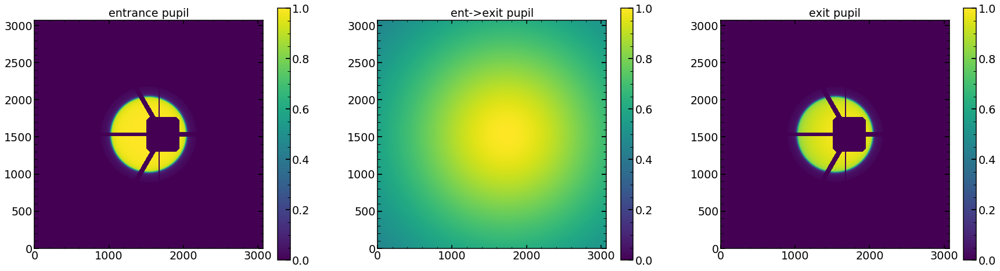

In [1381]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

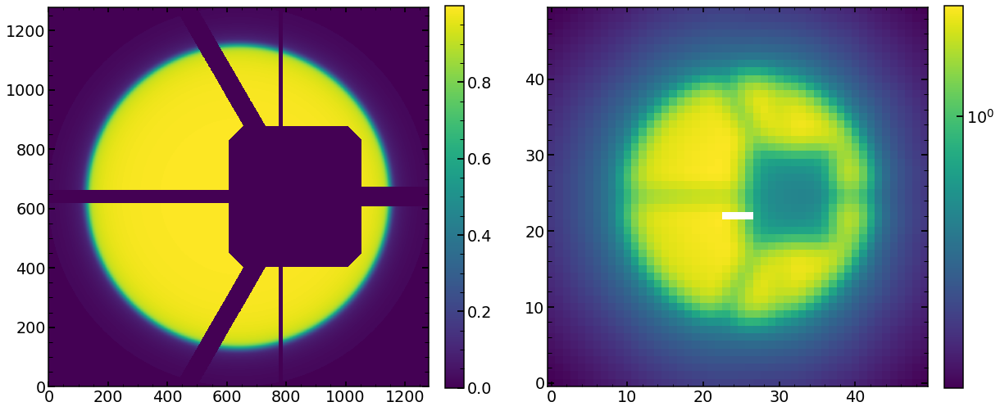

In [1385]:
plt.figure(figsize=(20,20))
plt.subplot(121)
plt.imshow(pupililluminated,origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)

plt.subplot(122)
plt.imshow(res_iapetus*mask_image_unit_invert,norm=LogNorm(),origin='lower')
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([1,10**-2,10**-3,10**-4,10**-5,10,10**2,10**3,10**4,10**5])

In [1368]:
sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')

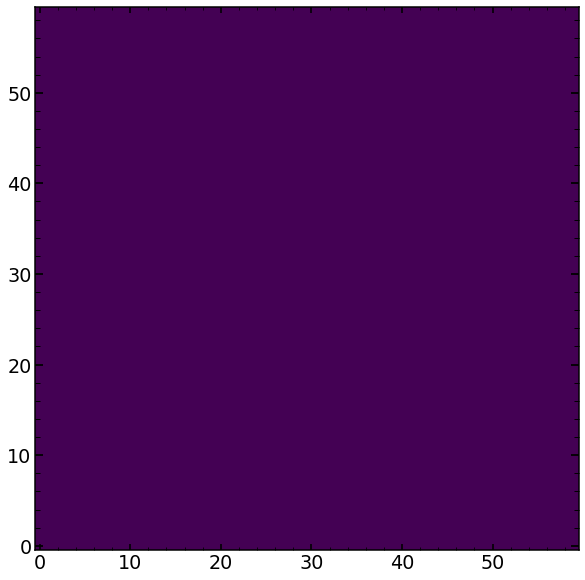

In [1369]:
plt.imshow(mask_image)

In [1374]:
~mask_image.astype(bool)

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

In [89]:
np.log10(0.11)

-0.958607314841775

In [104]:
10**np.linspace(-1,0.0,11)

array([0.1       , 0.12589254, 0.15848932, 0.19952623, 0.25118864,
       0.31622777, 0.39810717, 0.50118723, 0.63095734, 0.79432823,
       1.        ])

In [103]:
np.linspace(-10,-8,11)

array([-10. ,  -9.8,  -9.6,  -9.4,  -9.2,  -9. ,  -8.8,  -8.6,  -8.4,
        -8.2,  -8. ])

# Fine defocus example

In [15]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
    
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

59
1


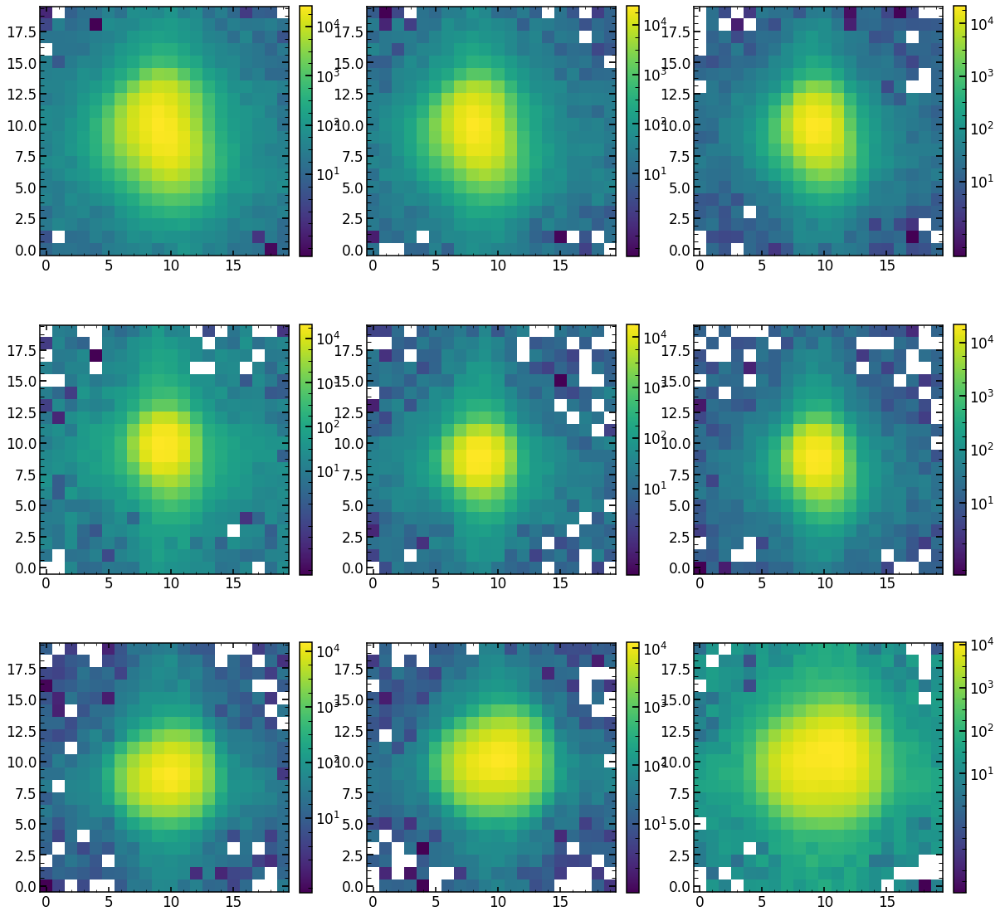

In [16]:
matplotlib.rcParams.update({'font.size': 14})

image_index=59
print(image_index)
print(finalHgAr.loc[image_index]['close'])

#0.5
run_1=20054+30-30
#0.4
run_2=20054+30-24
#0.3
run_3=20054+30-18
#0.2
run_4=20054+30-12
#0.1
run_5=20054+30-6


run_6=20054+30
#0.1
run_7=20054+30+6
#0.2
run_8=20054+30+12
#0.3
run_9=20054+30+18
#0.4
run_10=20054+30+24
#0.5
run_11=20054+30+30


sci_1=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_1)+str(image_index)+'HgAr_Stacked.npy')
sci_2=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_2)+str(image_index)+'HgAr_Stacked.npy')
sci_3=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_3)+str(image_index)+'HgAr_Stacked.npy')
sci_4=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_4)+str(image_index)+'HgAr_Stacked.npy')
sci_5=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_5)+str(image_index)+'HgAr_Stacked.npy')

sci_6=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_6)+str(image_index)+'HgAr_Stacked.npy')

sci_7=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_4)+str(image_index)+'HgAr_Stacked.npy')
sci_8=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_8)+str(image_index)+'HgAr_Stacked.npy')
sci_9=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_9)+str(image_index)+'HgAr_Stacked.npy')
sci_10=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_10)+str(image_index)+'HgAr_Stacked.npy')
sci_11=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/sci"+str(run_11)+str(image_index)+'HgAr_Stacked.npy')


var_1=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_1)+str(image_index)+'HgAr_Stacked.npy')
var_2=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_2)+str(image_index)+'HgAr_Stacked.npy')
var_3=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_3)+str(image_index)+'HgAr_Stacked.npy')
var_4=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_4)+str(image_index)+'HgAr_Stacked.npy')
var_5=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_5)+str(image_index)+'HgAr_Stacked.npy')

var_6=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_6)+str(image_index)+'HgAr_Stacked.npy')

var_7=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_4)+str(image_index)+'HgAr_Stacked.npy')
var_8=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_8)+str(image_index)+'HgAr_Stacked.npy')
var_9=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_9)+str(image_index)+'HgAr_Stacked.npy')
var_10=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_10)+str(image_index)+'HgAr_Stacked.npy')
var_11=np.load("/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/var"+str(run_11)+str(image_index)+'HgAr_Stacked.npy')


list_of_sci=[sci_1,sci_2,sci_3,sci_4,sci_5,sci_6,sci_7,sci_8,sci_9,sci_10,sci_11]
list_of_var=[var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11]

plt.figure(figsize=(20,20))
plt.subplot(331)
plt.imshow(sci_1,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(332)
plt.imshow(sci_2,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(333)
plt.imshow(sci_3,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(334)
plt.imshow(sci_5,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(335)
plt.imshow(sci_6,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(336)
plt.imshow(sci_7,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(337)
plt.imshow(sci_9,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(338)
plt.imshow(sci_10,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(339)
plt.imshow(sci_11,norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [34]:
    date='Aug01'
    single_number=59
    #                             plot=True,zMax=None,return_solution_at_05_0_05=None
    results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper=create_results_of_fit_single(date,single_number,'HgAr',22,2)
    solution_at_0,solution_at_05_0_05=solution_at_0_and_plots(date,single_number,'HgAr',results_of_fit_single,err_results_of_fit_single,err_results_of_fit_single_lower,err_results_of_fit_single_upper,\
                                          plot=False,zMax=22,return_solution_at_05_0_05=True)

22
59 obs (Emcee3): 17023 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17029 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17035 is found!
x_ilum: failed!
x_ilum: failed!
59 17041 HgAr is NOT found or failed!
59 17047 HgAr is NOT found or failed!
59 obs (Emcee3): 17053 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
59 17059 HgAr is NOT found or failed!
59 obs (Emcee3): 17065 is found!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
radiometricExponent: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17071 is found!
x_ilum: failed!
y_ilum: failed!
x_ilum: failed!
y_ilum: failed!
59 obs (Emcee3): 17077 is found!
x_ilum: failed!
y_ilum: faile

In [36]:
results_of_fit_single_focus,err_results_of_fit_single_focus,err_results_of_fit_single_lower_focus,err_results_of_fit_single_upper_focus\
=create_results_of_fit_single_focus('Aug05',single_number,'HgAr',22,2)

22
59 obs (Emcee3): 17071 is found!
z5: failed!
z6: failed!
z7: failed!
z11: failed!
z14: failed!
z15: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!
z5: failed!
z6: failed!
z7: failed!
z11: failed!
z14: failed!
z15: failed!
z19: failed!
z20: failed!
z21: failed!
z22: failed!
hscFrac: failed!
strutFrac: failed!
dxFocal: failed!
slitFrac_dy: failed!
x_ilum: failed!
y_ilum: failed!
x_fiber: failed!
y_fiber: failed!
effective_radius_illumination: failed!
frd_sigma: failed!
frd_lorentz_factor: failed!
det_vert: failed!
slitHolder_frac_dx: failed!


In [136]:
solution_at_05_0_05_focus_guess=np.copy(solution_at_05_0_05)

print(+solution_at_05_0_05_focus_guess[:,0])
print(np.full((11,),results_of_fit_single_focus.iloc[0].values[0]))
# z4
solution_at_05_0_05_focus_guess[:,0]=(np.full((11,),results_of_fit_single_focus.iloc[0].values[0]))+solution_at_05_0_05_focus_guess[:,0]*0.5-solution_at_05_0_05_focus_guess[:,0][5]
# grating_lines
solution_at_05_0_05_focus_guess[:,-6]=np.full((11,),results_of_fit_single_focus.iloc[0].values[-8])
# scattering_slope
solution_at_05_0_05_focus_guess[:,-5]=np.full((11,),results_of_fit_single_focus.iloc[0].values[-7])
# scattering_amplitude
solution_at_05_0_05_focus_guess[:,-4]=np.full((11,),results_of_fit_single_focus.iloc[0].values[-6])
# pixel_effect
solution_at_05_0_05_focus_guess[:,-3]=np.full((11,),results_of_fit_single_focus.iloc[0].values[-5])
# fiber_r
solution_at_05_0_05_focus_guess[:,-2]=np.full((11,),results_of_fit_single_focus.iloc[0].values[-4])

[ 4.09677016  3.30212829  2.50748642  1.71284455  0.91820269  0.12356082
 -0.67108105 -1.46572292 -2.26036479 -3.05500665 -3.84964852]
[0.48798056 0.48798056 0.48798056 0.48798056 0.48798056 0.48798056
 0.48798056 0.48798056 0.48798056 0.48798056 0.48798056]


In [137]:
solution_at_05_0_05_focus_guess[:,0]

array([ 2.41280482,  2.01548389,  1.61816296,  1.22084202,  0.82352109,
        0.42620015,  0.02887922, -0.36844172, -0.76576265, -1.16308358,
       -1.56040452])

In [138]:
list_of_models=[]
for i in tqdm(range(11)):
    model = LN_PFS_single(list_of_sci[i],list_of_var[i],dithering=1,save=1,zmax=22)   
           
    model(solution_at_05_0_05_focus_guess[i])

    optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
    res_iapetus=optPsf_cut_fiber_convolved_downsampled
    list_of_models.append(res_iapetus)

  0%|          | 0/11 [00:00<?, ?it/s]

extraZernike: None
zmax: 22
42


  9%|▉         | 1/11 [00:01<00:18,  1.88s/it]

extraZernike: None
zmax: 22
42


 18%|█▊        | 2/11 [00:03<00:17,  1.96s/it]

extraZernike: None
zmax: 22
42


 27%|██▋       | 3/11 [00:05<00:14,  1.87s/it]

extraZernike: None
zmax: 22
42


 36%|███▋      | 4/11 [00:07<00:12,  1.83s/it]

extraZernike: None
zmax: 22
42


 45%|████▌     | 5/11 [00:09<00:11,  1.85s/it]

extraZernike: None
zmax: 22
42


 55%|█████▍    | 6/11 [00:11<00:09,  1.85s/it]

extraZernike: None
zmax: 22
42


 64%|██████▎   | 7/11 [00:12<00:07,  1.84s/it]

extraZernike: None
zmax: 22
42


 73%|███████▎  | 8/11 [00:14<00:05,  1.82s/it]

extraZernike: None
zmax: 22
42


 82%|████████▏ | 9/11 [00:16<00:03,  1.80s/it]

extraZernike: None
zmax: 22
42


 91%|█████████ | 10/11 [00:18<00:01,  1.81s/it]

extraZernike: None
zmax: 22
42


100%|██████████| 11/11 [00:20<00:00,  1.82s/it]


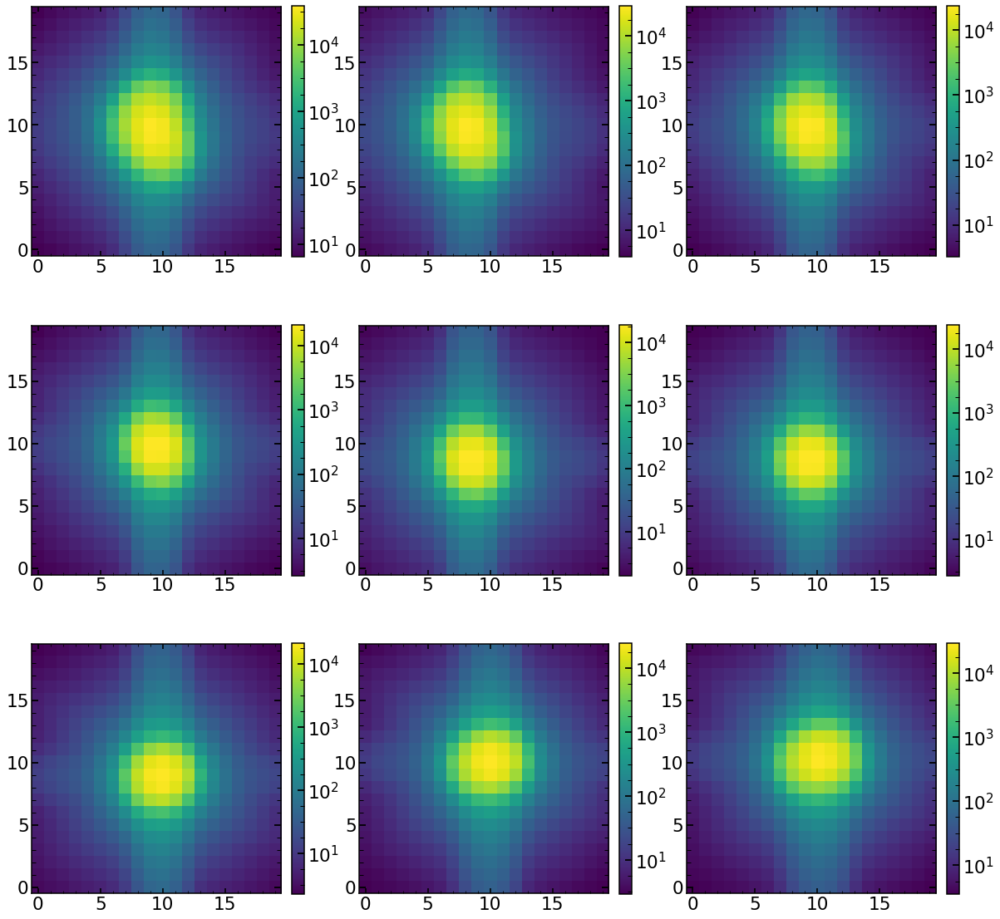

In [139]:

plt.figure(figsize=(20,20))
plt.subplot(331)
plt.imshow(list_of_models[0],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(332)
plt.imshow(list_of_models[1],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(333)
plt.imshow(list_of_models[2],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(334)
plt.imshow(list_of_models[4],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(335)
plt.imshow(list_of_models[5],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(336)
plt.imshow(list_of_models[6],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(337)
plt.imshow(list_of_models[8],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(338)
plt.imshow(list_of_models[9],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(339)
plt.imshow(list_of_models[10],norm=LogNorm())
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

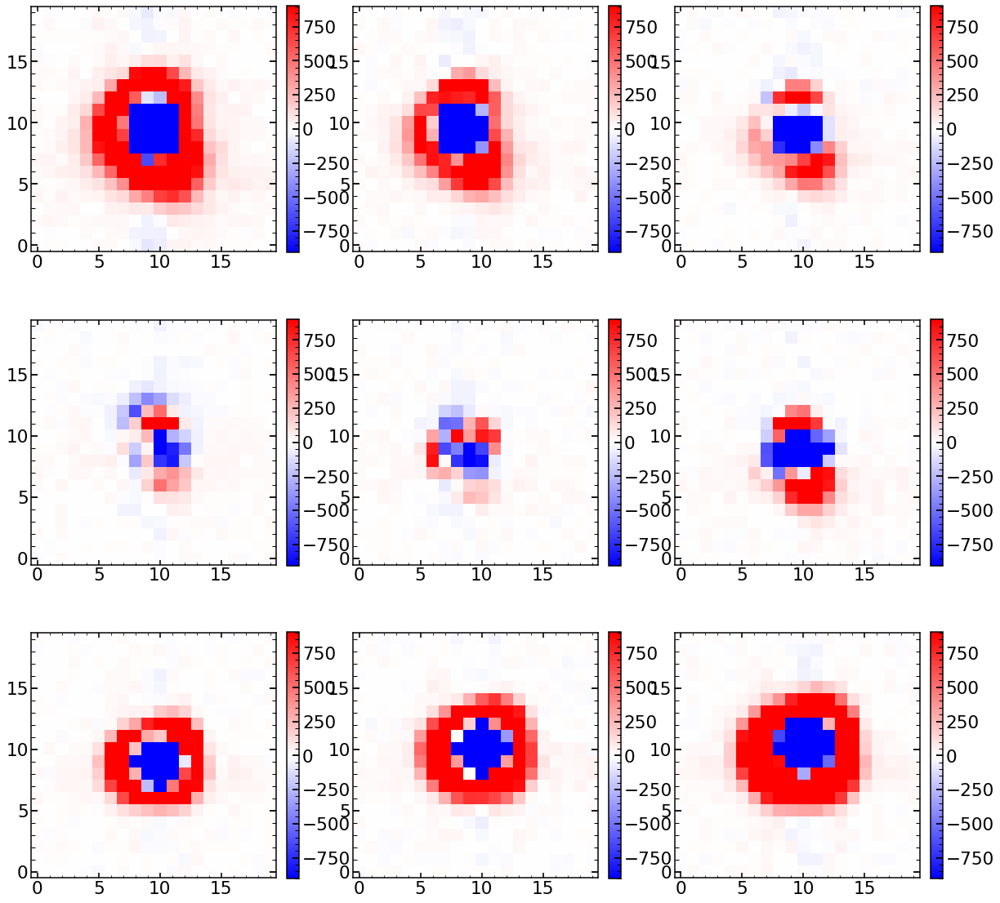

In [140]:
sci_image=list_of_sci[5]

plt.figure(figsize=(20,20))
plt.subplot(331)
plt.imshow(list_of_sci[0]-list_of_models[0],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(332)
plt.imshow(list_of_sci[1]-list_of_models[1],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(333)
plt.imshow(list_of_sci[2]-list_of_models[2],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(334)
plt.imshow(list_of_sci[4]-list_of_models[4],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(335)
plt.imshow(list_of_sci[5]-list_of_models[5],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(336)
plt.imshow(list_of_sci[6]-list_of_models[6],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(337)
plt.imshow(list_of_sci[8]-list_of_models[8],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(338)
plt.imshow(list_of_sci[9]-list_of_models[9],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(339)
plt.imshow(list_of_sci[10]-list_of_models[10],origin='lower',cmap='bwr',vmin=-np.max(np.abs(sci_image))/20,vmax=np.max(np.abs(sci_image))/20)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [135]:
solution_at_05_0_05_focus_guess[:,0]

array([ 4.05151289,  3.33633521,  2.62115752,  1.90597984,  1.19080216,
        0.47562448, -0.2395532 , -0.95473088, -1.66990856, -2.38508625,
       -3.10026393])

In [48]:
results_of_fit_single_focus.iloc[0].values[0]

0.487980562038203

In [123]:
results_of_fit_single

,z4,z5,z6,z7,z8,z9,z10,z11,z12,z13,...,det_vert,slitHolder_frac_dx,grating_lines,scattering_slope,scattering_amplitude,pixel_effect,fiber_r,flux,chi2,chi2max
-4.0,32.159098,-0.886201,-2.320667,-0.051083,0.178900,-0.151778,-0.408486,0.293036,0.114839,0.094429,...,1.091097,0.115847,45125.419311,2.324006,0.005150,0.447753,1.862514,0.997262,8.010270,1963.315308
-3.5,27.516062,-0.752474,-2.117797,-0.119399,0.087028,-0.163410,-0.377573,0.173708,0.122573,0.076638,...,1.084964,0.160293,24293.154389,2.502142,0.007566,0.376753,1.859254,0.997546,8.175572,2456.310791
-3.0,23.956317,-0.693963,-1.938335,-0.119185,0.069647,-0.142363,-0.387169,0.090112,0.115271,0.072146,...,1.085305,0.146082,28613.366491,2.444721,0.008342,0.405908,1.850311,0.996987,8.294075,3063.828125
-2.5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
-2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
-1.5,11.966097,-0.550705,-1.483695,-0.410112,0.025818,-0.133512,-0.427431,0.155119,0.116382,0.062764,...,1.090945,0.202914,32721.618015,2.369653,0.005871,0.412160,1.848743,0.998694,4.225482,2471.482422
-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
-0.5,3.797194,-0.543425,-1.298365,-0.434762,0.050754,-0.086459,-0.452783,0.064008,0.128048,0.093513,...,1.072916,0.299762,28246.666717,2.466267,0.006438,0.494309,1.858829,0.998773,1.838857,912.957520
0,0.266105,-0.667283,-0.783075,-0.188582,-0.313454,0.127033,-0.299582,-0.237214,-0.109574,-0.379793,...,1.058449,0.095486,30212.819134,2.409708,0.004321,0.350306,1.830891,0.996143,2.169671,564.303467
0,0.266105,-0.667283,-0.783075,-0.188582,-0.313454,0.127033,-0.299582,-0.237214,-0.109574,-0.379793,...,1.058449,0.095486,30212.819134,2.409708,0.004321,0.350306,1.830891,0.996143,2.169671,564.303467


# Kiyoto question

In [ ]:
# run everything up to 8.3

In [69]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)  
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalKr_May2019.pkl', 'rb') as f:
    finalKr_May2019=pickle.load(f)  
    
finalKr=finalKr_May2019
finalHgAr=finalHgAr_May2019
finalNe=finalNe_May2019

In [70]:
import glob
date='Aug05'
Emcee3_Ne=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5NeEmcee3.npy', recursive=True)
Emcee3_HgAr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5HgArEmcee3.npy', recursive=True)
Emcee3_Kr=glob.glob('/Users/nevencaplar/Documents/PFS/TigerAnalysis/ResultsFromTiger/'+date+'/chain'+date+'_Single_P_*5KrEmcee3.npy', recursive=True)

In [71]:
analyzed_Neon_images=[]
for i in range(len(Emcee3_Ne)):
    single_string=Emcee3_Ne[i][90:len(Emcee3_Ne[0])-13]
    analyzed_Neon_images.append([int(single_string[:5]),int(single_string[5:])])
   
analyzed_Neon_images=np.array(analyzed_Neon_images)
###########
analyzed_HgAr_images=[]
for i in range(len(Emcee3_HgAr)):
    single_string=Emcee3_HgAr[i][90:len(Emcee3_HgAr[i])-15]
    analyzed_HgAr_images.append([int(single_string[:5]),int(single_string[5:])])
 

analyzed_HgAr_images=np.array(analyzed_HgAr_images)
###########
analyzed_Kr_images=[]
for i in range(len(Emcee3_Kr)):
    single_string=Emcee3_Kr[i][90:len(Emcee3_Kr[i])-13]
    analyzed_Kr_images.append([int(single_string[:5]),int(single_string[5:])])
    
analyzed_Kr_images=np.array(analyzed_Kr_images)

In [72]:
arranged_by_defocus_Ne=analyzed_Neon_images[analyzed_Neon_images[:,0].argsort()]
arranged_by_spot_number_Ne=analyzed_Neon_images[analyzed_Neon_images[:,1].argsort()]

arranged_by_defocus_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,0].argsort()]
arranged_by_spot_number_HgAr=analyzed_HgAr_images[analyzed_HgAr_images[:,1].argsort()]

arranged_by_defocus_Kr=analyzed_Kr_images[analyzed_Kr_images[:,0].argsort()]
arranged_by_spot_number_Kr=analyzed_Kr_images[analyzed_Kr_images[:,1].argsort()]

In [73]:
arranged_by_spot_number_HgAr

array([[17071,     1],
       [17071,     3],
       [17071,    15],
       [17071,    18],
       [17071,    21],
       [17071,    23],
       [17071,    25],
       [17071,    27],
       [17071,    30],
       [17071,    33],
       [17071,    35],
       [17071,    37],
       [17071,    39],
       [17071,    42],
       [17071,    45],
       [17071,    47],
       [17071,    49],
       [17071,    54],
       [17071,    57],
       [17071,    59],
       [17071,    61],
       [17071,    63],
       [17071,    66],
       [17071,    69],
       [17071,    71],
       [17071,    73],
       [17071,    75],
       [17071,    81],
       [17071,    83],
       [17071,    85],
       [17071,    87],
       [17071,    90],
       [17071,    93],
       [17071,    95],
       [17071,    97],
       [17071,    99],
       [17071,   102],
       [17071,   105],
       [17071,   107],
       [17071,   109],
       [17071,   111],
       [17071,   117]])

## single analysis 

In [106]:
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalHgAr_Feb2019.pkl', 'rb') as f:
    finalHgAr_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_Feb_5/Dataframes/finalNe_Feb2019.pkl', 'rb') as f:
    finalNe_Feb2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalHgAr_May2019.pkl', 'rb') as f:
    finalHgAr_May2019=pickle.load(f)
with open('/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Dataframes/finalNe_May2019.pkl', 'rb') as f:
    finalNe_May2019=pickle.load(f)  


# add Kr   
date='Aug05'
obs=17023+48
single_number='57'
image_index=int(single_number)
eps=5
arc='HgAr'
dataset=2

if dataset==2:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_May_28/Stamps_cleaned/"
if dataset==3:
    STAMPS_FOLDER="/Users/nevencaplar/Documents/PFS/ReducedData/Data_Jun_25/Stamps_cleaned/"
    

if dataset==1:
    if arc=="HgAr":
        single_number_focus=11748
    elif arc=="Ne":
        single_number_focus=11748+607    
    else:
        print("Not recognized arc-line")
if dataset==2:
    if arc=="HgAr":
        single_number_focus=17017+54
    elif arc=="Ne":
        single_number_focus=16292  
    elif arc=="Kr":
        single_number_focus=17364  
    else:
        print("Not recognized arc-line")
        
if dataset==3:
    if arc=="HgAr":
        single_number_focus=19238+54
    elif arc=="Ne":
        single_number_focus=19472  
    else:
        print("Not recognized arc-line")
        
if dataset==1:
    if arc=='HgAr':
        obs_possibilites=np.array([11796,11790,11784,11778,11772,11766,11760,11754,11748,11748,11694,11700,11706,11712,11718,11724,11730,11736])
    elif arc=='Ne':
        obs_possibilites=np.array([12403,12397,12391,12385,12379,12373,12367,12361,12355,12355,12349,12343,12337,12331,12325,12319,12313,12307])
if dataset==2:
    if arc=='HgAr':
        obs_possibilites=np.array([17023,17023+6,17023+12,17023+18,17023+24,17023+30,17023+36,17023+42,17023+48,17023+48,17023+54,17023+60,17023+66,17023+72,17023+78,17023+84,17023+90,17023+96,17023+48])
    if arc=='Ne':
        # different sequence than for HgAr
        obs_possibilites=np.array([16238+6,16238+12,16238+18,16238+24,16238+30,16238+36,16238+42,16238+48,16238+54,16238+54,16238+60,16238+66,16238+72,16238+78,16238+84,16238+90,16238+96,16238+102,16238+54])
    if arc=='Kr':
         obs_possibilites=np.array([17310+6,17310+12,17310+18,17310+24,17310+30,17310+36,17310+42,17310+48,17310+54,17310+54,17310+60,17310+66,17310+72,17310+78,17310+84,17310+90,17310+96,17310+102,17310+54])

if dataset==3:    
    if arc=='HgAr':
        obs_possibilites=np.array([19238,19238+6,19238+12,19238+18,19238+24,19238+30,19238+36,19238+42,19238+48,19238+48,19238+54,19238+60,19238+66,19238+72,19238+78,19238+84,19238+90,19238+96,19238+48])
    elif arc=='Ne':
    # different sequence than for HgAr
        obs_possibilites=np.array([19472+6,19472+12,19472+18,19472+24,19472+30,19472+36,19472+42,19472+48,19472+54,19472+54,19472+60,19472+66,19472+72,19472+78,19472+84,19472+90,19472+96,19472+102,19472+54]) 
        
        
label=['m4','m35','m3','m25','m2','m15','m1','m05','0d','0','p05','p1','p15','p2','p25','p3','p35','p4','0p']
labelInput=label[list(obs_possibilites).index(int(obs))]
print(labelInput)
if obs==8600:
    print("Not implemented for December 2018 data")
else:
    sci_image =np.load(STAMPS_FOLDER+'sci'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    mask_image =np.load(STAMPS_FOLDER+'mask'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    var_image =np.load(STAMPS_FOLDER+'var'+str(obs)+str(single_number)+str(arc)+'_Stacked.npy')
    #sci_image_focus_large =np.load(STAMPS_FOLDER+'sci'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')
    #var_image_focus_large =np.load(STAMPS_FOLDER+'var'+str(single_number_focus)+str(single_number)+str(arc)+'_Stacked_large.npy')

if dataset==1:
    if arc=="HgAr":
        finalArc=finalHgAr_Feb2019
    elif arc=="Ne":
        finalArc=finalNe_Feb2019    
    else:
        print("Not recognized arc-line")    
if dataset==2:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    elif arc=="Kr":
        finalArc=finalKr_May2019    
    else:
        print("Not recognized arc-line")   
if dataset==3:   
    if arc=="HgAr":
        finalArc=finalHgAr_May2019
    elif arc=="Ne":
        finalArc=finalNe_May2019    
    else:
        print("Not recognized arc-line")   
        
        
        
finalArc.loc[int(single_number)]

0d


fiber                         339
xc                           1609
yc                           3343
wavelength               912.5693
close                           1
lamp                         HgAr
xc_effective                 1609
old_index_approx               81
superold_index_approx        22.0
Name: 57, dtype: object

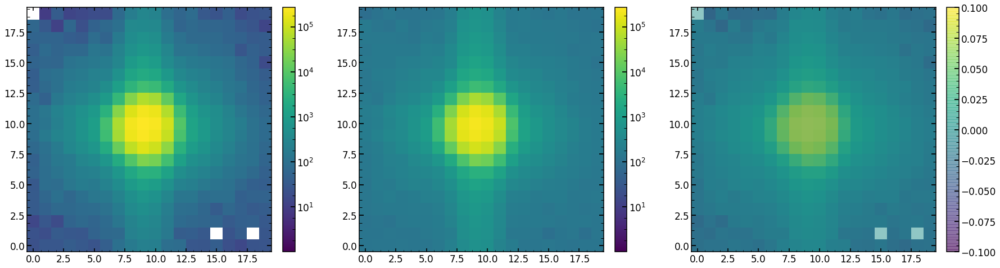

In [107]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(132)
plt.imshow(var_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
cbar=plt.colorbar(fraction=0.046, pad=0.04)
cbar.set_ticks([10,10**2,10**3,10**4,10**5])

plt.subplot(133)
plt.imshow(sci_image,norm=LogNorm(),origin='lower',vmin=1,vmax=np.max(sci_image))
plt.imshow(mask_image,origin='lower',vmin=0,vmax=np.max(mask_image),alpha=0.5)
cbar=plt.colorbar(fraction=0.046, pad=0.04)
#cbar.set_ticks([10,10**2,10**3,10**4,10**5])

In [108]:
single_analysis=Zernike_Analysis(date,obs,single_number,eps,arc,dataset)
chain0_Emcee3,likechain0_Emcee3=single_analysis.create_chains()

minchain,like_min=single_analysis.create_likelihood()

(number of walkers, number of steps, number of parameters): (252, 40, 42)
minimal likelihood is: 9307.741636311828
minimal chi2 reduced is: 46.497167526339055


In [109]:
print(minchain.shape)

if len(minchain)==42:
    columns=columns22
    
dfz22 = pd.DataFrame(np.array([np.array([minchain])[0][0:8]]),columns=columns[0:8])
print(dfz22)
dfglobal = pd.DataFrame(np.array([np.array([minchain])[0][8:len(columns)]]),columns=columns[8:])

dfglobal1 = pd.DataFrame(np.array([np.array([minchain])[0][8:18]]),columns=columns[8:18])
print(dfglobal1)

dfglobal2 = pd.DataFrame(np.array([np.array([minchain])[0][18:len(columns)]]),columns=columns[18:])
print(dfglobal2)


(42,)
         z4        z5        z6        z7        z8        z9       z10  \
0  0.122628 -0.486608 -0.742356 -0.009072 -0.090005 -0.138123 -0.341214   

        z11  
0 -0.150901  
        z12       z13       z14       z15       z16       z17       z18  \
0  0.035251  0.041979  0.017638  0.045939 -0.013166  0.015731  0.005491   

        z19       z20       z21  
0 -0.001307 -0.032238  0.026455  
        z22   hscFrac  strutFrac   dxFocal   dyFocal  slitFrac  slitFrac_dy  \
0  0.022769  0.670011   0.083975 -0.051448  0.152832  0.063149     0.040172   

   radiometricEffect  radiometricExponent    x_ilum   ...     frd_sigma  \
0           0.000007             0.000007  0.973393   ...      0.057466   

   frd_lorentz_factor  det_vert  slitHolder_frac_dx  grating_lines  \
0            0.844967  1.055414             0.11525   45535.888563   

   scattering_slope  scattering_amplitude  pixel_effect   fiber_r     flux  
0          2.746878              0.005334      0.379935  1.859274  0

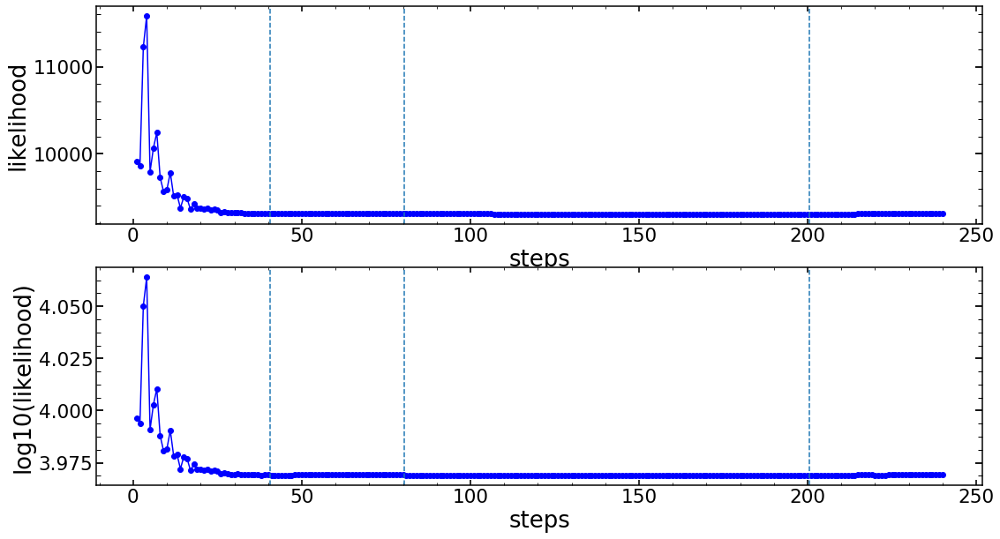

In [110]:
size=chain0_Emcee3.shape[1]
matplotlib.rcParams.update({'font.size': 18})
plt.figure(figsize=(18,10))
plt.subplot(211)
plt.plot(np.linspace(1,len(like_min),len(like_min)),like_min,'blue',ls='-',marker='o')
plt.ylabel('likelihood')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(size*2+0.5,ls='--')
plt.axvline(size*5+0.5,ls='--')
plt.subplot(212)
plt.plot(np.linspace(1,len(like_min),len(like_min)),np.log10(like_min),'blue',ls='-',marker='o')
plt.ylabel('log10(likelihood)')
plt.xlabel('steps')
plt.axvline(size+0.5,ls='--')
plt.axvline(2*size+0.5,ls='--')
plt.axvline(5*size+0.5,ls='--')

In [111]:
if obs=='8600':
    model = LN_PFS_single(sci_image,var_image,dithering=2,save=1)
else:
    model = LN_PFS_single(sci_image,var_image,dithering=1,save=1,zmax=22)   
       
model(minchain)

extraZernike: None
zmax: 22
42
None


-9307.741636345692

In [112]:
pupililluminated=np.load(TESTING_PUPIL_IMAGES_FOLDER+'pupil.illuminated.npy')
ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum.npy')
r_ilum=np.load(TESTING_PUPIL_IMAGES_FOLDER+'r_ilum.npy')
radiometricEffectArray=np.load(TESTING_PUPIL_IMAGES_FOLDER+'radiometricEffectArray.npy')
ilum_radiometric=np.load(TESTING_PUPIL_IMAGES_FOLDER+'ilum_radiometric.npy')

wf=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf.npy') 
wf_full=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_full.npy') 
u_manual=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'u_manual.npy')
wf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'wf_grid.npy')   
expwf_grid=np.load(TESTING_WAVEFRONT_IMAGES_FOLDER+'expwf_grid.npy')      

optPsf=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf.npy')
optPsf_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled.npy')
optPsf_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_fiber_convolved.npy')

optPsf_downsampled_scattered=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_downsampled_scattered.npy')
res_init=np.load(TESTING_FINAL_IMAGES_FOLDER+'res_init.npy')
res=np.load(TESTING_FINAL_IMAGES_FOLDER+'res.npy')


optPsf_cut_fiber_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved.npy')
optPsf_cut_pixel_response_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_pixel_response_convolved.npy')
optPsf_cut_grating_convolved=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_grating_convolved.npy')
optPsf_cut_fiber_convolved_downsampled=np.load(TESTING_FINAL_IMAGES_FOLDER+'optPsf_cut_fiber_convolved_downsampled.npy')
res_iapetus=optPsf_cut_fiber_convolved_downsampled

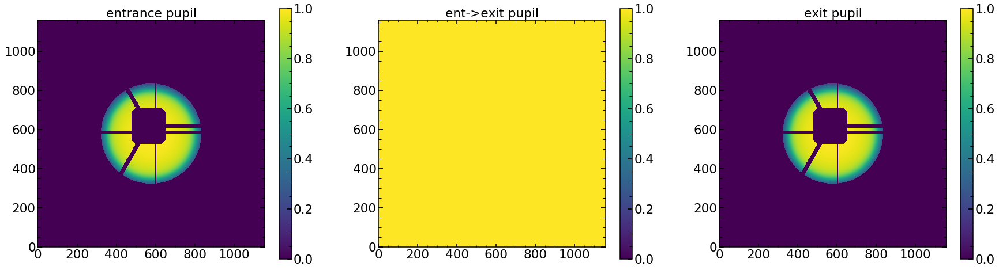

In [113]:
plt.figure(figsize=(30,8))
plt.subplot(131)
plt.imshow(ilum,origin='lower',vmax=1,vmin=0)
plt.title('entrance pupil')
plt.colorbar()
plt.subplot(132)
plt.title('ent->exit pupil')
plt.imshow(radiometricEffectArray,origin='lower',vmax=1,vmin=0)

plt.colorbar()
plt.subplot(133)
plt.title('exit pupil')
plt.imshow(ilum_radiometric,origin='lower',vmax=1,vmin=0)
plt.colorbar()

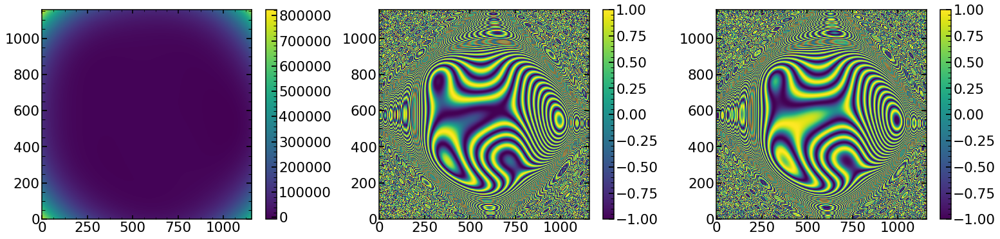

In [114]:
plt.figure(figsize=(36,6))
plt.subplot(141)
plt.imshow(wf_full)
plt.colorbar()

plt.subplot(142)
plt.imshow(np.real(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

plt.subplot(143)
plt.imshow(np.imag(np.exp(2j*np.pi * wf_full/800)))
plt.colorbar()

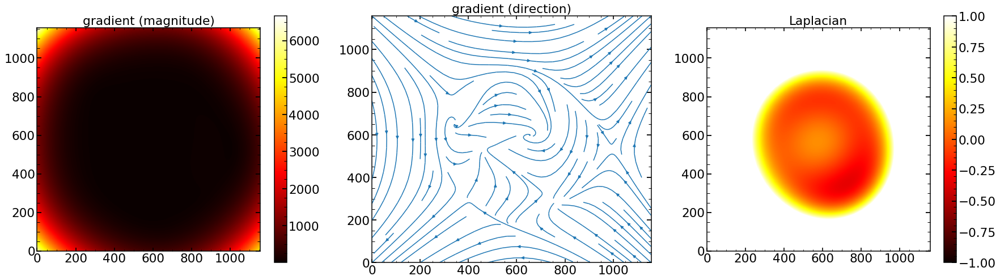

In [115]:
plt.figure(figsize=(30,8))
plt.subplot(131)
vgrad = np.gradient(wf_full)
fulgrad = np.sqrt(vgrad[0]**2 + vgrad[1]**2)
plt.title('gradient (magnitude)')
plt.imshow(fulgrad,cmap=plt.get_cmap('hot'), vmin = np.amin(fulgrad),vmax = np.amax(fulgrad))  
plt.colorbar()
plt.subplot(132)
x, y = range(0, len(wf_full)), range(0,len(wf_full))
xi, yi = np.meshgrid(x, y)
plt.title('gradient (direction)')
plt.streamplot(xi, yi, vgrad[0], vgrad[1])
plt.subplot(133)
laplace_of_wf = scipy.ndimage.filters.laplace(wf_full)
plt.title('Laplacian')
plt.imshow(laplace_of_wf,cmap=plt.get_cmap('hot'), vmin = -1,vmax = 1) 
plt.colorbar()

Text(0.5,1,'Residual')

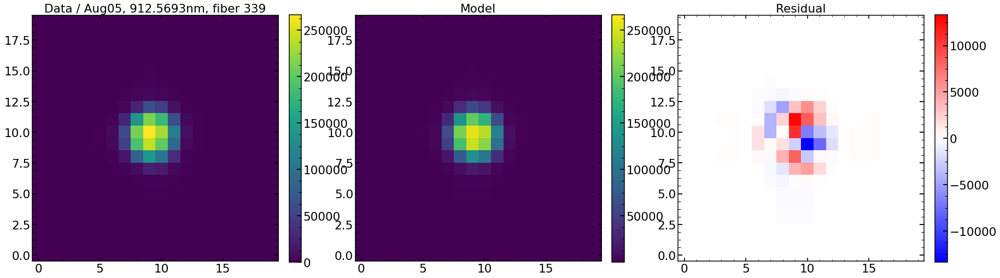

In [116]:
plt.figure(figsize=(30,12))
plt.subplot(1,3,1)
plt.imshow(sci_image,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Data / '+str(date)+', '+str(finalArc.loc[int(single_number)]['wavelength'])+'nm, fiber '+str(finalArc.loc[int(single_number)]['fiber']))
plt.subplot(1,3,2)
plt.imshow(res_iapetus,vmax=np.max(sci_image))
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Model')
plt.subplot(1,3,3)
plt.imshow(sci_image-res_iapetus,vmin=-np.max(sci_image)/20,vmax=np.max(sci_image)/20,cmap='bwr')
plt.colorbar(fraction=0.046, pad=0.04)
plt.title('Residual')

In [117]:
np.sum(sci_image)

3021597.5

chi**2 reduced is: 46.49716643426123
Abs of residual divided by total flux is: 0.0520951581836666
Abs of residual divided by largest value of a flux in the image is: 0.0767174800672125


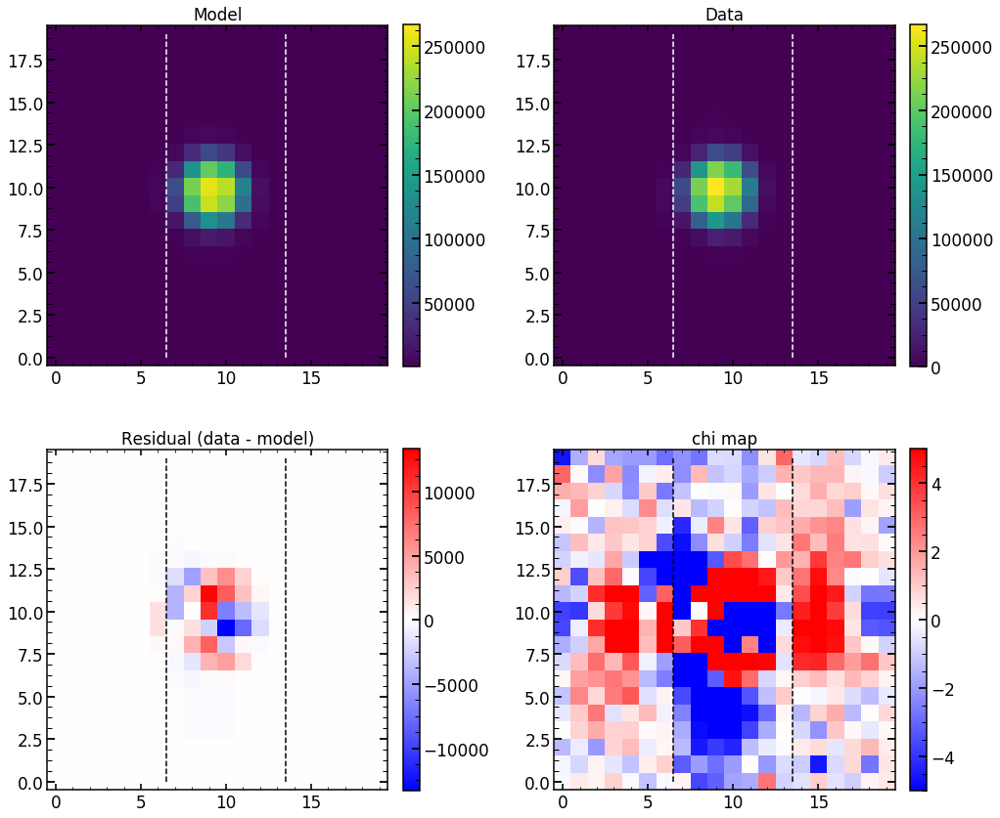

In [118]:
matplotlib.rcParams.update({'font.size': 14})
single_analysis.create_basic_comparison_plot()

46.49716643426123
chi**2 reduced is: 46.49716643426123
Abs of residual divided by total flux is: 0.0520951581836666
Abs of residual divided by largest value of a flux in the image is: 0.0767174800672125


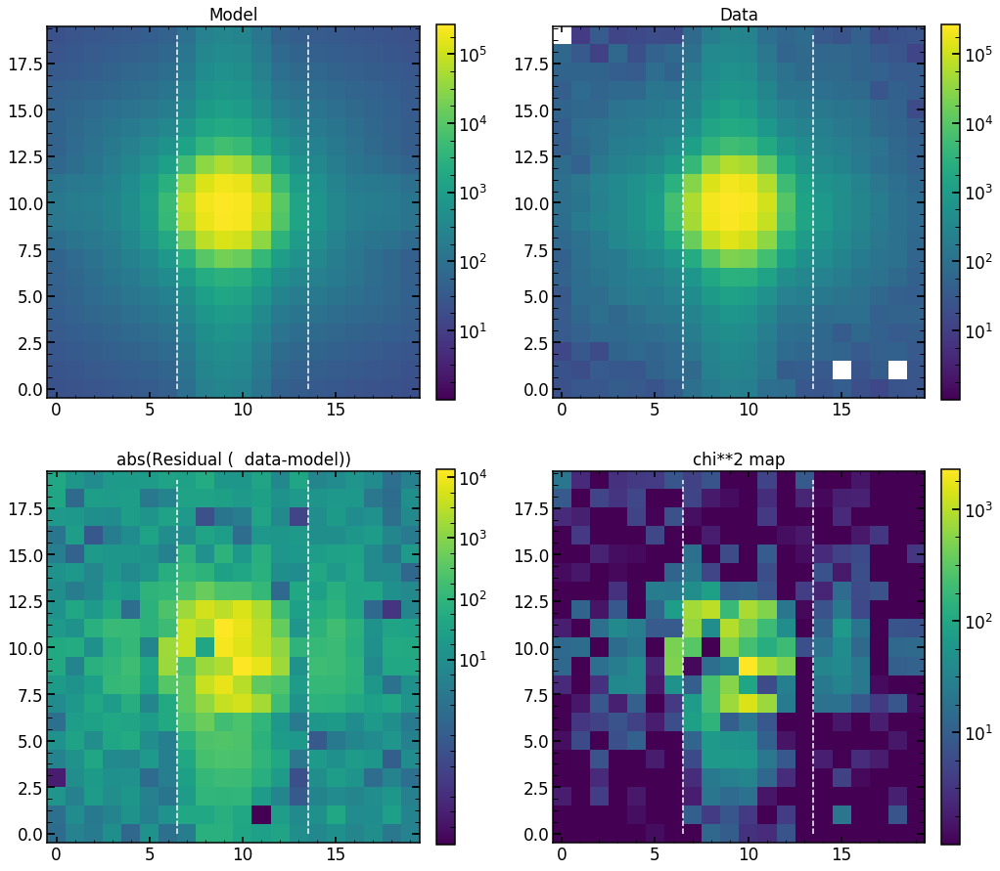

In [119]:
single_analysis.create_basic_comparison_plot_log()

46.49716643426123
chi**2 reduced is: 46.49716643426123
Abs of residual divided by total flux is: 0.0520951581836666
Abs of residual divided by largest value of a flux in the image is: 0.0767174800672125


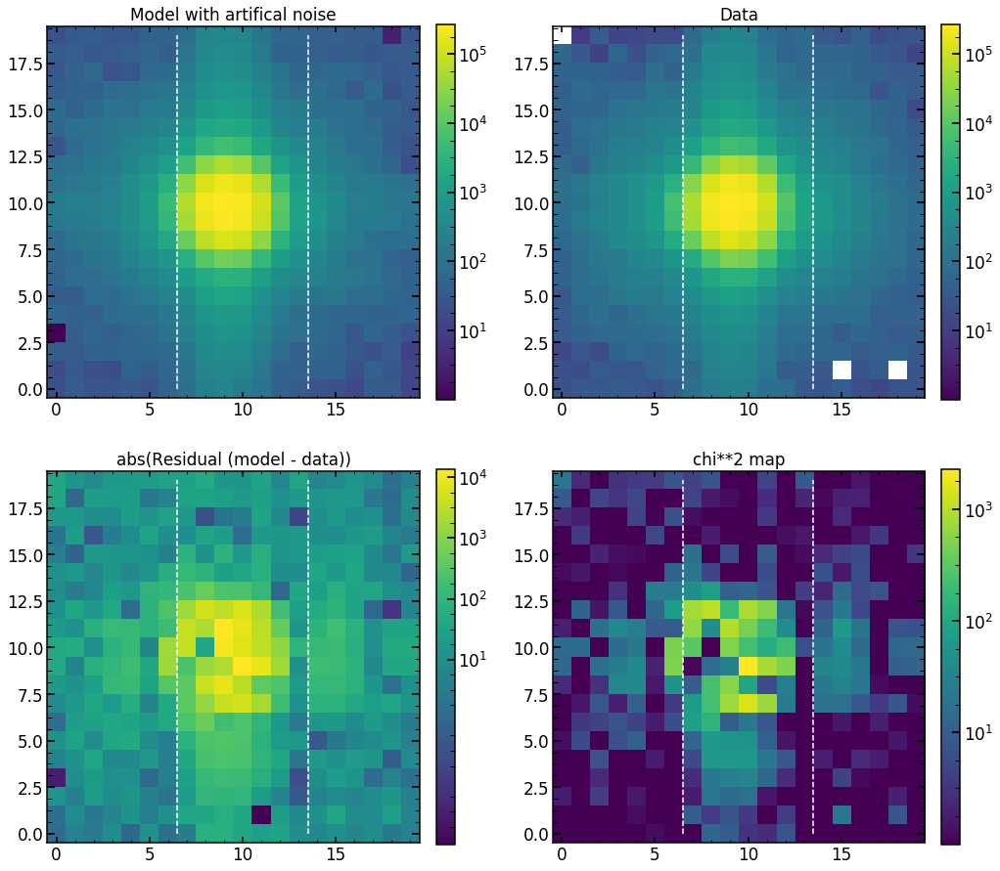

In [120]:
single_analysis.create_basic_comparison_plot_log_artifical()

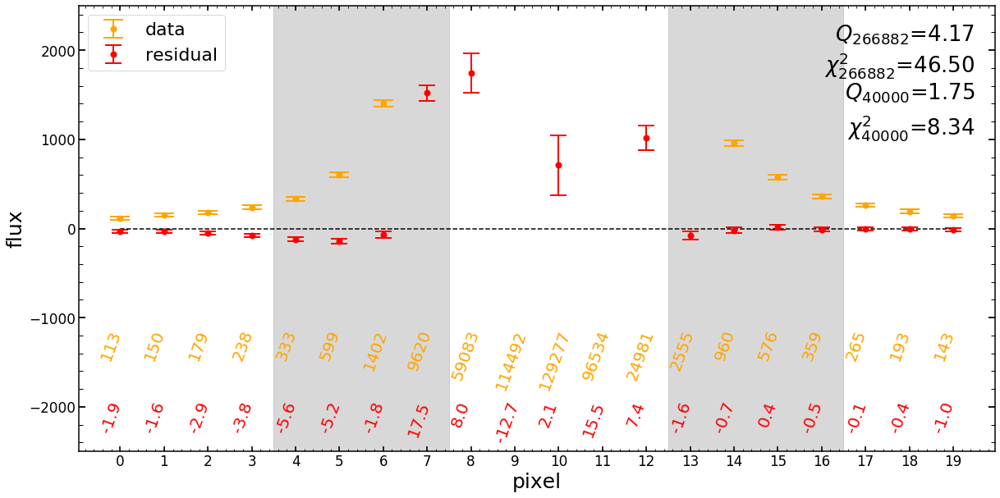

In [159]:
plot_1D_residual(sci_image,var_image,res_iapetus)

In [157]:
init_lamda,std_init_lamda,init_removal_lamda,std_init_removal_lamda=residual_1D(sci_image,var_image,res_iapetus)

In [133]:
example_res=residual_1D(sci_image,var_image,res_iapetus)
np.save('/Users/nevencaplar/Documents/PFS/Images/Kiyoto_Yabe/example_res',example_res)

In [131]:
example_res

(array([   132.47554803,    177.83882097,    210.87368256,    278.94506467,
           390.4099683 ,    705.18831522,   1661.61179491,  11493.83017623,
         70499.81706696, 135831.84209208, 153268.44210343, 115097.66835903,
         29901.78334599,   3030.98985946,   1134.85620084,    681.69749764,
           421.96343849,    312.51629479,    228.31026664,    169.72987094]),
 array([ 18.16152 ,  19.23916 ,  19.955574,  21.363684,  23.525085,
         28.756178,  40.42544 ,  95.72994 , 239.33485 , 340.59836 ,
        363.20786 , 310.10254 , 152.71867 ,  52.79896 ,  34.522877,
         28.260706,  24.06076 ,  21.95131 ,  20.235128,  18.896133],
       dtype=float32),
 array([  -39.3444515 ,   -32.68814745,   -62.89134152,   -90.19421746,
         -146.19339144,  -164.68010106,   -70.22027416,  1844.84219978,
         2080.10110175, -4820.59463702,   991.26068707,  5413.00057334,
         1292.12458317,   -83.38722917,   -20.8491784 ,    17.6236961 ,
          -13.61899208,    -2.5966

In [ ]:
example_res=np.load('/Users/nevencaplar/Documents/PFS/Images/Kiyoto_Yabe/example_res.npy')

# Improve quality measure

In [138]:
test_artifical=add_artificial_noise(sci_image,var_image,res_iapetus)

Max_SN_now=np.max(sci_image)/np.max(np.sqrt(var_image))
print(Max_SN_now)

560.7393


In [139]:
np.max(test_artifical[0])/np.max(np.sqrt(test_artifical[1]))

199.28549324162302

In [136]:
test_artifical

(array([[    54.33055119,     77.20980905,     50.7298025 ,
             55.20981803,     22.60050648,     18.82889233,
             46.84283647,     99.35768389,    195.93926271,
            265.42124662,    160.92635464,    108.75717494,
             90.03323194,      3.42116599,     19.040468  ,
             77.90908275,     12.07954831,     24.26879348,
             -8.70338616,     58.29411372],
        [    43.04480969,     34.70349834,     30.77697303,
              6.6240814 ,     47.65001514,     66.06858044,
             74.96085352,     91.27996738,    317.60204961,
            455.6800341 ,    231.42495731,    121.37915284,
            -19.99640025,     44.86766092,     33.38682766,
             11.94595309,     73.36945118,     94.2054229 ,
            -30.74087736,     87.1241449 ],
        [   -58.46616003,      7.21295792,     87.96395234,
             98.98658642,     60.13064172,     58.45230993,
             97.4426179 ,    141.27425842,    301.31707556,
            

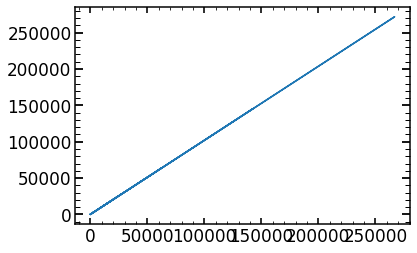

In [149]:
plt.plot(sci_image.ravel(),var_image.ravel()*1.2)

In [150]:
40000/np.sqrt(40000/1.2)

219.08902300206645